In [ ]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from google.colab import files
import os
from google.colab.patches import cv2_imshow
import cv2
import dlib
import requests
from bs4 import BeautifulSoup
import sys
import imgaug as ia
from imgaug import augmenters as iaa
import tensorflow as tf
from tensorflow import keras
import tensorflow_datasets as tfds
import math

from tensorflow.keras import layers
from tensorflow.keras.datasets import mnist

import keras
from keras.models import Model
from keras.layers import *

from tensorflow.keras import layers
from tensorflow.keras.datasets import mnist
os.listdir(".")

['.config', 'sample_data']

In [ ]:
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install gputil
!pip install psutil
!pip install humanize
import psutil
import humanize
import os
import GPUtil as GPU

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
with np.load("./drive/MyDrive/coledatasetNOTNORMALIZED.npz") as data:
    print(data.files)
    x = data["arr_0"]

['arr_0']


In [ ]:
x.shape

(56, 128, 128, 3)

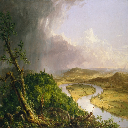

0 250.08407592773438


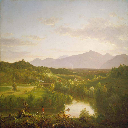

15 248.740234375


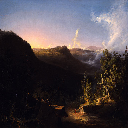

30 255.0


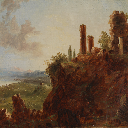

45 215.3612060546875


In [ ]:
for z in range(0, x.shape[0], 15):
  cv2_imshow(x[z])
  print(z, np.max(x[z]))

In [ ]:
x = (x - np.mean(x))/255
print(np.max(x))

0.5958454545273818


In [ ]:
temp = np.repeat(x, 11, axis=0)
np.random.shuffle(temp)
X = tf.convert_to_tensor(temp)
del temp

In [ ]:
# X_res = tf.image.resize(X, (256,256), tf.image.ResizeMethod.BILINEAR)

In [ ]:
# cv2_imshow(X_res.numpy()[0] * 255)

In [ ]:
def make_generator():
    model = tf.keras.Sequential()
    model.add(layers.Dense(256, use_bias=False, input_shape=(150,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dense(2048, use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dense(8192, use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Reshape((16, 16, 32)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # assert model.output_shape == (None, 4, 4, 512) # Note: None is the batch size
    # model.add(layers.Conv2DTranspose(1024, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    # assert model.output_shape == (None, 8, 8, 512)
    # model.add(layers.BatchNormalization())
    # model.add(layers.ReLU())

    model.add( keras.layers.Lambda( lambda image: tf.image.resize(image, (64, 64), method = tf.image.ResizeMethod.NEAREST_NEIGHBOR, preserve_aspect_ratio = True)))
    model.add(layers.Conv2D(16, (4,4), strides=(2,2), padding="same", use_bias=False))
    # assert model.output_shape == (None, 32, 32, 16)

    # model.add(layers.Conv2DTranspose(16, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 32, 32, 16)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # model.add(layers.Conv2DTranspose(8, (4, 4), strides=(2, 2), padding='same', use_bias=False))

    model.add( keras.layers.Lambda( lambda image: tf.image.resize(image, (128, 128), method = tf.image.ResizeMethod.NEAREST_NEIGHBOR, preserve_aspect_ratio = True)))
    model.add(layers.Conv2D(8, (3,3), strides=(2,2), padding="same", use_bias=False))

    assert model.output_shape == (None, 64, 64, 8)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    # assert model.output_shape == (None, 32, 32, 128)
    # model.add(layers.BatchNormalization())
    # model.add(layers.LeakyReLU())

    # model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False))
    # assert model.output_shape == (None, 64, 64, 64)
    # model.add(layers.BatchNormalization())
    # model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(3, (4, 4), strides=(2, 2), padding='same', activation='tanh', use_bias=False))
    # model.add( keras.layers.Lambda( lambda image: tf.image.resize(image, (256, 256), method = tf.image.ResizeMethod.NEAREST_NEIGHBOR, preserve_aspect_ratio = True)))
    # model.add(layers.Conv2D(3, (2,2), strides=(2,2), padding="same", use_bias=False))
    assert model.output_shape == (None, 128, 128, 3)
    # model.add(layers.Activation(keras.activations.tanh))

    return model

# def make_generator():
#     model = tf.keras.Sequential()
#     model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(110,)))
#     model.add(layers.LeakyReLU())

#     model.add(layers.Reshape((8, 8, 256)))
#     assert model.output_shape == (None, 8, 8, 256) # Note: None is the batch size

#     model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
#     assert model.output_shape == (None, 8, 8, 128)
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
#     assert model.output_shape == (None, 16, 16, 64)
#     model.add(layers.BatchNormalization())
#     model.add(layers.LeakyReLU())

#     model.add(layers.Conv2DTranspose(32, (5, 5), strides=(2, 2), padding='same', use_bias=False))
#     assert model.output_shape == (None, 32, 32, 32)
#     model.add(layers.LeakyReLU())

#     model.add(layers.Conv2DTranspose(16, (5, 5), strides=(2, 2), padding='same', use_bias=False))
#     assert model.output_shape == (None, 64, 64, 16)
#     model.add(layers.LeakyReLU())

#     model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
#     assert model.output_shape == (None, 128, 128, 3)

#     return model

def make_discriminator():
    # define two sets of inputs
    # Facial features
    # featInput = Input(shape=(10,))
    # Image input
    base = 70
    imageInput = Input(shape=(128,128,3))
    y = Conv2D(base, 3)(imageInput)
    y = tf.keras.layers.BatchNormalization()(y)
    y = tf.keras.layers.LeakyReLU()(y)
    y = AveragePooling2D(2,2)(y)
    y = Conv2D(base * 2,3,padding='same')(y)
    y = tf.keras.layers.BatchNormalization()(y)
    y = tf.keras.layers.LeakyReLU()(y)
    y = AveragePooling2D(2,2)(y)
    y = Conv2D(base * 4,3,padding='same')(y)
    y = tf.keras.layers.BatchNormalization()(y)
    y = tf.keras.layers.LeakyReLU()(y)
    y = AveragePooling2D(2,2)(y)
    y = Conv2D(base * 8,3,padding='same')(y)
    y = tf.keras.layers.BatchNormalization()(y)
    y = tf.keras.layers.LeakyReLU()(y)
    y = AveragePooling2D(2,2)(y)
    y = Flatten()(y)
    y = Dense(512)(y)
    y = tf.keras.layers.BatchNormalization()(y)
    y = tf.keras.layers.LeakyReLU()(y)
    y = Dense(64)(y)
    y = tf.keras.layers.BatchNormalization()(y)
    y = tf.keras.layers.LeakyReLU()(y)
    y = Dense(16)(y)
    y = tf.keras.layers.BatchNormalization()(y)
    y = tf.keras.layers.LeakyReLU()(y)
    y = Dense(1)(y)
    y = Activation('sigmoid')(y)
    # our model will accept the inputs of the two branches and
    # then output a single value
    model = Model(inputs=imageInput, outputs=y)
    return model

In [ ]:
generator = make_generator()
discriminator = make_discriminator()
generator.summary()
discriminator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 256)               38400     
_________________________________________________________________
batch_normalization (BatchNo (None, 256)               1024      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 2048)              524288    
_________________________________________________________________
batch_normalization_1 (Batch (None, 2048)              8192      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 2048)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 8192)              1

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = tf.keras.losses.BinaryCrossentropy()(tf.ones_like(real_output), real_output)
    fake_loss = tf.keras.losses.BinaryCrossentropy()(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    # add reconstruction loss here
    # print("Gen var", (np.var(fake_output, axis=0)))
    # v = np.var(fake_output, axis=0) ** .25
    # imgSimilarity =  1/(v if v != 0 else .00001)
    discLoss = tf.keras.losses.BinaryCrossentropy()(tf.ones_like(fake_output), fake_output)
    # print("Gen Inverse Log Variance Loss", imgSimilarity)
    # print("Gen Disc Loss", discLoss)
    return discLoss

# Wasserstein Loss
# def discriminator_loss(real_output, fake_output):
#     real_loss = tf.negative(tf.reduce_mean(real_output))
#     fake_loss = tf.reduce_mean(fake_output)
#     total_loss = fake_loss - real_loss
#     return total_loss

# def generator_loss(fake_output):
#     # add reconstruction loss here
#     return tf.negative(tf.reduce_mean(fake_output))

generator_optimizer = tf.keras.optimizers.Adam(3e-4) # tf.keras.optimizers.RMSprop(0.0005, momentum=0.0) # tf.keras.optimizers.Adam(3e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(3e-4) # tf.keras.optimizers.RMSprop(0.0005, momentum=0.0)

# features needs to be broken into chunks of BATCH_SIZE
# @tf.function
def train_step(images, features):
    # print(features, type(features))
    # print(images.shape)
    BATCH_SIZE = len(images)
    noise = []
    noise = tf.convert_to_tensor(np.random.normal(0, 1, size=(BATCH_SIZE, 150)).astype(np.float32))
    noise = tf.reshape(noise, [BATCH_SIZE, 150])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)
      # print(generated_images.shape)
      # real_output = discriminator((features, images), training=True)
      # fake_output = discriminator((features, generated_images), training=True)
      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    print("Gen loss:", gen_loss.numpy())
    print("Disc loss:", disc_loss.numpy())
    print("Disc fake accuracy:", tf.keras.metrics.BinaryAccuracy()(tf.round(fake_output), np.zeros(fake_output.shape)).numpy())
    print("Disc real accuracy:", tf.keras.metrics.BinaryAccuracy()(tf.round(real_output), np.ones(fake_output.shape)).numpy())
    cv2_imshow(generated_images[0, :, :, :].numpy() * 255.0**2)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # check with MNIST dataset
    # print("Gen grads:", gradients_of_generator)
    # print("Disc grads:", gradients_of_discriminator)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))


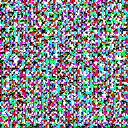

(1, 128, 128, 3)


In [ ]:
# creation of random noise plus some number of conditional variables
noise = tf.convert_to_tensor(np.random.normal(0, 1, 150).astype(np.float32))
noise = tf.reshape(noise, [1, 150])

# running the generator with no training
generated_image = generator(noise, training=False)

cv2_imshow(generated_image[0, :, :, :].numpy()* 255.0**2)
print(generated_image.shape)

batch_size = 64

def train(imgdataset, featdataset, epochs):
  for epoch in range(epochs):
    print("\nEpoch:", epoch)
    GPUs = GPU.getGPUs()
    gpu = GPUs[0]
    def printm():
      process = psutil.Process(os.getpid())
      print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
      print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
    if epoch % 10 == 0:
      printm()
    
    for i in range(0, int(imgdataset.shape[0]), batch_size):
      print("Batch", i, "from", i, "to", i + batch_size)
      train_step(imgdataset[i:min(i+batch_size, imgdataset.shape[0] - 1),:,:,:], featdataset[i:min(i+batch_size, imgdataset.shape[0] - 1),:])



Epoch: 0
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 0.84514475
Disc loss: 1.1035305
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


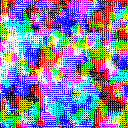

Batch 64 from 64 to 128
Gen loss: 0.8437189
Disc loss: 1.1010549
Disc fake accuracy: 0.890625
Disc real accuracy: 0.96875


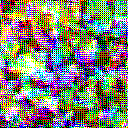

Batch 128 from 128 to 192
Gen loss: 0.8532212
Disc loss: 1.0811057
Disc fake accuracy: 0.921875
Disc real accuracy: 1.0


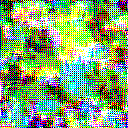

Batch 192 from 192 to 256
Gen loss: 0.84620225
Disc loss: 1.1007484
Disc fake accuracy: 0.875
Disc real accuracy: 0.96875


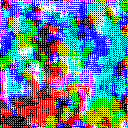

Batch 256 from 256 to 320
Gen loss: 0.8468865
Disc loss: 1.072588
Disc fake accuracy: 0.90625
Disc real accuracy: 0.953125


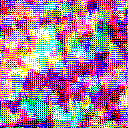

Batch 320 from 320 to 384
Gen loss: 0.8609245
Disc loss: 1.0642915
Disc fake accuracy: 0.921875
Disc real accuracy: 0.953125


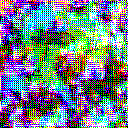

Batch 384 from 384 to 448
Gen loss: 0.85008353
Disc loss: 1.0609348
Disc fake accuracy: 0.890625
Disc real accuracy: 0.984375


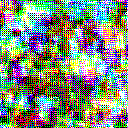

Batch 448 from 448 to 512
Gen loss: 0.8602429
Disc loss: 1.1273206
Disc fake accuracy: 0.921875
Disc real accuracy: 0.90625


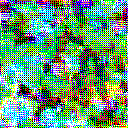

Batch 512 from 512 to 576
Gen loss: 0.8787539
Disc loss: 1.0432342
Disc fake accuracy: 0.96875
Disc real accuracy: 0.921875


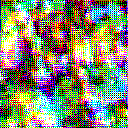

Batch 576 from 576 to 640
Gen loss: 0.845143
Disc loss: 1.1635873
Disc fake accuracy: 0.82051283
Disc real accuracy: 0.84615386


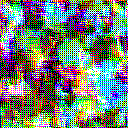


Epoch: 1
Batch 0 from 0 to 64
Gen loss: 0.8619202
Disc loss: 1.0919795
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


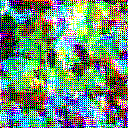

Batch 64 from 64 to 128
Gen loss: 0.8738644
Disc loss: 1.0714521
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


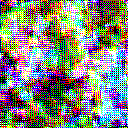

Batch 128 from 128 to 192
Gen loss: 0.8361944
Disc loss: 1.0893171
Disc fake accuracy: 0.921875
Disc real accuracy: 1.0


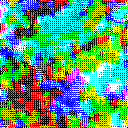

Batch 192 from 192 to 256
Gen loss: 0.8639245
Disc loss: 1.0927094
Disc fake accuracy: 0.96875
Disc real accuracy: 0.953125


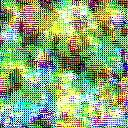

Batch 256 from 256 to 320
Gen loss: 0.8614177
Disc loss: 1.0682384
Disc fake accuracy: 0.890625
Disc real accuracy: 0.953125


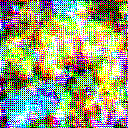

Batch 320 from 320 to 384
Gen loss: 0.86523724
Disc loss: 1.0646431
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


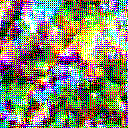

Batch 384 from 384 to 448
Gen loss: 0.86803913
Disc loss: 1.0523956
Disc fake accuracy: 0.921875
Disc real accuracy: 0.984375


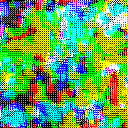

Batch 448 from 448 to 512
Gen loss: 0.8748245
Disc loss: 1.1103642
Disc fake accuracy: 0.9375
Disc real accuracy: 0.984375


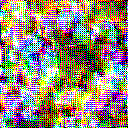

Batch 512 from 512 to 576
Gen loss: 0.8597297
Disc loss: 1.0626359
Disc fake accuracy: 0.890625
Disc real accuracy: 0.984375


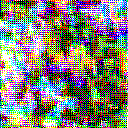

Batch 576 from 576 to 640
Gen loss: 0.8707089
Disc loss: 1.1495824
Disc fake accuracy: 0.8717949
Disc real accuracy: 0.8717949


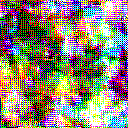


Epoch: 2
Batch 0 from 0 to 64
Gen loss: 0.86176264
Disc loss: 1.0959255
Disc fake accuracy: 0.859375
Disc real accuracy: 1.0


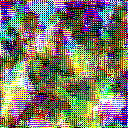

Batch 64 from 64 to 128
Gen loss: 0.8642957
Disc loss: 1.0690148
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


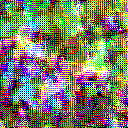

Batch 128 from 128 to 192
Gen loss: 0.8614202
Disc loss: 1.0700494
Disc fake accuracy: 0.875
Disc real accuracy: 0.984375


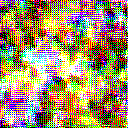

Batch 192 from 192 to 256
Gen loss: 0.8589021
Disc loss: 1.0964837
Disc fake accuracy: 0.921875
Disc real accuracy: 0.984375


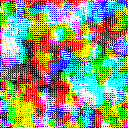

Batch 256 from 256 to 320
Gen loss: 0.8503709
Disc loss: 1.0658948
Disc fake accuracy: 0.84375
Disc real accuracy: 0.953125


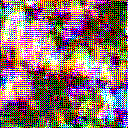

Batch 320 from 320 to 384
Gen loss: 0.86877847
Disc loss: 1.064125
Disc fake accuracy: 0.875
Disc real accuracy: 1.0


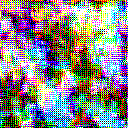

Batch 384 from 384 to 448
Gen loss: 0.8758936
Disc loss: 1.037379
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


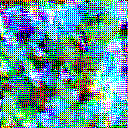

Batch 448 from 448 to 512
Gen loss: 0.88652813
Disc loss: 1.1045082
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


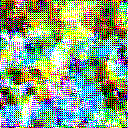

Batch 512 from 512 to 576
Gen loss: 0.88940537
Disc loss: 1.0285941
Disc fake accuracy: 0.953125
Disc real accuracy: 0.984375


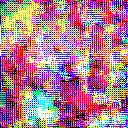

Batch 576 from 576 to 640
Gen loss: 0.8811151
Disc loss: 1.1379715
Disc fake accuracy: 0.8717949
Disc real accuracy: 0.84615386


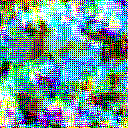


Epoch: 3
Batch 0 from 0 to 64
Gen loss: 0.89750266
Disc loss: 1.0696199
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


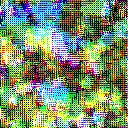

Batch 64 from 64 to 128
Gen loss: 0.8842881
Disc loss: 1.0639203
Disc fake accuracy: 0.953125
Disc real accuracy: 0.96875


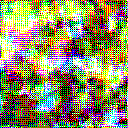

Batch 128 from 128 to 192
Gen loss: 0.8920273
Disc loss: 1.0389488
Disc fake accuracy: 0.953125
Disc real accuracy: 0.96875


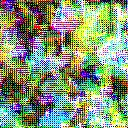

Batch 192 from 192 to 256
Gen loss: 0.88644266
Disc loss: 1.0799835
Disc fake accuracy: 0.921875
Disc real accuracy: 0.96875


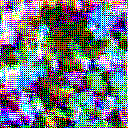

Batch 256 from 256 to 320
Gen loss: 0.8806516
Disc loss: 1.0458107
Disc fake accuracy: 0.9375
Disc real accuracy: 0.953125


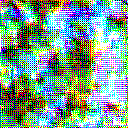

Batch 320 from 320 to 384
Gen loss: 0.89801896
Disc loss: 1.0335193
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


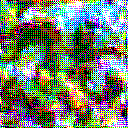

Batch 384 from 384 to 448
Gen loss: 0.8778117
Disc loss: 1.0372324
Disc fake accuracy: 0.890625
Disc real accuracy: 1.0


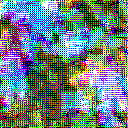

Batch 448 from 448 to 512
Gen loss: 0.8911869
Disc loss: 1.1022743
Disc fake accuracy: 0.921875
Disc real accuracy: 0.921875


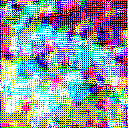

Batch 512 from 512 to 576
Gen loss: 0.8760339
Disc loss: 1.0290462
Disc fake accuracy: 0.921875
Disc real accuracy: 1.0


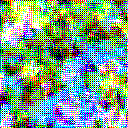

Batch 576 from 576 to 640
Gen loss: 0.89710665
Disc loss: 1.1036111
Disc fake accuracy: 0.9230769
Disc real accuracy: 0.974359


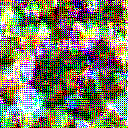


Epoch: 4
Batch 0 from 0 to 64
Gen loss: 0.88730466
Disc loss: 1.0730097
Disc fake accuracy: 0.921875
Disc real accuracy: 0.96875


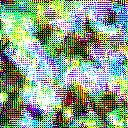

Batch 64 from 64 to 128
Gen loss: 0.8750216
Disc loss: 1.0650585
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


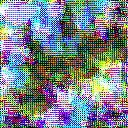

Batch 128 from 128 to 192
Gen loss: 0.89686453
Disc loss: 1.0392997
Disc fake accuracy: 0.890625
Disc real accuracy: 1.0


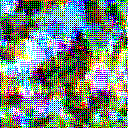

Batch 192 from 192 to 256
Gen loss: 0.89334345
Disc loss: 1.0641754
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


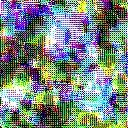

Batch 256 from 256 to 320
Gen loss: 0.8667935
Disc loss: 1.0492474
Disc fake accuracy: 0.859375
Disc real accuracy: 0.953125


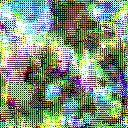

Batch 320 from 320 to 384
Gen loss: 0.8986256
Disc loss: 1.0290594
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


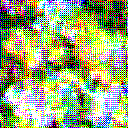

Batch 384 from 384 to 448
Gen loss: 0.91737413
Disc loss: 1.0006446
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


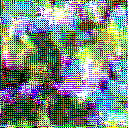

Batch 448 from 448 to 512
Gen loss: 0.88123894
Disc loss: 1.1032729
Disc fake accuracy: 0.890625
Disc real accuracy: 0.90625


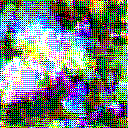

Batch 512 from 512 to 576
Gen loss: 0.88428664
Disc loss: 1.0225401
Disc fake accuracy: 0.953125
Disc real accuracy: 0.984375


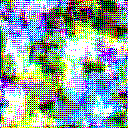

Batch 576 from 576 to 640
Gen loss: 0.8750479
Disc loss: 1.1242219
Disc fake accuracy: 0.8717949
Disc real accuracy: 0.8717949


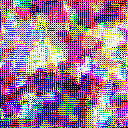


Epoch: 5
Batch 0 from 0 to 64
Gen loss: 0.87304085
Disc loss: 1.0740364
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


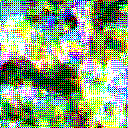

Batch 64 from 64 to 128
Gen loss: 0.8787935
Disc loss: 1.0489941
Disc fake accuracy: 0.875
Disc real accuracy: 1.0


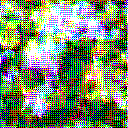

Batch 128 from 128 to 192
Gen loss: 0.8925178
Disc loss: 1.0330274
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


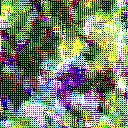

Batch 192 from 192 to 256
Gen loss: 0.87611085
Disc loss: 1.0678186
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


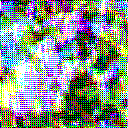

Batch 256 from 256 to 320
Gen loss: 0.9051268
Disc loss: 1.0135283
Disc fake accuracy: 0.953125
Disc real accuracy: 0.96875


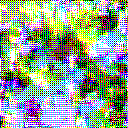

Batch 320 from 320 to 384
Gen loss: 0.88781744
Disc loss: 1.0296693
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


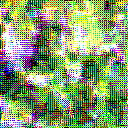

Batch 384 from 384 to 448
Gen loss: 0.8945774
Disc loss: 1.0217049
Disc fake accuracy: 0.875
Disc real accuracy: 1.0


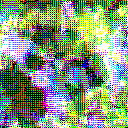

Batch 448 from 448 to 512
Gen loss: 0.90189147
Disc loss: 1.0837061
Disc fake accuracy: 0.953125
Disc real accuracy: 0.984375


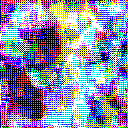

Batch 512 from 512 to 576
Gen loss: 0.90857786
Disc loss: 1.0045257
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


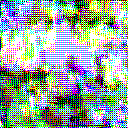

Batch 576 from 576 to 640
Gen loss: 0.88396823
Disc loss: 1.093056
Disc fake accuracy: 0.974359
Disc real accuracy: 0.8974359


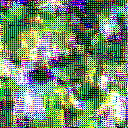


Epoch: 6
Batch 0 from 0 to 64
Gen loss: 0.87198025
Disc loss: 1.0674965
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


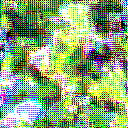

Batch 64 from 64 to 128
Gen loss: 0.8925581
Disc loss: 1.0451863
Disc fake accuracy: 0.9375
Disc real accuracy: 0.984375


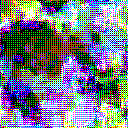

Batch 128 from 128 to 192
Gen loss: 0.8776906
Disc loss: 1.0433959
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


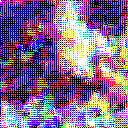

Batch 192 from 192 to 256
Gen loss: 0.9160623
Disc loss: 1.0468776
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


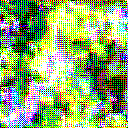

Batch 256 from 256 to 320
Gen loss: 0.8941344
Disc loss: 1.0209205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


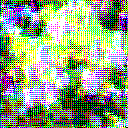

Batch 320 from 320 to 384
Gen loss: 0.88030916
Disc loss: 1.0322664
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


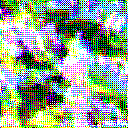

Batch 384 from 384 to 448
Gen loss: 0.91864216
Disc loss: 0.9938413
Disc fake accuracy: 0.9375
Disc real accuracy: 0.984375


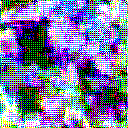

Batch 448 from 448 to 512
Gen loss: 0.8923538
Disc loss: 1.0970265
Disc fake accuracy: 0.90625
Disc real accuracy: 0.96875


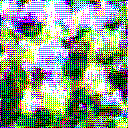

Batch 512 from 512 to 576
Gen loss: 0.9280062
Disc loss: 0.98889506
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


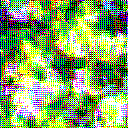

Batch 576 from 576 to 640
Gen loss: 0.87833667
Disc loss: 1.1138031
Disc fake accuracy: 0.8717949
Disc real accuracy: 0.8974359


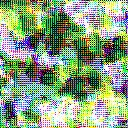


Epoch: 7
Batch 0 from 0 to 64
Gen loss: 0.8780062
Disc loss: 1.060311
Disc fake accuracy: 0.9375
Disc real accuracy: 0.984375


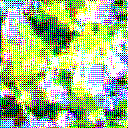

Batch 64 from 64 to 128
Gen loss: 0.8841127
Disc loss: 1.0497775
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


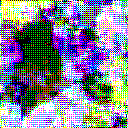

Batch 128 from 128 to 192
Gen loss: 0.88988197
Disc loss: 1.0257027
Disc fake accuracy: 0.9375
Disc real accuracy: 0.984375


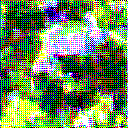

Batch 192 from 192 to 256
Gen loss: 0.92145836
Disc loss: 1.0361948
Disc fake accuracy: 0.9375
Disc real accuracy: 0.953125


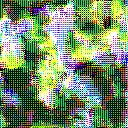

Batch 256 from 256 to 320
Gen loss: 0.9010996
Disc loss: 1.0240271
Disc fake accuracy: 0.90625
Disc real accuracy: 0.984375


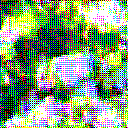

Batch 320 from 320 to 384
Gen loss: 0.9188044
Disc loss: 1.009017
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


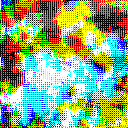

Batch 384 from 384 to 448
Gen loss: 0.9047565
Disc loss: 0.9973269
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


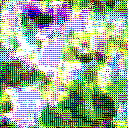

Batch 448 from 448 to 512
Gen loss: 0.91897905
Disc loss: 1.0603877
Disc fake accuracy: 0.953125
Disc real accuracy: 0.984375


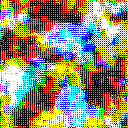

Batch 512 from 512 to 576
Gen loss: 0.9054837
Disc loss: 1.0061519
Disc fake accuracy: 0.890625
Disc real accuracy: 0.984375


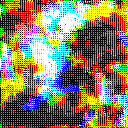

Batch 576 from 576 to 640
Gen loss: 0.9041551
Disc loss: 1.0883383
Disc fake accuracy: 0.974359
Disc real accuracy: 0.8717949


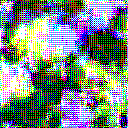


Epoch: 8
Batch 0 from 0 to 64
Gen loss: 0.9203257
Disc loss: 1.0280311
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


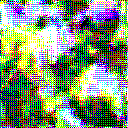

Batch 64 from 64 to 128
Gen loss: 0.9052711
Disc loss: 1.0292585
Disc fake accuracy: 0.9375
Disc real accuracy: 0.984375


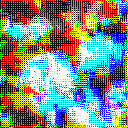

Batch 128 from 128 to 192
Gen loss: 0.90862596
Disc loss: 1.0063701
Disc fake accuracy: 0.953125
Disc real accuracy: 0.984375


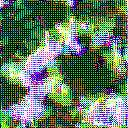

Batch 192 from 192 to 256
Gen loss: 0.915115
Disc loss: 1.0343456
Disc fake accuracy: 0.9375
Disc real accuracy: 0.96875


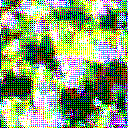

Batch 256 from 256 to 320
Gen loss: 0.89265525
Disc loss: 1.0109217
Disc fake accuracy: 0.9375
Disc real accuracy: 0.96875


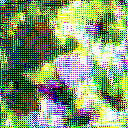

Batch 320 from 320 to 384
Gen loss: 0.9048977
Disc loss: 1.008117
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


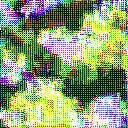

Batch 384 from 384 to 448
Gen loss: 0.89913267
Disc loss: 0.99650294
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


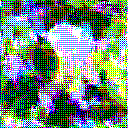

Batch 448 from 448 to 512
Gen loss: 0.88479364
Disc loss: 1.0780053
Disc fake accuracy: 0.953125
Disc real accuracy: 0.921875


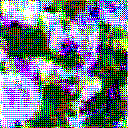

Batch 512 from 512 to 576
Gen loss: 0.88611925
Disc loss: 1.0124604
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


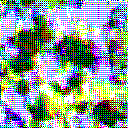

Batch 576 from 576 to 640
Gen loss: 0.927299
Disc loss: 1.0688279
Disc fake accuracy: 0.9230769
Disc real accuracy: 0.94871795


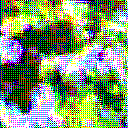


Epoch: 9
Batch 0 from 0 to 64
Gen loss: 0.89514923
Disc loss: 1.0328524
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


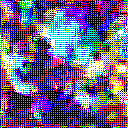

Batch 64 from 64 to 128
Gen loss: 0.9014467
Disc loss: 1.0278406
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


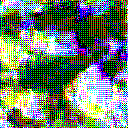

Batch 128 from 128 to 192
Gen loss: 0.8963191
Disc loss: 1.0069418
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


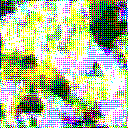

Batch 192 from 192 to 256
Gen loss: 0.8967327
Disc loss: 1.0430436
Disc fake accuracy: 0.890625
Disc real accuracy: 1.0


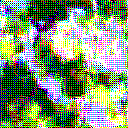

Batch 256 from 256 to 320
Gen loss: 0.9436958
Disc loss: 0.98282593
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


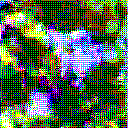

Batch 320 from 320 to 384
Gen loss: 0.90915
Disc loss: 1.0058239
Disc fake accuracy: 0.90625
Disc real accuracy: 1.0


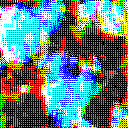

Batch 384 from 384 to 448
Gen loss: 0.9038578
Disc loss: 0.9903289
Disc fake accuracy: 0.90625
Disc real accuracy: 0.984375


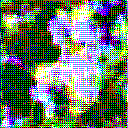

Batch 448 from 448 to 512
Gen loss: 0.93658537
Disc loss: 1.0478683
Disc fake accuracy: 0.96875
Disc real accuracy: 0.921875


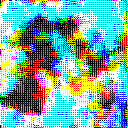

Batch 512 from 512 to 576
Gen loss: 0.927203
Disc loss: 0.9718926
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


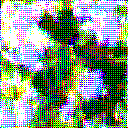

Batch 576 from 576 to 640
Gen loss: 0.93455136
Disc loss: 1.0563364
Disc fake accuracy: 0.974359
Disc real accuracy: 0.8717949


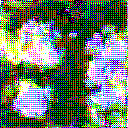


Epoch: 10
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 0.9186202
Disc loss: 1.0200894
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


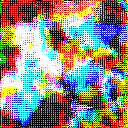

Batch 64 from 64 to 128
Gen loss: 0.9248775
Disc loss: 1.0128657
Disc fake accuracy: 0.96875
Disc real accuracy: 0.953125


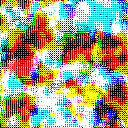

Batch 128 from 128 to 192
Gen loss: 0.94518244
Disc loss: 0.972051
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


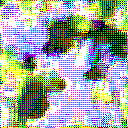

Batch 192 from 192 to 256
Gen loss: 0.9287792
Disc loss: 1.0154853
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


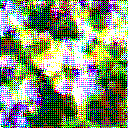

Batch 256 from 256 to 320
Gen loss: 0.93840134
Disc loss: 0.97675633
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


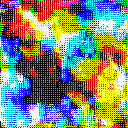

Batch 320 from 320 to 384
Gen loss: 0.93088365
Disc loss: 0.9831569
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


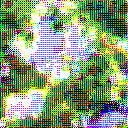

Batch 384 from 384 to 448
Gen loss: 0.9954597
Disc loss: 0.92735827
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


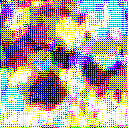

Batch 448 from 448 to 512
Gen loss: 0.9391679
Disc loss: 1.0457996
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


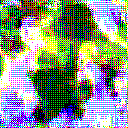

Batch 512 from 512 to 576
Gen loss: 0.94025874
Disc loss: 0.9586377
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


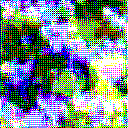

Batch 576 from 576 to 640
Gen loss: 0.92996585
Disc loss: 1.0596019
Disc fake accuracy: 0.94871795
Disc real accuracy: 0.94871795


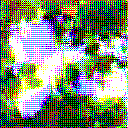


Epoch: 11
Batch 0 from 0 to 64
Gen loss: 0.95287156
Disc loss: 0.9927696
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


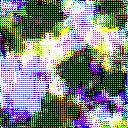

Batch 64 from 64 to 128
Gen loss: 0.9210124
Disc loss: 1.0058632
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


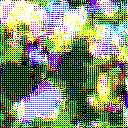

Batch 128 from 128 to 192
Gen loss: 0.9355165
Disc loss: 0.97539276
Disc fake accuracy: 0.953125
Disc real accuracy: 0.984375


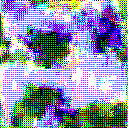

Batch 192 from 192 to 256
Gen loss: 0.9501328
Disc loss: 0.9967603
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


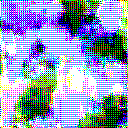

Batch 256 from 256 to 320
Gen loss: 0.9537269
Disc loss: 0.96235573
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


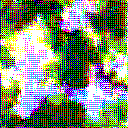

Batch 320 from 320 to 384
Gen loss: 0.95950216
Disc loss: 0.9557606
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


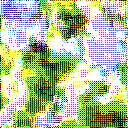

Batch 384 from 384 to 448
Gen loss: 0.955611
Disc loss: 0.9481292
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


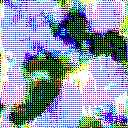

Batch 448 from 448 to 512
Gen loss: 0.95759547
Disc loss: 1.0273716
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


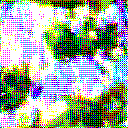

Batch 512 from 512 to 576
Gen loss: 0.95612764
Disc loss: 0.94838095
Disc fake accuracy: 0.984375
Disc real accuracy: 0.984375


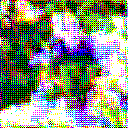

Batch 576 from 576 to 640
Gen loss: 0.91063493
Disc loss: 1.0769011
Disc fake accuracy: 0.94871795
Disc real accuracy: 0.94871795


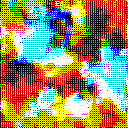


Epoch: 12
Batch 0 from 0 to 64
Gen loss: 0.9526716
Disc loss: 0.9755528
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


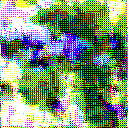

Batch 64 from 64 to 128
Gen loss: 0.9267978
Disc loss: 0.99354154
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


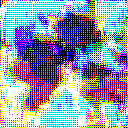

Batch 128 from 128 to 192
Gen loss: 0.9884781
Disc loss: 0.9337991
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


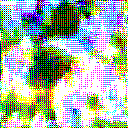

Batch 192 from 192 to 256
Gen loss: 0.9732347
Disc loss: 0.9791925
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


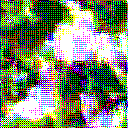

Batch 256 from 256 to 320
Gen loss: 0.9503727
Disc loss: 0.9639683
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


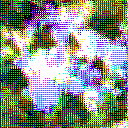

Batch 320 from 320 to 384
Gen loss: 0.956476
Disc loss: 0.9599021
Disc fake accuracy: 0.984375
Disc real accuracy: 0.984375


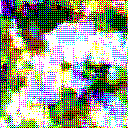

Batch 384 from 384 to 448
Gen loss: 1.0130979
Disc loss: 0.9074589
Disc fake accuracy: 0.984375
Disc real accuracy: 0.984375


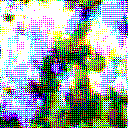

Batch 448 from 448 to 512
Gen loss: 0.9723619
Disc loss: 1.0308149
Disc fake accuracy: 0.96875
Disc real accuracy: 0.890625


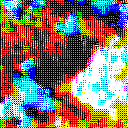

Batch 512 from 512 to 576
Gen loss: 0.95061445
Disc loss: 0.945671
Disc fake accuracy: 0.984375
Disc real accuracy: 0.984375


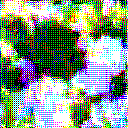

Batch 576 from 576 to 640
Gen loss: 0.97813374
Disc loss: 1.0236702
Disc fake accuracy: 0.94871795
Disc real accuracy: 0.94871795


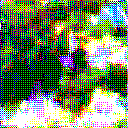


Epoch: 13
Batch 0 from 0 to 64
Gen loss: 0.9223646
Disc loss: 0.99168146
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


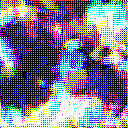

Batch 64 from 64 to 128
Gen loss: 0.98564863
Disc loss: 0.9586179
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


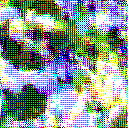

Batch 128 from 128 to 192
Gen loss: 0.9576672
Disc loss: 0.94734764
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


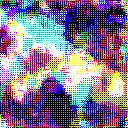

Batch 192 from 192 to 256
Gen loss: 0.9607974
Disc loss: 0.9911733
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


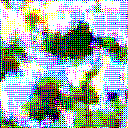

Batch 256 from 256 to 320
Gen loss: 0.9621945
Disc loss: 0.9502685
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


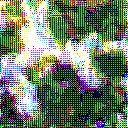

Batch 320 from 320 to 384
Gen loss: 0.9418081
Disc loss: 0.96422404
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


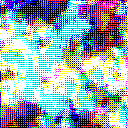

Batch 384 from 384 to 448
Gen loss: 0.94935083
Disc loss: 0.9429956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


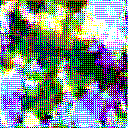

Batch 448 from 448 to 512
Gen loss: 0.976065
Disc loss: 1.0011872
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


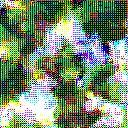

Batch 512 from 512 to 576
Gen loss: 0.9705763
Disc loss: 0.933876
Disc fake accuracy: 0.984375
Disc real accuracy: 0.984375


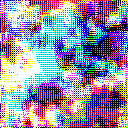

Batch 576 from 576 to 640
Gen loss: 0.9952301
Disc loss: 1.0062141
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


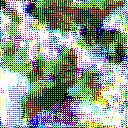


Epoch: 14
Batch 0 from 0 to 64
Gen loss: 0.96461654
Disc loss: 0.9575614
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


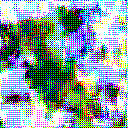

Batch 64 from 64 to 128
Gen loss: 0.95374846
Disc loss: 0.9692331
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


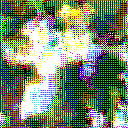

Batch 128 from 128 to 192
Gen loss: 0.9706024
Disc loss: 0.9302781
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


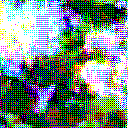

Batch 192 from 192 to 256
Gen loss: 0.9934725
Disc loss: 0.96539724
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


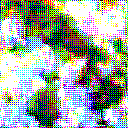

Batch 256 from 256 to 320
Gen loss: 0.98159873
Disc loss: 0.9285451
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


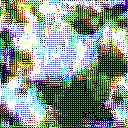

Batch 320 from 320 to 384
Gen loss: 0.96344876
Disc loss: 0.94146836
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


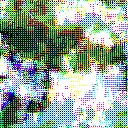

Batch 384 from 384 to 448
Gen loss: 0.9901702
Disc loss: 0.9015882
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


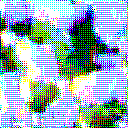

Batch 448 from 448 to 512
Gen loss: 0.9706201
Disc loss: 1.0067232
Disc fake accuracy: 0.96875
Disc real accuracy: 0.96875


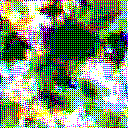

Batch 512 from 512 to 576
Gen loss: 0.9830064
Disc loss: 0.9117181
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


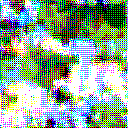

Batch 576 from 576 to 640
Gen loss: 1.003328
Disc loss: 1.0074288
Disc fake accuracy: 0.974359
Disc real accuracy: 0.8717949


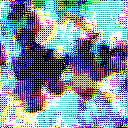


Epoch: 15
Batch 0 from 0 to 64
Gen loss: 0.9986986
Disc loss: 0.92730916
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


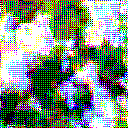

Batch 64 from 64 to 128
Gen loss: 0.9936275
Disc loss: 0.9383578
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


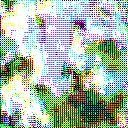

Batch 128 from 128 to 192
Gen loss: 0.9016259
Disc loss: 0.98029053
Disc fake accuracy: 0.921875
Disc real accuracy: 1.0


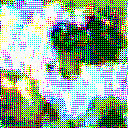

Batch 192 from 192 to 256
Gen loss: 0.98012483
Disc loss: 0.96173805
Disc fake accuracy: 1.0
Disc real accuracy: 0.953125


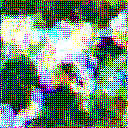

Batch 256 from 256 to 320
Gen loss: 0.97374356
Disc loss: 0.9335693
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


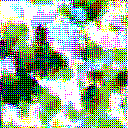

Batch 320 from 320 to 384
Gen loss: 1.0041269
Disc loss: 0.91562337
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


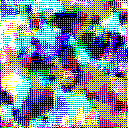

Batch 384 from 384 to 448
Gen loss: 0.9968526
Disc loss: 0.8978232
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


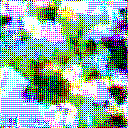

Batch 448 from 448 to 512
Gen loss: 0.9685385
Disc loss: 1.0048323
Disc fake accuracy: 0.984375
Disc real accuracy: 0.921875


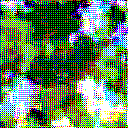

Batch 512 from 512 to 576
Gen loss: 0.96950316
Disc loss: 0.91868424
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


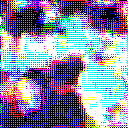

Batch 576 from 576 to 640
Gen loss: 1.0020059
Disc loss: 0.97918344
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


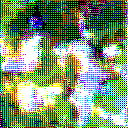


Epoch: 16
Batch 0 from 0 to 64
Gen loss: 0.96880436
Disc loss: 0.9473713
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


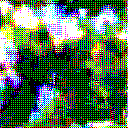

Batch 64 from 64 to 128
Gen loss: 0.9476236
Disc loss: 0.97183484
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


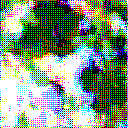

Batch 128 from 128 to 192
Gen loss: 1.0136483
Disc loss: 0.90234655
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


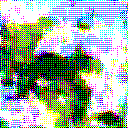

Batch 192 from 192 to 256
Gen loss: 0.9839287
Disc loss: 0.9564666
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


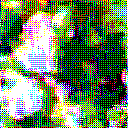

Batch 256 from 256 to 320
Gen loss: 0.9624392
Disc loss: 0.9416698
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


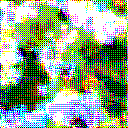

Batch 320 from 320 to 384
Gen loss: 1.0095991
Disc loss: 0.91113305
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


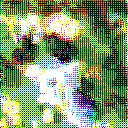

Batch 384 from 384 to 448
Gen loss: 0.96634865
Disc loss: 0.9098223
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


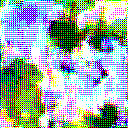

Batch 448 from 448 to 512
Gen loss: 0.99263763
Disc loss: 0.9838982
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


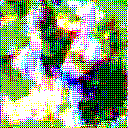

Batch 512 from 512 to 576
Gen loss: 1.0017911
Disc loss: 0.8965939
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


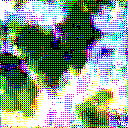

Batch 576 from 576 to 640
Gen loss: 0.9945438
Disc loss: 0.98881024
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


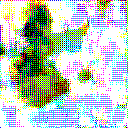


Epoch: 17
Batch 0 from 0 to 64
Gen loss: 1.0069325
Disc loss: 0.91672003
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


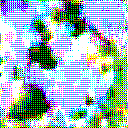

Batch 64 from 64 to 128
Gen loss: 0.9748575
Disc loss: 0.94814634
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


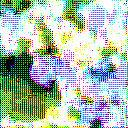

Batch 128 from 128 to 192
Gen loss: 0.94585884
Disc loss: 0.93309134
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


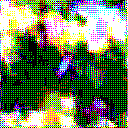

Batch 192 from 192 to 256
Gen loss: 1.0001338
Disc loss: 0.94534534
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


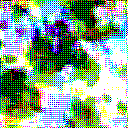

Batch 256 from 256 to 320
Gen loss: 0.99585503
Disc loss: 0.91386425
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


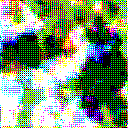

Batch 320 from 320 to 384
Gen loss: 1.0091555
Disc loss: 0.90289575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


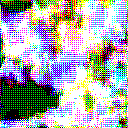

Batch 384 from 384 to 448
Gen loss: 0.98501074
Disc loss: 0.89439476
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


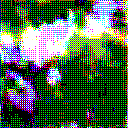

Batch 448 from 448 to 512
Gen loss: 0.98612905
Disc loss: 0.98502135
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


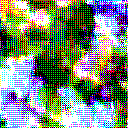

Batch 512 from 512 to 576
Gen loss: 0.9890238
Disc loss: 0.89735246
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


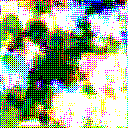

Batch 576 from 576 to 640
Gen loss: 1.0238547
Disc loss: 0.97909606
Disc fake accuracy: 1.0
Disc real accuracy: 0.8717949


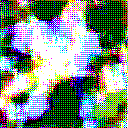


Epoch: 18
Batch 0 from 0 to 64
Gen loss: 0.98086655
Disc loss: 0.93087816
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


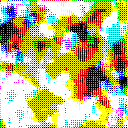

Batch 64 from 64 to 128
Gen loss: 1.0041232
Disc loss: 0.9282851
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


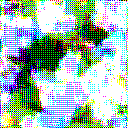

Batch 128 from 128 to 192
Gen loss: 0.99401426
Disc loss: 0.9092053
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


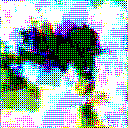

Batch 192 from 192 to 256
Gen loss: 0.9801921
Disc loss: 0.958249
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


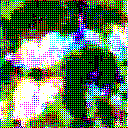

Batch 256 from 256 to 320
Gen loss: 0.98946095
Disc loss: 0.91369295
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


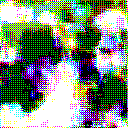

Batch 320 from 320 to 384
Gen loss: 0.9978988
Disc loss: 0.91579705
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


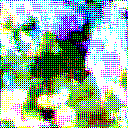

Batch 384 from 384 to 448
Gen loss: 0.9798077
Disc loss: 0.9016092
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


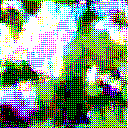

Batch 448 from 448 to 512
Gen loss: 0.9831722
Disc loss: 0.9843984
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


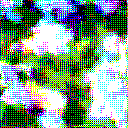

Batch 512 from 512 to 576
Gen loss: 0.97777414
Disc loss: 0.9025536
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


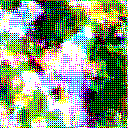

Batch 576 from 576 to 640
Gen loss: 0.9678774
Disc loss: 0.9951931
Disc fake accuracy: 0.94871795
Disc real accuracy: 0.94871795


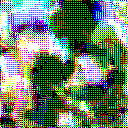


Epoch: 19
Batch 0 from 0 to 64
Gen loss: 0.96930677
Disc loss: 0.94110787
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


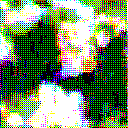

Batch 64 from 64 to 128
Gen loss: 1.002423
Disc loss: 0.9289672
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


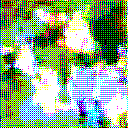

Batch 128 from 128 to 192
Gen loss: 0.98003125
Disc loss: 0.9180968
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


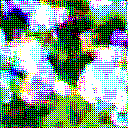

Batch 192 from 192 to 256
Gen loss: 0.9832091
Disc loss: 0.9520726
Disc fake accuracy: 0.953125
Disc real accuracy: 0.96875


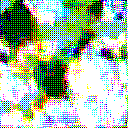

Batch 256 from 256 to 320
Gen loss: 0.9872078
Disc loss: 0.9153461
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


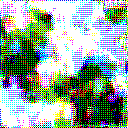

Batch 320 from 320 to 384
Gen loss: 0.9758489
Disc loss: 0.92052567
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


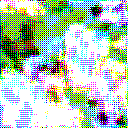

Batch 384 from 384 to 448
Gen loss: 1.0245848
Disc loss: 0.8723646
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


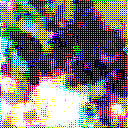

Batch 448 from 448 to 512
Gen loss: 0.97307974
Disc loss: 0.9913696
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


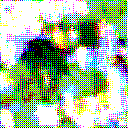

Batch 512 from 512 to 576
Gen loss: 0.9846933
Disc loss: 0.8940402
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


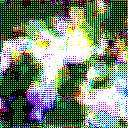

Batch 576 from 576 to 640
Gen loss: 1.0213414
Disc loss: 0.9813391
Disc fake accuracy: 0.9230769
Disc real accuracy: 0.94871795


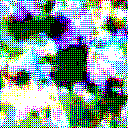


Epoch: 20
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.0150979
Disc loss: 0.9110166
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


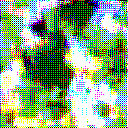

Batch 64 from 64 to 128
Gen loss: 0.9876087
Disc loss: 0.9311047
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


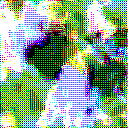

Batch 128 from 128 to 192
Gen loss: 0.9775851
Disc loss: 0.9156848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


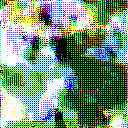

Batch 192 from 192 to 256
Gen loss: 1.0317795
Disc loss: 0.9293325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


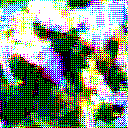

Batch 256 from 256 to 320
Gen loss: 1.0038915
Disc loss: 0.90619045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


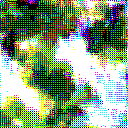

Batch 320 from 320 to 384
Gen loss: 1.0414429
Disc loss: 0.8858675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


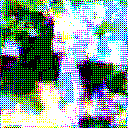

Batch 384 from 384 to 448
Gen loss: 1.0017297
Disc loss: 0.8885312
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


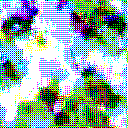

Batch 448 from 448 to 512
Gen loss: 1.0020353
Disc loss: 0.9644582
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


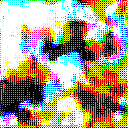

Batch 512 from 512 to 576
Gen loss: 1.0110822
Disc loss: 0.8829531
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


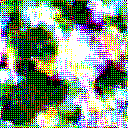

Batch 576 from 576 to 640
Gen loss: 1.0484486
Disc loss: 0.9639187
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


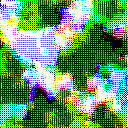


Epoch: 21
Batch 0 from 0 to 64
Gen loss: 1.031757
Disc loss: 0.89868426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


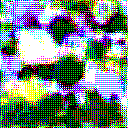

Batch 64 from 64 to 128
Gen loss: 0.98011345
Disc loss: 0.93737674
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


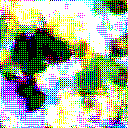

Batch 128 from 128 to 192
Gen loss: 1.0058205
Disc loss: 0.8890228
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


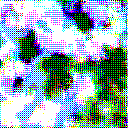

Batch 192 from 192 to 256
Gen loss: 0.9861579
Disc loss: 0.94613534
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


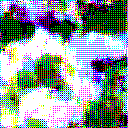

Batch 256 from 256 to 320
Gen loss: 0.99213845
Disc loss: 0.907377
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


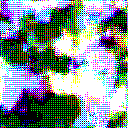

Batch 320 from 320 to 384
Gen loss: 1.034996
Disc loss: 0.87661964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


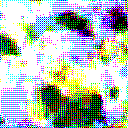

Batch 384 from 384 to 448
Gen loss: 0.99659675
Disc loss: 0.8783606
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


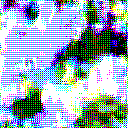

Batch 448 from 448 to 512
Gen loss: 0.9936166
Disc loss: 0.9858721
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


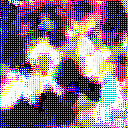

Batch 512 from 512 to 576
Gen loss: 1.0086108
Disc loss: 0.8762198
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


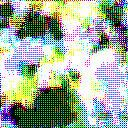

Batch 576 from 576 to 640
Gen loss: 1.0210346
Disc loss: 0.9656004
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


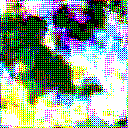


Epoch: 22
Batch 0 from 0 to 64
Gen loss: 1.0367578
Disc loss: 0.8913393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


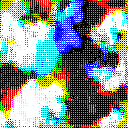

Batch 64 from 64 to 128
Gen loss: 1.0520182
Disc loss: 0.8896339
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


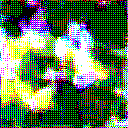

Batch 128 from 128 to 192
Gen loss: 1.0002115
Disc loss: 0.89433575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


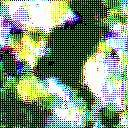

Batch 192 from 192 to 256
Gen loss: 1.0365964
Disc loss: 0.9130995
Disc fake accuracy: 1.0
Disc real accuracy: 0.953125


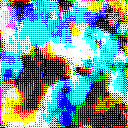

Batch 256 from 256 to 320
Gen loss: 1.0075645
Disc loss: 0.8951051
Disc fake accuracy: 0.96875
Disc real accuracy: 0.953125


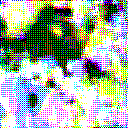

Batch 320 from 320 to 384
Gen loss: 1.0244734
Disc loss: 0.8835732
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


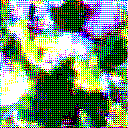

Batch 384 from 384 to 448
Gen loss: 1.0554788
Disc loss: 0.847667
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


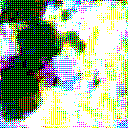

Batch 448 from 448 to 512
Gen loss: 0.9945878
Disc loss: 0.9752934
Disc fake accuracy: 0.90625
Disc real accuracy: 0.921875


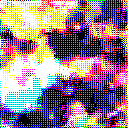

Batch 512 from 512 to 576
Gen loss: 1.0244306
Disc loss: 0.86983585
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


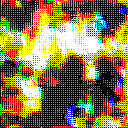

Batch 576 from 576 to 640
Gen loss: 1.0437653
Disc loss: 0.9370394
Disc fake accuracy: 1.0
Disc real accuracy: 0.94871795


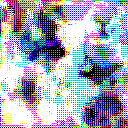


Epoch: 23
Batch 0 from 0 to 64
Gen loss: 0.98042303
Disc loss: 0.9320791
Disc fake accuracy: 0.921875
Disc real accuracy: 1.0


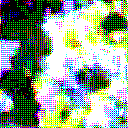

Batch 64 from 64 to 128
Gen loss: 0.9968565
Disc loss: 0.9286088
Disc fake accuracy: 0.921875
Disc real accuracy: 0.984375


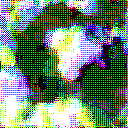

Batch 128 from 128 to 192
Gen loss: 0.99379724
Disc loss: 0.8980912
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


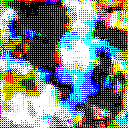

Batch 192 from 192 to 256
Gen loss: 1.0765871
Disc loss: 0.8983957
Disc fake accuracy: 1.0
Disc real accuracy: 0.9375


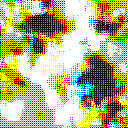

Batch 256 from 256 to 320
Gen loss: 0.9777151
Disc loss: 0.9104167
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


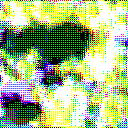

Batch 320 from 320 to 384
Gen loss: 1.0572523
Disc loss: 0.8617028
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


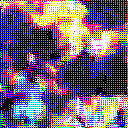

Batch 384 from 384 to 448
Gen loss: 1.0111976
Disc loss: 0.86973274
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


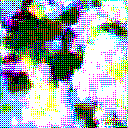

Batch 448 from 448 to 512
Gen loss: 1.0596752
Disc loss: 0.9376435
Disc fake accuracy: 0.984375
Disc real accuracy: 0.984375


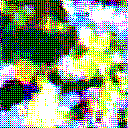

Batch 512 from 512 to 576
Gen loss: 1.039796
Disc loss: 0.85902834
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


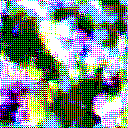

Batch 576 from 576 to 640
Gen loss: 1.0850265
Disc loss: 0.9493203
Disc fake accuracy: 1.0
Disc real accuracy: 0.8717949


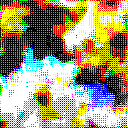


Epoch: 24
Batch 0 from 0 to 64
Gen loss: 1.006486
Disc loss: 0.9106267
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


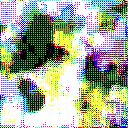

Batch 64 from 64 to 128
Gen loss: 1.0202756
Disc loss: 0.9096023
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


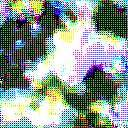

Batch 128 from 128 to 192
Gen loss: 1.0652565
Disc loss: 0.85130054
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


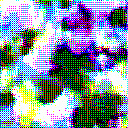

Batch 192 from 192 to 256
Gen loss: 1.0123993
Disc loss: 0.92619896
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


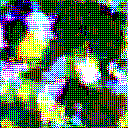

Batch 256 from 256 to 320
Gen loss: 1.074871
Disc loss: 0.85316753
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


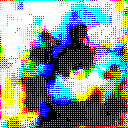

Batch 320 from 320 to 384
Gen loss: 1.0570627
Disc loss: 0.8609179
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


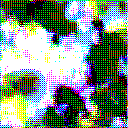

Batch 384 from 384 to 448
Gen loss: 1.0309542
Disc loss: 0.8587352
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


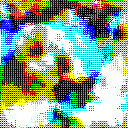

Batch 448 from 448 to 512
Gen loss: 1.0867709
Disc loss: 0.90811104
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


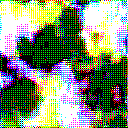

Batch 512 from 512 to 576
Gen loss: 1.0778906
Disc loss: 0.84263366
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


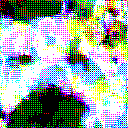

Batch 576 from 576 to 640
Gen loss: 1.0653268
Disc loss: 0.9502675
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


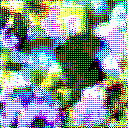


Epoch: 25
Batch 0 from 0 to 64
Gen loss: 1.0560234
Disc loss: 0.87340665
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


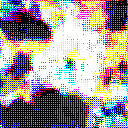

Batch 64 from 64 to 128
Gen loss: 1.0118041
Disc loss: 0.9050546
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


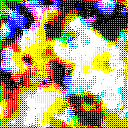

Batch 128 from 128 to 192
Gen loss: 1.0272493
Disc loss: 0.8602284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


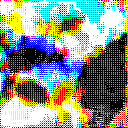

Batch 192 from 192 to 256
Gen loss: 1.006574
Disc loss: 0.91922855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


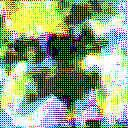

Batch 256 from 256 to 320
Gen loss: 1.0054064
Disc loss: 0.8886944
Disc fake accuracy: 0.96875
Disc real accuracy: 0.96875


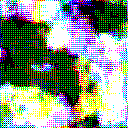

Batch 320 from 320 to 384
Gen loss: 1.042443
Disc loss: 0.8653779
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


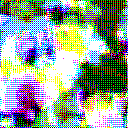

Batch 384 from 384 to 448
Gen loss: 1.0340099
Disc loss: 0.8518525
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


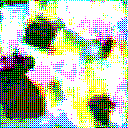

Batch 448 from 448 to 512
Gen loss: 1.0702951
Disc loss: 0.9166028
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


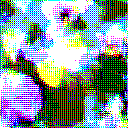

Batch 512 from 512 to 576
Gen loss: 1.0184674
Disc loss: 0.85993004
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


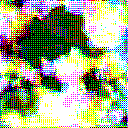

Batch 576 from 576 to 640
Gen loss: 1.0569227
Disc loss: 0.9413453
Disc fake accuracy: 0.974359
Disc real accuracy: 0.8717949


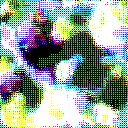


Epoch: 26
Batch 0 from 0 to 64
Gen loss: 0.99670255
Disc loss: 0.89684135
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


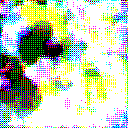

Batch 64 from 64 to 128
Gen loss: 1.0025799
Disc loss: 0.9023297
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


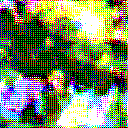

Batch 128 from 128 to 192
Gen loss: 1.0230587
Disc loss: 0.86132884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


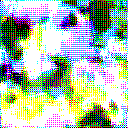

Batch 192 from 192 to 256
Gen loss: 1.0661447
Disc loss: 0.8854385
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


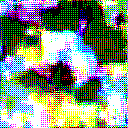

Batch 256 from 256 to 320
Gen loss: 1.0172068
Disc loss: 0.8789333
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


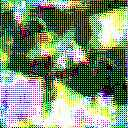

Batch 320 from 320 to 384
Gen loss: 1.0409229
Disc loss: 0.8621192
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


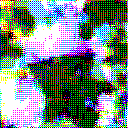

Batch 384 from 384 to 448
Gen loss: 1.0425104
Disc loss: 0.843007
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


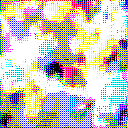

Batch 448 from 448 to 512
Gen loss: 1.0497134
Disc loss: 0.9259454
Disc fake accuracy: 0.984375
Disc real accuracy: 0.921875


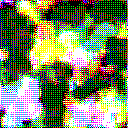

Batch 512 from 512 to 576
Gen loss: 1.0617445
Disc loss: 0.8349039
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


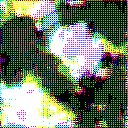

Batch 576 from 576 to 640
Gen loss: 1.0627139
Disc loss: 0.9273249
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


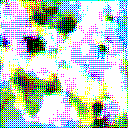


Epoch: 27
Batch 0 from 0 to 64
Gen loss: 1.0312812
Disc loss: 0.88395435
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


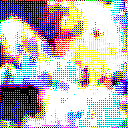

Batch 64 from 64 to 128
Gen loss: 1.0287403
Disc loss: 0.88840175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


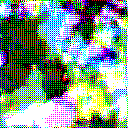

Batch 128 from 128 to 192
Gen loss: 1.0482798
Disc loss: 0.8386122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


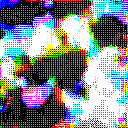

Batch 192 from 192 to 256
Gen loss: 1.035491
Disc loss: 0.903078
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


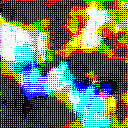

Batch 256 from 256 to 320
Gen loss: 1.0520885
Disc loss: 0.8505528
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


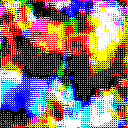

Batch 320 from 320 to 384
Gen loss: 1.071821
Disc loss: 0.83785105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


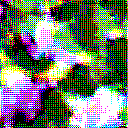

Batch 384 from 384 to 448
Gen loss: 1.0581024
Disc loss: 0.8257317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


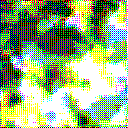

Batch 448 from 448 to 512
Gen loss: 1.0994904
Disc loss: 0.9036213
Disc fake accuracy: 1.0
Disc real accuracy: 0.953125


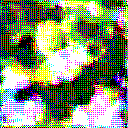

Batch 512 from 512 to 576
Gen loss: 1.0458701
Disc loss: 0.8405843
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


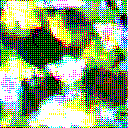

Batch 576 from 576 to 640
Gen loss: 1.0053407
Disc loss: 0.94225025
Disc fake accuracy: 0.9230769
Disc real accuracy: 0.94871795


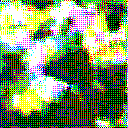


Epoch: 28
Batch 0 from 0 to 64
Gen loss: 1.0504133
Disc loss: 0.8666562
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


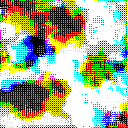

Batch 64 from 64 to 128
Gen loss: 1.035938
Disc loss: 0.87999666
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


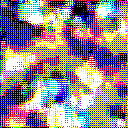

Batch 128 from 128 to 192
Gen loss: 1.0367882
Disc loss: 0.8528329
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


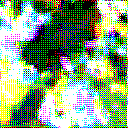

Batch 192 from 192 to 256
Gen loss: 1.0770965
Disc loss: 0.87358534
Disc fake accuracy: 0.96875
Disc real accuracy: 0.96875


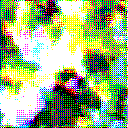

Batch 256 from 256 to 320
Gen loss: 1.0345582
Disc loss: 0.8569205
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


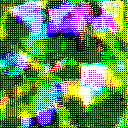

Batch 320 from 320 to 384
Gen loss: 0.9831777
Disc loss: 0.88778114
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


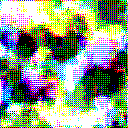

Batch 384 from 384 to 448
Gen loss: 1.0427377
Disc loss: 0.82907563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


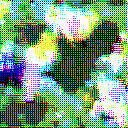

Batch 448 from 448 to 512
Gen loss: 1.0518901
Disc loss: 0.9105723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


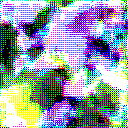

Batch 512 from 512 to 576
Gen loss: 1.0433164
Disc loss: 0.8356399
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


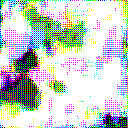

Batch 576 from 576 to 640
Gen loss: 1.0532272
Disc loss: 0.92042077
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


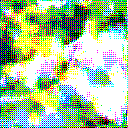


Epoch: 29
Batch 0 from 0 to 64
Gen loss: 1.0490422
Disc loss: 0.85707074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


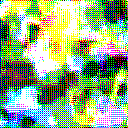

Batch 64 from 64 to 128
Gen loss: 1.032881
Disc loss: 0.8872293
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


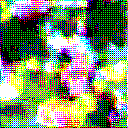

Batch 128 from 128 to 192
Gen loss: 1.0276846
Disc loss: 0.8667481
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


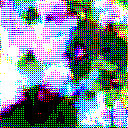

Batch 192 from 192 to 256
Gen loss: 1.0689886
Disc loss: 0.87852055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


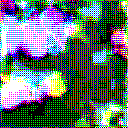

Batch 256 from 256 to 320
Gen loss: 1.0515087
Disc loss: 0.85716856
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


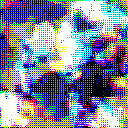

Batch 320 from 320 to 384
Gen loss: 1.0476949
Disc loss: 0.8596953
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


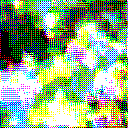

Batch 384 from 384 to 448
Gen loss: 1.0490383
Disc loss: 0.8311283
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


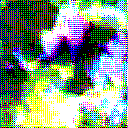

Batch 448 from 448 to 512
Gen loss: 1.0641618
Disc loss: 0.9125271
Disc fake accuracy: 0.96875
Disc real accuracy: 0.984375


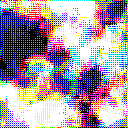

Batch 512 from 512 to 576
Gen loss: 1.0192698
Disc loss: 0.84796816
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


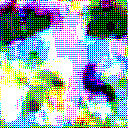

Batch 576 from 576 to 640
Gen loss: 1.0239605
Disc loss: 0.9315924
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


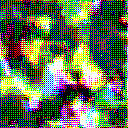


Epoch: 30
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.040509
Disc loss: 0.8738099
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


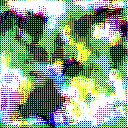

Batch 64 from 64 to 128
Gen loss: 1.0635967
Disc loss: 0.87005275
Disc fake accuracy: 0.953125
Disc real accuracy: 0.984375


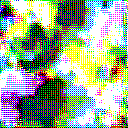

Batch 128 from 128 to 192
Gen loss: 1.0455078
Disc loss: 0.8492241
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


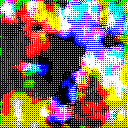

Batch 192 from 192 to 256
Gen loss: 1.0468551
Disc loss: 0.88949835
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


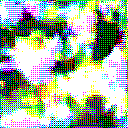

Batch 256 from 256 to 320
Gen loss: 1.0912639
Disc loss: 0.8263687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


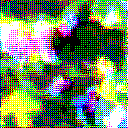

Batch 320 from 320 to 384
Gen loss: 1.0119483
Disc loss: 0.87057793
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


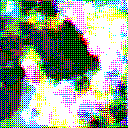

Batch 384 from 384 to 448
Gen loss: 1.0804188
Disc loss: 0.807443
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


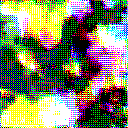

Batch 448 from 448 to 512
Gen loss: 1.0496022
Disc loss: 0.91640234
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


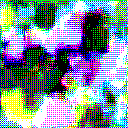

Batch 512 from 512 to 576
Gen loss: 1.0246116
Disc loss: 0.84667444
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


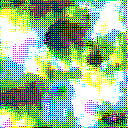

Batch 576 from 576 to 640
Gen loss: 1.0094345
Disc loss: 0.93160146
Disc fake accuracy: 0.94871795
Disc real accuracy: 0.94871795


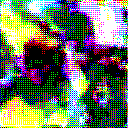


Epoch: 31
Batch 0 from 0 to 64
Gen loss: 1.0476496
Disc loss: 0.85875785
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


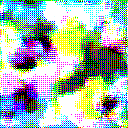

Batch 64 from 64 to 128
Gen loss: 1.1087495
Disc loss: 0.8384428
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


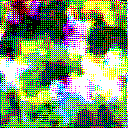

Batch 128 from 128 to 192
Gen loss: 1.0712147
Disc loss: 0.8166084
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


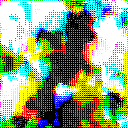

Batch 192 from 192 to 256
Gen loss: 1.0763288
Disc loss: 0.8717439
Disc fake accuracy: 0.96875
Disc real accuracy: 0.96875


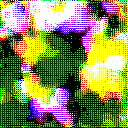

Batch 256 from 256 to 320
Gen loss: 1.0682772
Disc loss: 0.83665144
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


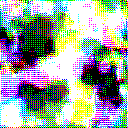

Batch 320 from 320 to 384
Gen loss: 1.1149131
Disc loss: 0.8109262
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


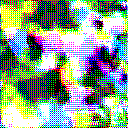

Batch 384 from 384 to 448
Gen loss: 1.0382664
Disc loss: 0.828153
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


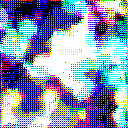

Batch 448 from 448 to 512
Gen loss: 1.0760849
Disc loss: 0.907503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


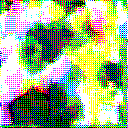

Batch 512 from 512 to 576
Gen loss: 1.0525936
Disc loss: 0.82204807
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


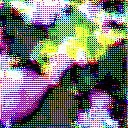

Batch 576 from 576 to 640
Gen loss: 1.0666553
Disc loss: 0.89926267
Disc fake accuracy: 0.94871795
Disc real accuracy: 0.94871795


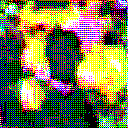


Epoch: 32
Batch 0 from 0 to 64
Gen loss: 1.0609909
Disc loss: 0.84283155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


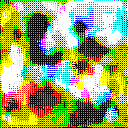

Batch 64 from 64 to 128
Gen loss: 1.0642719
Disc loss: 0.86114687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


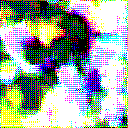

Batch 128 from 128 to 192
Gen loss: 1.0679286
Disc loss: 0.8231671
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


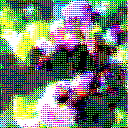

Batch 192 from 192 to 256
Gen loss: 1.0840648
Disc loss: 0.8650972
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


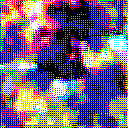

Batch 256 from 256 to 320
Gen loss: 1.1071465
Disc loss: 0.811989
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


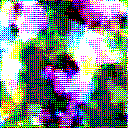

Batch 320 from 320 to 384
Gen loss: 1.082604
Disc loss: 0.82848215
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


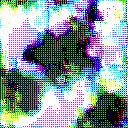

Batch 384 from 384 to 448
Gen loss: 1.0573176
Disc loss: 0.821013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


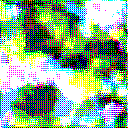

Batch 448 from 448 to 512
Gen loss: 1.1134614
Disc loss: 0.88295114
Disc fake accuracy: 0.953125
Disc real accuracy: 0.984375


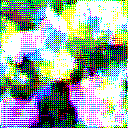

Batch 512 from 512 to 576
Gen loss: 1.1270225
Disc loss: 0.7982122
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


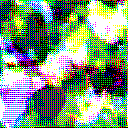

Batch 576 from 576 to 640
Gen loss: 1.0747049
Disc loss: 0.9058377
Disc fake accuracy: 0.974359
Disc real accuracy: 0.8974359


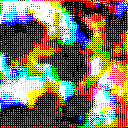


Epoch: 33
Batch 0 from 0 to 64
Gen loss: 1.1073587
Disc loss: 0.82232285
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


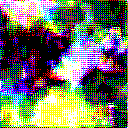

Batch 64 from 64 to 128
Gen loss: 1.0847566
Disc loss: 0.8474839
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


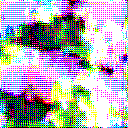

Batch 128 from 128 to 192
Gen loss: 1.1295232
Disc loss: 0.7877202
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


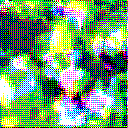

Batch 192 from 192 to 256
Gen loss: 1.1170293
Disc loss: 0.84290904
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


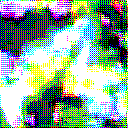

Batch 256 from 256 to 320
Gen loss: 1.1241903
Disc loss: 0.8009492
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


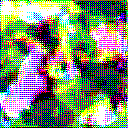

Batch 320 from 320 to 384
Gen loss: 1.162339
Disc loss: 0.7823875
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


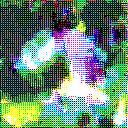

Batch 384 from 384 to 448
Gen loss: 1.1592875
Disc loss: 0.75861776
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


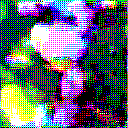

Batch 448 from 448 to 512
Gen loss: 1.134125
Disc loss: 0.86870706
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


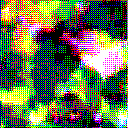

Batch 512 from 512 to 576
Gen loss: 1.1402696
Disc loss: 0.77181053
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


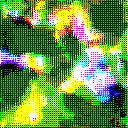

Batch 576 from 576 to 640
Gen loss: 1.1541975
Disc loss: 0.84012055
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


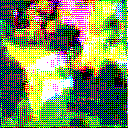


Epoch: 34
Batch 0 from 0 to 64
Gen loss: 1.1825852
Disc loss: 0.77918434
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


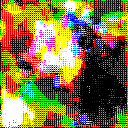

Batch 64 from 64 to 128
Gen loss: 1.1815443
Disc loss: 0.8037298
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


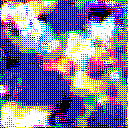

Batch 128 from 128 to 192
Gen loss: 1.2066942
Disc loss: 0.7452227
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


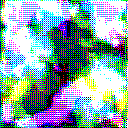

Batch 192 from 192 to 256
Gen loss: 1.1641843
Disc loss: 0.82634956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


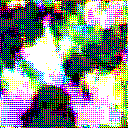

Batch 256 from 256 to 320
Gen loss: 1.1085162
Disc loss: 0.8079033
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


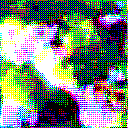

Batch 320 from 320 to 384
Gen loss: 1.160213
Disc loss: 0.78227425
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


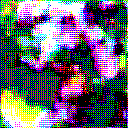

Batch 384 from 384 to 448
Gen loss: 1.1755075
Disc loss: 0.74791163
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


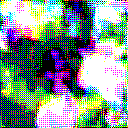

Batch 448 from 448 to 512
Gen loss: 1.192215
Disc loss: 0.82807064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


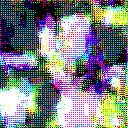

Batch 512 from 512 to 576
Gen loss: 1.1939145
Disc loss: 0.7419281
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


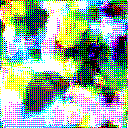

Batch 576 from 576 to 640
Gen loss: 1.1767191
Disc loss: 0.81997836
Disc fake accuracy: 1.0
Disc real accuracy: 0.94871795


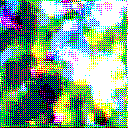


Epoch: 35
Batch 0 from 0 to 64
Gen loss: 1.1211743
Disc loss: 0.80163205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


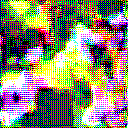

Batch 64 from 64 to 128
Gen loss: 1.149554
Disc loss: 0.80664396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


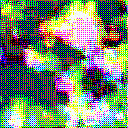

Batch 128 from 128 to 192
Gen loss: 1.2180673
Disc loss: 0.73771715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


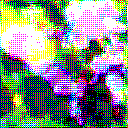

Batch 192 from 192 to 256
Gen loss: 1.152389
Disc loss: 0.8192961
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


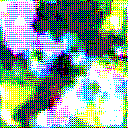

Batch 256 from 256 to 320
Gen loss: 1.1974225
Disc loss: 0.7593587
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


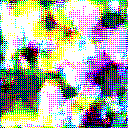

Batch 320 from 320 to 384
Gen loss: 1.150146
Disc loss: 0.76980275
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


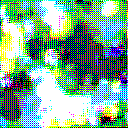

Batch 384 from 384 to 448
Gen loss: 1.155561
Disc loss: 0.75147927
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


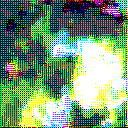

Batch 448 from 448 to 512
Gen loss: 1.1332791
Disc loss: 0.85337067
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


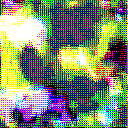

Batch 512 from 512 to 576
Gen loss: 1.1680303
Disc loss: 0.7486109
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


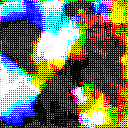

Batch 576 from 576 to 640
Gen loss: 1.1799841
Disc loss: 0.81736743
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


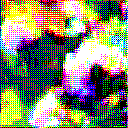


Epoch: 36
Batch 0 from 0 to 64
Gen loss: 1.1752585
Disc loss: 0.7704668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


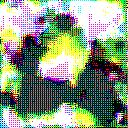

Batch 64 from 64 to 128
Gen loss: 1.1691971
Disc loss: 0.7829658
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


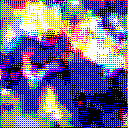

Batch 128 from 128 to 192
Gen loss: 1.1748247
Disc loss: 0.7479127
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


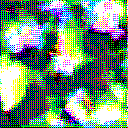

Batch 192 from 192 to 256
Gen loss: 1.188376
Disc loss: 0.7883889
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


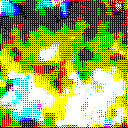

Batch 256 from 256 to 320
Gen loss: 1.2031746
Disc loss: 0.7482731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


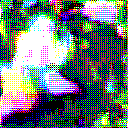

Batch 320 from 320 to 384
Gen loss: 1.1420934
Disc loss: 0.7753039
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


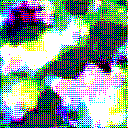

Batch 384 from 384 to 448
Gen loss: 1.1719434
Disc loss: 0.73916084
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


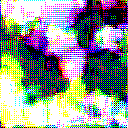

Batch 448 from 448 to 512
Gen loss: 1.1818578
Disc loss: 0.8303923
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


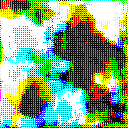

Batch 512 from 512 to 576
Gen loss: 1.2147269
Disc loss: 0.7187094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


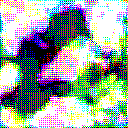

Batch 576 from 576 to 640
Gen loss: 1.183007
Disc loss: 0.7941059
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


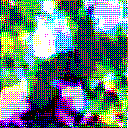


Epoch: 37
Batch 0 from 0 to 64
Gen loss: 1.1671991
Disc loss: 0.7727674
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


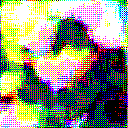

Batch 64 from 64 to 128
Gen loss: 1.1916628
Disc loss: 0.773739
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


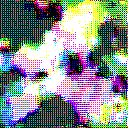

Batch 128 from 128 to 192
Gen loss: 1.2339988
Disc loss: 0.7128488
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


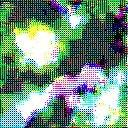

Batch 192 from 192 to 256
Gen loss: 1.1857347
Disc loss: 0.78777176
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


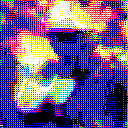

Batch 256 from 256 to 320
Gen loss: 1.1754708
Disc loss: 0.7550626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


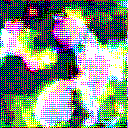

Batch 320 from 320 to 384
Gen loss: 1.187212
Disc loss: 0.7464861
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


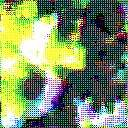

Batch 384 from 384 to 448
Gen loss: 1.2006963
Disc loss: 0.7134053
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


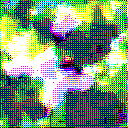

Batch 448 from 448 to 512
Gen loss: 1.1369559
Disc loss: 0.84233284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


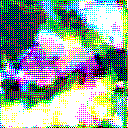

Batch 512 from 512 to 576
Gen loss: 1.2161729
Disc loss: 0.7215481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


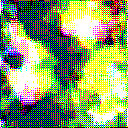

Batch 576 from 576 to 640
Gen loss: 1.1870083
Disc loss: 0.7990272
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


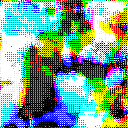


Epoch: 38
Batch 0 from 0 to 64
Gen loss: 1.1882353
Disc loss: 0.7539513
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


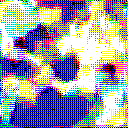

Batch 64 from 64 to 128
Gen loss: 1.1917691
Disc loss: 0.7709546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


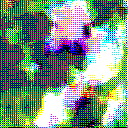

Batch 128 from 128 to 192
Gen loss: 1.1578801
Disc loss: 0.7423177
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


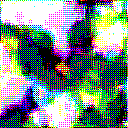

Batch 192 from 192 to 256
Gen loss: 1.1562309
Disc loss: 0.7980199
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


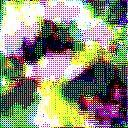

Batch 256 from 256 to 320
Gen loss: 1.2656511
Disc loss: 0.7146865
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


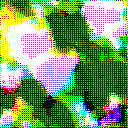

Batch 320 from 320 to 384
Gen loss: 1.1944764
Disc loss: 0.737106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


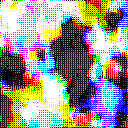

Batch 384 from 384 to 448
Gen loss: 1.2184472
Disc loss: 0.70761406
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


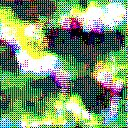

Batch 448 from 448 to 512
Gen loss: 1.2233484
Disc loss: 0.7956656
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


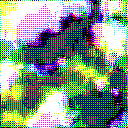

Batch 512 from 512 to 576
Gen loss: 1.200418
Disc loss: 0.7222631
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


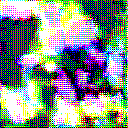

Batch 576 from 576 to 640
Gen loss: 1.1222689
Disc loss: 0.821983
Disc fake accuracy: 1.0
Disc real accuracy: 0.94871795


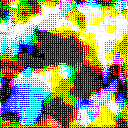


Epoch: 39
Batch 0 from 0 to 64
Gen loss: 1.2234983
Disc loss: 0.72997487
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


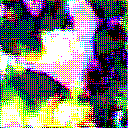

Batch 64 from 64 to 128
Gen loss: 1.1622806
Disc loss: 0.7820994
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


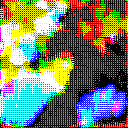

Batch 128 from 128 to 192
Gen loss: 1.1986104
Disc loss: 0.72732127
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


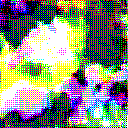

Batch 192 from 192 to 256
Gen loss: 1.2429769
Disc loss: 0.76075786
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


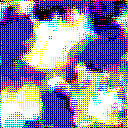

Batch 256 from 256 to 320
Gen loss: 1.2184976
Disc loss: 0.7272918
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


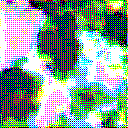

Batch 320 from 320 to 384
Gen loss: 1.244009
Disc loss: 0.71060324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


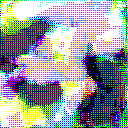

Batch 384 from 384 to 448
Gen loss: 1.2088132
Disc loss: 0.7069469
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


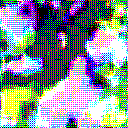

Batch 448 from 448 to 512
Gen loss: 1.2031095
Disc loss: 0.80193937
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


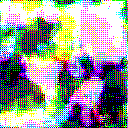

Batch 512 from 512 to 576
Gen loss: 1.2228441
Disc loss: 0.7042197
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


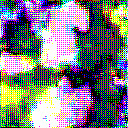

Batch 576 from 576 to 640
Gen loss: 1.1800752
Disc loss: 0.7837292
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


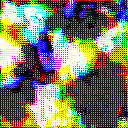


Epoch: 40
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.1329818
Disc loss: 0.7654599
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


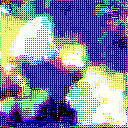

Batch 64 from 64 to 128
Gen loss: 1.1889884
Disc loss: 0.7540295
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


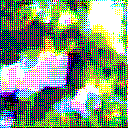

Batch 128 from 128 to 192
Gen loss: 1.2072165
Disc loss: 0.714546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


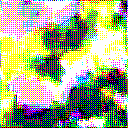

Batch 192 from 192 to 256
Gen loss: 1.1906152
Disc loss: 0.77531075
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


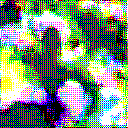

Batch 256 from 256 to 320
Gen loss: 1.1134434
Disc loss: 0.7773847
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


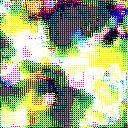

Batch 320 from 320 to 384
Gen loss: 1.198457
Disc loss: 0.73032475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


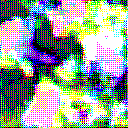

Batch 384 from 384 to 448
Gen loss: 1.1631136
Disc loss: 0.7232247
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


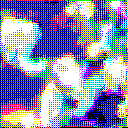

Batch 448 from 448 to 512
Gen loss: 1.1576641
Disc loss: 0.82691824
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


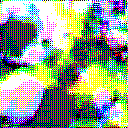

Batch 512 from 512 to 576
Gen loss: 1.1802149
Disc loss: 0.721521
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


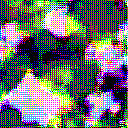

Batch 576 from 576 to 640
Gen loss: 1.1763297
Disc loss: 0.77780116
Disc fake accuracy: 1.0
Disc real accuracy: 0.94871795


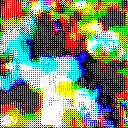


Epoch: 41
Batch 0 from 0 to 64
Gen loss: 1.1858379
Disc loss: 0.743035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


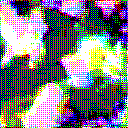

Batch 64 from 64 to 128
Gen loss: 1.2177055
Disc loss: 0.74366635
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


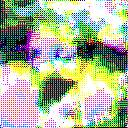

Batch 128 from 128 to 192
Gen loss: 1.1595044
Disc loss: 0.7384705
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


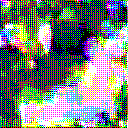

Batch 192 from 192 to 256
Gen loss: 1.1952739
Disc loss: 0.7721799
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


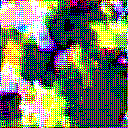

Batch 256 from 256 to 320
Gen loss: 1.1807525
Disc loss: 0.7349032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


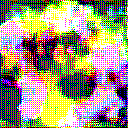

Batch 320 from 320 to 384
Gen loss: 1.1877223
Disc loss: 0.7249087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


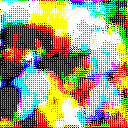

Batch 384 from 384 to 448
Gen loss: 1.22881
Disc loss: 0.6903814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


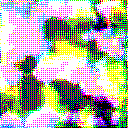

Batch 448 from 448 to 512
Gen loss: 1.1887724
Disc loss: 0.793981
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


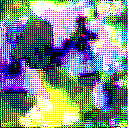

Batch 512 from 512 to 576
Gen loss: 1.1843438
Disc loss: 0.71377146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


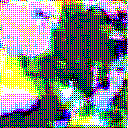

Batch 576 from 576 to 640
Gen loss: 1.1074781
Disc loss: 0.8036664
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


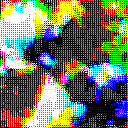


Epoch: 42
Batch 0 from 0 to 64
Gen loss: 1.2141876
Disc loss: 0.72229934
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


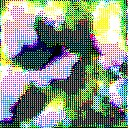

Batch 64 from 64 to 128
Gen loss: 1.1711432
Disc loss: 0.7584884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


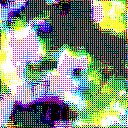

Batch 128 from 128 to 192
Gen loss: 1.2424159
Disc loss: 0.6950972
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


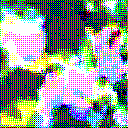

Batch 192 from 192 to 256
Gen loss: 1.1794918
Disc loss: 0.7722362
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


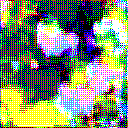

Batch 256 from 256 to 320
Gen loss: 1.2055404
Disc loss: 0.7260425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


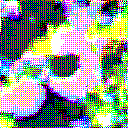

Batch 320 from 320 to 384
Gen loss: 1.1659545
Disc loss: 0.7393546
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


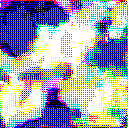

Batch 384 from 384 to 448
Gen loss: 1.199664
Disc loss: 0.69659543
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


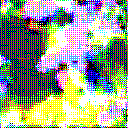

Batch 448 from 448 to 512
Gen loss: 1.1744618
Disc loss: 0.80280125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


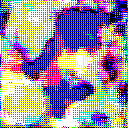

Batch 512 from 512 to 576
Gen loss: 1.2016717
Disc loss: 0.7009914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


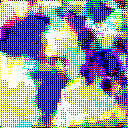

Batch 576 from 576 to 640
Gen loss: 1.2018163
Disc loss: 0.7566937
Disc fake accuracy: 0.974359
Disc real accuracy: 0.974359


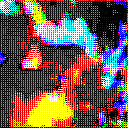


Epoch: 43
Batch 0 from 0 to 64
Gen loss: 1.1838591
Disc loss: 0.7395047
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


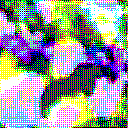

Batch 64 from 64 to 128
Gen loss: 1.1853313
Disc loss: 0.7541903
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


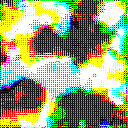

Batch 128 from 128 to 192
Gen loss: 1.2026951
Disc loss: 0.70657325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


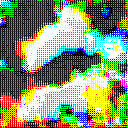

Batch 192 from 192 to 256
Gen loss: 1.1819527
Disc loss: 0.7682644
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


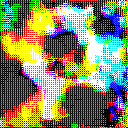

Batch 256 from 256 to 320
Gen loss: 1.1877191
Disc loss: 0.72309566
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


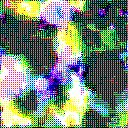

Batch 320 from 320 to 384
Gen loss: 1.2016524
Disc loss: 0.7144475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


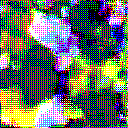

Batch 384 from 384 to 448
Gen loss: 1.204325
Disc loss: 0.6895073
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


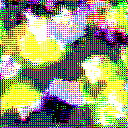

Batch 448 from 448 to 512
Gen loss: 1.1949148
Disc loss: 0.79202825
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


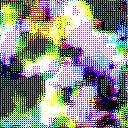

Batch 512 from 512 to 576
Gen loss: 1.2358944
Disc loss: 0.6889485
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


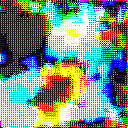

Batch 576 from 576 to 640
Gen loss: 1.2169007
Disc loss: 0.7656431
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


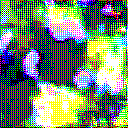


Epoch: 44
Batch 0 from 0 to 64
Gen loss: 1.1818997
Disc loss: 0.7410289
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


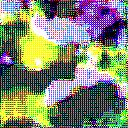

Batch 64 from 64 to 128
Gen loss: 1.2147326
Disc loss: 0.7434824
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


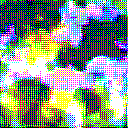

Batch 128 from 128 to 192
Gen loss: 1.2376841
Disc loss: 0.6974849
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


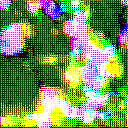

Batch 192 from 192 to 256
Gen loss: 1.2168593
Disc loss: 0.7491799
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


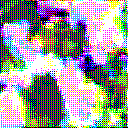

Batch 256 from 256 to 320
Gen loss: 1.2165608
Disc loss: 0.7173017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


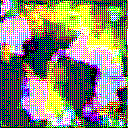

Batch 320 from 320 to 384
Gen loss: 1.2783175
Disc loss: 0.68564904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


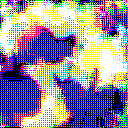

Batch 384 from 384 to 448
Gen loss: 1.2432956
Disc loss: 0.67754924
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


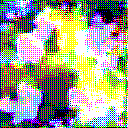

Batch 448 from 448 to 512
Gen loss: 1.2057016
Disc loss: 0.7916472
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


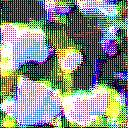

Batch 512 from 512 to 576
Gen loss: 1.2256492
Disc loss: 0.6885389
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


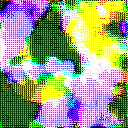

Batch 576 from 576 to 640
Gen loss: 1.2365328
Disc loss: 0.7523997
Disc fake accuracy: 0.974359
Disc real accuracy: 0.974359


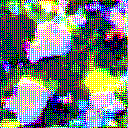


Epoch: 45
Batch 0 from 0 to 64
Gen loss: 1.2438582
Disc loss: 0.70586497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


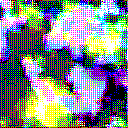

Batch 64 from 64 to 128
Gen loss: 1.1951449
Disc loss: 0.7449819
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


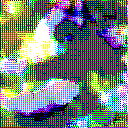

Batch 128 from 128 to 192
Gen loss: 1.2593579
Disc loss: 0.6827476
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


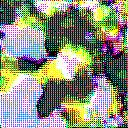

Batch 192 from 192 to 256
Gen loss: 1.2059805
Disc loss: 0.75718164
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


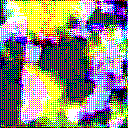

Batch 256 from 256 to 320
Gen loss: 1.2695222
Disc loss: 0.6909133
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


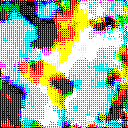

Batch 320 from 320 to 384
Gen loss: 1.2079234
Disc loss: 0.71165466
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


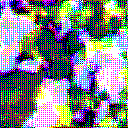

Batch 384 from 384 to 448
Gen loss: 1.1915314
Disc loss: 0.706393
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


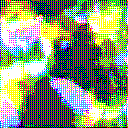

Batch 448 from 448 to 512
Gen loss: 1.2716398
Disc loss: 0.7556644
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


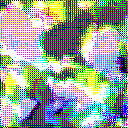

Batch 512 from 512 to 576
Gen loss: 1.2475553
Disc loss: 0.6770978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


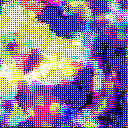

Batch 576 from 576 to 640
Gen loss: 1.2429175
Disc loss: 0.73127836
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


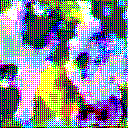


Epoch: 46
Batch 0 from 0 to 64
Gen loss: 1.2364874
Disc loss: 0.70833874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


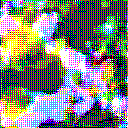

Batch 64 from 64 to 128
Gen loss: 1.2688096
Disc loss: 0.70563644
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


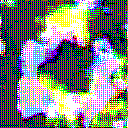

Batch 128 from 128 to 192
Gen loss: 1.2163073
Disc loss: 0.6952523
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


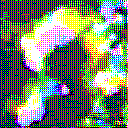

Batch 192 from 192 to 256
Gen loss: 1.2362214
Disc loss: 0.7400741
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


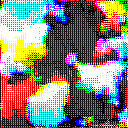

Batch 256 from 256 to 320
Gen loss: 1.2087874
Disc loss: 0.7123585
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


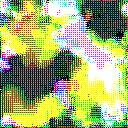

Batch 320 from 320 to 384
Gen loss: 1.2571454
Disc loss: 0.68632853
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


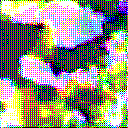

Batch 384 from 384 to 448
Gen loss: 1.2634139
Disc loss: 0.6617351
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


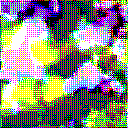

Batch 448 from 448 to 512
Gen loss: 1.2573879
Disc loss: 0.76603156
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


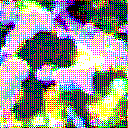

Batch 512 from 512 to 576
Gen loss: 1.2232629
Disc loss: 0.685114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


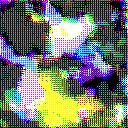

Batch 576 from 576 to 640
Gen loss: 1.1752787
Disc loss: 0.7649456
Disc fake accuracy: 0.974359
Disc real accuracy: 0.94871795


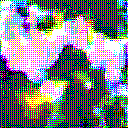


Epoch: 47
Batch 0 from 0 to 64
Gen loss: 1.1983173
Disc loss: 0.7211162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


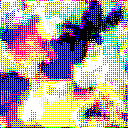

Batch 64 from 64 to 128
Gen loss: 1.225474
Disc loss: 0.7334287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


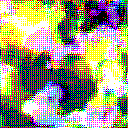

Batch 128 from 128 to 192
Gen loss: 1.2143388
Disc loss: 0.7048619
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


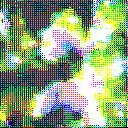

Batch 192 from 192 to 256
Gen loss: 1.2082758
Disc loss: 0.7524632
Disc fake accuracy: 0.984375
Disc real accuracy: 0.96875


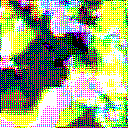

Batch 256 from 256 to 320
Gen loss: 1.2390034
Disc loss: 0.69949025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


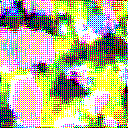

Batch 320 from 320 to 384
Gen loss: 1.2440879
Disc loss: 0.6900395
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


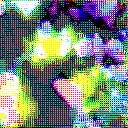

Batch 384 from 384 to 448
Gen loss: 1.207873
Disc loss: 0.69364744
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


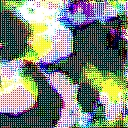

Batch 448 from 448 to 512
Gen loss: 1.213326
Disc loss: 0.78208375
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


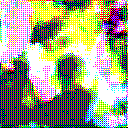

Batch 512 from 512 to 576
Gen loss: 1.1447997
Disc loss: 0.72768915
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


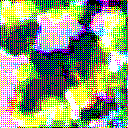

Batch 576 from 576 to 640
Gen loss: 1.1991626
Disc loss: 0.7616082
Disc fake accuracy: 0.974359
Disc real accuracy: 0.974359


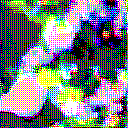


Epoch: 48
Batch 0 from 0 to 64
Gen loss: 1.171272
Disc loss: 0.7315121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


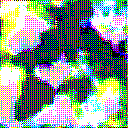

Batch 64 from 64 to 128
Gen loss: 1.2497236
Disc loss: 0.7086944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


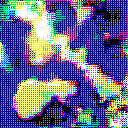

Batch 128 from 128 to 192
Gen loss: 1.2265006
Disc loss: 0.69206756
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


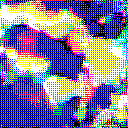

Batch 192 from 192 to 256
Gen loss: 1.1931753
Disc loss: 0.7549092
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


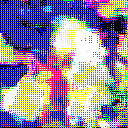

Batch 256 from 256 to 320
Gen loss: 1.1936269
Disc loss: 0.71388483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


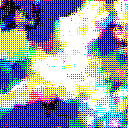

Batch 320 from 320 to 384
Gen loss: 1.2470603
Disc loss: 0.68498427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


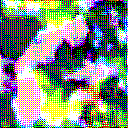

Batch 384 from 384 to 448
Gen loss: 1.2203898
Disc loss: 0.6739602
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


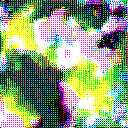

Batch 448 from 448 to 512
Gen loss: 1.2368201
Disc loss: 0.765425
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


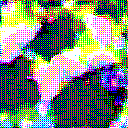

Batch 512 from 512 to 576
Gen loss: 1.2524674
Disc loss: 0.6735213
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


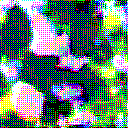

Batch 576 from 576 to 640
Gen loss: 1.1317899
Disc loss: 0.7940123
Disc fake accuracy: 0.94871795
Disc real accuracy: 0.94871795


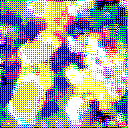


Epoch: 49
Batch 0 from 0 to 64
Gen loss: 1.2466884
Disc loss: 0.6935609
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


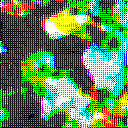

Batch 64 from 64 to 128
Gen loss: 1.166738
Disc loss: 0.74454963
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


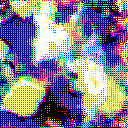

Batch 128 from 128 to 192
Gen loss: 1.2775943
Disc loss: 0.67328286
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


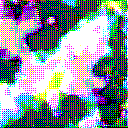

Batch 192 from 192 to 256
Gen loss: 1.2977173
Disc loss: 0.7083672
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


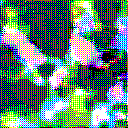

Batch 256 from 256 to 320
Gen loss: 1.2660861
Disc loss: 0.6811802
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


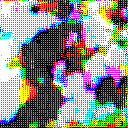

Batch 320 from 320 to 384
Gen loss: 1.3043003
Disc loss: 0.6565345
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


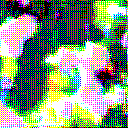

Batch 384 from 384 to 448
Gen loss: 1.2339921
Disc loss: 0.6658825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


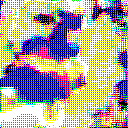

Batch 448 from 448 to 512
Gen loss: 1.2953725
Disc loss: 0.73192966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


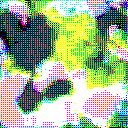

Batch 512 from 512 to 576
Gen loss: 1.2831024
Disc loss: 0.6538558
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


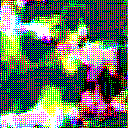

Batch 576 from 576 to 640
Gen loss: 1.2536684
Disc loss: 0.72548985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


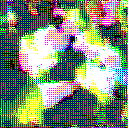


Epoch: 50
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.2497737
Disc loss: 0.68440044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


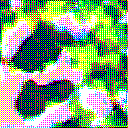

Batch 64 from 64 to 128
Gen loss: 1.2699776
Disc loss: 0.6968827
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


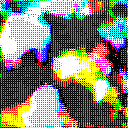

Batch 128 from 128 to 192
Gen loss: 1.2808747
Disc loss: 0.65579355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


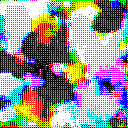

Batch 192 from 192 to 256
Gen loss: 1.2650211
Disc loss: 0.71661353
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


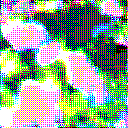

Batch 256 from 256 to 320
Gen loss: 1.2183806
Disc loss: 0.6966194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


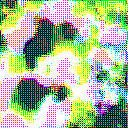

Batch 320 from 320 to 384
Gen loss: 1.3292512
Disc loss: 0.64963937
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


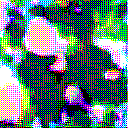

Batch 384 from 384 to 448
Gen loss: 1.2283115
Disc loss: 0.67658085
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


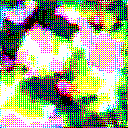

Batch 448 from 448 to 512
Gen loss: 1.2804884
Disc loss: 0.7369156
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


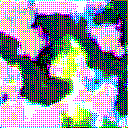

Batch 512 from 512 to 576
Gen loss: 1.2593238
Disc loss: 0.66141045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


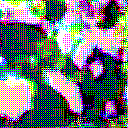

Batch 576 from 576 to 640
Gen loss: 1.2399384
Disc loss: 0.71952116
Disc fake accuracy: 1.0
Disc real accuracy: 0.94871795


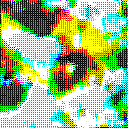


Epoch: 51
Batch 0 from 0 to 64
Gen loss: 1.2988435
Disc loss: 0.6668807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


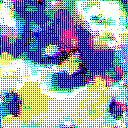

Batch 64 from 64 to 128
Gen loss: 1.3228875
Disc loss: 0.67474025
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


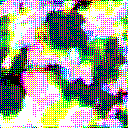

Batch 128 from 128 to 192
Gen loss: 1.3107708
Disc loss: 0.64047015
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


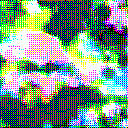

Batch 192 from 192 to 256
Gen loss: 1.2610313
Disc loss: 0.71759176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


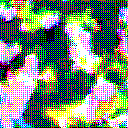

Batch 256 from 256 to 320
Gen loss: 1.3105079
Disc loss: 0.6599976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


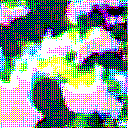

Batch 320 from 320 to 384
Gen loss: 1.2491922
Disc loss: 0.67410266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


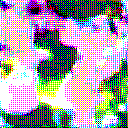

Batch 384 from 384 to 448
Gen loss: 1.2979681
Disc loss: 0.63147974
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


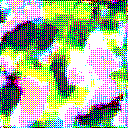

Batch 448 from 448 to 512
Gen loss: 1.2842292
Disc loss: 0.73350596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


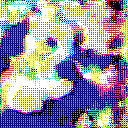

Batch 512 from 512 to 576
Gen loss: 1.2816434
Disc loss: 0.64636385
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


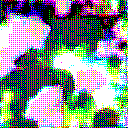

Batch 576 from 576 to 640
Gen loss: 1.31526
Disc loss: 0.6900443
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


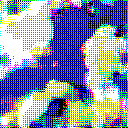


Epoch: 52
Batch 0 from 0 to 64
Gen loss: 1.2331384
Disc loss: 0.70201075
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


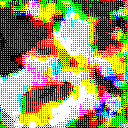

Batch 64 from 64 to 128
Gen loss: 1.3361833
Disc loss: 0.66548353
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


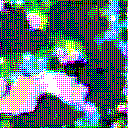

Batch 128 from 128 to 192
Gen loss: 1.2669111
Disc loss: 0.6619907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


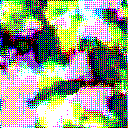

Batch 192 from 192 to 256
Gen loss: 1.2708275
Disc loss: 0.717355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


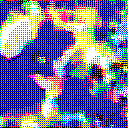

Batch 256 from 256 to 320
Gen loss: 1.2957263
Disc loss: 0.67565286
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


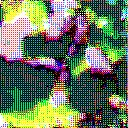

Batch 320 from 320 to 384
Gen loss: 1.2852353
Disc loss: 0.66972107
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


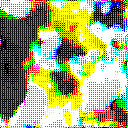

Batch 384 from 384 to 448
Gen loss: 1.3843513
Disc loss: 0.6092036
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


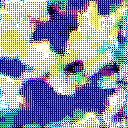

Batch 448 from 448 to 512
Gen loss: 1.3020612
Disc loss: 0.7299386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


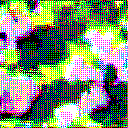

Batch 512 from 512 to 576
Gen loss: 1.2634348
Disc loss: 0.66950595
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


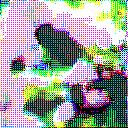

Batch 576 from 576 to 640
Gen loss: 1.275078
Disc loss: 0.71522164
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


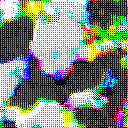


Epoch: 53
Batch 0 from 0 to 64
Gen loss: 1.3138975
Disc loss: 0.6681019
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


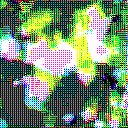

Batch 64 from 64 to 128
Gen loss: 1.3438898
Disc loss: 0.6678462
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


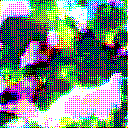

Batch 128 from 128 to 192
Gen loss: 1.3678243
Disc loss: 0.62177044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


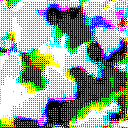

Batch 192 from 192 to 256
Gen loss: 1.3750377
Disc loss: 0.6643368
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


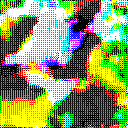

Batch 256 from 256 to 320
Gen loss: 1.3708177
Disc loss: 0.6326757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


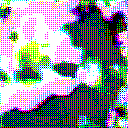

Batch 320 from 320 to 384
Gen loss: 1.3175008
Disc loss: 0.64663553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


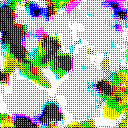

Batch 384 from 384 to 448
Gen loss: 1.4133677
Disc loss: 0.59451807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


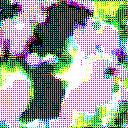

Batch 448 from 448 to 512
Gen loss: 1.3876364
Disc loss: 0.69489276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


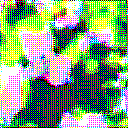

Batch 512 from 512 to 576
Gen loss: 1.3728755
Disc loss: 0.61026514
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


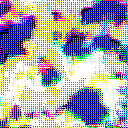

Batch 576 from 576 to 640
Gen loss: 1.3717829
Disc loss: 0.66514647
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


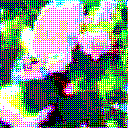


Epoch: 54
Batch 0 from 0 to 64
Gen loss: 1.3374518
Disc loss: 0.65350235
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


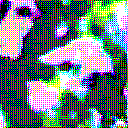

Batch 64 from 64 to 128
Gen loss: 1.3114481
Disc loss: 0.670167
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


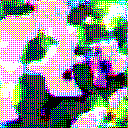

Batch 128 from 128 to 192
Gen loss: 1.3909855
Disc loss: 0.6105121
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


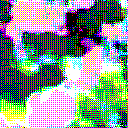

Batch 192 from 192 to 256
Gen loss: 1.4266597
Disc loss: 0.63911414
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


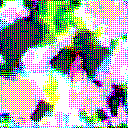

Batch 256 from 256 to 320
Gen loss: 1.2889678
Disc loss: 0.6577648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


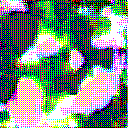

Batch 320 from 320 to 384
Gen loss: 1.3499433
Disc loss: 0.628415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


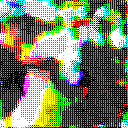

Batch 384 from 384 to 448
Gen loss: 1.350378
Disc loss: 0.6205988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


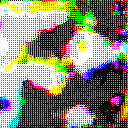

Batch 448 from 448 to 512
Gen loss: 1.3440688
Disc loss: 0.7020174
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


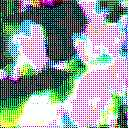

Batch 512 from 512 to 576
Gen loss: 1.3111806
Disc loss: 0.6278414
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


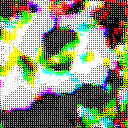

Batch 576 from 576 to 640
Gen loss: 1.3912244
Disc loss: 0.6734713
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


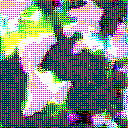


Epoch: 55
Batch 0 from 0 to 64
Gen loss: 1.3275108
Disc loss: 0.6523091
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


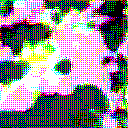

Batch 64 from 64 to 128
Gen loss: 1.3810847
Disc loss: 0.64929587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


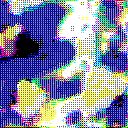

Batch 128 from 128 to 192
Gen loss: 1.3056026
Disc loss: 0.6399472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


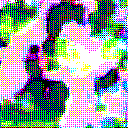

Batch 192 from 192 to 256
Gen loss: 1.3968837
Disc loss: 0.6448349
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


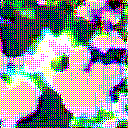

Batch 256 from 256 to 320
Gen loss: 1.3865484
Disc loss: 0.61506003
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


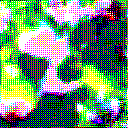

Batch 320 from 320 to 384
Gen loss: 1.3837107
Disc loss: 0.6111895
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


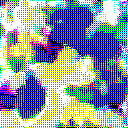

Batch 384 from 384 to 448
Gen loss: 1.3766325
Disc loss: 0.5929527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


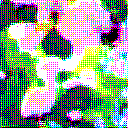

Batch 448 from 448 to 512
Gen loss: 1.4003615
Disc loss: 0.6812989
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


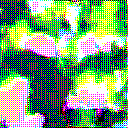

Batch 512 from 512 to 576
Gen loss: 1.2941005
Disc loss: 0.63567054
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


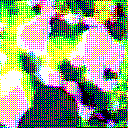

Batch 576 from 576 to 640
Gen loss: 1.2749873
Disc loss: 0.6919638
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


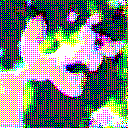


Epoch: 56
Batch 0 from 0 to 64
Gen loss: 1.3609068
Disc loss: 0.6295537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


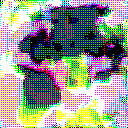

Batch 64 from 64 to 128
Gen loss: 1.3207026
Disc loss: 0.66267383
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


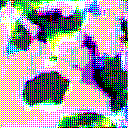

Batch 128 from 128 to 192
Gen loss: 1.3083147
Disc loss: 0.6348414
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


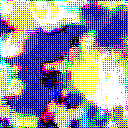

Batch 192 from 192 to 256
Gen loss: 1.3985999
Disc loss: 0.6466569
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


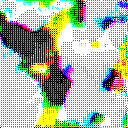

Batch 256 from 256 to 320
Gen loss: 1.4419775
Disc loss: 0.5950777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


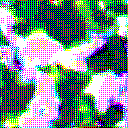

Batch 320 from 320 to 384
Gen loss: 1.3920114
Disc loss: 0.6001742
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


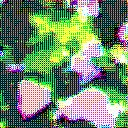

Batch 384 from 384 to 448
Gen loss: 1.2149575
Disc loss: 0.6531996
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


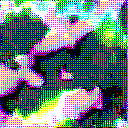

Batch 448 from 448 to 512
Gen loss: 1.3165438
Disc loss: 0.7035906
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


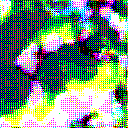

Batch 512 from 512 to 576
Gen loss: 1.4041581
Disc loss: 0.5890255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


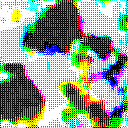

Batch 576 from 576 to 640
Gen loss: 1.2701993
Disc loss: 0.68509835
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


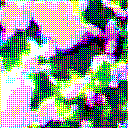


Epoch: 57
Batch 0 from 0 to 64
Gen loss: 1.2746396
Disc loss: 0.6689503
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


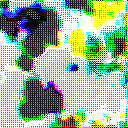

Batch 64 from 64 to 128
Gen loss: 1.3268018
Disc loss: 0.6512113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


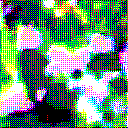

Batch 128 from 128 to 192
Gen loss: 1.3822283
Disc loss: 0.5971167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


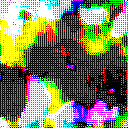

Batch 192 from 192 to 256
Gen loss: 1.3088886
Disc loss: 0.6745659
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


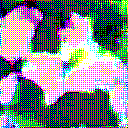

Batch 256 from 256 to 320
Gen loss: 1.2809006
Disc loss: 0.6502123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


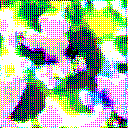

Batch 320 from 320 to 384
Gen loss: 1.3069245
Disc loss: 0.63634545
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


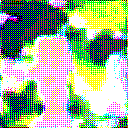

Batch 384 from 384 to 448
Gen loss: 1.3488555
Disc loss: 0.5974354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


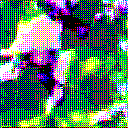

Batch 448 from 448 to 512
Gen loss: 1.3256316
Disc loss: 0.7009343
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


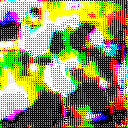

Batch 512 from 512 to 576
Gen loss: 1.3170657
Disc loss: 0.6200368
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


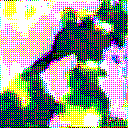

Batch 576 from 576 to 640
Gen loss: 1.2617147
Disc loss: 0.7159035
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


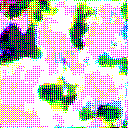


Epoch: 58
Batch 0 from 0 to 64
Gen loss: 1.3296728
Disc loss: 0.63620734
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


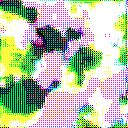

Batch 64 from 64 to 128
Gen loss: 1.3364182
Disc loss: 0.6437139
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


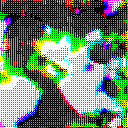

Batch 128 from 128 to 192
Gen loss: 1.4052935
Disc loss: 0.5985532
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


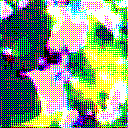

Batch 192 from 192 to 256
Gen loss: 1.386129
Disc loss: 0.6482168
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


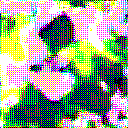

Batch 256 from 256 to 320
Gen loss: 1.2247632
Disc loss: 0.67669797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


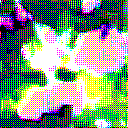

Batch 320 from 320 to 384
Gen loss: 1.3627402
Disc loss: 0.61824316
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


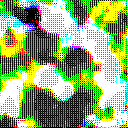

Batch 384 from 384 to 448
Gen loss: 1.2735558
Disc loss: 0.62567466
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


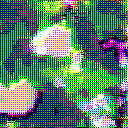

Batch 448 from 448 to 512
Gen loss: 1.3000742
Disc loss: 0.7020737
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


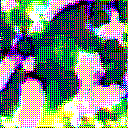

Batch 512 from 512 to 576
Gen loss: 1.2999835
Disc loss: 0.61684465
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


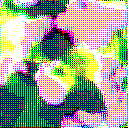

Batch 576 from 576 to 640
Gen loss: 1.2514963
Disc loss: 0.70620877
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


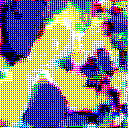


Epoch: 59
Batch 0 from 0 to 64
Gen loss: 1.4166509
Disc loss: 0.6028578
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


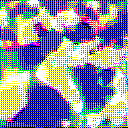

Batch 64 from 64 to 128
Gen loss: 1.3042821
Disc loss: 0.6616887
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


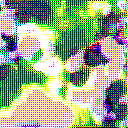

Batch 128 from 128 to 192
Gen loss: 1.2403337
Disc loss: 0.6644658
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


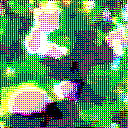

Batch 192 from 192 to 256
Gen loss: 1.3049752
Disc loss: 0.67399913
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


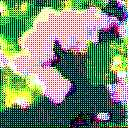

Batch 256 from 256 to 320
Gen loss: 1.3223239
Disc loss: 0.6388254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


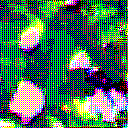

Batch 320 from 320 to 384
Gen loss: 1.3286309
Disc loss: 0.62528765
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


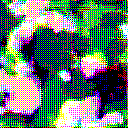

Batch 384 from 384 to 448
Gen loss: 1.2358334
Disc loss: 0.64314574
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


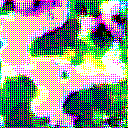

Batch 448 from 448 to 512
Gen loss: 1.298399
Disc loss: 0.7038116
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


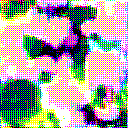

Batch 512 from 512 to 576
Gen loss: 1.2953316
Disc loss: 0.62086964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


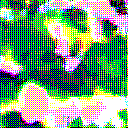

Batch 576 from 576 to 640
Gen loss: 1.2094305
Disc loss: 0.7114182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


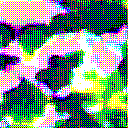


Epoch: 60
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.3201592
Disc loss: 0.63406396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


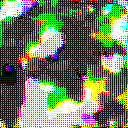

Batch 64 from 64 to 128
Gen loss: 1.2616037
Disc loss: 0.6749095
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


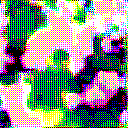

Batch 128 from 128 to 192
Gen loss: 1.2463696
Disc loss: 0.6597427
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


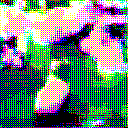

Batch 192 from 192 to 256
Gen loss: 1.2300298
Disc loss: 0.70393
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


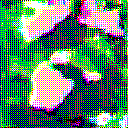

Batch 256 from 256 to 320
Gen loss: 1.230426
Disc loss: 0.6683413
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


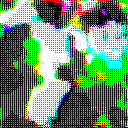

Batch 320 from 320 to 384
Gen loss: 1.2941866
Disc loss: 0.63396275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


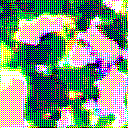

Batch 384 from 384 to 448
Gen loss: 1.3695657
Disc loss: 0.5856055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


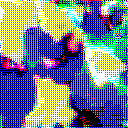

Batch 448 from 448 to 512
Gen loss: 1.2452251
Disc loss: 0.72425866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


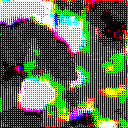

Batch 512 from 512 to 576
Gen loss: 1.2982783
Disc loss: 0.61681175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


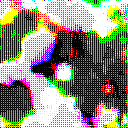

Batch 576 from 576 to 640
Gen loss: 1.2353208
Disc loss: 0.68917245
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


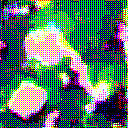


Epoch: 61
Batch 0 from 0 to 64
Gen loss: 1.3640487
Disc loss: 0.6093679
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


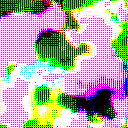

Batch 64 from 64 to 128
Gen loss: 1.3055817
Disc loss: 0.6484321
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


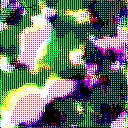

Batch 128 from 128 to 192
Gen loss: 1.3451285
Disc loss: 0.6017512
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


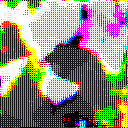

Batch 192 from 192 to 256
Gen loss: 1.268696
Disc loss: 0.68039703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


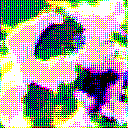

Batch 256 from 256 to 320
Gen loss: 1.31481
Disc loss: 0.63335943
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


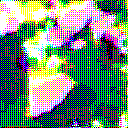

Batch 320 from 320 to 384
Gen loss: 1.3968735
Disc loss: 0.59187067
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


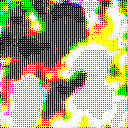

Batch 384 from 384 to 448
Gen loss: 1.2965518
Disc loss: 0.6219971
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


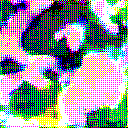

Batch 448 from 448 to 512
Gen loss: 1.3004982
Disc loss: 0.7102245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


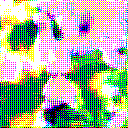

Batch 512 from 512 to 576
Gen loss: 1.3699886
Disc loss: 0.5936763
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


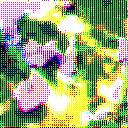

Batch 576 from 576 to 640
Gen loss: 1.3111945
Disc loss: 0.65160465
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


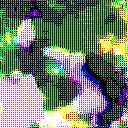


Epoch: 62
Batch 0 from 0 to 64
Gen loss: 1.3379047
Disc loss: 0.62811005
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


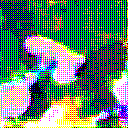

Batch 64 from 64 to 128
Gen loss: 1.3746722
Disc loss: 0.623429
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


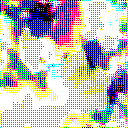

Batch 128 from 128 to 192
Gen loss: 1.2961378
Disc loss: 0.6308187
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


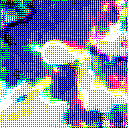

Batch 192 from 192 to 256
Gen loss: 1.4045684
Disc loss: 0.6333275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


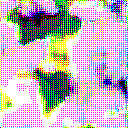

Batch 256 from 256 to 320
Gen loss: 1.3140302
Disc loss: 0.63428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


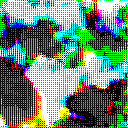

Batch 320 from 320 to 384
Gen loss: 1.2585871
Disc loss: 0.6501057
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


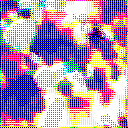

Batch 384 from 384 to 448
Gen loss: 1.4112227
Disc loss: 0.57814044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


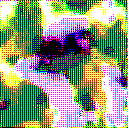

Batch 448 from 448 to 512
Gen loss: 1.4140277
Disc loss: 0.670687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


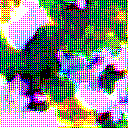

Batch 512 from 512 to 576
Gen loss: 1.247909
Disc loss: 0.64189756
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


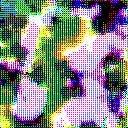

Batch 576 from 576 to 640
Gen loss: 1.3410066
Disc loss: 0.6633135
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


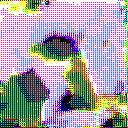


Epoch: 63
Batch 0 from 0 to 64
Gen loss: 1.3257346
Disc loss: 0.63543355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


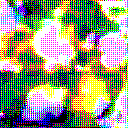

Batch 64 from 64 to 128
Gen loss: 1.4065771
Disc loss: 0.62049425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


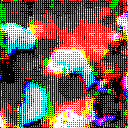

Batch 128 from 128 to 192
Gen loss: 1.244435
Disc loss: 0.6506591
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


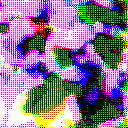

Batch 192 from 192 to 256
Gen loss: 1.2815222
Disc loss: 0.6793717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


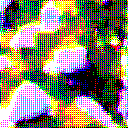

Batch 256 from 256 to 320
Gen loss: 1.2971587
Disc loss: 0.64195156
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


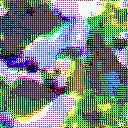

Batch 320 from 320 to 384
Gen loss: 1.3256931
Disc loss: 0.6251097
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


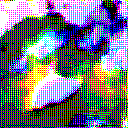

Batch 384 from 384 to 448
Gen loss: 1.2936636
Disc loss: 0.62534726
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


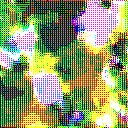

Batch 448 from 448 to 512
Gen loss: 1.2672012
Disc loss: 0.7491596
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


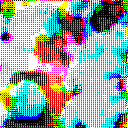

Batch 512 from 512 to 576
Gen loss: 1.3469878
Disc loss: 0.610892
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


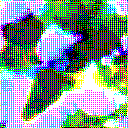

Batch 576 from 576 to 640
Gen loss: 1.3557806
Disc loss: 0.6477858
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


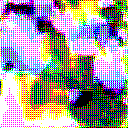


Epoch: 64
Batch 0 from 0 to 64
Gen loss: 1.2569028
Disc loss: 0.6708095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


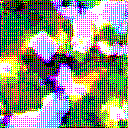

Batch 64 from 64 to 128
Gen loss: 1.3530779
Disc loss: 0.6503625
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


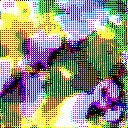

Batch 128 from 128 to 192
Gen loss: 1.3073683
Disc loss: 0.62351847
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


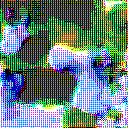

Batch 192 from 192 to 256
Gen loss: 1.3523672
Disc loss: 0.66122824
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


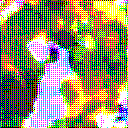

Batch 256 from 256 to 320
Gen loss: 1.3882643
Disc loss: 0.6086797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


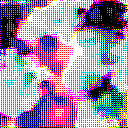

Batch 320 from 320 to 384
Gen loss: 1.2944887
Disc loss: 0.6427649
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


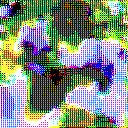

Batch 384 from 384 to 448
Gen loss: 1.2682359
Disc loss: 0.6328393
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


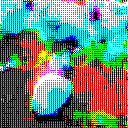

Batch 448 from 448 to 512
Gen loss: 1.3581073
Disc loss: 0.7025572
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


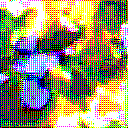

Batch 512 from 512 to 576
Gen loss: 1.34967
Disc loss: 0.6014458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


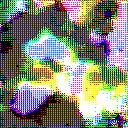

Batch 576 from 576 to 640
Gen loss: 1.406478
Disc loss: 0.63965416
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


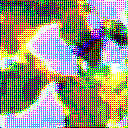


Epoch: 65
Batch 0 from 0 to 64
Gen loss: 1.3229674
Disc loss: 0.64286613
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


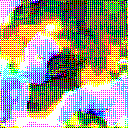

Batch 64 from 64 to 128
Gen loss: 1.4566611
Disc loss: 0.60162556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


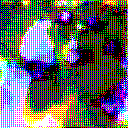

Batch 128 from 128 to 192
Gen loss: 1.3429213
Disc loss: 0.6214457
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


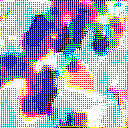

Batch 192 from 192 to 256
Gen loss: 1.4243311
Disc loss: 0.6262153
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


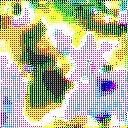

Batch 256 from 256 to 320
Gen loss: 1.2694976
Disc loss: 0.65328574
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


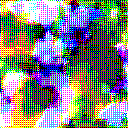

Batch 320 from 320 to 384
Gen loss: 1.3548021
Disc loss: 0.60557914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


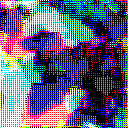

Batch 384 from 384 to 448
Gen loss: 1.3415658
Disc loss: 0.5968805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


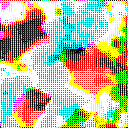

Batch 448 from 448 to 512
Gen loss: 1.3646388
Disc loss: 0.68559265
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


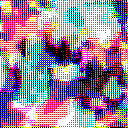

Batch 512 from 512 to 576
Gen loss: 1.3286655
Disc loss: 0.6159215
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


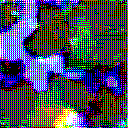

Batch 576 from 576 to 640
Gen loss: 1.4068975
Disc loss: 0.6249648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


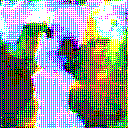


Epoch: 66
Batch 0 from 0 to 64
Gen loss: 1.4230901
Disc loss: 0.60939133
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


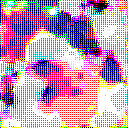

Batch 64 from 64 to 128
Gen loss: 1.387838
Disc loss: 0.62059563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


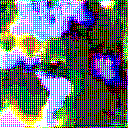

Batch 128 from 128 to 192
Gen loss: 1.4082835
Disc loss: 0.5822457
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


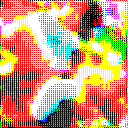

Batch 192 from 192 to 256
Gen loss: 1.3903625
Disc loss: 0.6375981
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


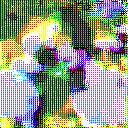

Batch 256 from 256 to 320
Gen loss: 1.3087976
Disc loss: 0.63612807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


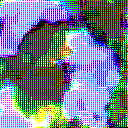

Batch 320 from 320 to 384
Gen loss: 1.4113216
Disc loss: 0.59014744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


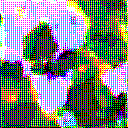

Batch 384 from 384 to 448
Gen loss: 1.3763115
Disc loss: 0.5984407
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


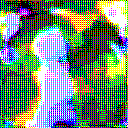

Batch 448 from 448 to 512
Gen loss: 1.2655116
Disc loss: 0.7422114
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


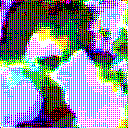

Batch 512 from 512 to 576
Gen loss: 1.4178625
Disc loss: 0.58221745
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


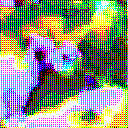

Batch 576 from 576 to 640
Gen loss: 1.3853494
Disc loss: 0.63609886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


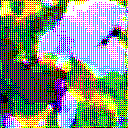


Epoch: 67
Batch 0 from 0 to 64
Gen loss: 1.3042405
Disc loss: 0.6493759
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


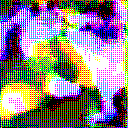

Batch 64 from 64 to 128
Gen loss: 1.3648889
Disc loss: 0.62468123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


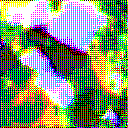

Batch 128 from 128 to 192
Gen loss: 1.3478405
Disc loss: 0.6056131
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


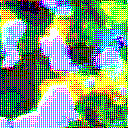

Batch 192 from 192 to 256
Gen loss: 1.3444841
Disc loss: 0.6572652
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


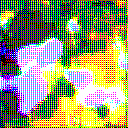

Batch 256 from 256 to 320
Gen loss: 1.364782
Disc loss: 0.6055969
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


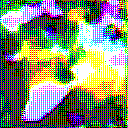

Batch 320 from 320 to 384
Gen loss: 1.4287455
Disc loss: 0.58328223
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


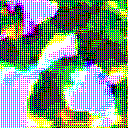

Batch 384 from 384 to 448
Gen loss: 1.3272736
Disc loss: 0.598719
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


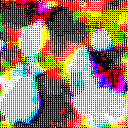

Batch 448 from 448 to 512
Gen loss: 1.4009738
Disc loss: 0.6622385
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


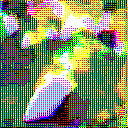

Batch 512 from 512 to 576
Gen loss: 1.3813897
Disc loss: 0.58765095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


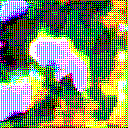

Batch 576 from 576 to 640
Gen loss: 1.3643149
Disc loss: 0.6251665
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


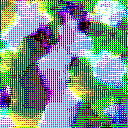


Epoch: 68
Batch 0 from 0 to 64
Gen loss: 1.3681964
Disc loss: 0.60752475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


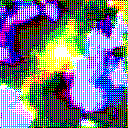

Batch 64 from 64 to 128
Gen loss: 1.3572013
Disc loss: 0.6335646
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


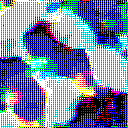

Batch 128 from 128 to 192
Gen loss: 1.3448081
Disc loss: 0.5987746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


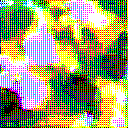

Batch 192 from 192 to 256
Gen loss: 1.4009665
Disc loss: 0.6224403
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


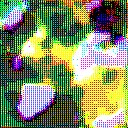

Batch 256 from 256 to 320
Gen loss: 1.348115
Disc loss: 0.61531746
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


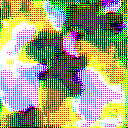

Batch 320 from 320 to 384
Gen loss: 1.3622577
Disc loss: 0.5937866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


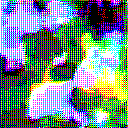

Batch 384 from 384 to 448
Gen loss: 1.3965869
Disc loss: 0.56753695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


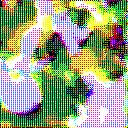

Batch 448 from 448 to 512
Gen loss: 1.3917809
Disc loss: 0.66094214
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


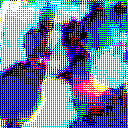

Batch 512 from 512 to 576
Gen loss: 1.3003268
Disc loss: 0.62092066
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


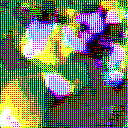

Batch 576 from 576 to 640
Gen loss: 1.4204897
Disc loss: 0.6122646
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


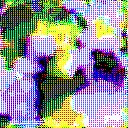


Epoch: 69
Batch 0 from 0 to 64
Gen loss: 1.3306878
Disc loss: 0.61717594
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


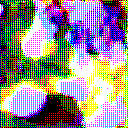

Batch 64 from 64 to 128
Gen loss: 1.370792
Disc loss: 0.61816555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


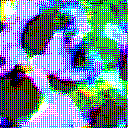

Batch 128 from 128 to 192
Gen loss: 1.4609497
Disc loss: 0.55616605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


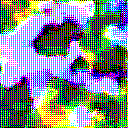

Batch 192 from 192 to 256
Gen loss: 1.4190515
Disc loss: 0.6202023
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


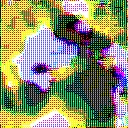

Batch 256 from 256 to 320
Gen loss: 1.4493603
Disc loss: 0.5774809
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


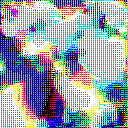

Batch 320 from 320 to 384
Gen loss: 1.3995786
Disc loss: 0.5774058
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


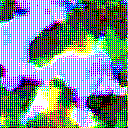

Batch 384 from 384 to 448
Gen loss: 1.4734805
Disc loss: 0.54391575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


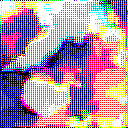

Batch 448 from 448 to 512
Gen loss: 1.3290942
Disc loss: 0.69221383
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


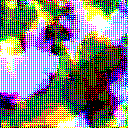

Batch 512 from 512 to 576
Gen loss: 1.433753
Disc loss: 0.5566881
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


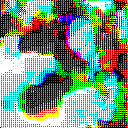

Batch 576 from 576 to 640
Gen loss: 1.4104289
Disc loss: 0.61856794
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


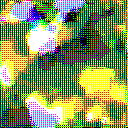


Epoch: 70
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.40852
Disc loss: 0.58795786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


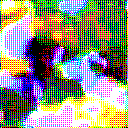

Batch 64 from 64 to 128
Gen loss: 1.3867439
Disc loss: 0.60783744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


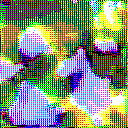

Batch 128 from 128 to 192
Gen loss: 1.4031544
Disc loss: 0.5712073
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


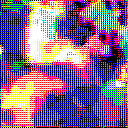

Batch 192 from 192 to 256
Gen loss: 1.402525
Disc loss: 0.6208241
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


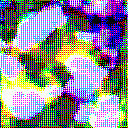

Batch 256 from 256 to 320
Gen loss: 1.4363664
Disc loss: 0.57485116
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


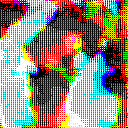

Batch 320 from 320 to 384
Gen loss: 1.3652043
Disc loss: 0.60452926
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


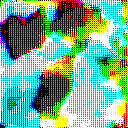

Batch 384 from 384 to 448
Gen loss: 1.3934555
Disc loss: 0.5687988
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


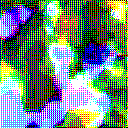

Batch 448 from 448 to 512
Gen loss: 1.4306953
Disc loss: 0.6514542
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


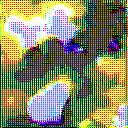

Batch 512 from 512 to 576
Gen loss: 1.4436245
Disc loss: 0.549054
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


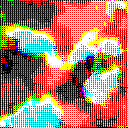

Batch 576 from 576 to 640
Gen loss: 1.3676794
Disc loss: 0.63251126
Disc fake accuracy: 0.974359
Disc real accuracy: 0.974359


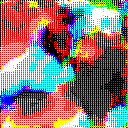


Epoch: 71
Batch 0 from 0 to 64
Gen loss: 1.3884013
Disc loss: 0.60553944
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


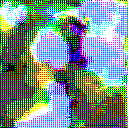

Batch 64 from 64 to 128
Gen loss: 1.3768208
Disc loss: 0.6111984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


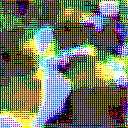

Batch 128 from 128 to 192
Gen loss: 1.5163014
Disc loss: 0.53678435
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


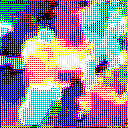

Batch 192 from 192 to 256
Gen loss: 1.4434699
Disc loss: 0.6070831
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


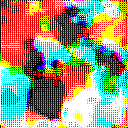

Batch 256 from 256 to 320
Gen loss: 1.4231989
Disc loss: 0.5772911
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


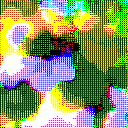

Batch 320 from 320 to 384
Gen loss: 1.4210181
Disc loss: 0.57957864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


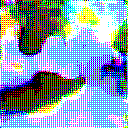

Batch 384 from 384 to 448
Gen loss: 1.4054792
Disc loss: 0.56925666
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


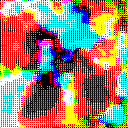

Batch 448 from 448 to 512
Gen loss: 1.4357051
Disc loss: 0.64511657
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


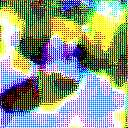

Batch 512 from 512 to 576
Gen loss: 1.4049826
Disc loss: 0.5592587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


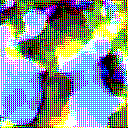

Batch 576 from 576 to 640
Gen loss: 1.2906903
Disc loss: 0.6544037
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


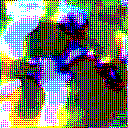


Epoch: 72
Batch 0 from 0 to 64
Gen loss: 1.4230876
Disc loss: 0.579343
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


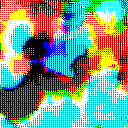

Batch 64 from 64 to 128
Gen loss: 1.37722
Disc loss: 0.6120423
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


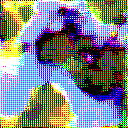

Batch 128 from 128 to 192
Gen loss: 1.4828582
Disc loss: 0.54579353
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


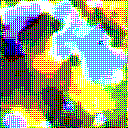

Batch 192 from 192 to 256
Gen loss: 1.4866333
Disc loss: 0.60119265
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


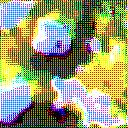

Batch 256 from 256 to 320
Gen loss: 1.3759146
Disc loss: 0.5986698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


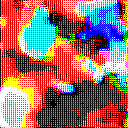

Batch 320 from 320 to 384
Gen loss: 1.5000237
Disc loss: 0.54284275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


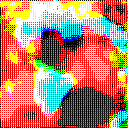

Batch 384 from 384 to 448
Gen loss: 1.527282
Disc loss: 0.5179769
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


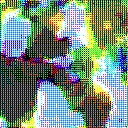

Batch 448 from 448 to 512
Gen loss: 1.4879615
Disc loss: 0.6237284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


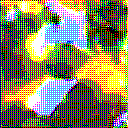

Batch 512 from 512 to 576
Gen loss: 1.4639136
Disc loss: 0.5582216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


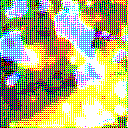

Batch 576 from 576 to 640
Gen loss: 1.3154796
Disc loss: 0.65067184
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


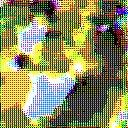


Epoch: 73
Batch 0 from 0 to 64
Gen loss: 1.536473
Disc loss: 0.55187285
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


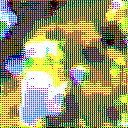

Batch 64 from 64 to 128
Gen loss: 1.4930165
Disc loss: 0.57094026
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


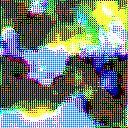

Batch 128 from 128 to 192
Gen loss: 1.5331067
Disc loss: 0.5266825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


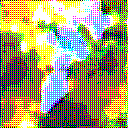

Batch 192 from 192 to 256
Gen loss: 1.4320538
Disc loss: 0.6073986
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


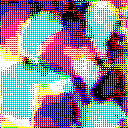

Batch 256 from 256 to 320
Gen loss: 1.5245771
Disc loss: 0.5432743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


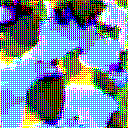

Batch 320 from 320 to 384
Gen loss: 1.4716029
Disc loss: 0.54557395
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


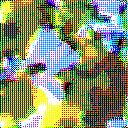

Batch 384 from 384 to 448
Gen loss: 1.5197846
Disc loss: 0.5230315
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


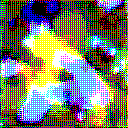

Batch 448 from 448 to 512
Gen loss: 1.5144024
Disc loss: 0.630998
Disc fake accuracy: 1.0
Disc real accuracy: 0.921875


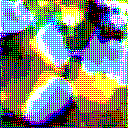

Batch 512 from 512 to 576
Gen loss: 1.4217627
Disc loss: 0.5531917
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


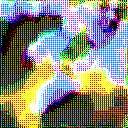

Batch 576 from 576 to 640
Gen loss: 1.4600478
Disc loss: 0.6175849
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


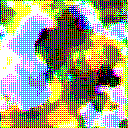


Epoch: 74
Batch 0 from 0 to 64
Gen loss: 1.4633328
Disc loss: 0.56250596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


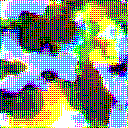

Batch 64 from 64 to 128
Gen loss: 1.5380523
Disc loss: 0.5579425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


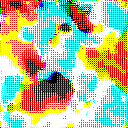

Batch 128 from 128 to 192
Gen loss: 1.531578
Disc loss: 0.5350367
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


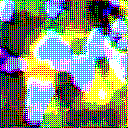

Batch 192 from 192 to 256
Gen loss: 1.5434083
Disc loss: 0.58276546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


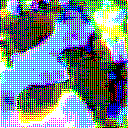

Batch 256 from 256 to 320
Gen loss: 1.5433723
Disc loss: 0.5442275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


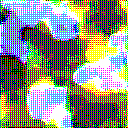

Batch 320 from 320 to 384
Gen loss: 1.5507191
Disc loss: 0.52535695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


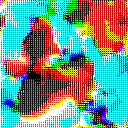

Batch 384 from 384 to 448
Gen loss: 1.5142628
Disc loss: 0.51705086
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


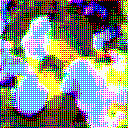

Batch 448 from 448 to 512
Gen loss: 1.5737236
Disc loss: 0.6101119
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


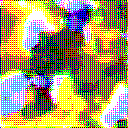

Batch 512 from 512 to 576
Gen loss: 1.4278541
Disc loss: 0.5515386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


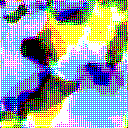

Batch 576 from 576 to 640
Gen loss: 1.413565
Disc loss: 0.62216306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


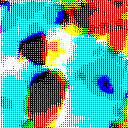


Epoch: 75
Batch 0 from 0 to 64
Gen loss: 1.5948539
Disc loss: 0.53634834
Disc fake accuracy: 1.0
Disc real accuracy: 0.953125


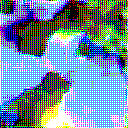

Batch 64 from 64 to 128
Gen loss: 1.5440893
Disc loss: 0.550351
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


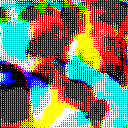

Batch 128 from 128 to 192
Gen loss: 1.5677397
Disc loss: 0.5142349
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


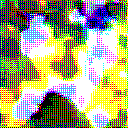

Batch 192 from 192 to 256
Gen loss: 1.4212775
Disc loss: 0.6087873
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


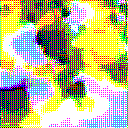

Batch 256 from 256 to 320
Gen loss: 1.5546503
Disc loss: 0.53337777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


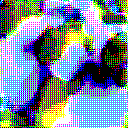

Batch 320 from 320 to 384
Gen loss: 1.5194314
Disc loss: 0.5398251
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


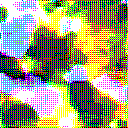

Batch 384 from 384 to 448
Gen loss: 1.4950116
Disc loss: 0.5323036
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


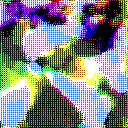

Batch 448 from 448 to 512
Gen loss: 1.4774652
Disc loss: 0.64580524
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


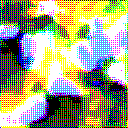

Batch 512 from 512 to 576
Gen loss: 1.4970858
Disc loss: 0.5288775
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


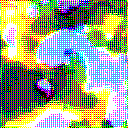

Batch 576 from 576 to 640
Gen loss: 1.5077381
Disc loss: 0.5971757
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


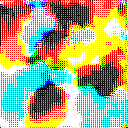


Epoch: 76
Batch 0 from 0 to 64
Gen loss: 1.5744836
Disc loss: 0.5280683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


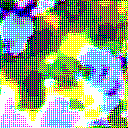

Batch 64 from 64 to 128
Gen loss: 1.5265914
Disc loss: 0.544004
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


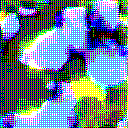

Batch 128 from 128 to 192
Gen loss: 1.4899448
Disc loss: 0.5371197
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


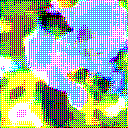

Batch 192 from 192 to 256
Gen loss: 1.5404088
Disc loss: 0.56239986
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


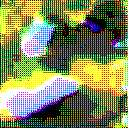

Batch 256 from 256 to 320
Gen loss: 1.471596
Disc loss: 0.55872107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


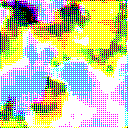

Batch 320 from 320 to 384
Gen loss: 1.4648035
Disc loss: 0.54876554
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


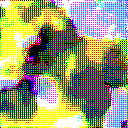

Batch 384 from 384 to 448
Gen loss: 1.4717624
Disc loss: 0.52968264
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


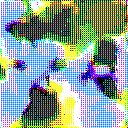

Batch 448 from 448 to 512
Gen loss: 1.5936618
Disc loss: 0.5886073
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


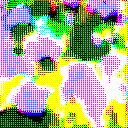

Batch 512 from 512 to 576
Gen loss: 1.579437
Disc loss: 0.5041723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


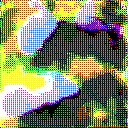

Batch 576 from 576 to 640
Gen loss: 1.4608455
Disc loss: 0.5914084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


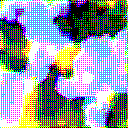


Epoch: 77
Batch 0 from 0 to 64
Gen loss: 1.5745502
Disc loss: 0.5209726
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


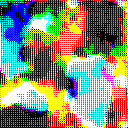

Batch 64 from 64 to 128
Gen loss: 1.5361772
Disc loss: 0.5540881
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


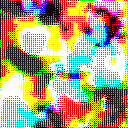

Batch 128 from 128 to 192
Gen loss: 1.5333806
Disc loss: 0.5184647
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


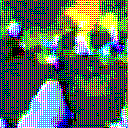

Batch 192 from 192 to 256
Gen loss: 1.4659967
Disc loss: 0.58773136
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


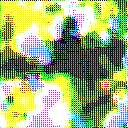

Batch 256 from 256 to 320
Gen loss: 1.4902587
Disc loss: 0.55698943
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


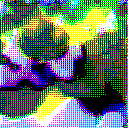

Batch 320 from 320 to 384
Gen loss: 1.507992
Disc loss: 0.5251119
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


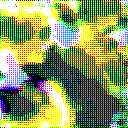

Batch 384 from 384 to 448
Gen loss: 1.4207411
Disc loss: 0.54624903
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


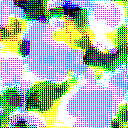

Batch 448 from 448 to 512
Gen loss: 1.4659536
Disc loss: 0.62150764
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


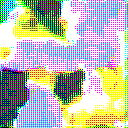

Batch 512 from 512 to 576
Gen loss: 1.3843741
Disc loss: 0.5634684
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


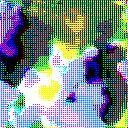

Batch 576 from 576 to 640
Gen loss: 1.3846275
Disc loss: 0.6124262
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


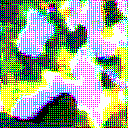


Epoch: 78
Batch 0 from 0 to 64
Gen loss: 1.4547665
Disc loss: 0.562579
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


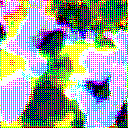

Batch 64 from 64 to 128
Gen loss: 1.5213711
Disc loss: 0.5458868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


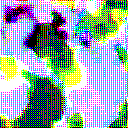

Batch 128 from 128 to 192
Gen loss: 1.423429
Disc loss: 0.546576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


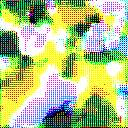

Batch 192 from 192 to 256
Gen loss: 1.5221858
Disc loss: 0.56042266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


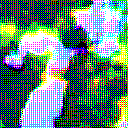

Batch 256 from 256 to 320
Gen loss: 1.466975
Disc loss: 0.54415333
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


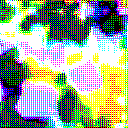

Batch 320 from 320 to 384
Gen loss: 1.5792723
Disc loss: 0.50810593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


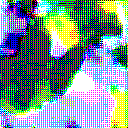

Batch 384 from 384 to 448
Gen loss: 1.5268507
Disc loss: 0.5020641
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


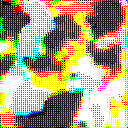

Batch 448 from 448 to 512
Gen loss: 1.4825219
Disc loss: 0.61712354
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


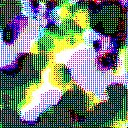

Batch 512 from 512 to 576
Gen loss: 1.5919716
Disc loss: 0.48872453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


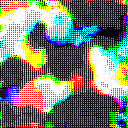

Batch 576 from 576 to 640
Gen loss: 1.541444
Disc loss: 0.5361537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


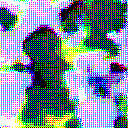


Epoch: 79
Batch 0 from 0 to 64
Gen loss: 1.4581991
Disc loss: 0.5570829
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


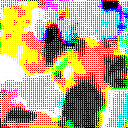

Batch 64 from 64 to 128
Gen loss: 1.5216484
Disc loss: 0.53921086
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


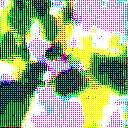

Batch 128 from 128 to 192
Gen loss: 1.4621564
Disc loss: 0.52796984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


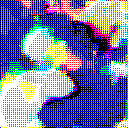

Batch 192 from 192 to 256
Gen loss: 1.4647056
Disc loss: 0.57395566
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


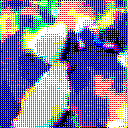

Batch 256 from 256 to 320
Gen loss: 1.4347377
Disc loss: 0.55669343
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


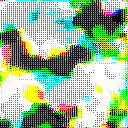

Batch 320 from 320 to 384
Gen loss: 1.3957703
Disc loss: 0.5604166
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


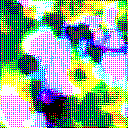

Batch 384 from 384 to 448
Gen loss: 1.5466583
Disc loss: 0.49371356
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


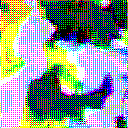

Batch 448 from 448 to 512
Gen loss: 1.5591502
Disc loss: 0.58433217
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


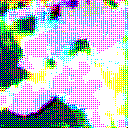

Batch 512 from 512 to 576
Gen loss: 1.4452889
Disc loss: 0.52767724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


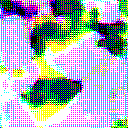

Batch 576 from 576 to 640
Gen loss: 1.4732963
Disc loss: 0.5611294
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


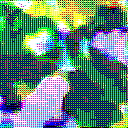


Epoch: 80
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.6209431
Disc loss: 0.50194126
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


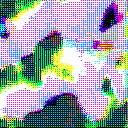

Batch 64 from 64 to 128
Gen loss: 1.5537634
Disc loss: 0.5283545
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


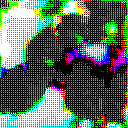

Batch 128 from 128 to 192
Gen loss: 1.5309837
Disc loss: 0.50822866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


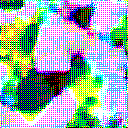

Batch 192 from 192 to 256
Gen loss: 1.5656267
Disc loss: 0.54251295
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


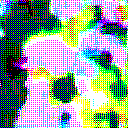

Batch 256 from 256 to 320
Gen loss: 1.5869603
Disc loss: 0.50463057
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


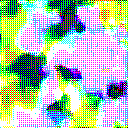

Batch 320 from 320 to 384
Gen loss: 1.6576252
Disc loss: 0.47851565
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


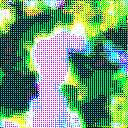

Batch 384 from 384 to 448
Gen loss: 1.5013883
Disc loss: 0.49613556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


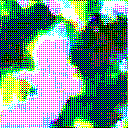

Batch 448 from 448 to 512
Gen loss: 1.6957282
Disc loss: 0.5384089
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


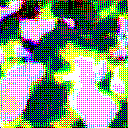

Batch 512 from 512 to 576
Gen loss: 1.4648458
Disc loss: 0.5285826
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


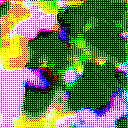

Batch 576 from 576 to 640
Gen loss: 1.510422
Disc loss: 0.5376452
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


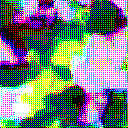


Epoch: 81
Batch 0 from 0 to 64
Gen loss: 1.5268974
Disc loss: 0.52933264
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


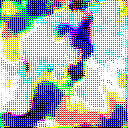

Batch 64 from 64 to 128
Gen loss: 1.587645
Disc loss: 0.51407
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


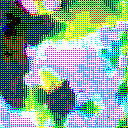

Batch 128 from 128 to 192
Gen loss: 1.5533442
Disc loss: 0.49646866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


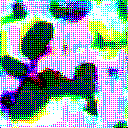

Batch 192 from 192 to 256
Gen loss: 1.519048
Disc loss: 0.550949
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


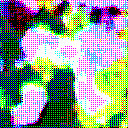

Batch 256 from 256 to 320
Gen loss: 1.544245
Disc loss: 0.5136615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


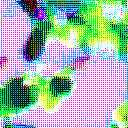

Batch 320 from 320 to 384
Gen loss: 1.5254016
Disc loss: 0.50494653
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


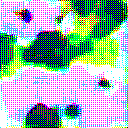

Batch 384 from 384 to 448
Gen loss: 1.5525706
Disc loss: 0.49004805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


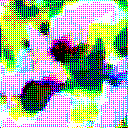

Batch 448 from 448 to 512
Gen loss: 1.5363805
Disc loss: 0.5773907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


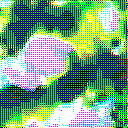

Batch 512 from 512 to 576
Gen loss: 1.5568901
Disc loss: 0.4851147
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


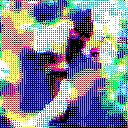

Batch 576 from 576 to 640
Gen loss: 1.4696943
Disc loss: 0.5474153
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


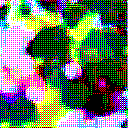


Epoch: 82
Batch 0 from 0 to 64
Gen loss: 1.5451546
Disc loss: 0.51455516
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


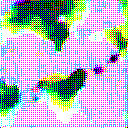

Batch 64 from 64 to 128
Gen loss: 1.5388681
Disc loss: 0.5227921
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


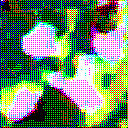

Batch 128 from 128 to 192
Gen loss: 1.6081234
Disc loss: 0.47353673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


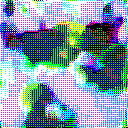

Batch 192 from 192 to 256
Gen loss: 1.6446855
Disc loss: 0.51015025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


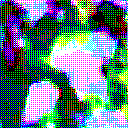

Batch 256 from 256 to 320
Gen loss: 1.5496287
Disc loss: 0.5076823
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


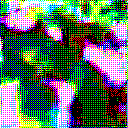

Batch 320 from 320 to 384
Gen loss: 1.5473323
Disc loss: 0.49391577
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


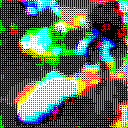

Batch 384 from 384 to 448
Gen loss: 1.5320284
Disc loss: 0.48844376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


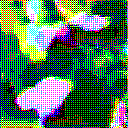

Batch 448 from 448 to 512
Gen loss: 1.5856435
Disc loss: 0.56969863
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


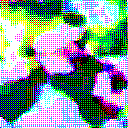

Batch 512 from 512 to 576
Gen loss: 1.6226397
Disc loss: 0.4683025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


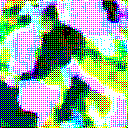

Batch 576 from 576 to 640
Gen loss: 1.5277547
Disc loss: 0.5330429
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


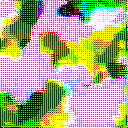


Epoch: 83
Batch 0 from 0 to 64
Gen loss: 1.5983915
Disc loss: 0.49637848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


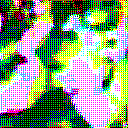

Batch 64 from 64 to 128
Gen loss: 1.5818031
Disc loss: 0.5086881
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


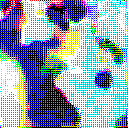

Batch 128 from 128 to 192
Gen loss: 1.589902
Disc loss: 0.47614682
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


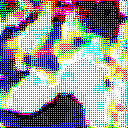

Batch 192 from 192 to 256
Gen loss: 1.5762601
Disc loss: 0.52310336
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


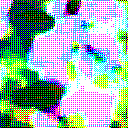

Batch 256 from 256 to 320
Gen loss: 1.539972
Disc loss: 0.5065297
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


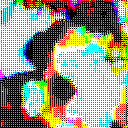

Batch 320 from 320 to 384
Gen loss: 1.6014419
Disc loss: 0.47873712
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


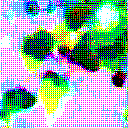

Batch 384 from 384 to 448
Gen loss: 1.5458772
Disc loss: 0.49059412
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


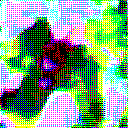

Batch 448 from 448 to 512
Gen loss: 1.607237
Disc loss: 0.55178833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


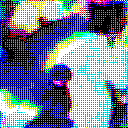

Batch 512 from 512 to 576
Gen loss: 1.5154276
Disc loss: 0.494614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


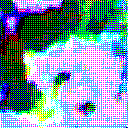

Batch 576 from 576 to 640
Gen loss: 1.6260438
Disc loss: 0.50809544
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


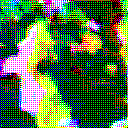


Epoch: 84
Batch 0 from 0 to 64
Gen loss: 1.4482393
Disc loss: 0.5334265
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


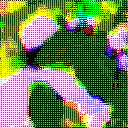

Batch 64 from 64 to 128
Gen loss: 1.6313725
Disc loss: 0.4899756
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


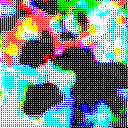

Batch 128 from 128 to 192
Gen loss: 1.6081462
Disc loss: 0.47165555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


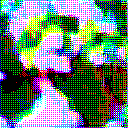

Batch 192 from 192 to 256
Gen loss: 1.4729948
Disc loss: 0.5571747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


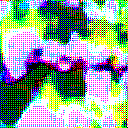

Batch 256 from 256 to 320
Gen loss: 1.644083
Disc loss: 0.4781996
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


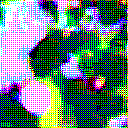

Batch 320 from 320 to 384
Gen loss: 1.5021527
Disc loss: 0.5035085
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


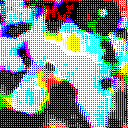

Batch 384 from 384 to 448
Gen loss: 1.4837323
Disc loss: 0.4989054
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


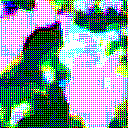

Batch 448 from 448 to 512
Gen loss: 1.63788
Disc loss: 0.5449342
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


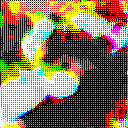

Batch 512 from 512 to 576
Gen loss: 1.4570186
Disc loss: 0.5081606
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


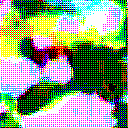

Batch 576 from 576 to 640
Gen loss: 1.5062203
Disc loss: 0.52954364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


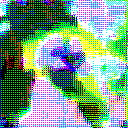


Epoch: 85
Batch 0 from 0 to 64
Gen loss: 1.4571545
Disc loss: 0.53280044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


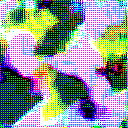

Batch 64 from 64 to 128
Gen loss: 1.5254397
Disc loss: 0.51457155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


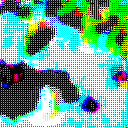

Batch 128 from 128 to 192
Gen loss: 1.5485168
Disc loss: 0.487055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


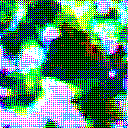

Batch 192 from 192 to 256
Gen loss: 1.5362958
Disc loss: 0.54137754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


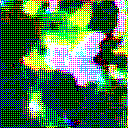

Batch 256 from 256 to 320
Gen loss: 1.4711134
Disc loss: 0.52295196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


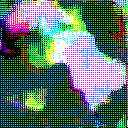

Batch 320 from 320 to 384
Gen loss: 1.5744042
Disc loss: 0.4882229
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


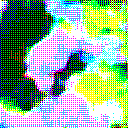

Batch 384 from 384 to 448
Gen loss: 1.4884014
Disc loss: 0.48767418
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


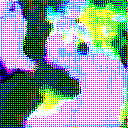

Batch 448 from 448 to 512
Gen loss: 1.4820061
Disc loss: 0.58379316
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


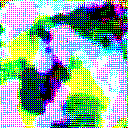

Batch 512 from 512 to 576
Gen loss: 1.6173849
Disc loss: 0.46785483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


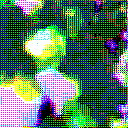

Batch 576 from 576 to 640
Gen loss: 1.6042349
Disc loss: 0.50680286
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


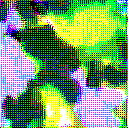


Epoch: 86
Batch 0 from 0 to 64
Gen loss: 1.4939132
Disc loss: 0.52901685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


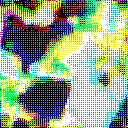

Batch 64 from 64 to 128
Gen loss: 1.6386831
Disc loss: 0.48916197
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


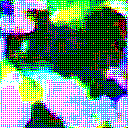

Batch 128 from 128 to 192
Gen loss: 1.5115521
Disc loss: 0.49904528
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


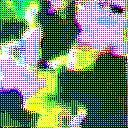

Batch 192 from 192 to 256
Gen loss: 1.5806345
Disc loss: 0.5213747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


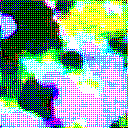

Batch 256 from 256 to 320
Gen loss: 1.5378346
Disc loss: 0.49622402
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


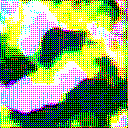

Batch 320 from 320 to 384
Gen loss: 1.531653
Disc loss: 0.49234867
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


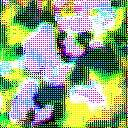

Batch 384 from 384 to 448
Gen loss: 1.6041175
Disc loss: 0.46063697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


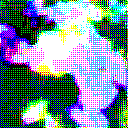

Batch 448 from 448 to 512
Gen loss: 1.506644
Disc loss: 0.57662314
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


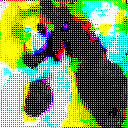

Batch 512 from 512 to 576
Gen loss: 1.5031568
Disc loss: 0.49175695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


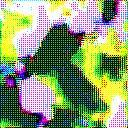

Batch 576 from 576 to 640
Gen loss: 1.4317431
Disc loss: 0.5665258
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


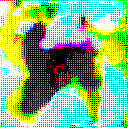


Epoch: 87
Batch 0 from 0 to 64
Gen loss: 1.5722915
Disc loss: 0.48961958
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


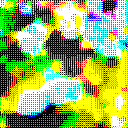

Batch 64 from 64 to 128
Gen loss: 1.6801162
Disc loss: 0.47346687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


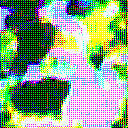

Batch 128 from 128 to 192
Gen loss: 1.604773
Disc loss: 0.47958252
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


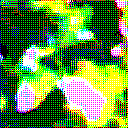

Batch 192 from 192 to 256
Gen loss: 1.6770939
Disc loss: 0.49507546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


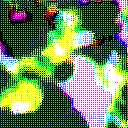

Batch 256 from 256 to 320
Gen loss: 1.6142642
Disc loss: 0.47637814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


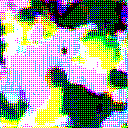

Batch 320 from 320 to 384
Gen loss: 1.6571219
Disc loss: 0.45428398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


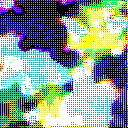

Batch 384 from 384 to 448
Gen loss: 1.6517429
Disc loss: 0.44320512
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


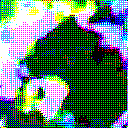

Batch 448 from 448 to 512
Gen loss: 1.6432353
Disc loss: 0.5373897
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


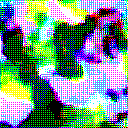

Batch 512 from 512 to 576
Gen loss: 1.6095123
Disc loss: 0.4606552
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


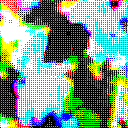

Batch 576 from 576 to 640
Gen loss: 1.6184335
Disc loss: 0.48998165
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


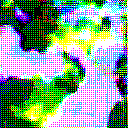


Epoch: 88
Batch 0 from 0 to 64
Gen loss: 1.6123557
Disc loss: 0.48452085
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


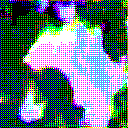

Batch 64 from 64 to 128
Gen loss: 1.653292
Disc loss: 0.48162225
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


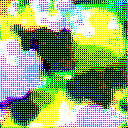

Batch 128 from 128 to 192
Gen loss: 1.5181872
Disc loss: 0.48551345
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


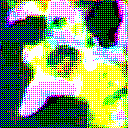

Batch 192 from 192 to 256
Gen loss: 1.6356668
Disc loss: 0.5054367
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


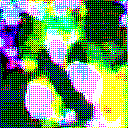

Batch 256 from 256 to 320
Gen loss: 1.7276075
Disc loss: 0.4538806
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


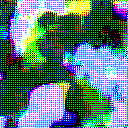

Batch 320 from 320 to 384
Gen loss: 1.6555011
Disc loss: 0.4647347
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


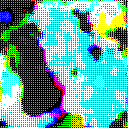

Batch 384 from 384 to 448
Gen loss: 1.673169
Disc loss: 0.44121796
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


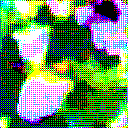

Batch 448 from 448 to 512
Gen loss: 1.6383653
Disc loss: 0.5494735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


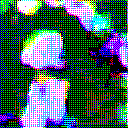

Batch 512 from 512 to 576
Gen loss: 1.5929487
Disc loss: 0.46617877
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


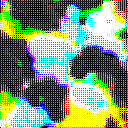

Batch 576 from 576 to 640
Gen loss: 1.725048
Disc loss: 0.45794308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


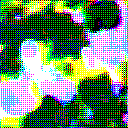


Epoch: 89
Batch 0 from 0 to 64
Gen loss: 1.7240489
Disc loss: 0.4459551
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


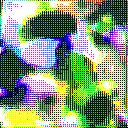

Batch 64 from 64 to 128
Gen loss: 1.6117964
Disc loss: 0.48785114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


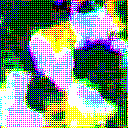

Batch 128 from 128 to 192
Gen loss: 1.5700177
Disc loss: 0.47060692
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


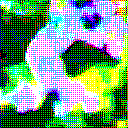

Batch 192 from 192 to 256
Gen loss: 1.5942771
Disc loss: 0.505437
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


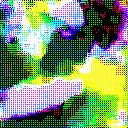

Batch 256 from 256 to 320
Gen loss: 1.6392078
Disc loss: 0.46446502
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


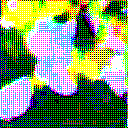

Batch 320 from 320 to 384
Gen loss: 1.7078428
Disc loss: 0.43823493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


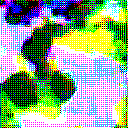

Batch 384 from 384 to 448
Gen loss: 1.5558412
Disc loss: 0.47327074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


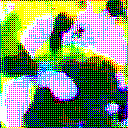

Batch 448 from 448 to 512
Gen loss: 1.7136264
Disc loss: 0.5111265
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


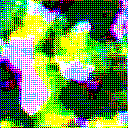

Batch 512 from 512 to 576
Gen loss: 1.7174466
Disc loss: 0.42915392
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


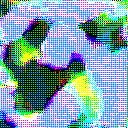

Batch 576 from 576 to 640
Gen loss: 1.5817723
Disc loss: 0.4931444
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


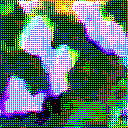


Epoch: 90
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.6812022
Disc loss: 0.45643306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


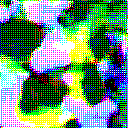

Batch 64 from 64 to 128
Gen loss: 1.614733
Disc loss: 0.48548314
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


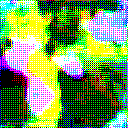

Batch 128 from 128 to 192
Gen loss: 1.6265285
Disc loss: 0.45550266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


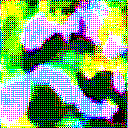

Batch 192 from 192 to 256
Gen loss: 1.7224026
Disc loss: 0.47246277
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


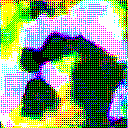

Batch 256 from 256 to 320
Gen loss: 1.6056031
Disc loss: 0.47481218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


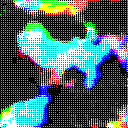

Batch 320 from 320 to 384
Gen loss: 1.6026404
Disc loss: 0.46543562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


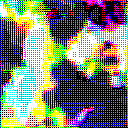

Batch 384 from 384 to 448
Gen loss: 1.6454072
Disc loss: 0.43353975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


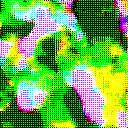

Batch 448 from 448 to 512
Gen loss: 1.7057043
Disc loss: 0.50804496
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


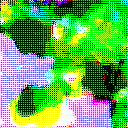

Batch 512 from 512 to 576
Gen loss: 1.5162609
Disc loss: 0.4737144
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


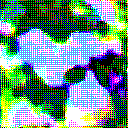

Batch 576 from 576 to 640
Gen loss: 1.8112409
Disc loss: 0.43990856
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


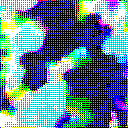


Epoch: 91
Batch 0 from 0 to 64
Gen loss: 1.791986
Disc loss: 0.4282619
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


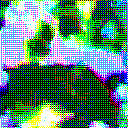

Batch 64 from 64 to 128
Gen loss: 1.7675395
Disc loss: 0.44380587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


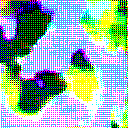

Batch 128 from 128 to 192
Gen loss: 1.6244082
Disc loss: 0.45340574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


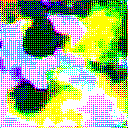

Batch 192 from 192 to 256
Gen loss: 1.7429185
Disc loss: 0.46458784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


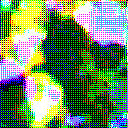

Batch 256 from 256 to 320
Gen loss: 1.8298995
Disc loss: 0.4143024
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


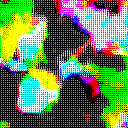

Batch 320 from 320 to 384
Gen loss: 1.5705539
Disc loss: 0.46765143
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


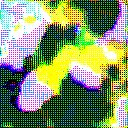

Batch 384 from 384 to 448
Gen loss: 1.6466814
Disc loss: 0.43913934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


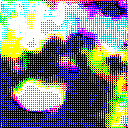

Batch 448 from 448 to 512
Gen loss: 1.6464205
Disc loss: 0.5235163
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


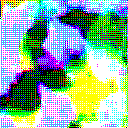

Batch 512 from 512 to 576
Gen loss: 1.7154427
Disc loss: 0.4242512
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


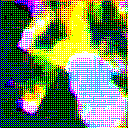

Batch 576 from 576 to 640
Gen loss: 1.6931094
Disc loss: 0.45827746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


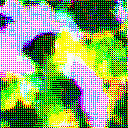


Epoch: 92
Batch 0 from 0 to 64
Gen loss: 1.6672406
Disc loss: 0.45474452
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


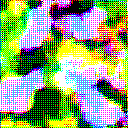

Batch 64 from 64 to 128
Gen loss: 1.5200917
Disc loss: 0.50847596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


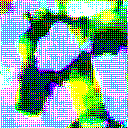

Batch 128 from 128 to 192
Gen loss: 1.6111389
Disc loss: 0.44617665
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


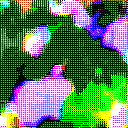

Batch 192 from 192 to 256
Gen loss: 1.603522
Disc loss: 0.495602
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


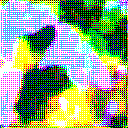

Batch 256 from 256 to 320
Gen loss: 1.5250363
Disc loss: 0.48458922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


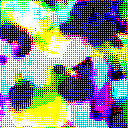

Batch 320 from 320 to 384
Gen loss: 1.6866161
Disc loss: 0.43253928
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


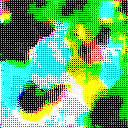

Batch 384 from 384 to 448
Gen loss: 1.6333568
Disc loss: 0.43712276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


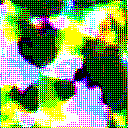

Batch 448 from 448 to 512
Gen loss: 1.6452166
Disc loss: 0.524117
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


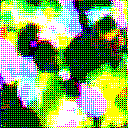

Batch 512 from 512 to 576
Gen loss: 1.5632548
Disc loss: 0.46649486
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


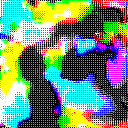

Batch 576 from 576 to 640
Gen loss: 1.6513964
Disc loss: 0.48039356
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


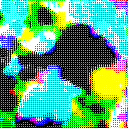


Epoch: 93
Batch 0 from 0 to 64
Gen loss: 1.7158358
Disc loss: 0.44368553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


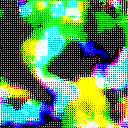

Batch 64 from 64 to 128
Gen loss: 1.7229793
Disc loss: 0.4578707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


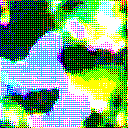

Batch 128 from 128 to 192
Gen loss: 1.5834619
Disc loss: 0.45995593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


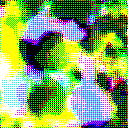

Batch 192 from 192 to 256
Gen loss: 1.6268396
Disc loss: 0.5012212
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


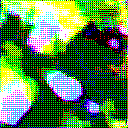

Batch 256 from 256 to 320
Gen loss: 1.4636607
Disc loss: 0.5058874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


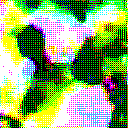

Batch 320 from 320 to 384
Gen loss: 1.4607502
Disc loss: 0.50028825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


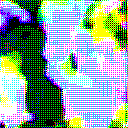

Batch 384 from 384 to 448
Gen loss: 1.5299258
Disc loss: 0.46636248
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


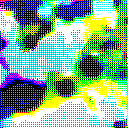

Batch 448 from 448 to 512
Gen loss: 1.606185
Disc loss: 0.54042757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


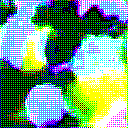

Batch 512 from 512 to 576
Gen loss: 1.5356236
Disc loss: 0.46872386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


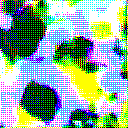

Batch 576 from 576 to 640
Gen loss: 1.5845397
Disc loss: 0.50744593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


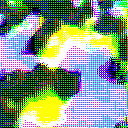


Epoch: 94
Batch 0 from 0 to 64
Gen loss: 1.5007706
Disc loss: 0.5109955
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


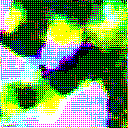

Batch 64 from 64 to 128
Gen loss: 1.5602328
Disc loss: 0.503417
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


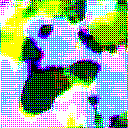

Batch 128 from 128 to 192
Gen loss: 1.6228993
Disc loss: 0.4488538
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


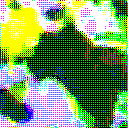

Batch 192 from 192 to 256
Gen loss: 1.7182338
Disc loss: 0.46998352
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


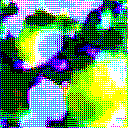

Batch 256 from 256 to 320
Gen loss: 1.608068
Disc loss: 0.4626213
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


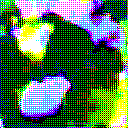

Batch 320 from 320 to 384
Gen loss: 1.5640302
Disc loss: 0.46797284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


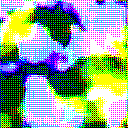

Batch 384 from 384 to 448
Gen loss: 1.7168559
Disc loss: 0.4160263
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


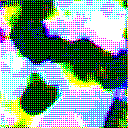

Batch 448 from 448 to 512
Gen loss: 1.5714027
Disc loss: 0.5456315
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


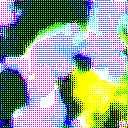

Batch 512 from 512 to 576
Gen loss: 1.5444715
Disc loss: 0.46903
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


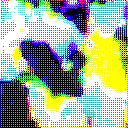

Batch 576 from 576 to 640
Gen loss: 1.691348
Disc loss: 0.4620999
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


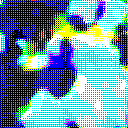


Epoch: 95
Batch 0 from 0 to 64
Gen loss: 1.6235406
Disc loss: 0.4658609
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


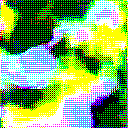

Batch 64 from 64 to 128
Gen loss: 1.7293016
Disc loss: 0.44703543
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


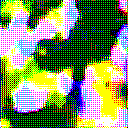

Batch 128 from 128 to 192
Gen loss: 1.6871654
Disc loss: 0.4313442
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


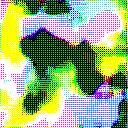

Batch 192 from 192 to 256
Gen loss: 1.6809933
Disc loss: 0.47499898
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


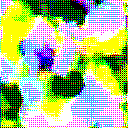

Batch 256 from 256 to 320
Gen loss: 1.703283
Disc loss: 0.43922478
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


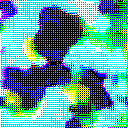

Batch 320 from 320 to 384
Gen loss: 1.7769798
Disc loss: 0.40904582
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


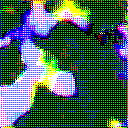

Batch 384 from 384 to 448
Gen loss: 1.6367606
Disc loss: 0.4406634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


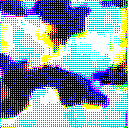

Batch 448 from 448 to 512
Gen loss: 1.6135867
Disc loss: 0.52893585
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


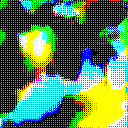

Batch 512 from 512 to 576
Gen loss: 1.648864
Disc loss: 0.43810633
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


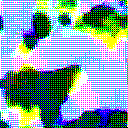

Batch 576 from 576 to 640
Gen loss: 1.6777688
Disc loss: 0.46790707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


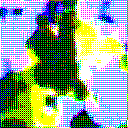


Epoch: 96
Batch 0 from 0 to 64
Gen loss: 1.435317
Disc loss: 0.5272481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


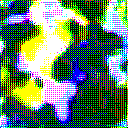

Batch 64 from 64 to 128
Gen loss: 1.7071923
Disc loss: 0.44905144
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


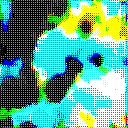

Batch 128 from 128 to 192
Gen loss: 1.6958859
Disc loss: 0.4285913
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


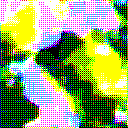

Batch 192 from 192 to 256
Gen loss: 1.7251813
Disc loss: 0.4628396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


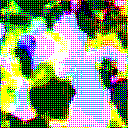

Batch 256 from 256 to 320
Gen loss: 1.7487526
Disc loss: 0.42571673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


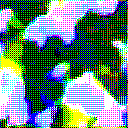

Batch 320 from 320 to 384
Gen loss: 1.705835
Disc loss: 0.4255703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


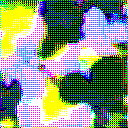

Batch 384 from 384 to 448
Gen loss: 1.6609904
Disc loss: 0.42546827
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


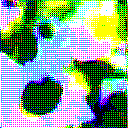

Batch 448 from 448 to 512
Gen loss: 1.7406275
Disc loss: 0.5034975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


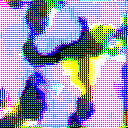

Batch 512 from 512 to 576
Gen loss: 1.7560672
Disc loss: 0.41118032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


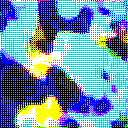

Batch 576 from 576 to 640
Gen loss: 1.6582217
Disc loss: 0.4835218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


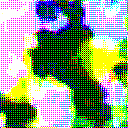


Epoch: 97
Batch 0 from 0 to 64
Gen loss: 1.7981869
Disc loss: 0.4211285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


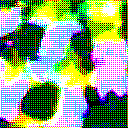

Batch 64 from 64 to 128
Gen loss: 1.7874281
Disc loss: 0.434464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


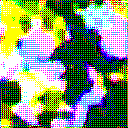

Batch 128 from 128 to 192
Gen loss: 1.7731512
Disc loss: 0.41144165
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


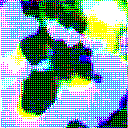

Batch 192 from 192 to 256
Gen loss: 1.6797271
Disc loss: 0.47169036
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


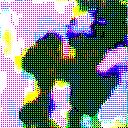

Batch 256 from 256 to 320
Gen loss: 1.7673098
Disc loss: 0.42705083
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


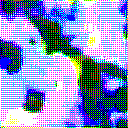

Batch 320 from 320 to 384
Gen loss: 1.7500453
Disc loss: 0.41061226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


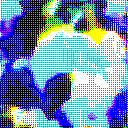

Batch 384 from 384 to 448
Gen loss: 1.6180313
Disc loss: 0.4412231
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


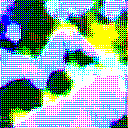

Batch 448 from 448 to 512
Gen loss: 1.8028738
Disc loss: 0.4841628
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


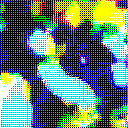

Batch 512 from 512 to 576
Gen loss: 1.6924162
Disc loss: 0.43254554
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


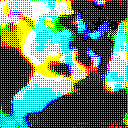

Batch 576 from 576 to 640
Gen loss: 1.6581784
Disc loss: 0.45714796
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


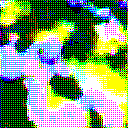


Epoch: 98
Batch 0 from 0 to 64
Gen loss: 1.5400491
Disc loss: 0.48422328
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


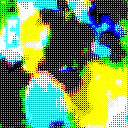

Batch 64 from 64 to 128
Gen loss: 1.6583039
Disc loss: 0.45937675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


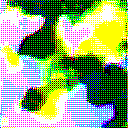

Batch 128 from 128 to 192
Gen loss: 1.6894159
Disc loss: 0.42419428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


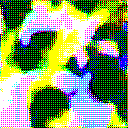

Batch 192 from 192 to 256
Gen loss: 1.8943099
Disc loss: 0.42447153
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


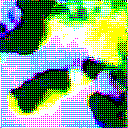

Batch 256 from 256 to 320
Gen loss: 1.6718082
Disc loss: 0.4372337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


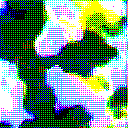

Batch 320 from 320 to 384
Gen loss: 1.6870856
Disc loss: 0.42694807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


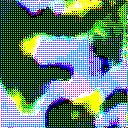

Batch 384 from 384 to 448
Gen loss: 1.7126201
Disc loss: 0.4110129
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


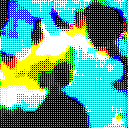

Batch 448 from 448 to 512
Gen loss: 1.6019434
Disc loss: 0.5216526
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


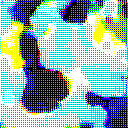

Batch 512 from 512 to 576
Gen loss: 1.7333707
Disc loss: 0.40866274
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


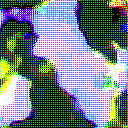

Batch 576 from 576 to 640
Gen loss: 1.6006603
Disc loss: 0.47181952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


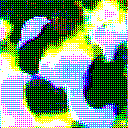


Epoch: 99
Batch 0 from 0 to 64
Gen loss: 1.5455061
Disc loss: 0.4875756
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


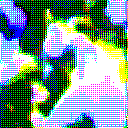

Batch 64 from 64 to 128
Gen loss: 1.6907277
Disc loss: 0.44751316
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


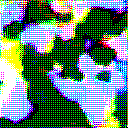

Batch 128 from 128 to 192
Gen loss: 1.7048259
Disc loss: 0.4142539
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


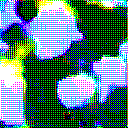

Batch 192 from 192 to 256
Gen loss: 1.7096279
Disc loss: 0.46384203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


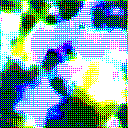

Batch 256 from 256 to 320
Gen loss: 1.83493
Disc loss: 0.40752292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


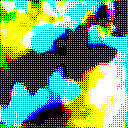

Batch 320 from 320 to 384
Gen loss: 1.8092158
Disc loss: 0.39839712
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


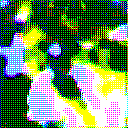

Batch 384 from 384 to 448
Gen loss: 1.7467422
Disc loss: 0.4064893
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


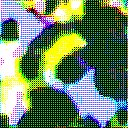

Batch 448 from 448 to 512
Gen loss: 1.6572506
Disc loss: 0.5057645
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


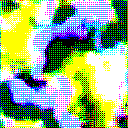

Batch 512 from 512 to 576
Gen loss: 1.7230227
Disc loss: 0.4059277
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


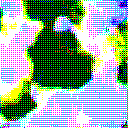

Batch 576 from 576 to 640
Gen loss: 1.8229525
Disc loss: 0.41578084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


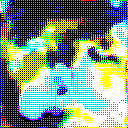


Epoch: 100
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.9073699
Disc loss: 0.39021498
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


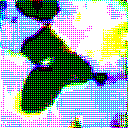

Batch 64 from 64 to 128
Gen loss: 1.6397843
Disc loss: 0.45140165
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


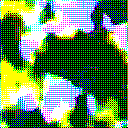

Batch 128 from 128 to 192
Gen loss: 1.7358918
Disc loss: 0.4094392
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


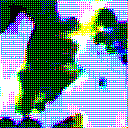

Batch 192 from 192 to 256
Gen loss: 1.8217068
Disc loss: 0.43245715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


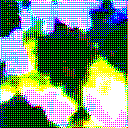

Batch 256 from 256 to 320
Gen loss: 1.6457484
Disc loss: 0.44753945
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


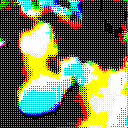

Batch 320 from 320 to 384
Gen loss: 1.8664024
Disc loss: 0.37571245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


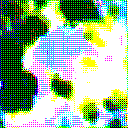

Batch 384 from 384 to 448
Gen loss: 1.7394574
Disc loss: 0.39649463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


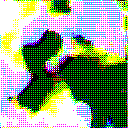

Batch 448 from 448 to 512
Gen loss: 1.6294096
Disc loss: 0.5114547
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


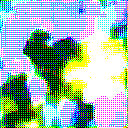

Batch 512 from 512 to 576
Gen loss: 1.659121
Disc loss: 0.41566077
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


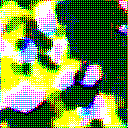

Batch 576 from 576 to 640
Gen loss: 1.6138692
Disc loss: 0.4644271
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


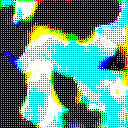


Epoch: 101
Batch 0 from 0 to 64
Gen loss: 1.6275308
Disc loss: 0.44796243
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


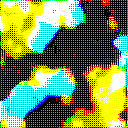

Batch 64 from 64 to 128
Gen loss: 1.6582441
Disc loss: 0.44794706
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


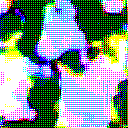

Batch 128 from 128 to 192
Gen loss: 1.7191261
Disc loss: 0.40532398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


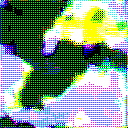

Batch 192 from 192 to 256
Gen loss: 1.7800982
Disc loss: 0.43737477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


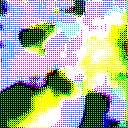

Batch 256 from 256 to 320
Gen loss: 1.8742676
Disc loss: 0.38513505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


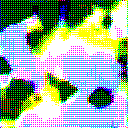

Batch 320 from 320 to 384
Gen loss: 1.9071928
Disc loss: 0.3690141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


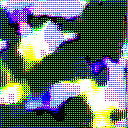

Batch 384 from 384 to 448
Gen loss: 1.7008893
Disc loss: 0.40015644
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


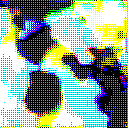

Batch 448 from 448 to 512
Gen loss: 1.6951392
Disc loss: 0.48846838
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


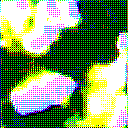

Batch 512 from 512 to 576
Gen loss: 1.7612829
Disc loss: 0.3980415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


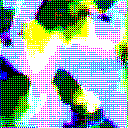

Batch 576 from 576 to 640
Gen loss: 1.8353854
Disc loss: 0.41086206
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


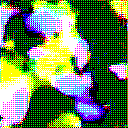


Epoch: 102
Batch 0 from 0 to 64
Gen loss: 1.7142309
Disc loss: 0.42974198
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


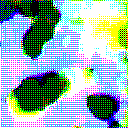

Batch 64 from 64 to 128
Gen loss: 1.6596825
Disc loss: 0.44581974
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


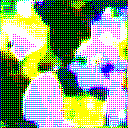

Batch 128 from 128 to 192
Gen loss: 1.6071763
Disc loss: 0.44071442
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


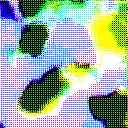

Batch 192 from 192 to 256
Gen loss: 1.679717
Disc loss: 0.4576561
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


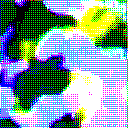

Batch 256 from 256 to 320
Gen loss: 1.7754607
Disc loss: 0.40023777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


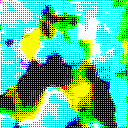

Batch 320 from 320 to 384
Gen loss: 1.7767465
Disc loss: 0.39688998
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


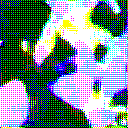

Batch 384 from 384 to 448
Gen loss: 1.7320582
Disc loss: 0.3961609
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


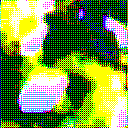

Batch 448 from 448 to 512
Gen loss: 1.7125418
Disc loss: 0.4799922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


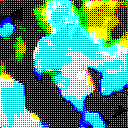

Batch 512 from 512 to 576
Gen loss: 1.7424257
Disc loss: 0.39802265
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


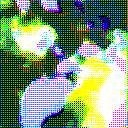

Batch 576 from 576 to 640
Gen loss: 1.684352
Disc loss: 0.44098383
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


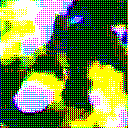


Epoch: 103
Batch 0 from 0 to 64
Gen loss: 1.7971051
Disc loss: 0.3998694
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


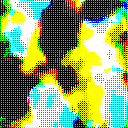

Batch 64 from 64 to 128
Gen loss: 1.787442
Disc loss: 0.41541088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


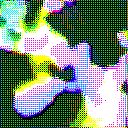

Batch 128 from 128 to 192
Gen loss: 1.6634724
Disc loss: 0.42596287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


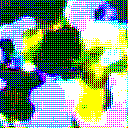

Batch 192 from 192 to 256
Gen loss: 1.7366999
Disc loss: 0.44633934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


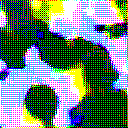

Batch 256 from 256 to 320
Gen loss: 1.7093748
Disc loss: 0.42297772
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


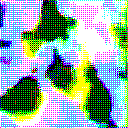

Batch 320 from 320 to 384
Gen loss: 1.8150395
Disc loss: 0.38682052
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


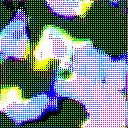

Batch 384 from 384 to 448
Gen loss: 1.6445942
Disc loss: 0.41720927
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


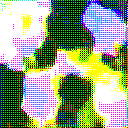

Batch 448 from 448 to 512
Gen loss: 1.7603189
Disc loss: 0.47206765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


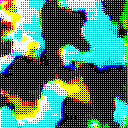

Batch 512 from 512 to 576
Gen loss: 1.7772908
Disc loss: 0.38731682
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


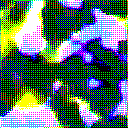

Batch 576 from 576 to 640
Gen loss: 1.6405457
Disc loss: 0.4599433
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


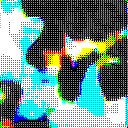


Epoch: 104
Batch 0 from 0 to 64
Gen loss: 1.9030246
Disc loss: 0.3840673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


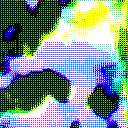

Batch 64 from 64 to 128
Gen loss: 1.7202696
Disc loss: 0.43474776
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


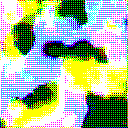

Batch 128 from 128 to 192
Gen loss: 1.7030948
Disc loss: 0.4107585
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


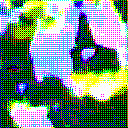

Batch 192 from 192 to 256
Gen loss: 1.9172194
Disc loss: 0.41670448
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


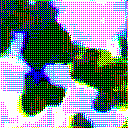

Batch 256 from 256 to 320
Gen loss: 1.6745868
Disc loss: 0.4271031
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


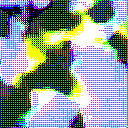

Batch 320 from 320 to 384
Gen loss: 1.7563252
Disc loss: 0.3954242
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


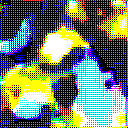

Batch 384 from 384 to 448
Gen loss: 1.8835225
Disc loss: 0.36323532
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


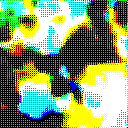

Batch 448 from 448 to 512
Gen loss: 1.6334645
Disc loss: 0.5045557
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


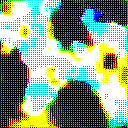

Batch 512 from 512 to 576
Gen loss: 1.6698828
Disc loss: 0.42147994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


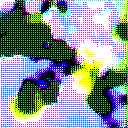

Batch 576 from 576 to 640
Gen loss: 1.5352074
Disc loss: 0.48953146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


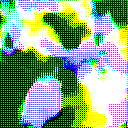


Epoch: 105
Batch 0 from 0 to 64
Gen loss: 1.8230009
Disc loss: 0.39648536
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


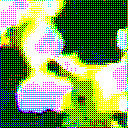

Batch 64 from 64 to 128
Gen loss: 1.8044001
Disc loss: 0.4032941
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


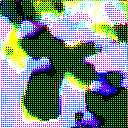

Batch 128 from 128 to 192
Gen loss: 1.8163378
Disc loss: 0.38216692
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


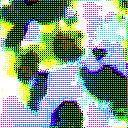

Batch 192 from 192 to 256
Gen loss: 1.8000271
Disc loss: 0.43974975
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


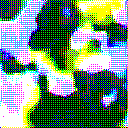

Batch 256 from 256 to 320
Gen loss: 1.7172571
Disc loss: 0.4211448
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


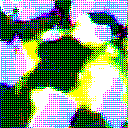

Batch 320 from 320 to 384
Gen loss: 1.655343
Disc loss: 0.4202708
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


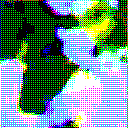

Batch 384 from 384 to 448
Gen loss: 1.7872232
Disc loss: 0.38065046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


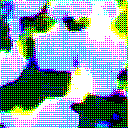

Batch 448 from 448 to 512
Gen loss: 1.8466821
Disc loss: 0.44786793
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


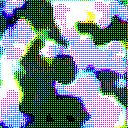

Batch 512 from 512 to 576
Gen loss: 1.7229245
Disc loss: 0.39340752
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


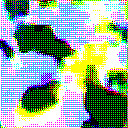

Batch 576 from 576 to 640
Gen loss: 1.6548235
Disc loss: 0.4368354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


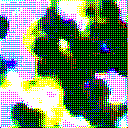


Epoch: 106
Batch 0 from 0 to 64
Gen loss: 1.7637091
Disc loss: 0.40951076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


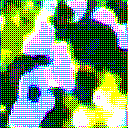

Batch 64 from 64 to 128
Gen loss: 1.762907
Disc loss: 0.41850424
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


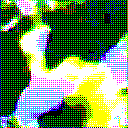

Batch 128 from 128 to 192
Gen loss: 1.7920005
Disc loss: 0.38150376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


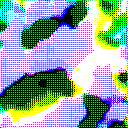

Batch 192 from 192 to 256
Gen loss: 1.7495186
Disc loss: 0.43278113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


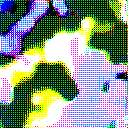

Batch 256 from 256 to 320
Gen loss: 1.6439378
Disc loss: 0.43222713
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


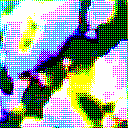

Batch 320 from 320 to 384
Gen loss: 1.735164
Disc loss: 0.39784247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


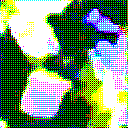

Batch 384 from 384 to 448
Gen loss: 1.8609704
Disc loss: 0.3613109
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


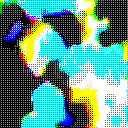

Batch 448 from 448 to 512
Gen loss: 1.8050137
Disc loss: 0.4583038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


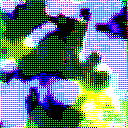

Batch 512 from 512 to 576
Gen loss: 1.9109792
Disc loss: 0.35475388
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


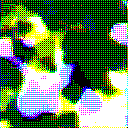

Batch 576 from 576 to 640
Gen loss: 1.6910889
Disc loss: 0.43362898
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


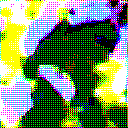


Epoch: 107
Batch 0 from 0 to 64
Gen loss: 1.8834853
Disc loss: 0.38657865
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


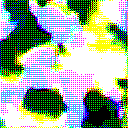

Batch 64 from 64 to 128
Gen loss: 1.6860301
Disc loss: 0.43929452
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


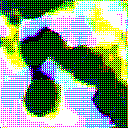

Batch 128 from 128 to 192
Gen loss: 1.739677
Disc loss: 0.39696646
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


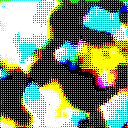

Batch 192 from 192 to 256
Gen loss: 1.8689674
Disc loss: 0.40585232
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


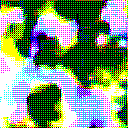

Batch 256 from 256 to 320
Gen loss: 1.7076277
Disc loss: 0.41534454
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


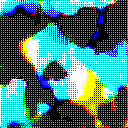

Batch 320 from 320 to 384
Gen loss: 1.7482421
Disc loss: 0.3952775
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


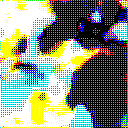

Batch 384 from 384 to 448
Gen loss: 1.8229564
Disc loss: 0.36700332
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


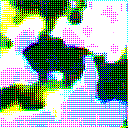

Batch 448 from 448 to 512
Gen loss: 1.7694664
Disc loss: 0.4612011
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


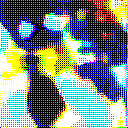

Batch 512 from 512 to 576
Gen loss: 1.7161164
Disc loss: 0.4059658
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


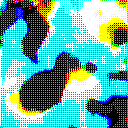

Batch 576 from 576 to 640
Gen loss: 1.6558038
Disc loss: 0.4393553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


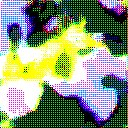


Epoch: 108
Batch 0 from 0 to 64
Gen loss: 1.7986414
Disc loss: 0.39625216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


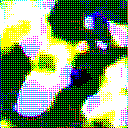

Batch 64 from 64 to 128
Gen loss: 1.9410715
Disc loss: 0.3724686
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


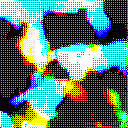

Batch 128 from 128 to 192
Gen loss: 1.6946697
Disc loss: 0.41117612
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


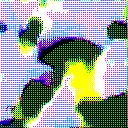

Batch 192 from 192 to 256
Gen loss: 1.7394805
Disc loss: 0.4310388
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


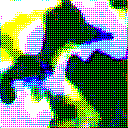

Batch 256 from 256 to 320
Gen loss: 1.8268178
Disc loss: 0.3918922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


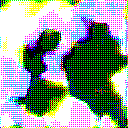

Batch 320 from 320 to 384
Gen loss: 1.8070576
Disc loss: 0.37899715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


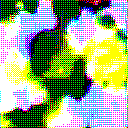

Batch 384 from 384 to 448
Gen loss: 1.7274798
Disc loss: 0.394611
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


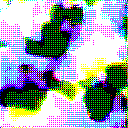

Batch 448 from 448 to 512
Gen loss: 1.8318747
Disc loss: 0.45012087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


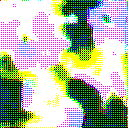

Batch 512 from 512 to 576
Gen loss: 1.739887
Disc loss: 0.38943607
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


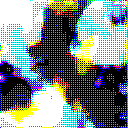

Batch 576 from 576 to 640
Gen loss: 1.8591263
Disc loss: 0.4084056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


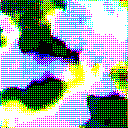


Epoch: 109
Batch 0 from 0 to 64
Gen loss: 1.7768719
Disc loss: 0.39914453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


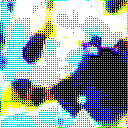

Batch 64 from 64 to 128
Gen loss: 1.8296833
Disc loss: 0.39792544
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


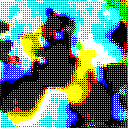

Batch 128 from 128 to 192
Gen loss: 1.9185665
Disc loss: 0.36109048
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


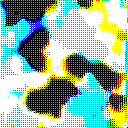

Batch 192 from 192 to 256
Gen loss: 1.9099463
Disc loss: 0.39901096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


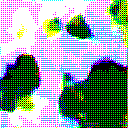

Batch 256 from 256 to 320
Gen loss: 1.794332
Disc loss: 0.39483315
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


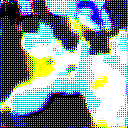

Batch 320 from 320 to 384
Gen loss: 1.7667568
Disc loss: 0.39254913
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


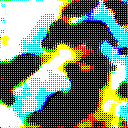

Batch 384 from 384 to 448
Gen loss: 1.8732744
Disc loss: 0.35367787
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


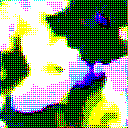

Batch 448 from 448 to 512
Gen loss: 1.7336239
Disc loss: 0.471921
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


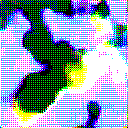

Batch 512 from 512 to 576
Gen loss: 1.7315432
Disc loss: 0.3909859
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


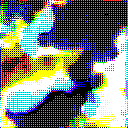

Batch 576 from 576 to 640
Gen loss: 1.7865555
Disc loss: 0.43216154
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


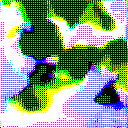


Epoch: 110
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.6348281
Disc loss: 0.4407637
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


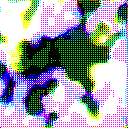

Batch 64 from 64 to 128
Gen loss: 1.7577847
Disc loss: 0.4254517
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


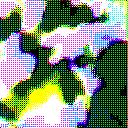

Batch 128 from 128 to 192
Gen loss: 1.8691874
Disc loss: 0.36312294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


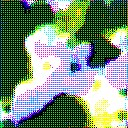

Batch 192 from 192 to 256
Gen loss: 1.8544012
Disc loss: 0.40779907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


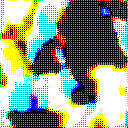

Batch 256 from 256 to 320
Gen loss: 1.8492911
Disc loss: 0.37888455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


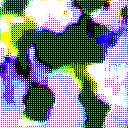

Batch 320 from 320 to 384
Gen loss: 1.7809871
Disc loss: 0.38362157
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


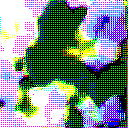

Batch 384 from 384 to 448
Gen loss: 1.792693
Disc loss: 0.3748777
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


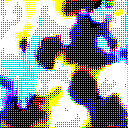

Batch 448 from 448 to 512
Gen loss: 1.750353
Disc loss: 0.46577996
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


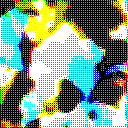

Batch 512 from 512 to 576
Gen loss: 1.8469088
Disc loss: 0.36329946
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


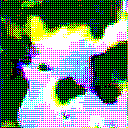

Batch 576 from 576 to 640
Gen loss: 1.7611811
Disc loss: 0.4288964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


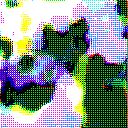


Epoch: 111
Batch 0 from 0 to 64
Gen loss: 1.7390828
Disc loss: 0.41908967
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


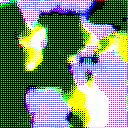

Batch 64 from 64 to 128
Gen loss: 1.9257569
Disc loss: 0.3831933
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


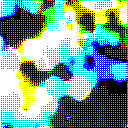

Batch 128 from 128 to 192
Gen loss: 1.7224374
Disc loss: 0.4036387
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


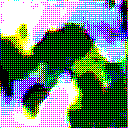

Batch 192 from 192 to 256
Gen loss: 1.7782848
Disc loss: 0.42080754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


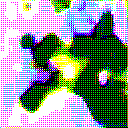

Batch 256 from 256 to 320
Gen loss: 1.7323766
Disc loss: 0.41736037
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


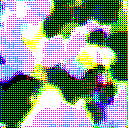

Batch 320 from 320 to 384
Gen loss: 1.7536628
Disc loss: 0.3988558
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


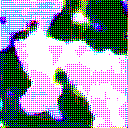

Batch 384 from 384 to 448
Gen loss: 1.9481442
Disc loss: 0.3445965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


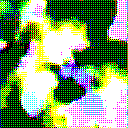

Batch 448 from 448 to 512
Gen loss: 1.7462552
Disc loss: 0.47151035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


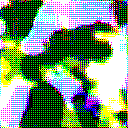

Batch 512 from 512 to 576
Gen loss: 1.6987727
Disc loss: 0.40407953
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


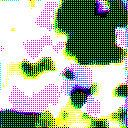

Batch 576 from 576 to 640
Gen loss: 1.7715659
Disc loss: 0.4350044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


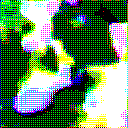


Epoch: 112
Batch 0 from 0 to 64
Gen loss: 1.7415187
Disc loss: 0.41716504
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


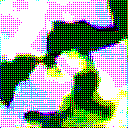

Batch 64 from 64 to 128
Gen loss: 1.865401
Disc loss: 0.3926674
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


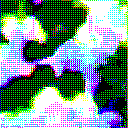

Batch 128 from 128 to 192
Gen loss: 1.849088
Disc loss: 0.36829194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


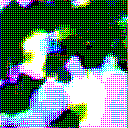

Batch 192 from 192 to 256
Gen loss: 1.7336977
Disc loss: 0.43492535
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


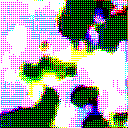

Batch 256 from 256 to 320
Gen loss: 1.7634398
Disc loss: 0.40039492
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


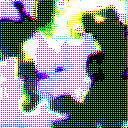

Batch 320 from 320 to 384
Gen loss: 1.7404115
Disc loss: 0.3936933
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


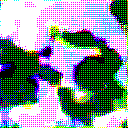

Batch 384 from 384 to 448
Gen loss: 1.8727424
Disc loss: 0.3585828
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


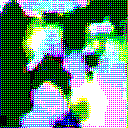

Batch 448 from 448 to 512
Gen loss: 1.9381872
Disc loss: 0.42710388
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


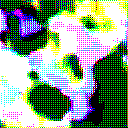

Batch 512 from 512 to 576
Gen loss: 1.8563495
Disc loss: 0.3615063
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


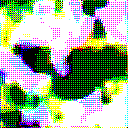

Batch 576 from 576 to 640
Gen loss: 1.6159632
Disc loss: 0.47043395
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


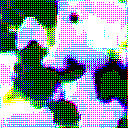


Epoch: 113
Batch 0 from 0 to 64
Gen loss: 1.7784379
Disc loss: 0.3965171
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


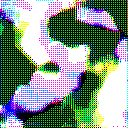

Batch 64 from 64 to 128
Gen loss: 1.8462975
Disc loss: 0.40004575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


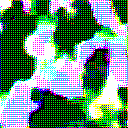

Batch 128 from 128 to 192
Gen loss: 1.792511
Disc loss: 0.37784293
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


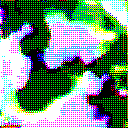

Batch 192 from 192 to 256
Gen loss: 1.8256648
Disc loss: 0.41308427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


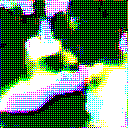

Batch 256 from 256 to 320
Gen loss: 1.6727941
Disc loss: 0.42741042
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


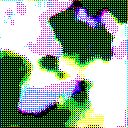

Batch 320 from 320 to 384
Gen loss: 1.7262721
Disc loss: 0.40396273
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


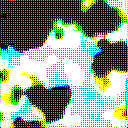

Batch 384 from 384 to 448
Gen loss: 1.6787553
Disc loss: 0.40380567
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


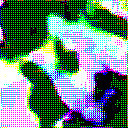

Batch 448 from 448 to 512
Gen loss: 1.8519726
Disc loss: 0.44818127
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


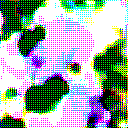

Batch 512 from 512 to 576
Gen loss: 1.763712
Disc loss: 0.38497746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


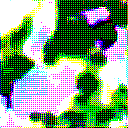

Batch 576 from 576 to 640
Gen loss: 1.8294839
Disc loss: 0.40908945
Disc fake accuracy: 1.0
Disc real accuracy: 0.974359


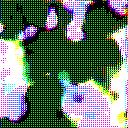


Epoch: 114
Batch 0 from 0 to 64
Gen loss: 1.8403165
Disc loss: 0.38553607
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


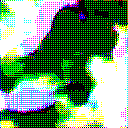

Batch 64 from 64 to 128
Gen loss: 1.8364937
Disc loss: 0.39860803
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


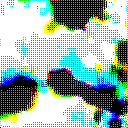

Batch 128 from 128 to 192
Gen loss: 1.6759156
Disc loss: 0.39960495
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


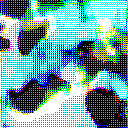

Batch 192 from 192 to 256
Gen loss: 1.652202
Disc loss: 0.4546229
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


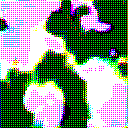

Batch 256 from 256 to 320
Gen loss: 1.7417716
Disc loss: 0.39600897
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


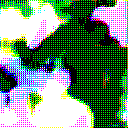

Batch 320 from 320 to 384
Gen loss: 1.8895521
Disc loss: 0.35795325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


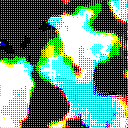

Batch 384 from 384 to 448
Gen loss: 1.9416747
Disc loss: 0.34143943
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


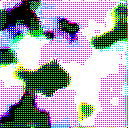

Batch 448 from 448 to 512
Gen loss: 1.864386
Disc loss: 0.4394562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


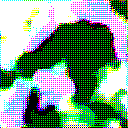

Batch 512 from 512 to 576
Gen loss: 1.8714576
Disc loss: 0.35960364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


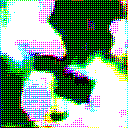

Batch 576 from 576 to 640
Gen loss: 1.819602
Disc loss: 0.39500064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


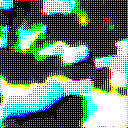


Epoch: 115
Batch 0 from 0 to 64
Gen loss: 1.931726
Disc loss: 0.36352852
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


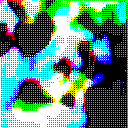

Batch 64 from 64 to 128
Gen loss: 1.8189044
Disc loss: 0.39631194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


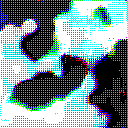

Batch 128 from 128 to 192
Gen loss: 1.863236
Disc loss: 0.35869175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


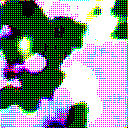

Batch 192 from 192 to 256
Gen loss: 1.8853747
Disc loss: 0.39041144
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


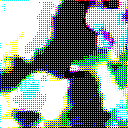

Batch 256 from 256 to 320
Gen loss: 1.8066664
Disc loss: 0.375948
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


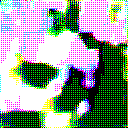

Batch 320 from 320 to 384
Gen loss: 1.968188
Disc loss: 0.3370111
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


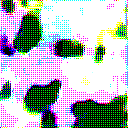

Batch 384 from 384 to 448
Gen loss: 1.837147
Disc loss: 0.35298476
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


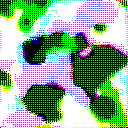

Batch 448 from 448 to 512
Gen loss: 1.7252475
Disc loss: 0.46380135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


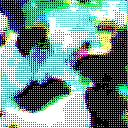

Batch 512 from 512 to 576
Gen loss: 1.9053906
Disc loss: 0.3476104
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


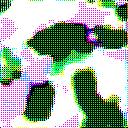

Batch 576 from 576 to 640
Gen loss: 1.746379
Disc loss: 0.4258082
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


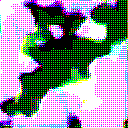


Epoch: 116
Batch 0 from 0 to 64
Gen loss: 1.8125072
Disc loss: 0.3812114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


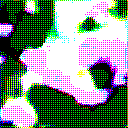

Batch 64 from 64 to 128
Gen loss: 1.7737328
Disc loss: 0.39601505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


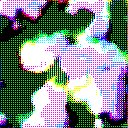

Batch 128 from 128 to 192
Gen loss: 1.802468
Disc loss: 0.37131417
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


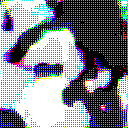

Batch 192 from 192 to 256
Gen loss: 1.8567877
Disc loss: 0.39977434
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


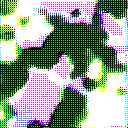

Batch 256 from 256 to 320
Gen loss: 1.9472176
Disc loss: 0.34998715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


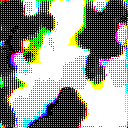

Batch 320 from 320 to 384
Gen loss: 1.8353677
Disc loss: 0.37513784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


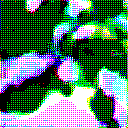

Batch 384 from 384 to 448
Gen loss: 1.8129344
Disc loss: 0.35914657
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


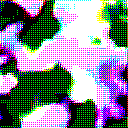

Batch 448 from 448 to 512
Gen loss: 1.8046706
Disc loss: 0.45753643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


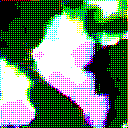

Batch 512 from 512 to 576
Gen loss: 1.8127077
Disc loss: 0.368691
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


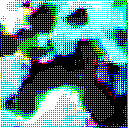

Batch 576 from 576 to 640
Gen loss: 1.6421399
Disc loss: 0.42837688
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


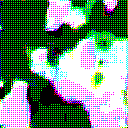


Epoch: 117
Batch 0 from 0 to 64
Gen loss: 1.8475304
Disc loss: 0.37591493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


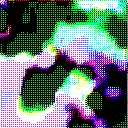

Batch 64 from 64 to 128
Gen loss: 1.7969066
Disc loss: 0.40017283
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


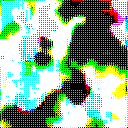

Batch 128 from 128 to 192
Gen loss: 1.7456306
Disc loss: 0.3814827
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


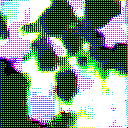

Batch 192 from 192 to 256
Gen loss: 1.8798213
Disc loss: 0.3913985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


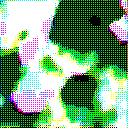

Batch 256 from 256 to 320
Gen loss: 1.8970001
Disc loss: 0.36175743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


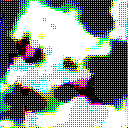

Batch 320 from 320 to 384
Gen loss: 1.7706321
Disc loss: 0.369634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


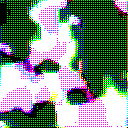

Batch 384 from 384 to 448
Gen loss: 1.8192611
Disc loss: 0.35515478
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


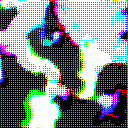

Batch 448 from 448 to 512
Gen loss: 1.7108433
Disc loss: 0.46142203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


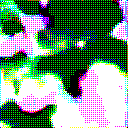

Batch 512 from 512 to 576
Gen loss: 1.8614118
Disc loss: 0.3488823
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


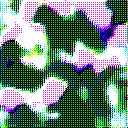

Batch 576 from 576 to 640
Gen loss: 1.7077179
Disc loss: 0.40969515
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


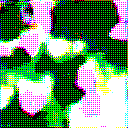


Epoch: 118
Batch 0 from 0 to 64
Gen loss: 1.9177427
Disc loss: 0.35406834
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


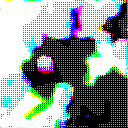

Batch 64 from 64 to 128
Gen loss: 1.776743
Disc loss: 0.38878626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


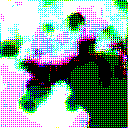

Batch 128 from 128 to 192
Gen loss: 1.9327152
Disc loss: 0.33767337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


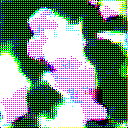

Batch 192 from 192 to 256
Gen loss: 1.9846512
Disc loss: 0.37339377
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


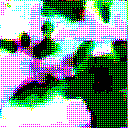

Batch 256 from 256 to 320
Gen loss: 1.8873688
Disc loss: 0.35795885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


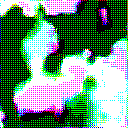

Batch 320 from 320 to 384
Gen loss: 1.9660423
Disc loss: 0.33326858
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


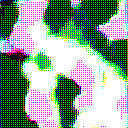

Batch 384 from 384 to 448
Gen loss: 1.8478963
Disc loss: 0.3480181
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


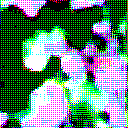

Batch 448 from 448 to 512
Gen loss: 1.7922039
Disc loss: 0.43865132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


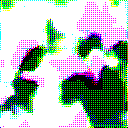

Batch 512 from 512 to 576
Gen loss: 1.9301265
Disc loss: 0.33243474
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


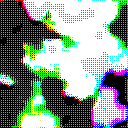

Batch 576 from 576 to 640
Gen loss: 1.8430676
Disc loss: 0.3752175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


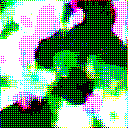


Epoch: 119
Batch 0 from 0 to 64
Gen loss: 2.02695
Disc loss: 0.34028736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


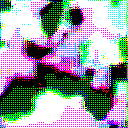

Batch 64 from 64 to 128
Gen loss: 1.8774471
Disc loss: 0.37524182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


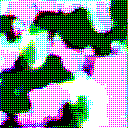

Batch 128 from 128 to 192
Gen loss: 1.7326014
Disc loss: 0.3807559
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


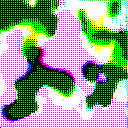

Batch 192 from 192 to 256
Gen loss: 1.9236991
Disc loss: 0.37914476
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


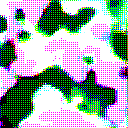

Batch 256 from 256 to 320
Gen loss: 1.9484406
Disc loss: 0.34996065
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


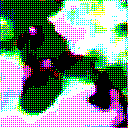

Batch 320 from 320 to 384
Gen loss: 2.0530376
Disc loss: 0.32183006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


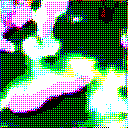

Batch 384 from 384 to 448
Gen loss: 1.8501334
Disc loss: 0.34982574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


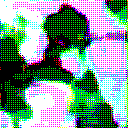

Batch 448 from 448 to 512
Gen loss: 1.8675128
Disc loss: 0.43044654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


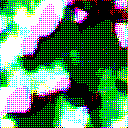

Batch 512 from 512 to 576
Gen loss: 1.9664912
Disc loss: 0.33051866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


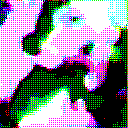

Batch 576 from 576 to 640
Gen loss: 1.9215753
Disc loss: 0.3651235
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


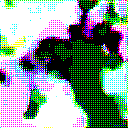


Epoch: 120
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.9320782
Disc loss: 0.3598292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


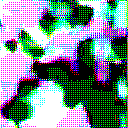

Batch 64 from 64 to 128
Gen loss: 1.7969216
Disc loss: 0.3955057
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


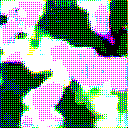

Batch 128 from 128 to 192
Gen loss: 1.8991687
Disc loss: 0.34084237
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


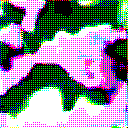

Batch 192 from 192 to 256
Gen loss: 1.8225224
Disc loss: 0.3968572
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


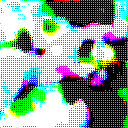

Batch 256 from 256 to 320
Gen loss: 1.9551723
Disc loss: 0.34625643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


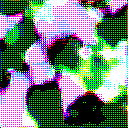

Batch 320 from 320 to 384
Gen loss: 1.8967798
Disc loss: 0.34621894
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


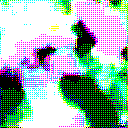

Batch 384 from 384 to 448
Gen loss: 1.8673657
Disc loss: 0.3433516
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


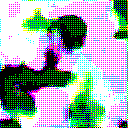

Batch 448 from 448 to 512
Gen loss: 1.7953349
Disc loss: 0.45143497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


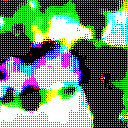

Batch 512 from 512 to 576
Gen loss: 1.87046
Disc loss: 0.34603697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


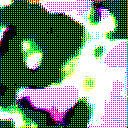

Batch 576 from 576 to 640
Gen loss: 1.7079892
Disc loss: 0.41091317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


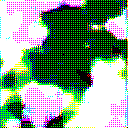


Epoch: 121
Batch 0 from 0 to 64
Gen loss: 1.8179933
Disc loss: 0.39128768
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


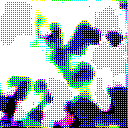

Batch 64 from 64 to 128
Gen loss: 2.0270476
Disc loss: 0.3465931
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


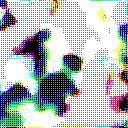

Batch 128 from 128 to 192
Gen loss: 1.9977025
Disc loss: 0.3265356
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


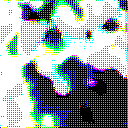

Batch 192 from 192 to 256
Gen loss: 2.0294232
Disc loss: 0.36290222
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


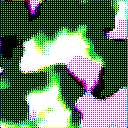

Batch 256 from 256 to 320
Gen loss: 1.9918149
Disc loss: 0.33500922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


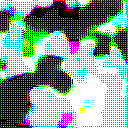

Batch 320 from 320 to 384
Gen loss: 1.8074565
Disc loss: 0.36412168
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


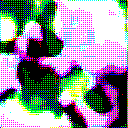

Batch 384 from 384 to 448
Gen loss: 1.8778003
Disc loss: 0.33665654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


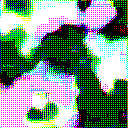

Batch 448 from 448 to 512
Gen loss: 1.9259007
Disc loss: 0.419451
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


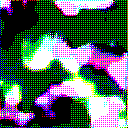

Batch 512 from 512 to 576
Gen loss: 1.9766471
Disc loss: 0.3230638
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


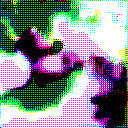

Batch 576 from 576 to 640
Gen loss: 1.769938
Disc loss: 0.40095106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


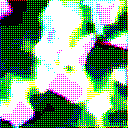


Epoch: 122
Batch 0 from 0 to 64
Gen loss: 1.972942
Disc loss: 0.3433652
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


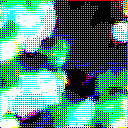

Batch 64 from 64 to 128
Gen loss: 1.8944557
Disc loss: 0.3682612
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


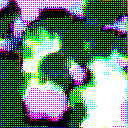

Batch 128 from 128 to 192
Gen loss: 1.9341412
Disc loss: 0.33231574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


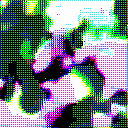

Batch 192 from 192 to 256
Gen loss: 1.9500356
Disc loss: 0.37755668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


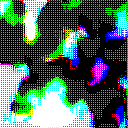

Batch 256 from 256 to 320
Gen loss: 1.9609938
Disc loss: 0.3401165
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


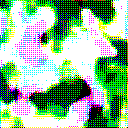

Batch 320 from 320 to 384
Gen loss: 1.916127
Disc loss: 0.33479264
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


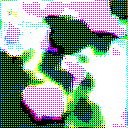

Batch 384 from 384 to 448
Gen loss: 2.0146055
Disc loss: 0.31431895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


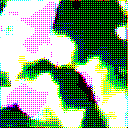

Batch 448 from 448 to 512
Gen loss: 1.9784416
Disc loss: 0.40840915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


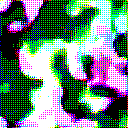

Batch 512 from 512 to 576
Gen loss: 2.0386662
Disc loss: 0.32007855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


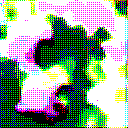

Batch 576 from 576 to 640
Gen loss: 1.9897821
Disc loss: 0.3520806
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


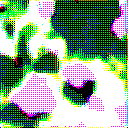


Epoch: 123
Batch 0 from 0 to 64
Gen loss: 1.9580035
Disc loss: 0.37455368
Disc fake accuracy: 1.0
Disc real accuracy: 0.953125


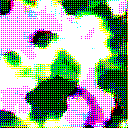

Batch 64 from 64 to 128
Gen loss: 1.9199172
Disc loss: 0.35569644
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


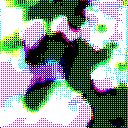

Batch 128 from 128 to 192
Gen loss: 1.7831944
Disc loss: 0.37252033
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


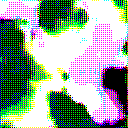

Batch 192 from 192 to 256
Gen loss: 1.9030147
Disc loss: 0.3759858
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


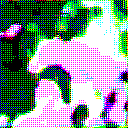

Batch 256 from 256 to 320
Gen loss: 1.8163596
Disc loss: 0.37089068
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


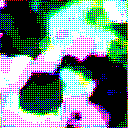

Batch 320 from 320 to 384
Gen loss: 2.007028
Disc loss: 0.32204583
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


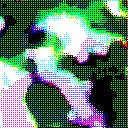

Batch 384 from 384 to 448
Gen loss: 1.9039798
Disc loss: 0.34174347
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


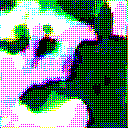

Batch 448 from 448 to 512
Gen loss: 2.038448
Disc loss: 0.41321903
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


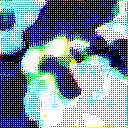

Batch 512 from 512 to 576
Gen loss: 2.0577798
Disc loss: 0.31356364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


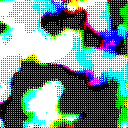

Batch 576 from 576 to 640
Gen loss: 1.883053
Disc loss: 0.36131322
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


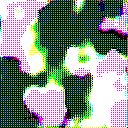


Epoch: 124
Batch 0 from 0 to 64
Gen loss: 1.908685
Disc loss: 0.35965782
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


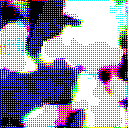

Batch 64 from 64 to 128
Gen loss: 1.940191
Disc loss: 0.35386994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


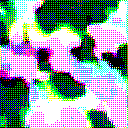

Batch 128 from 128 to 192
Gen loss: 1.9470252
Disc loss: 0.33226323
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


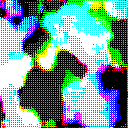

Batch 192 from 192 to 256
Gen loss: 1.8608484
Disc loss: 0.39576423
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


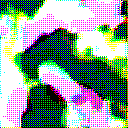

Batch 256 from 256 to 320
Gen loss: 1.8123423
Disc loss: 0.37657678
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


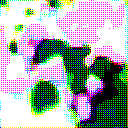

Batch 320 from 320 to 384
Gen loss: 1.9209416
Disc loss: 0.32963103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


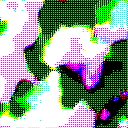

Batch 384 from 384 to 448
Gen loss: 1.8282969
Disc loss: 0.34397054
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


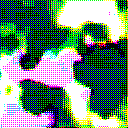

Batch 448 from 448 to 512
Gen loss: 1.9765376
Disc loss: 0.40100354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


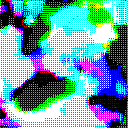

Batch 512 from 512 to 576
Gen loss: 1.8691604
Disc loss: 0.34261698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


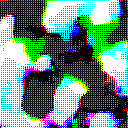

Batch 576 from 576 to 640
Gen loss: 1.920642
Disc loss: 0.35551667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


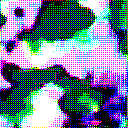


Epoch: 125
Batch 0 from 0 to 64
Gen loss: 1.8905683
Disc loss: 0.37076887
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


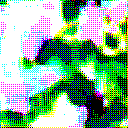

Batch 64 from 64 to 128
Gen loss: 1.9201764
Disc loss: 0.36099017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


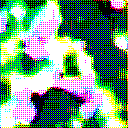

Batch 128 from 128 to 192
Gen loss: 1.8845232
Disc loss: 0.34527683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


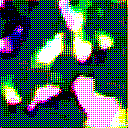

Batch 192 from 192 to 256
Gen loss: 1.937599
Disc loss: 0.3713938
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


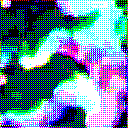

Batch 256 from 256 to 320
Gen loss: 2.006011
Disc loss: 0.33768564
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


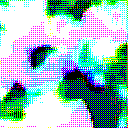

Batch 320 from 320 to 384
Gen loss: 1.9342597
Disc loss: 0.32988653
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


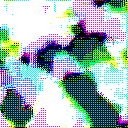

Batch 384 from 384 to 448
Gen loss: 1.8624477
Disc loss: 0.33400524
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


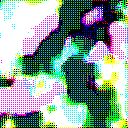

Batch 448 from 448 to 512
Gen loss: 1.8591971
Disc loss: 0.41893843
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


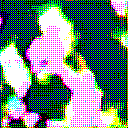

Batch 512 from 512 to 576
Gen loss: 1.9158212
Disc loss: 0.33317804
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


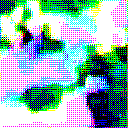

Batch 576 from 576 to 640
Gen loss: 1.9071009
Disc loss: 0.35646164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


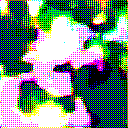


Epoch: 126
Batch 0 from 0 to 64
Gen loss: 1.969884
Disc loss: 0.34651533
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


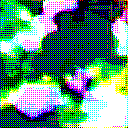

Batch 64 from 64 to 128
Gen loss: 1.8555413
Disc loss: 0.3684488
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


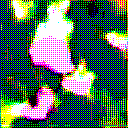

Batch 128 from 128 to 192
Gen loss: 1.8342524
Disc loss: 0.34632453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


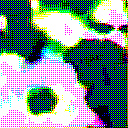

Batch 192 from 192 to 256
Gen loss: 1.8852782
Disc loss: 0.36845982
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


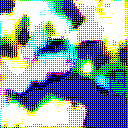

Batch 256 from 256 to 320
Gen loss: 1.9904305
Disc loss: 0.32849902
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


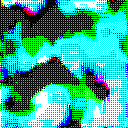

Batch 320 from 320 to 384
Gen loss: 2.0187612
Disc loss: 0.31380358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


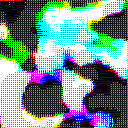

Batch 384 from 384 to 448
Gen loss: 1.8120298
Disc loss: 0.34893194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


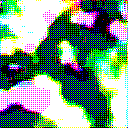

Batch 448 from 448 to 512
Gen loss: 1.9054623
Disc loss: 0.4054255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


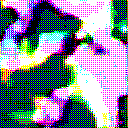

Batch 512 from 512 to 576
Gen loss: 1.9752064
Disc loss: 0.3121382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


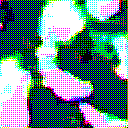

Batch 576 from 576 to 640
Gen loss: 1.9481901
Disc loss: 0.34519655
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


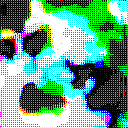


Epoch: 127
Batch 0 from 0 to 64
Gen loss: 1.7583251
Disc loss: 0.38360667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


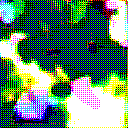

Batch 64 from 64 to 128
Gen loss: 1.9535893
Disc loss: 0.3474596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


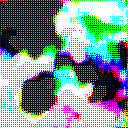

Batch 128 from 128 to 192
Gen loss: 1.9570037
Disc loss: 0.3162185
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


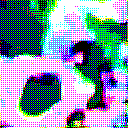

Batch 192 from 192 to 256
Gen loss: 1.8766558
Disc loss: 0.37163097
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


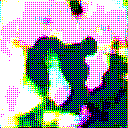

Batch 256 from 256 to 320
Gen loss: 1.8313513
Disc loss: 0.35572255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


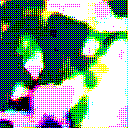

Batch 320 from 320 to 384
Gen loss: 1.8737833
Disc loss: 0.33498502
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


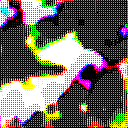

Batch 384 from 384 to 448
Gen loss: 1.8784841
Disc loss: 0.33360752
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


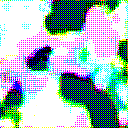

Batch 448 from 448 to 512
Gen loss: 1.9121274
Disc loss: 0.40301472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


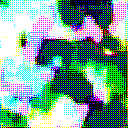

Batch 512 from 512 to 576
Gen loss: 1.8420427
Disc loss: 0.33369216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


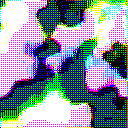

Batch 576 from 576 to 640
Gen loss: 1.8386015
Disc loss: 0.37493962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


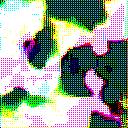


Epoch: 128
Batch 0 from 0 to 64
Gen loss: 1.957626
Disc loss: 0.3398161
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


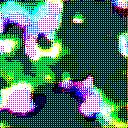

Batch 64 from 64 to 128
Gen loss: 1.8311992
Disc loss: 0.36980087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


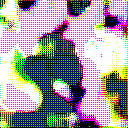

Batch 128 from 128 to 192
Gen loss: 1.949566
Disc loss: 0.31688234
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


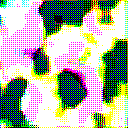

Batch 192 from 192 to 256
Gen loss: 2.0174785
Disc loss: 0.3476115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


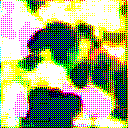

Batch 256 from 256 to 320
Gen loss: 1.9493593
Disc loss: 0.32991627
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


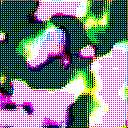

Batch 320 from 320 to 384
Gen loss: 2.0619817
Disc loss: 0.303524
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


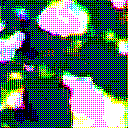

Batch 384 from 384 to 448
Gen loss: 2.0168204
Disc loss: 0.30239767
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


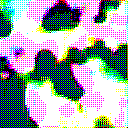

Batch 448 from 448 to 512
Gen loss: 1.9311824
Disc loss: 0.39736593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


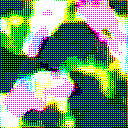

Batch 512 from 512 to 576
Gen loss: 2.0011613
Disc loss: 0.30621612
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


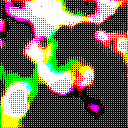

Batch 576 from 576 to 640
Gen loss: 2.049496
Disc loss: 0.3253958
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


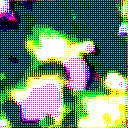


Epoch: 129
Batch 0 from 0 to 64
Gen loss: 1.9721241
Disc loss: 0.33261758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


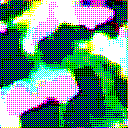

Batch 64 from 64 to 128
Gen loss: 1.911856
Disc loss: 0.3529035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


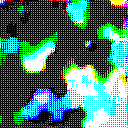

Batch 128 from 128 to 192
Gen loss: 1.9379033
Disc loss: 0.3148651
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


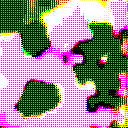

Batch 192 from 192 to 256
Gen loss: 1.9798886
Disc loss: 0.34887543
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


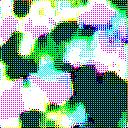

Batch 256 from 256 to 320
Gen loss: 2.0793338
Disc loss: 0.31174392
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


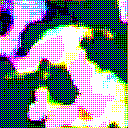

Batch 320 from 320 to 384
Gen loss: 2.028729
Disc loss: 0.3105471
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


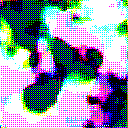

Batch 384 from 384 to 448
Gen loss: 2.085516
Disc loss: 0.288481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


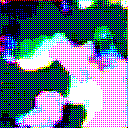

Batch 448 from 448 to 512
Gen loss: 1.7469091
Disc loss: 0.44617254
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


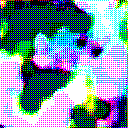

Batch 512 from 512 to 576
Gen loss: 1.956237
Disc loss: 0.3126159
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


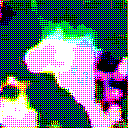

Batch 576 from 576 to 640
Gen loss: 1.7744972
Disc loss: 0.39698768
Disc fake accuracy: 0.94871795
Disc real accuracy: 1.0


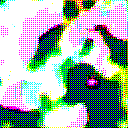


Epoch: 130
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 1.872752
Disc loss: 0.34668687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


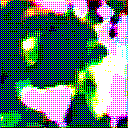

Batch 64 from 64 to 128
Gen loss: 2.028148
Disc loss: 0.32326493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


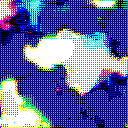

Batch 128 from 128 to 192
Gen loss: 1.8886569
Disc loss: 0.32471013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


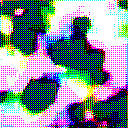

Batch 192 from 192 to 256
Gen loss: 1.9161687
Disc loss: 0.3686852
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


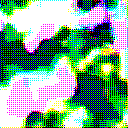

Batch 256 from 256 to 320
Gen loss: 1.9665924
Disc loss: 0.3284384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


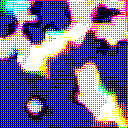

Batch 320 from 320 to 384
Gen loss: 1.8275025
Disc loss: 0.33876306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


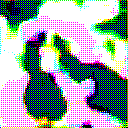

Batch 384 from 384 to 448
Gen loss: 1.9330492
Disc loss: 0.3137079
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


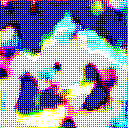

Batch 448 from 448 to 512
Gen loss: 1.9572414
Disc loss: 0.3901704
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


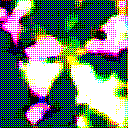

Batch 512 from 512 to 576
Gen loss: 1.8507546
Disc loss: 0.34233937
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


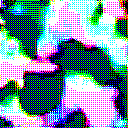

Batch 576 from 576 to 640
Gen loss: 1.7929194
Disc loss: 0.39932948
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


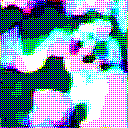


Epoch: 131
Batch 0 from 0 to 64
Gen loss: 1.9635233
Disc loss: 0.33327013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


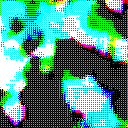

Batch 64 from 64 to 128
Gen loss: 1.900395
Disc loss: 0.35386103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


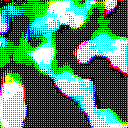

Batch 128 from 128 to 192
Gen loss: 1.9251635
Disc loss: 0.32008737
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


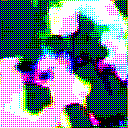

Batch 192 from 192 to 256
Gen loss: 1.864857
Disc loss: 0.3749823
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


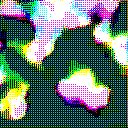

Batch 256 from 256 to 320
Gen loss: 1.9624772
Disc loss: 0.32817596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


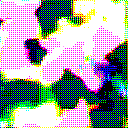

Batch 320 from 320 to 384
Gen loss: 1.9139991
Disc loss: 0.33133292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


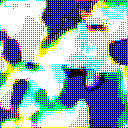

Batch 384 from 384 to 448
Gen loss: 1.9861734
Disc loss: 0.30257976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


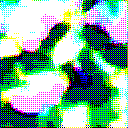

Batch 448 from 448 to 512
Gen loss: 2.0985558
Disc loss: 0.3700833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


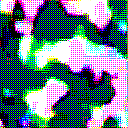

Batch 512 from 512 to 576
Gen loss: 1.9917636
Disc loss: 0.30995315
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


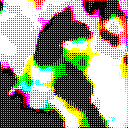

Batch 576 from 576 to 640
Gen loss: 1.9179136
Disc loss: 0.3545448
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


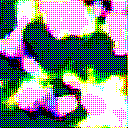


Epoch: 132
Batch 0 from 0 to 64
Gen loss: 1.926682
Disc loss: 0.34391597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


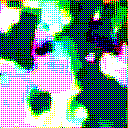

Batch 64 from 64 to 128
Gen loss: 1.9984654
Disc loss: 0.33590978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


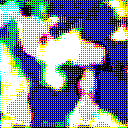

Batch 128 from 128 to 192
Gen loss: 2.0902092
Disc loss: 0.2943132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


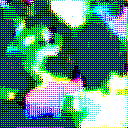

Batch 192 from 192 to 256
Gen loss: 2.1202312
Disc loss: 0.32903916
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


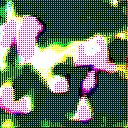

Batch 256 from 256 to 320
Gen loss: 2.0390828
Disc loss: 0.31958175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


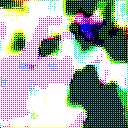

Batch 320 from 320 to 384
Gen loss: 2.0122707
Disc loss: 0.3140815
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


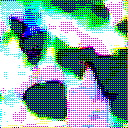

Batch 384 from 384 to 448
Gen loss: 2.0599718
Disc loss: 0.29321074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


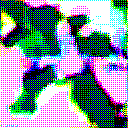

Batch 448 from 448 to 512
Gen loss: 2.1867728
Disc loss: 0.35986134
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


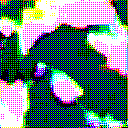

Batch 512 from 512 to 576
Gen loss: 1.9216743
Disc loss: 0.32140702
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


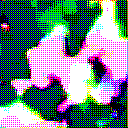

Batch 576 from 576 to 640
Gen loss: 1.8453885
Disc loss: 0.35661164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


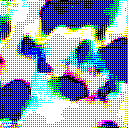


Epoch: 133
Batch 0 from 0 to 64
Gen loss: 2.0197592
Disc loss: 0.32302815
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


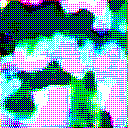

Batch 64 from 64 to 128
Gen loss: 2.150976
Disc loss: 0.30843925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


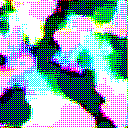

Batch 128 from 128 to 192
Gen loss: 1.930685
Disc loss: 0.32190043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


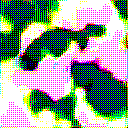

Batch 192 from 192 to 256
Gen loss: 2.0425193
Disc loss: 0.33827168
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


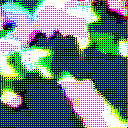

Batch 256 from 256 to 320
Gen loss: 2.0154872
Disc loss: 0.31679654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


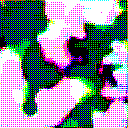

Batch 320 from 320 to 384
Gen loss: 1.9607852
Disc loss: 0.31134903
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


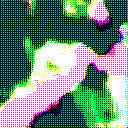

Batch 384 from 384 to 448
Gen loss: 2.0030222
Disc loss: 0.30118224
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


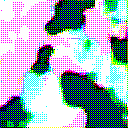

Batch 448 from 448 to 512
Gen loss: 1.9630847
Disc loss: 0.40071833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


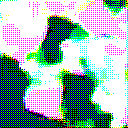

Batch 512 from 512 to 576
Gen loss: 1.9781237
Disc loss: 0.30563295
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


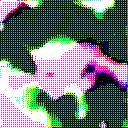

Batch 576 from 576 to 640
Gen loss: 2.016419
Disc loss: 0.3308556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


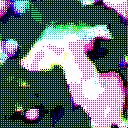


Epoch: 134
Batch 0 from 0 to 64
Gen loss: 1.946497
Disc loss: 0.3336921
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


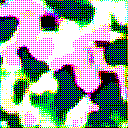

Batch 64 from 64 to 128
Gen loss: 1.8720993
Disc loss: 0.35342273
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


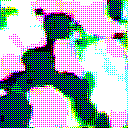

Batch 128 from 128 to 192
Gen loss: 2.0866601
Disc loss: 0.2941981
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


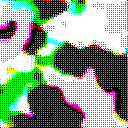

Batch 192 from 192 to 256
Gen loss: 2.1073112
Disc loss: 0.32368958
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


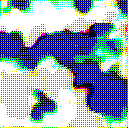

Batch 256 from 256 to 320
Gen loss: 2.028955
Disc loss: 0.3128779
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


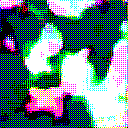

Batch 320 from 320 to 384
Gen loss: 1.9002936
Disc loss: 0.3228557
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


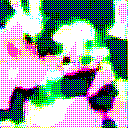

Batch 384 from 384 to 448
Gen loss: 2.0587826
Disc loss: 0.2899789
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


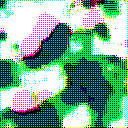

Batch 448 from 448 to 512
Gen loss: 2.0202127
Disc loss: 0.37410632
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


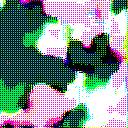

Batch 512 from 512 to 576
Gen loss: 2.1722617
Disc loss: 0.27967808
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


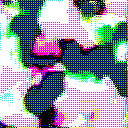

Batch 576 from 576 to 640
Gen loss: 2.1356618
Disc loss: 0.3184138
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


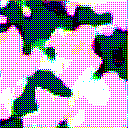


Epoch: 135
Batch 0 from 0 to 64
Gen loss: 1.9589236
Disc loss: 0.3462965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


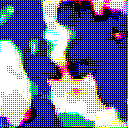

Batch 64 from 64 to 128
Gen loss: 1.8986712
Disc loss: 0.3552003
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


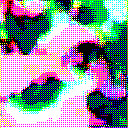

Batch 128 from 128 to 192
Gen loss: 1.9725459
Disc loss: 0.3096488
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


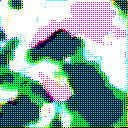

Batch 192 from 192 to 256
Gen loss: 2.0461893
Disc loss: 0.33199424
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


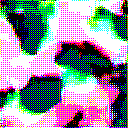

Batch 256 from 256 to 320
Gen loss: 2.1425703
Disc loss: 0.30215248
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


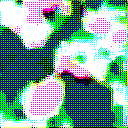

Batch 320 from 320 to 384
Gen loss: 2.006703
Disc loss: 0.31451237
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


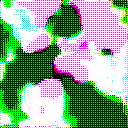

Batch 384 from 384 to 448
Gen loss: 2.1397898
Disc loss: 0.2914318
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


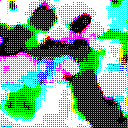

Batch 448 from 448 to 512
Gen loss: 1.9773202
Disc loss: 0.38692406
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


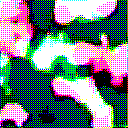

Batch 512 from 512 to 576
Gen loss: 2.0647838
Disc loss: 0.29148313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


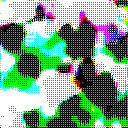

Batch 576 from 576 to 640
Gen loss: 2.0357795
Disc loss: 0.32824486
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


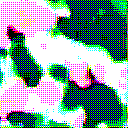


Epoch: 136
Batch 0 from 0 to 64
Gen loss: 1.9056499
Disc loss: 0.35599267
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


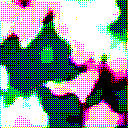

Batch 64 from 64 to 128
Gen loss: 1.9193782
Disc loss: 0.34935832
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


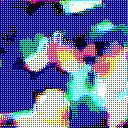

Batch 128 from 128 to 192
Gen loss: 2.0455842
Disc loss: 0.3056815
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


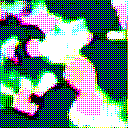

Batch 192 from 192 to 256
Gen loss: 2.0975857
Disc loss: 0.32499367
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


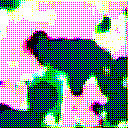

Batch 256 from 256 to 320
Gen loss: 2.135971
Disc loss: 0.29000574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


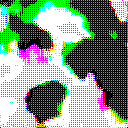

Batch 320 from 320 to 384
Gen loss: 2.011763
Disc loss: 0.3048271
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


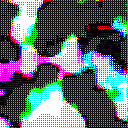

Batch 384 from 384 to 448
Gen loss: 1.9678835
Disc loss: 0.29993713
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


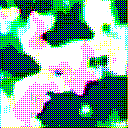

Batch 448 from 448 to 512
Gen loss: 2.042293
Disc loss: 0.38259298
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


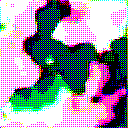

Batch 512 from 512 to 576
Gen loss: 2.1141062
Disc loss: 0.28035071
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


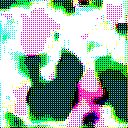

Batch 576 from 576 to 640
Gen loss: 1.9512644
Disc loss: 0.32912657
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


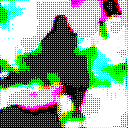


Epoch: 137
Batch 0 from 0 to 64
Gen loss: 2.071762
Disc loss: 0.30728906
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


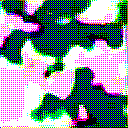

Batch 64 from 64 to 128
Gen loss: 2.1104333
Disc loss: 0.31437272
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


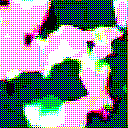

Batch 128 from 128 to 192
Gen loss: 2.0822964
Disc loss: 0.28827566
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


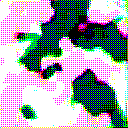

Batch 192 from 192 to 256
Gen loss: 2.1070387
Disc loss: 0.31924182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


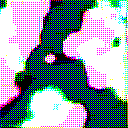

Batch 256 from 256 to 320
Gen loss: 2.1521673
Disc loss: 0.29245865
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


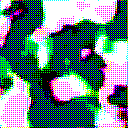

Batch 320 from 320 to 384
Gen loss: 2.0002875
Disc loss: 0.29753762
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


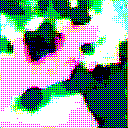

Batch 384 from 384 to 448
Gen loss: 2.114509
Disc loss: 0.27988464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


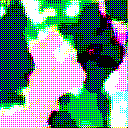

Batch 448 from 448 to 512
Gen loss: 1.8836541
Disc loss: 0.40137872
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


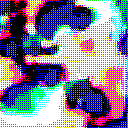

Batch 512 from 512 to 576
Gen loss: 2.0411694
Disc loss: 0.28867525
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


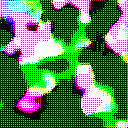

Batch 576 from 576 to 640
Gen loss: 1.936767
Disc loss: 0.34549746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


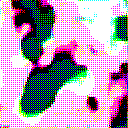


Epoch: 138
Batch 0 from 0 to 64
Gen loss: 2.1397743
Disc loss: 0.30002216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


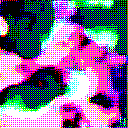

Batch 64 from 64 to 128
Gen loss: 2.0739868
Disc loss: 0.31058043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


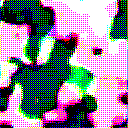

Batch 128 from 128 to 192
Gen loss: 1.9859092
Disc loss: 0.30653566
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


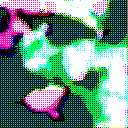

Batch 192 from 192 to 256
Gen loss: 2.0947208
Disc loss: 0.31882107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


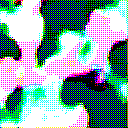

Batch 256 from 256 to 320
Gen loss: 2.0958362
Disc loss: 0.29512233
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


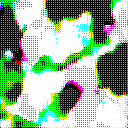

Batch 320 from 320 to 384
Gen loss: 2.2715964
Disc loss: 0.25947458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


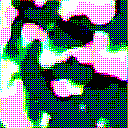

Batch 384 from 384 to 448
Gen loss: 2.2587671
Disc loss: 0.25681782
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


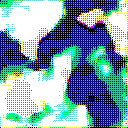

Batch 448 from 448 to 512
Gen loss: 2.1013975
Disc loss: 0.3606993
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


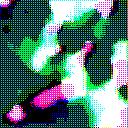

Batch 512 from 512 to 576
Gen loss: 2.2346892
Disc loss: 0.26383948
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


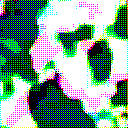

Batch 576 from 576 to 640
Gen loss: 2.141859
Disc loss: 0.29800802
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


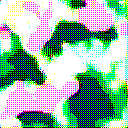


Epoch: 139
Batch 0 from 0 to 64
Gen loss: 2.1131325
Disc loss: 0.29674888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


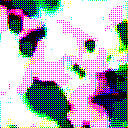

Batch 64 from 64 to 128
Gen loss: 2.0496259
Disc loss: 0.3135634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


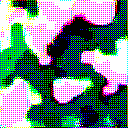

Batch 128 from 128 to 192
Gen loss: 2.1396525
Disc loss: 0.2743944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


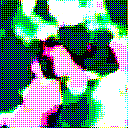

Batch 192 from 192 to 256
Gen loss: 2.0073533
Disc loss: 0.32633108
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


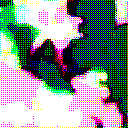

Batch 256 from 256 to 320
Gen loss: 2.2592397
Disc loss: 0.26747018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


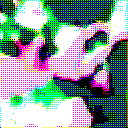

Batch 320 from 320 to 384
Gen loss: 2.2070165
Disc loss: 0.26454
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


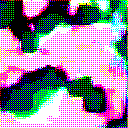

Batch 384 from 384 to 448
Gen loss: 1.9862077
Disc loss: 0.29253054
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


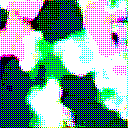

Batch 448 from 448 to 512
Gen loss: 2.1731932
Disc loss: 0.3403499
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


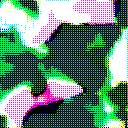

Batch 512 from 512 to 576
Gen loss: 2.1297772
Disc loss: 0.26845425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


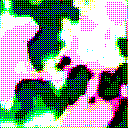

Batch 576 from 576 to 640
Gen loss: 2.061583
Disc loss: 0.3069481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


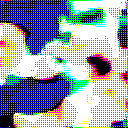


Epoch: 140
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.1069717
Disc loss: 0.29336655
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


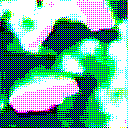

Batch 64 from 64 to 128
Gen loss: 2.1002998
Disc loss: 0.2998945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


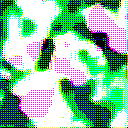

Batch 128 from 128 to 192
Gen loss: 2.105303
Disc loss: 0.28139025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


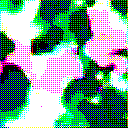

Batch 192 from 192 to 256
Gen loss: 2.0804224
Disc loss: 0.31051674
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


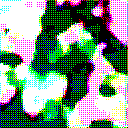

Batch 256 from 256 to 320
Gen loss: 2.1491182
Disc loss: 0.27335155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


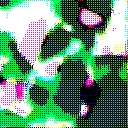

Batch 320 from 320 to 384
Gen loss: 1.9571254
Disc loss: 0.29832563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


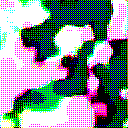

Batch 384 from 384 to 448
Gen loss: 2.1947417
Disc loss: 0.2545802
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


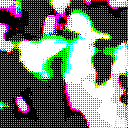

Batch 448 from 448 to 512
Gen loss: 2.244112
Disc loss: 0.3239274
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


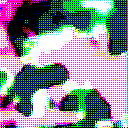

Batch 512 from 512 to 576
Gen loss: 2.136405
Disc loss: 0.27653062
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


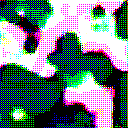

Batch 576 from 576 to 640
Gen loss: 1.9095886
Disc loss: 0.326821
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


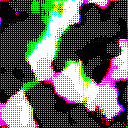


Epoch: 141
Batch 0 from 0 to 64
Gen loss: 1.9484305
Disc loss: 0.30830967
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


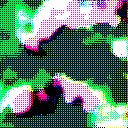

Batch 64 from 64 to 128
Gen loss: 2.0185742
Disc loss: 0.30251026
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


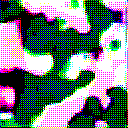

Batch 128 from 128 to 192
Gen loss: 2.1191916
Disc loss: 0.26872072
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


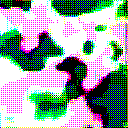

Batch 192 from 192 to 256
Gen loss: 2.1606417
Disc loss: 0.30006453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


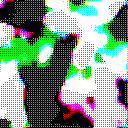

Batch 256 from 256 to 320
Gen loss: 2.106883
Disc loss: 0.280147
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


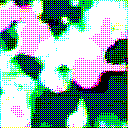

Batch 320 from 320 to 384
Gen loss: 2.065768
Disc loss: 0.27970123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


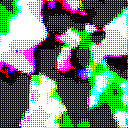

Batch 384 from 384 to 448
Gen loss: 2.03535
Disc loss: 0.27856982
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


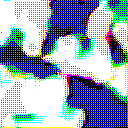

Batch 448 from 448 to 512
Gen loss: 2.1099756
Disc loss: 0.34409285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


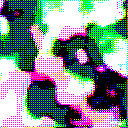

Batch 512 from 512 to 576
Gen loss: 2.0242825
Disc loss: 0.27740812
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


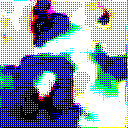

Batch 576 from 576 to 640
Gen loss: 1.7920011
Disc loss: 0.3447472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


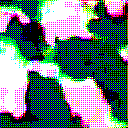


Epoch: 142
Batch 0 from 0 to 64
Gen loss: 2.1444438
Disc loss: 0.28201777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


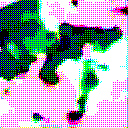

Batch 64 from 64 to 128
Gen loss: 2.0424545
Disc loss: 0.3034249
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


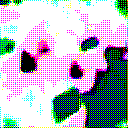

Batch 128 from 128 to 192
Gen loss: 2.0817318
Disc loss: 0.27488375
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


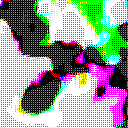

Batch 192 from 192 to 256
Gen loss: 1.9720502
Disc loss: 0.32610184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


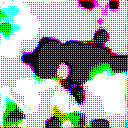

Batch 256 from 256 to 320
Gen loss: 2.2246335
Disc loss: 0.26864436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


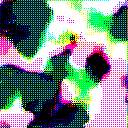

Batch 320 from 320 to 384
Gen loss: 1.8483365
Disc loss: 0.31503597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


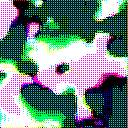

Batch 384 from 384 to 448
Gen loss: 2.1383114
Disc loss: 0.2585648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


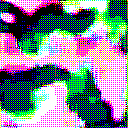

Batch 448 from 448 to 512
Gen loss: 2.2801218
Disc loss: 0.3171909
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


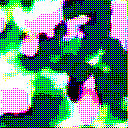

Batch 512 from 512 to 576
Gen loss: 2.175025
Disc loss: 0.25827426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


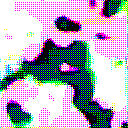

Batch 576 from 576 to 640
Gen loss: 2.1442626
Disc loss: 0.28244174
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


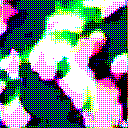


Epoch: 143
Batch 0 from 0 to 64
Gen loss: 2.0716896
Disc loss: 0.28656352
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


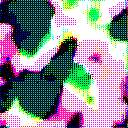

Batch 64 from 64 to 128
Gen loss: 2.0660596
Disc loss: 0.29747626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


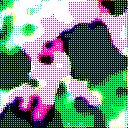

Batch 128 from 128 to 192
Gen loss: 2.046134
Disc loss: 0.28181997
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


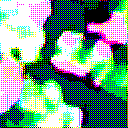

Batch 192 from 192 to 256
Gen loss: 2.1141791
Disc loss: 0.30522883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


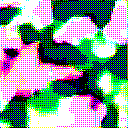

Batch 256 from 256 to 320
Gen loss: 2.1202538
Disc loss: 0.2773605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


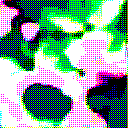

Batch 320 from 320 to 384
Gen loss: 2.1411462
Disc loss: 0.26468673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


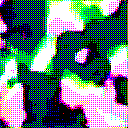

Batch 384 from 384 to 448
Gen loss: 2.155723
Disc loss: 0.25487474
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


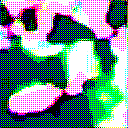

Batch 448 from 448 to 512
Gen loss: 2.0627413
Disc loss: 0.3468683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


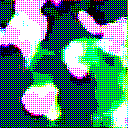

Batch 512 from 512 to 576
Gen loss: 2.2609603
Disc loss: 0.24268514
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


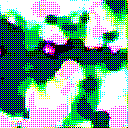

Batch 576 from 576 to 640
Gen loss: 1.9745258
Disc loss: 0.30761132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


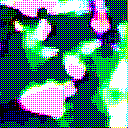


Epoch: 144
Batch 0 from 0 to 64
Gen loss: 2.0080476
Disc loss: 0.2985127
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


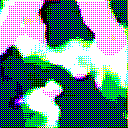

Batch 64 from 64 to 128
Gen loss: 2.0924704
Disc loss: 0.28944743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


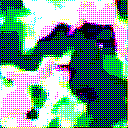

Batch 128 from 128 to 192
Gen loss: 2.0563672
Disc loss: 0.2735002
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


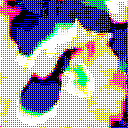

Batch 192 from 192 to 256
Gen loss: 2.0799923
Disc loss: 0.30736813
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


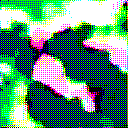

Batch 256 from 256 to 320
Gen loss: 2.0798235
Disc loss: 0.2848905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


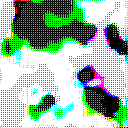

Batch 320 from 320 to 384
Gen loss: 1.9624594
Disc loss: 0.29460597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


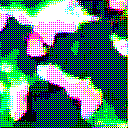

Batch 384 from 384 to 448
Gen loss: 2.1666608
Disc loss: 0.25494653
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


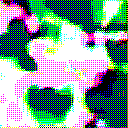

Batch 448 from 448 to 512
Gen loss: 2.1223025
Disc loss: 0.3377651
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


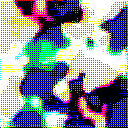

Batch 512 from 512 to 576
Gen loss: 2.1436713
Disc loss: 0.2586987
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


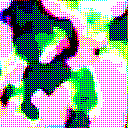

Batch 576 from 576 to 640
Gen loss: 2.07499
Disc loss: 0.29013097
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


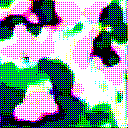


Epoch: 145
Batch 0 from 0 to 64
Gen loss: 2.0671103
Disc loss: 0.28825518
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


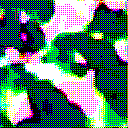

Batch 64 from 64 to 128
Gen loss: 2.038145
Disc loss: 0.29314077
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


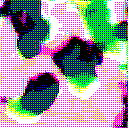

Batch 128 from 128 to 192
Gen loss: 2.1363082
Disc loss: 0.26203945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


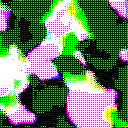

Batch 192 from 192 to 256
Gen loss: 2.078377
Disc loss: 0.30835557
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


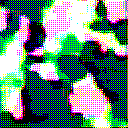

Batch 256 from 256 to 320
Gen loss: 2.01009
Disc loss: 0.29213846
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


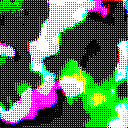

Batch 320 from 320 to 384
Gen loss: 2.0523615
Disc loss: 0.27647215
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


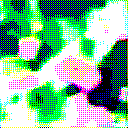

Batch 384 from 384 to 448
Gen loss: 1.99754
Disc loss: 0.28145105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


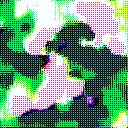

Batch 448 from 448 to 512
Gen loss: 2.0574923
Disc loss: 0.34888133
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


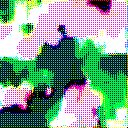

Batch 512 from 512 to 576
Gen loss: 2.0719721
Disc loss: 0.2716269
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


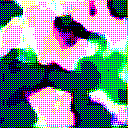

Batch 576 from 576 to 640
Gen loss: 1.9761285
Disc loss: 0.30356526
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


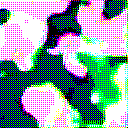


Epoch: 146
Batch 0 from 0 to 64
Gen loss: 2.1845102
Disc loss: 0.27368608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


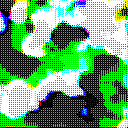

Batch 64 from 64 to 128
Gen loss: 2.079351
Disc loss: 0.288745
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


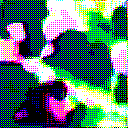

Batch 128 from 128 to 192
Gen loss: 1.9119338
Disc loss: 0.2984683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


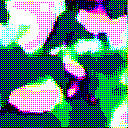

Batch 192 from 192 to 256
Gen loss: 1.9031878
Disc loss: 0.33872324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


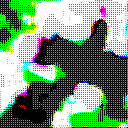

Batch 256 from 256 to 320
Gen loss: 2.1901503
Disc loss: 0.26733875
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


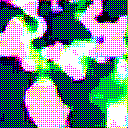

Batch 320 from 320 to 384
Gen loss: 2.084138
Disc loss: 0.26702884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


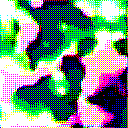

Batch 384 from 384 to 448
Gen loss: 2.107972
Disc loss: 0.26066166
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


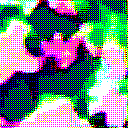

Batch 448 from 448 to 512
Gen loss: 2.1507335
Disc loss: 0.33480102
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


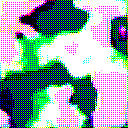

Batch 512 from 512 to 576
Gen loss: 1.9744933
Disc loss: 0.2887949
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


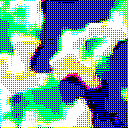

Batch 576 from 576 to 640
Gen loss: 2.2340248
Disc loss: 0.26884404
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


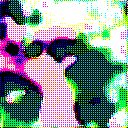


Epoch: 147
Batch 0 from 0 to 64
Gen loss: 2.0884156
Disc loss: 0.29113287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


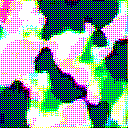

Batch 64 from 64 to 128
Gen loss: 2.16192
Disc loss: 0.2799423
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


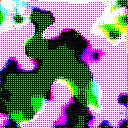

Batch 128 from 128 to 192
Gen loss: 2.2171478
Disc loss: 0.25369483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


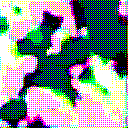

Batch 192 from 192 to 256
Gen loss: 2.065009
Disc loss: 0.32434976
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


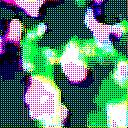

Batch 256 from 256 to 320
Gen loss: 2.247588
Disc loss: 0.26346785
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


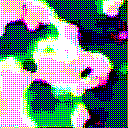

Batch 320 from 320 to 384
Gen loss: 2.244299
Disc loss: 0.25573796
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


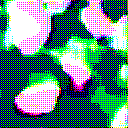

Batch 384 from 384 to 448
Gen loss: 2.153337
Disc loss: 0.25832483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


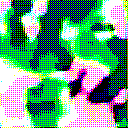

Batch 448 from 448 to 512
Gen loss: 1.98641
Disc loss: 0.3743264
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


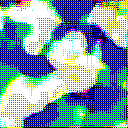

Batch 512 from 512 to 576
Gen loss: 2.1287138
Disc loss: 0.26796848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


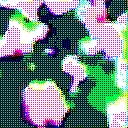

Batch 576 from 576 to 640
Gen loss: 1.9644022
Disc loss: 0.31336448
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


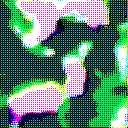


Epoch: 148
Batch 0 from 0 to 64
Gen loss: 2.2226353
Disc loss: 0.26864776
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


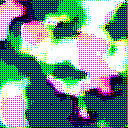

Batch 64 from 64 to 128
Gen loss: 2.2338269
Disc loss: 0.2732466
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


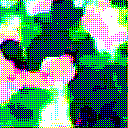

Batch 128 from 128 to 192
Gen loss: 2.2166743
Disc loss: 0.2501882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


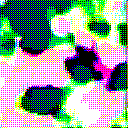

Batch 192 from 192 to 256
Gen loss: 1.8908187
Disc loss: 0.34509504
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


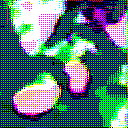

Batch 256 from 256 to 320
Gen loss: 2.1129699
Disc loss: 0.28080332
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


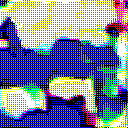

Batch 320 from 320 to 384
Gen loss: 2.134336
Disc loss: 0.26679766
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


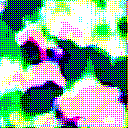

Batch 384 from 384 to 448
Gen loss: 2.1416755
Disc loss: 0.26286268
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


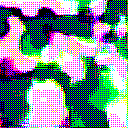

Batch 448 from 448 to 512
Gen loss: 2.2361965
Disc loss: 0.33039013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


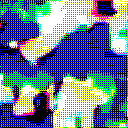

Batch 512 from 512 to 576
Gen loss: 2.3001983
Disc loss: 0.2388711
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


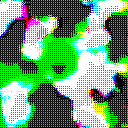

Batch 576 from 576 to 640
Gen loss: 2.1764958
Disc loss: 0.275415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


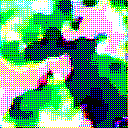


Epoch: 149
Batch 0 from 0 to 64
Gen loss: 2.1648655
Disc loss: 0.27473608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


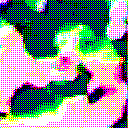

Batch 64 from 64 to 128
Gen loss: 2.1709628
Disc loss: 0.2800643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


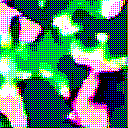

Batch 128 from 128 to 192
Gen loss: 2.279194
Disc loss: 0.24758975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


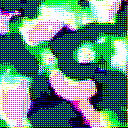

Batch 192 from 192 to 256
Gen loss: 1.9578812
Disc loss: 0.33159798
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


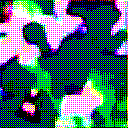

Batch 256 from 256 to 320
Gen loss: 2.1933727
Disc loss: 0.26371044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


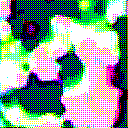

Batch 320 from 320 to 384
Gen loss: 2.0745368
Disc loss: 0.2720272
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


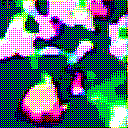

Batch 384 from 384 to 448
Gen loss: 2.0780087
Disc loss: 0.26860768
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


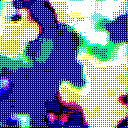

Batch 448 from 448 to 512
Gen loss: 2.2690456
Disc loss: 0.3123427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


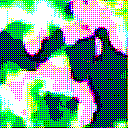

Batch 512 from 512 to 576
Gen loss: 2.2222502
Disc loss: 0.24551907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


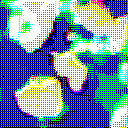

Batch 576 from 576 to 640
Gen loss: 2.166948
Disc loss: 0.2834335
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


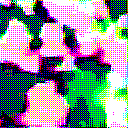


Epoch: 150
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.183807
Disc loss: 0.2628354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


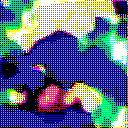

Batch 64 from 64 to 128
Gen loss: 1.984781
Disc loss: 0.30077264
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


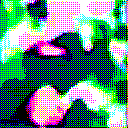

Batch 128 from 128 to 192
Gen loss: 2.138733
Disc loss: 0.2596323
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


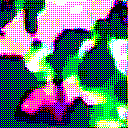

Batch 192 from 192 to 256
Gen loss: 2.2015567
Disc loss: 0.28648782
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


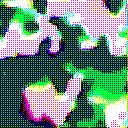

Batch 256 from 256 to 320
Gen loss: 2.2549076
Disc loss: 0.2529485
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


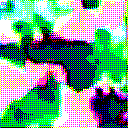

Batch 320 from 320 to 384
Gen loss: 2.252773
Disc loss: 0.24298723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


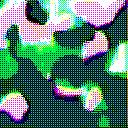

Batch 384 from 384 to 448
Gen loss: 2.104178
Disc loss: 0.26125374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


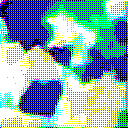

Batch 448 from 448 to 512
Gen loss: 2.2171876
Disc loss: 0.31902805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


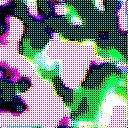

Batch 512 from 512 to 576
Gen loss: 2.147043
Disc loss: 0.2546839
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


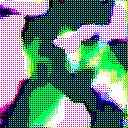

Batch 576 from 576 to 640
Gen loss: 2.3099916
Disc loss: 0.25700393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


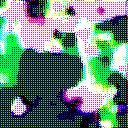


Epoch: 151
Batch 0 from 0 to 64
Gen loss: 2.2811112
Disc loss: 0.25266016
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


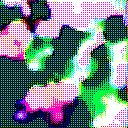

Batch 64 from 64 to 128
Gen loss: 2.1140728
Disc loss: 0.2833025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


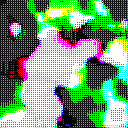

Batch 128 from 128 to 192
Gen loss: 2.1222754
Disc loss: 0.26050147
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


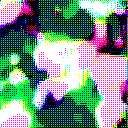

Batch 192 from 192 to 256
Gen loss: 2.0814536
Disc loss: 0.30006778
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


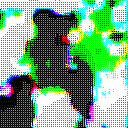

Batch 256 from 256 to 320
Gen loss: 2.135004
Disc loss: 0.2691135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


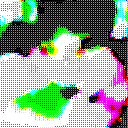

Batch 320 from 320 to 384
Gen loss: 2.140376
Disc loss: 0.2560097
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


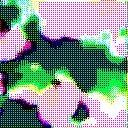

Batch 384 from 384 to 448
Gen loss: 2.1416225
Disc loss: 0.25151184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


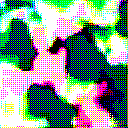

Batch 448 from 448 to 512
Gen loss: 2.0291688
Disc loss: 0.3537451
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


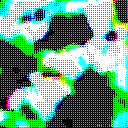

Batch 512 from 512 to 576
Gen loss: 2.2597218
Disc loss: 0.23953006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


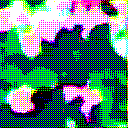

Batch 576 from 576 to 640
Gen loss: 2.0335963
Disc loss: 0.28769833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


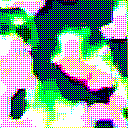


Epoch: 152
Batch 0 from 0 to 64
Gen loss: 2.057218
Disc loss: 0.28691053
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


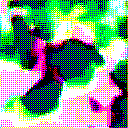

Batch 64 from 64 to 128
Gen loss: 2.2375631
Disc loss: 0.264749
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


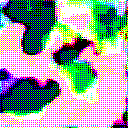

Batch 128 from 128 to 192
Gen loss: 2.2211223
Disc loss: 0.24411455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


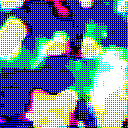

Batch 192 from 192 to 256
Gen loss: 2.3720682
Disc loss: 0.25934327
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


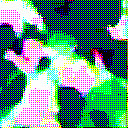

Batch 256 from 256 to 320
Gen loss: 2.2599525
Disc loss: 0.2517969
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


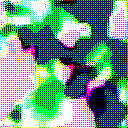

Batch 320 from 320 to 384
Gen loss: 2.0994477
Disc loss: 0.2611128
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


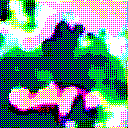

Batch 384 from 384 to 448
Gen loss: 2.2297506
Disc loss: 0.2410613
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


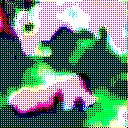

Batch 448 from 448 to 512
Gen loss: 2.137741
Disc loss: 0.32885006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


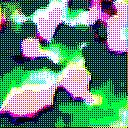

Batch 512 from 512 to 576
Gen loss: 1.9972656
Disc loss: 0.27873328
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


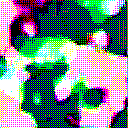

Batch 576 from 576 to 640
Gen loss: 2.1250029
Disc loss: 0.2729723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


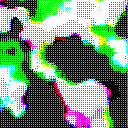


Epoch: 153
Batch 0 from 0 to 64
Gen loss: 2.196868
Disc loss: 0.2723359
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


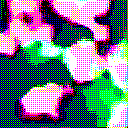

Batch 64 from 64 to 128
Gen loss: 2.0798762
Disc loss: 0.2936479
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


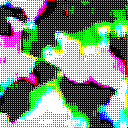

Batch 128 from 128 to 192
Gen loss: 2.2604754
Disc loss: 0.24384183
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


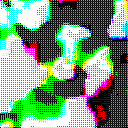

Batch 192 from 192 to 256
Gen loss: 2.128318
Disc loss: 0.2958076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


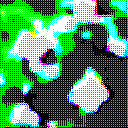

Batch 256 from 256 to 320
Gen loss: 2.099471
Disc loss: 0.28137666
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


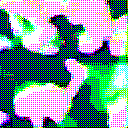

Batch 320 from 320 to 384
Gen loss: 2.0755467
Disc loss: 0.2692455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


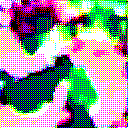

Batch 384 from 384 to 448
Gen loss: 2.1379237
Disc loss: 0.2591459
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


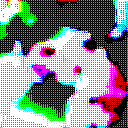

Batch 448 from 448 to 512
Gen loss: 2.141959
Disc loss: 0.3336401
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


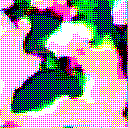

Batch 512 from 512 to 576
Gen loss: 2.1232448
Disc loss: 0.27214056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


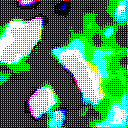

Batch 576 from 576 to 640
Gen loss: 2.0476618
Disc loss: 0.29316458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


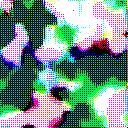


Epoch: 154
Batch 0 from 0 to 64
Gen loss: 2.1072783
Disc loss: 0.2937271
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


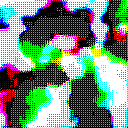

Batch 64 from 64 to 128
Gen loss: 2.0351818
Disc loss: 0.30165988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


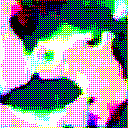

Batch 128 from 128 to 192
Gen loss: 2.2294004
Disc loss: 0.24642228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


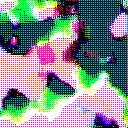

Batch 192 from 192 to 256
Gen loss: 2.0452464
Disc loss: 0.31532866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


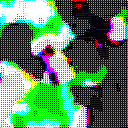

Batch 256 from 256 to 320
Gen loss: 2.2331803
Disc loss: 0.26381743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


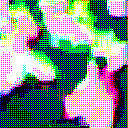

Batch 320 from 320 to 384
Gen loss: 2.1976738
Disc loss: 0.2583288
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


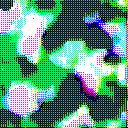

Batch 384 from 384 to 448
Gen loss: 2.3537407
Disc loss: 0.23417428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


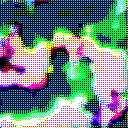

Batch 448 from 448 to 512
Gen loss: 2.1547978
Disc loss: 0.3336729
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


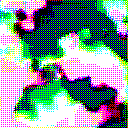

Batch 512 from 512 to 576
Gen loss: 2.1055956
Disc loss: 0.27907926
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


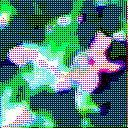

Batch 576 from 576 to 640
Gen loss: 2.0925875
Disc loss: 0.29547083
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


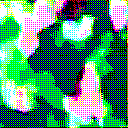


Epoch: 155
Batch 0 from 0 to 64
Gen loss: 2.1727371
Disc loss: 0.27075112
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


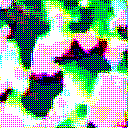

Batch 64 from 64 to 128
Gen loss: 2.1145225
Disc loss: 0.29112256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


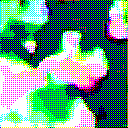

Batch 128 from 128 to 192
Gen loss: 2.2549696
Disc loss: 0.24587731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


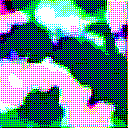

Batch 192 from 192 to 256
Gen loss: 2.1717486
Disc loss: 0.2909278
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


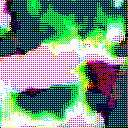

Batch 256 from 256 to 320
Gen loss: 2.2270637
Disc loss: 0.26305902
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


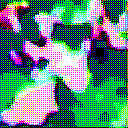

Batch 320 from 320 to 384
Gen loss: 2.236609
Disc loss: 0.25653708
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


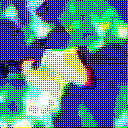

Batch 384 from 384 to 448
Gen loss: 2.3165088
Disc loss: 0.23965192
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


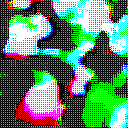

Batch 448 from 448 to 512
Gen loss: 2.1749897
Disc loss: 0.33272693
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


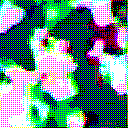

Batch 512 from 512 to 576
Gen loss: 2.1213465
Disc loss: 0.26439822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


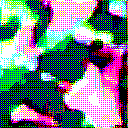

Batch 576 from 576 to 640
Gen loss: 2.2577069
Disc loss: 0.26550478
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


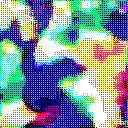


Epoch: 156
Batch 0 from 0 to 64
Gen loss: 2.3237135
Disc loss: 0.25595245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


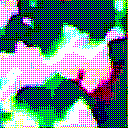

Batch 64 from 64 to 128
Gen loss: 2.2914457
Disc loss: 0.2657234
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


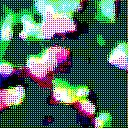

Batch 128 from 128 to 192
Gen loss: 2.334982
Disc loss: 0.23458171
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


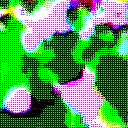

Batch 192 from 192 to 256
Gen loss: 2.4843616
Disc loss: 0.2582446
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


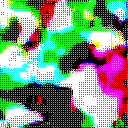

Batch 256 from 256 to 320
Gen loss: 2.3759394
Disc loss: 0.24269633
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


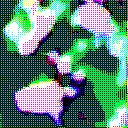

Batch 320 from 320 to 384
Gen loss: 2.3438058
Disc loss: 0.238451
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


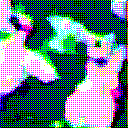

Batch 384 from 384 to 448
Gen loss: 2.236894
Disc loss: 0.23989534
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


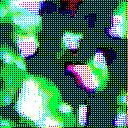

Batch 448 from 448 to 512
Gen loss: 2.329381
Disc loss: 0.30852002
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


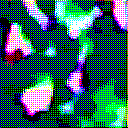

Batch 512 from 512 to 576
Gen loss: 2.4651766
Disc loss: 0.21869367
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


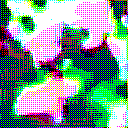

Batch 576 from 576 to 640
Gen loss: 2.235915
Disc loss: 0.27263135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


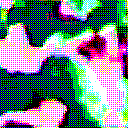


Epoch: 157
Batch 0 from 0 to 64
Gen loss: 2.1918235
Disc loss: 0.27154663
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


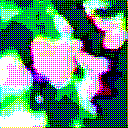

Batch 64 from 64 to 128
Gen loss: 2.3872075
Disc loss: 0.2538155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


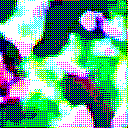

Batch 128 from 128 to 192
Gen loss: 2.436879
Disc loss: 0.22164436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


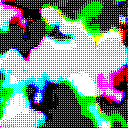

Batch 192 from 192 to 256
Gen loss: 2.2542868
Disc loss: 0.27899146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


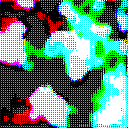

Batch 256 from 256 to 320
Gen loss: 2.2668452
Disc loss: 0.24732372
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


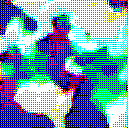

Batch 320 from 320 to 384
Gen loss: 2.2836251
Disc loss: 0.23578313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


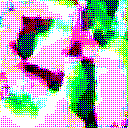

Batch 384 from 384 to 448
Gen loss: 2.4525952
Disc loss: 0.21245027
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


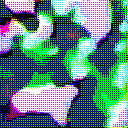

Batch 448 from 448 to 512
Gen loss: 2.4212675
Disc loss: 0.29909313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


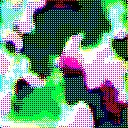

Batch 512 from 512 to 576
Gen loss: 2.2033854
Disc loss: 0.24370934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


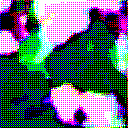

Batch 576 from 576 to 640
Gen loss: 2.2998173
Disc loss: 0.26584184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


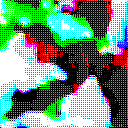


Epoch: 158
Batch 0 from 0 to 64
Gen loss: 2.3169687
Disc loss: 0.25649905
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


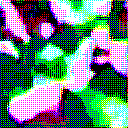

Batch 64 from 64 to 128
Gen loss: 2.2718358
Disc loss: 0.25226966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


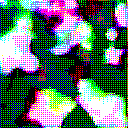

Batch 128 from 128 to 192
Gen loss: 2.3780582
Disc loss: 0.21826456
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


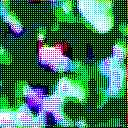

Batch 192 from 192 to 256
Gen loss: 1.9772469
Disc loss: 0.31885466
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


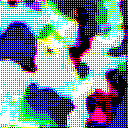

Batch 256 from 256 to 320
Gen loss: 2.2455251
Disc loss: 0.24700925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


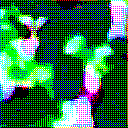

Batch 320 from 320 to 384
Gen loss: 2.3334694
Disc loss: 0.2291547
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


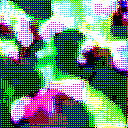

Batch 384 from 384 to 448
Gen loss: 2.1446495
Disc loss: 0.24917364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


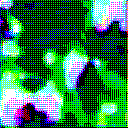

Batch 448 from 448 to 512
Gen loss: 2.2119734
Disc loss: 0.31919652
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


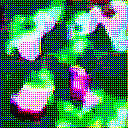

Batch 512 from 512 to 576
Gen loss: 2.0558977
Disc loss: 0.27086344
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


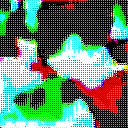

Batch 576 from 576 to 640
Gen loss: 1.9313574
Disc loss: 0.31417555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


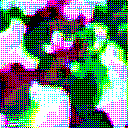


Epoch: 159
Batch 0 from 0 to 64
Gen loss: 2.0923853
Disc loss: 0.28346664
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


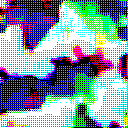

Batch 64 from 64 to 128
Gen loss: 2.3636422
Disc loss: 0.24449866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


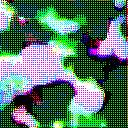

Batch 128 from 128 to 192
Gen loss: 2.1760087
Disc loss: 0.24771982
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


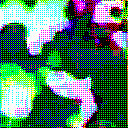

Batch 192 from 192 to 256
Gen loss: 2.3051658
Disc loss: 0.2598896
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


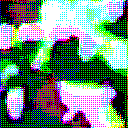

Batch 256 from 256 to 320
Gen loss: 2.1993427
Disc loss: 0.2526198
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


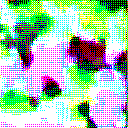

Batch 320 from 320 to 384
Gen loss: 2.2447178
Disc loss: 0.23528011
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


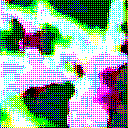

Batch 384 from 384 to 448
Gen loss: 2.241702
Disc loss: 0.23382884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


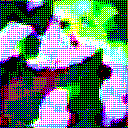

Batch 448 from 448 to 512
Gen loss: 2.1433737
Disc loss: 0.31739724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


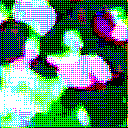

Batch 512 from 512 to 576
Gen loss: 2.2163458
Disc loss: 0.24251428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


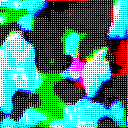

Batch 576 from 576 to 640
Gen loss: 2.2285843
Disc loss: 0.26012492
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


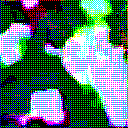


Epoch: 160
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.2213974
Disc loss: 0.26776773
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


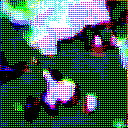

Batch 64 from 64 to 128
Gen loss: 2.2203753
Disc loss: 0.2577707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


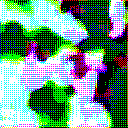

Batch 128 from 128 to 192
Gen loss: 2.3533766
Disc loss: 0.22540024
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


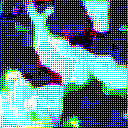

Batch 192 from 192 to 256
Gen loss: 2.2030325
Disc loss: 0.2704817
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


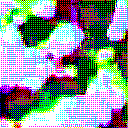

Batch 256 from 256 to 320
Gen loss: 2.4205627
Disc loss: 0.2204493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


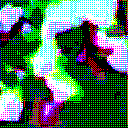

Batch 320 from 320 to 384
Gen loss: 2.3402486
Disc loss: 0.2261548
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


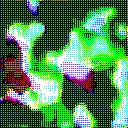

Batch 384 from 384 to 448
Gen loss: 2.338617
Disc loss: 0.21866874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


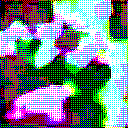

Batch 448 from 448 to 512
Gen loss: 2.1175566
Disc loss: 0.322614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


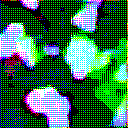

Batch 512 from 512 to 576
Gen loss: 2.1777031
Disc loss: 0.25705814
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


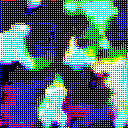

Batch 576 from 576 to 640
Gen loss: 2.1322289
Disc loss: 0.27246404
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


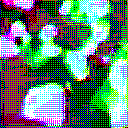


Epoch: 161
Batch 0 from 0 to 64
Gen loss: 2.1657724
Disc loss: 0.25757343
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


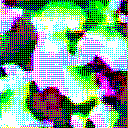

Batch 64 from 64 to 128
Gen loss: 2.0432055
Disc loss: 0.28035095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


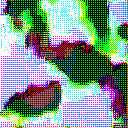

Batch 128 from 128 to 192
Gen loss: 2.3690736
Disc loss: 0.22212398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


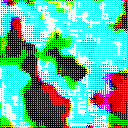

Batch 192 from 192 to 256
Gen loss: 2.2530966
Disc loss: 0.2784047
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


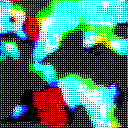

Batch 256 from 256 to 320
Gen loss: 2.3615832
Disc loss: 0.22789687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


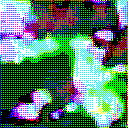

Batch 320 from 320 to 384
Gen loss: 2.3255892
Disc loss: 0.22487137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


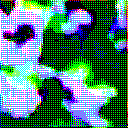

Batch 384 from 384 to 448
Gen loss: 2.2564547
Disc loss: 0.22628468
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


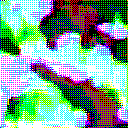

Batch 448 from 448 to 512
Gen loss: 2.3905942
Disc loss: 0.2799321
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


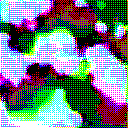

Batch 512 from 512 to 576
Gen loss: 2.404633
Disc loss: 0.21249993
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


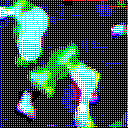

Batch 576 from 576 to 640
Gen loss: 2.224599
Disc loss: 0.2597085
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0


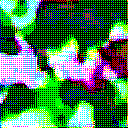


Epoch: 162
Batch 0 from 0 to 64
Gen loss: 2.3665628
Disc loss: 0.23425461
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


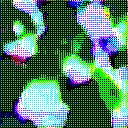

Batch 64 from 64 to 128
Gen loss: 2.2048383
Disc loss: 0.25685346
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


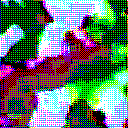

Batch 128 from 128 to 192
Gen loss: 2.4483812
Disc loss: 0.20710981
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


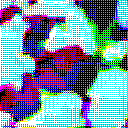

Batch 192 from 192 to 256
Gen loss: 2.3206706
Disc loss: 0.25358406
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


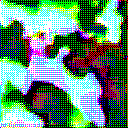

Batch 256 from 256 to 320
Gen loss: 2.2332907
Disc loss: 0.2451638
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


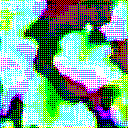

Batch 320 from 320 to 384
Gen loss: 2.452992
Disc loss: 0.21207148
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


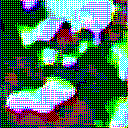

Batch 384 from 384 to 448
Gen loss: 2.3368986
Disc loss: 0.21758065
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


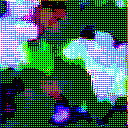

Batch 448 from 448 to 512
Gen loss: 2.4366615
Disc loss: 0.2738035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


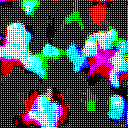

Batch 512 from 512 to 576
Gen loss: 2.4567084
Disc loss: 0.20419246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


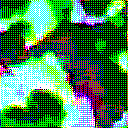

Batch 576 from 576 to 640
Gen loss: 2.0250435
Disc loss: 0.28959602
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


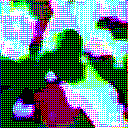


Epoch: 163
Batch 0 from 0 to 64
Gen loss: 2.2539678
Disc loss: 0.24431759
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


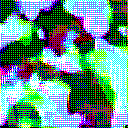

Batch 64 from 64 to 128
Gen loss: 2.3745716
Disc loss: 0.24103078
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


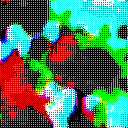

Batch 128 from 128 to 192
Gen loss: 2.4535549
Disc loss: 0.2076962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


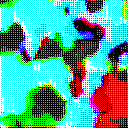

Batch 192 from 192 to 256
Gen loss: 2.4564176
Disc loss: 0.23856246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


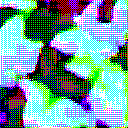

Batch 256 from 256 to 320
Gen loss: 2.3222728
Disc loss: 0.24208757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


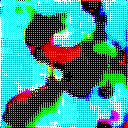

Batch 320 from 320 to 384
Gen loss: 2.3319495
Disc loss: 0.2196122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


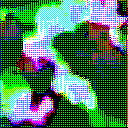

Batch 384 from 384 to 448
Gen loss: 2.4031816
Disc loss: 0.21019882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


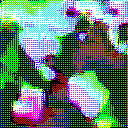

Batch 448 from 448 to 512
Gen loss: 2.3448987
Disc loss: 0.2875067
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


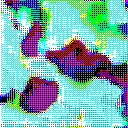

Batch 512 from 512 to 576
Gen loss: 2.341427
Disc loss: 0.21772067
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


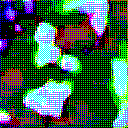

Batch 576 from 576 to 640
Gen loss: 2.3883617
Disc loss: 0.22797859
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


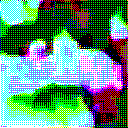


Epoch: 164
Batch 0 from 0 to 64
Gen loss: 2.3724585
Disc loss: 0.22544274
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


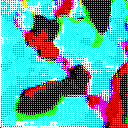

Batch 64 from 64 to 128
Gen loss: 2.524716
Disc loss: 0.22217932
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


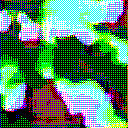

Batch 128 from 128 to 192
Gen loss: 2.3324845
Disc loss: 0.22122242
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


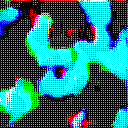

Batch 192 from 192 to 256
Gen loss: 2.373281
Disc loss: 0.2478373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


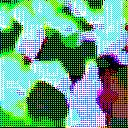

Batch 256 from 256 to 320
Gen loss: 2.3215504
Disc loss: 0.22873066
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


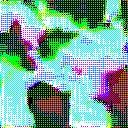

Batch 320 from 320 to 384
Gen loss: 2.4128072
Disc loss: 0.21046887
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


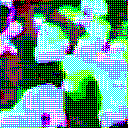

Batch 384 from 384 to 448
Gen loss: 2.4934897
Disc loss: 0.19682011
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


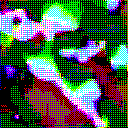

Batch 448 from 448 to 512
Gen loss: 2.4388256
Disc loss: 0.26832062
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


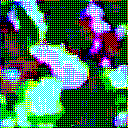

Batch 512 from 512 to 576
Gen loss: 2.528474
Disc loss: 0.19397628
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


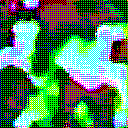

Batch 576 from 576 to 640
Gen loss: 2.5157785
Disc loss: 0.21156847
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


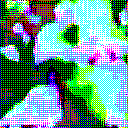


Epoch: 165
Batch 0 from 0 to 64
Gen loss: 2.4429784
Disc loss: 0.22023803
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


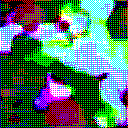

Batch 64 from 64 to 128
Gen loss: 2.5278358
Disc loss: 0.21483926
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


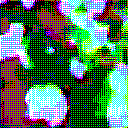

Batch 128 from 128 to 192
Gen loss: 2.482634
Disc loss: 0.20330587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


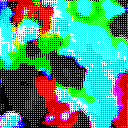

Batch 192 from 192 to 256
Gen loss: 2.4951148
Disc loss: 0.22873306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


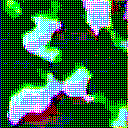

Batch 256 from 256 to 320
Gen loss: 2.3376923
Disc loss: 0.22750598
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


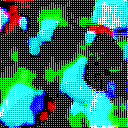

Batch 320 from 320 to 384
Gen loss: 2.340257
Disc loss: 0.2149184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


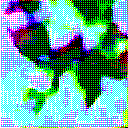

Batch 384 from 384 to 448
Gen loss: 2.5198798
Disc loss: 0.19194067
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


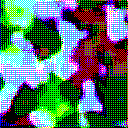

Batch 448 from 448 to 512
Gen loss: 2.5035942
Disc loss: 0.26766735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


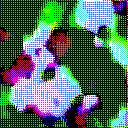

Batch 512 from 512 to 576
Gen loss: 2.4654431
Disc loss: 0.2029035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


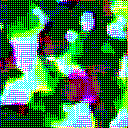

Batch 576 from 576 to 640
Gen loss: 2.1652105
Disc loss: 0.25810993
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


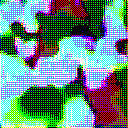


Epoch: 166
Batch 0 from 0 to 64
Gen loss: 2.5358515
Disc loss: 0.20931682
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


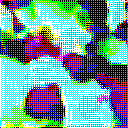

Batch 64 from 64 to 128
Gen loss: 2.5412107
Disc loss: 0.21022364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


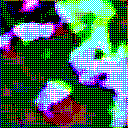

Batch 128 from 128 to 192
Gen loss: 2.517118
Disc loss: 0.1935853
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


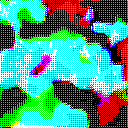

Batch 192 from 192 to 256
Gen loss: 2.4012356
Disc loss: 0.23718241
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


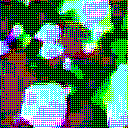

Batch 256 from 256 to 320
Gen loss: 2.4589543
Disc loss: 0.21095578
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


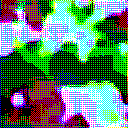

Batch 320 from 320 to 384
Gen loss: 2.5765805
Disc loss: 0.19356313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


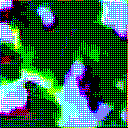

Batch 384 from 384 to 448
Gen loss: 2.5448995
Disc loss: 0.18962386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


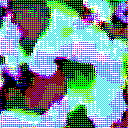

Batch 448 from 448 to 512
Gen loss: 2.3761368
Disc loss: 0.2774829
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


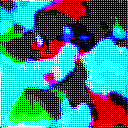

Batch 512 from 512 to 576
Gen loss: 2.5026085
Disc loss: 0.19783524
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


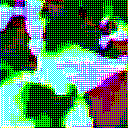

Batch 576 from 576 to 640
Gen loss: 2.2950718
Disc loss: 0.23838195
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


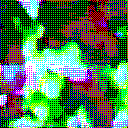


Epoch: 167
Batch 0 from 0 to 64
Gen loss: 2.389144
Disc loss: 0.21943003
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


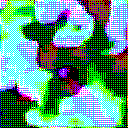

Batch 64 from 64 to 128
Gen loss: 2.397636
Disc loss: 0.21752366
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


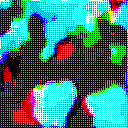

Batch 128 from 128 to 192
Gen loss: 2.335308
Disc loss: 0.2115944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


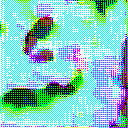

Batch 192 from 192 to 256
Gen loss: 2.6050825
Disc loss: 0.21475859
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


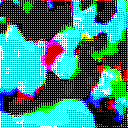

Batch 256 from 256 to 320
Gen loss: 2.3546152
Disc loss: 0.21801141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


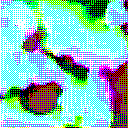

Batch 320 from 320 to 384
Gen loss: 2.3150523
Disc loss: 0.21276927
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


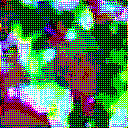

Batch 384 from 384 to 448
Gen loss: 2.1861115
Disc loss: 0.2347837
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


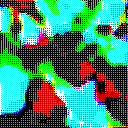

Batch 448 from 448 to 512
Gen loss: 2.2390442
Disc loss: 0.28651747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


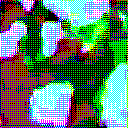

Batch 512 from 512 to 576
Gen loss: 2.3782744
Disc loss: 0.20480779
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


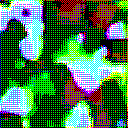

Batch 576 from 576 to 640
Gen loss: 2.1022868
Disc loss: 0.25554472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


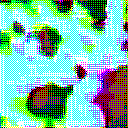


Epoch: 168
Batch 0 from 0 to 64
Gen loss: 2.2283294
Disc loss: 0.2420474
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


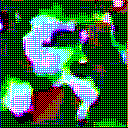

Batch 64 from 64 to 128
Gen loss: 2.260745
Disc loss: 0.2389509
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


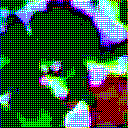

Batch 128 from 128 to 192
Gen loss: 2.1894202
Disc loss: 0.22955644
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


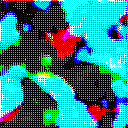

Batch 192 from 192 to 256
Gen loss: 2.2244158
Disc loss: 0.26084214
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


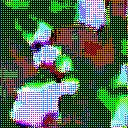

Batch 256 from 256 to 320
Gen loss: 2.3156724
Disc loss: 0.2258155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


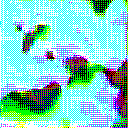

Batch 320 from 320 to 384
Gen loss: 2.3488965
Disc loss: 0.21053757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


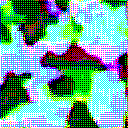

Batch 384 from 384 to 448
Gen loss: 2.2483516
Disc loss: 0.22734949
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


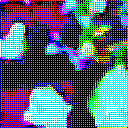

Batch 448 from 448 to 512
Gen loss: 2.2487879
Disc loss: 0.28889775
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


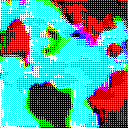

Batch 512 from 512 to 576
Gen loss: 2.262907
Disc loss: 0.21876007
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


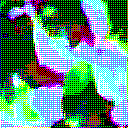

Batch 576 from 576 to 640
Gen loss: 2.2262714
Disc loss: 0.24361622
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


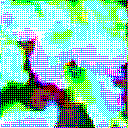


Epoch: 169
Batch 0 from 0 to 64
Gen loss: 2.3100195
Disc loss: 0.22871599
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


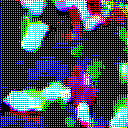

Batch 64 from 64 to 128
Gen loss: 2.22602
Disc loss: 0.2441892
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


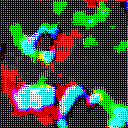

Batch 128 from 128 to 192
Gen loss: 2.2576165
Disc loss: 0.2261404
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


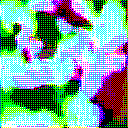

Batch 192 from 192 to 256
Gen loss: 2.1326494
Disc loss: 0.27411732
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


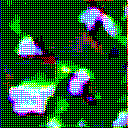

Batch 256 from 256 to 320
Gen loss: 2.1867127
Disc loss: 0.2408232
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


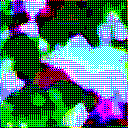

Batch 320 from 320 to 384
Gen loss: 2.225336
Disc loss: 0.2258803
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


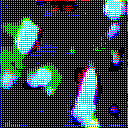

Batch 384 from 384 to 448
Gen loss: 2.3321822
Disc loss: 0.20902064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


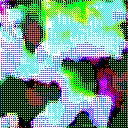

Batch 448 from 448 to 512
Gen loss: 2.0282352
Disc loss: 0.34031564
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


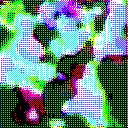

Batch 512 from 512 to 576
Gen loss: 2.125188
Disc loss: 0.23870641
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


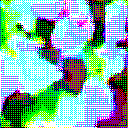

Batch 576 from 576 to 640
Gen loss: 2.1384308
Disc loss: 0.25901696
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


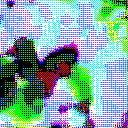


Epoch: 170
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.2833223
Disc loss: 0.22992659
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


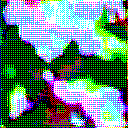

Batch 64 from 64 to 128
Gen loss: 2.3523884
Disc loss: 0.22990808
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


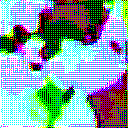

Batch 128 from 128 to 192
Gen loss: 2.332439
Disc loss: 0.21896009
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


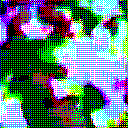

Batch 192 from 192 to 256
Gen loss: 2.3121781
Disc loss: 0.25253648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


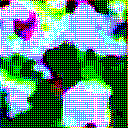

Batch 256 from 256 to 320
Gen loss: 2.4121442
Disc loss: 0.21417901
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


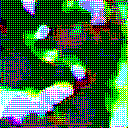

Batch 320 from 320 to 384
Gen loss: 2.4280386
Disc loss: 0.20233282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


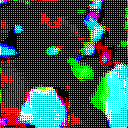

Batch 384 from 384 to 448
Gen loss: 2.4935582
Disc loss: 0.19097102
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


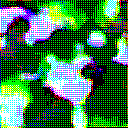

Batch 448 from 448 to 512
Gen loss: 2.3626852
Disc loss: 0.2776137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


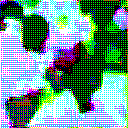

Batch 512 from 512 to 576
Gen loss: 2.5018313
Disc loss: 0.19946812
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


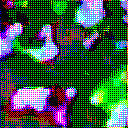

Batch 576 from 576 to 640
Gen loss: 2.5303082
Disc loss: 0.21561672
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


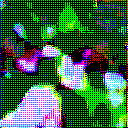


Epoch: 171
Batch 0 from 0 to 64
Gen loss: 2.3631663
Disc loss: 0.22655219
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


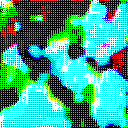

Batch 64 from 64 to 128
Gen loss: 2.4125128
Disc loss: 0.2215202
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


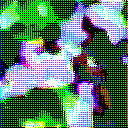

Batch 128 from 128 to 192
Gen loss: 2.4658985
Disc loss: 0.19482908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


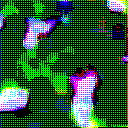

Batch 192 from 192 to 256
Gen loss: 2.428448
Disc loss: 0.23293784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


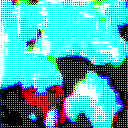

Batch 256 from 256 to 320
Gen loss: 2.3166964
Disc loss: 0.2220509
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


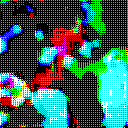

Batch 320 from 320 to 384
Gen loss: 2.424965
Disc loss: 0.20024945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


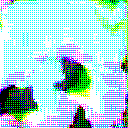

Batch 384 from 384 to 448
Gen loss: 2.391098
Disc loss: 0.19900727
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


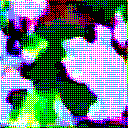

Batch 448 from 448 to 512
Gen loss: 2.2875485
Disc loss: 0.28401634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


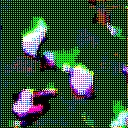

Batch 512 from 512 to 576
Gen loss: 2.2070563
Disc loss: 0.22251138
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


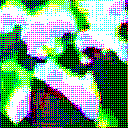

Batch 576 from 576 to 640
Gen loss: 2.5765874
Disc loss: 0.20103505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


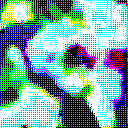


Epoch: 172
Batch 0 from 0 to 64
Gen loss: 2.404312
Disc loss: 0.21690588
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


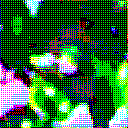

Batch 64 from 64 to 128
Gen loss: 2.3583233
Disc loss: 0.22887987
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


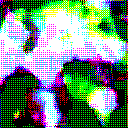

Batch 128 from 128 to 192
Gen loss: 2.389409
Disc loss: 0.20029114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


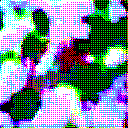

Batch 192 from 192 to 256
Gen loss: 2.5138695
Disc loss: 0.21889159
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


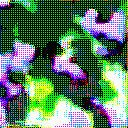

Batch 256 from 256 to 320
Gen loss: 2.3407907
Disc loss: 0.21852112
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


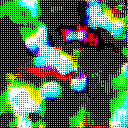

Batch 320 from 320 to 384
Gen loss: 2.2842233
Disc loss: 0.21690482
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


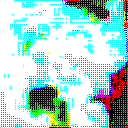

Batch 384 from 384 to 448
Gen loss: 2.360973
Disc loss: 0.20133361
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


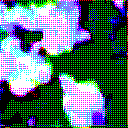

Batch 448 from 448 to 512
Gen loss: 2.2787743
Disc loss: 0.27878267
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


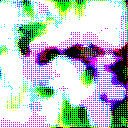

Batch 512 from 512 to 576
Gen loss: 2.324174
Disc loss: 0.21573834
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


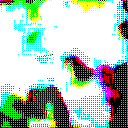

Batch 576 from 576 to 640
Gen loss: 2.4921925
Disc loss: 0.20564136
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


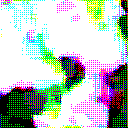


Epoch: 173
Batch 0 from 0 to 64
Gen loss: 2.315403
Disc loss: 0.22728738
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


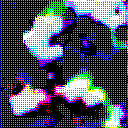

Batch 64 from 64 to 128
Gen loss: 2.1435323
Disc loss: 0.25244018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


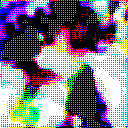

Batch 128 from 128 to 192
Gen loss: 2.3555489
Disc loss: 0.2026178
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


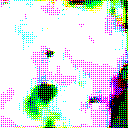

Batch 192 from 192 to 256
Gen loss: 2.3412595
Disc loss: 0.24142894
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


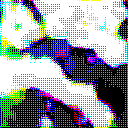

Batch 256 from 256 to 320
Gen loss: 2.3360243
Disc loss: 0.21872774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


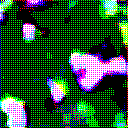

Batch 320 from 320 to 384
Gen loss: 2.2962484
Disc loss: 0.20951481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


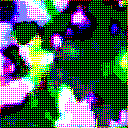

Batch 384 from 384 to 448
Gen loss: 2.170009
Disc loss: 0.22389996
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


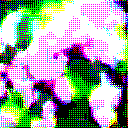

Batch 448 from 448 to 512
Gen loss: 2.3510199
Disc loss: 0.27363813
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


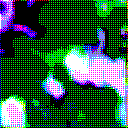

Batch 512 from 512 to 576
Gen loss: 2.0630984
Disc loss: 0.2541784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


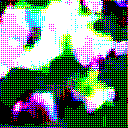

Batch 576 from 576 to 640
Gen loss: 2.1942956
Disc loss: 0.24441724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


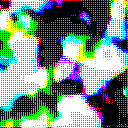


Epoch: 174
Batch 0 from 0 to 64
Gen loss: 2.219077
Disc loss: 0.23620605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


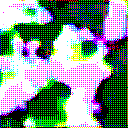

Batch 64 from 64 to 128
Gen loss: 2.2361646
Disc loss: 0.23794764
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


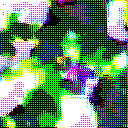

Batch 128 from 128 to 192
Gen loss: 2.3177347
Disc loss: 0.20860413
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


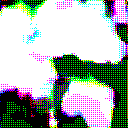

Batch 192 from 192 to 256
Gen loss: 2.3141785
Disc loss: 0.23837459
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


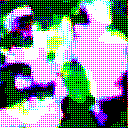

Batch 256 from 256 to 320
Gen loss: 2.1557448
Disc loss: 0.23914194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


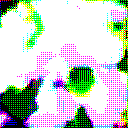

Batch 320 from 320 to 384
Gen loss: 2.481194
Disc loss: 0.19345906
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


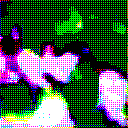

Batch 384 from 384 to 448
Gen loss: 2.2757893
Disc loss: 0.21036972
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


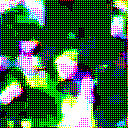

Batch 448 from 448 to 512
Gen loss: 2.4369476
Disc loss: 0.26866978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


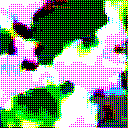

Batch 512 from 512 to 576
Gen loss: 2.4342842
Disc loss: 0.19594395
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


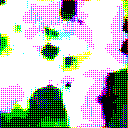

Batch 576 from 576 to 640
Gen loss: 2.3511758
Disc loss: 0.22244951
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


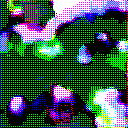


Epoch: 175
Batch 0 from 0 to 64
Gen loss: 2.382102
Disc loss: 0.21929735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


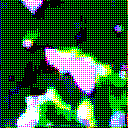

Batch 64 from 64 to 128
Gen loss: 2.4440627
Disc loss: 0.21541104
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


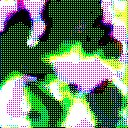

Batch 128 from 128 to 192
Gen loss: 2.4810972
Disc loss: 0.19189188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


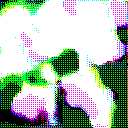

Batch 192 from 192 to 256
Gen loss: 2.216756
Disc loss: 0.25503582
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


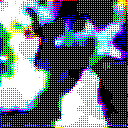

Batch 256 from 256 to 320
Gen loss: 2.4875994
Disc loss: 0.20395675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


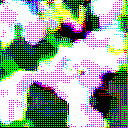

Batch 320 from 320 to 384
Gen loss: 2.3056927
Disc loss: 0.21753412
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


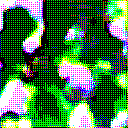

Batch 384 from 384 to 448
Gen loss: 2.236157
Disc loss: 0.22418243
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


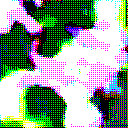

Batch 448 from 448 to 512
Gen loss: 2.456699
Disc loss: 0.26522487
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


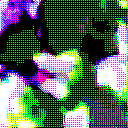

Batch 512 from 512 to 576
Gen loss: 2.065404
Disc loss: 0.24950472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


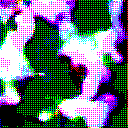

Batch 576 from 576 to 640
Gen loss: 2.259246
Disc loss: 0.2483531
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


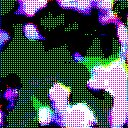


Epoch: 176
Batch 0 from 0 to 64
Gen loss: 2.3276205
Disc loss: 0.2241608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


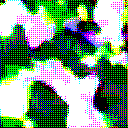

Batch 64 from 64 to 128
Gen loss: 2.574889
Disc loss: 0.19946763
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


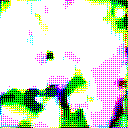

Batch 128 from 128 to 192
Gen loss: 2.371204
Disc loss: 0.21237645
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


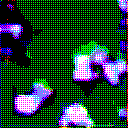

Batch 192 from 192 to 256
Gen loss: 2.222074
Disc loss: 0.25728512
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


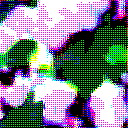

Batch 256 from 256 to 320
Gen loss: 2.319203
Disc loss: 0.21999839
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


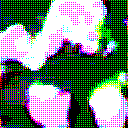

Batch 320 from 320 to 384
Gen loss: 2.4392378
Disc loss: 0.20658435
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


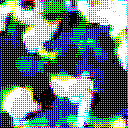

Batch 384 from 384 to 448
Gen loss: 2.3903682
Disc loss: 0.20523168
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


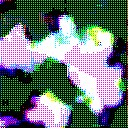

Batch 448 from 448 to 512
Gen loss: 2.4578733
Disc loss: 0.26220086
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


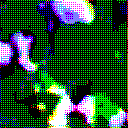

Batch 512 from 512 to 576
Gen loss: 2.3422072
Disc loss: 0.20882493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


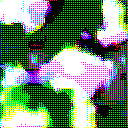

Batch 576 from 576 to 640
Gen loss: 2.4787436
Disc loss: 0.21031883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


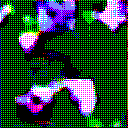


Epoch: 177
Batch 0 from 0 to 64
Gen loss: 2.442237
Disc loss: 0.21417162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


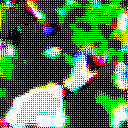

Batch 64 from 64 to 128
Gen loss: 2.402686
Disc loss: 0.22469543
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


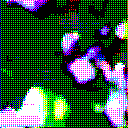

Batch 128 from 128 to 192
Gen loss: 2.4240143
Disc loss: 0.20226689
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


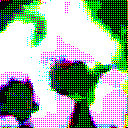

Batch 192 from 192 to 256
Gen loss: 2.5253408
Disc loss: 0.22179456
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


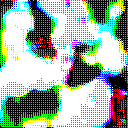

Batch 256 from 256 to 320
Gen loss: 2.4726121
Disc loss: 0.20298687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


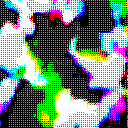

Batch 320 from 320 to 384
Gen loss: 2.346993
Disc loss: 0.20767266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


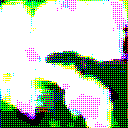

Batch 384 from 384 to 448
Gen loss: 2.4535556
Disc loss: 0.18857971
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


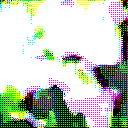

Batch 448 from 448 to 512
Gen loss: 2.390969
Disc loss: 0.26659408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


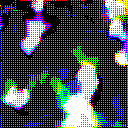

Batch 512 from 512 to 576
Gen loss: 2.5217247
Disc loss: 0.18625848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


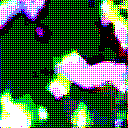

Batch 576 from 576 to 640
Gen loss: 2.4710546
Disc loss: 0.21246779
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


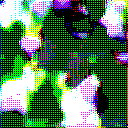


Epoch: 178
Batch 0 from 0 to 64
Gen loss: 2.3286572
Disc loss: 0.22136192
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


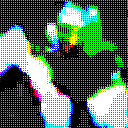

Batch 64 from 64 to 128
Gen loss: 2.5513594
Disc loss: 0.20333523
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


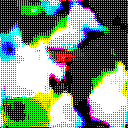

Batch 128 from 128 to 192
Gen loss: 2.4030664
Disc loss: 0.20062226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


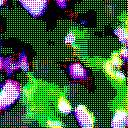

Batch 192 from 192 to 256
Gen loss: 2.5430365
Disc loss: 0.22107899
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


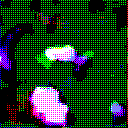

Batch 256 from 256 to 320
Gen loss: 2.3881564
Disc loss: 0.20996076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


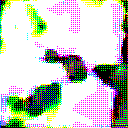

Batch 320 from 320 to 384
Gen loss: 2.5681872
Disc loss: 0.18504038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


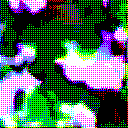

Batch 384 from 384 to 448
Gen loss: 2.574886
Disc loss: 0.18041587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


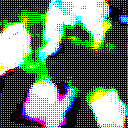

Batch 448 from 448 to 512
Gen loss: 2.4136038
Disc loss: 0.26386082
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


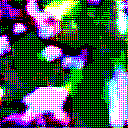

Batch 512 from 512 to 576
Gen loss: 2.3526394
Disc loss: 0.20415735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


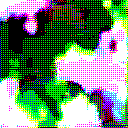

Batch 576 from 576 to 640
Gen loss: 2.4660742
Disc loss: 0.21244273
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


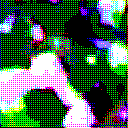


Epoch: 179
Batch 0 from 0 to 64
Gen loss: 2.4558344
Disc loss: 0.20284382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


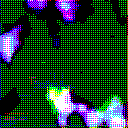

Batch 64 from 64 to 128
Gen loss: 2.4913015
Disc loss: 0.21000764
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


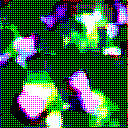

Batch 128 from 128 to 192
Gen loss: 2.3290467
Disc loss: 0.20951952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


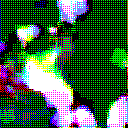

Batch 192 from 192 to 256
Gen loss: 2.548682
Disc loss: 0.21843603
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


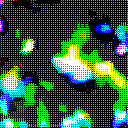

Batch 256 from 256 to 320
Gen loss: 2.5216448
Disc loss: 0.20193434
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


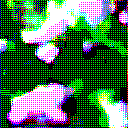

Batch 320 from 320 to 384
Gen loss: 2.3687599
Disc loss: 0.2010501
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


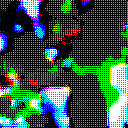

Batch 384 from 384 to 448
Gen loss: 2.5076237
Disc loss: 0.18023823
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


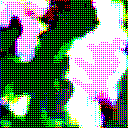

Batch 448 from 448 to 512
Gen loss: 2.3657112
Disc loss: 0.26783445
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


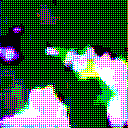

Batch 512 from 512 to 576
Gen loss: 2.7233005
Disc loss: 0.16503522
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


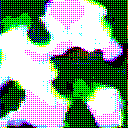

Batch 576 from 576 to 640
Gen loss: 2.5342076
Disc loss: 0.19766107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


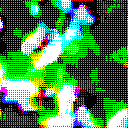


Epoch: 180
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.3823595
Disc loss: 0.21064176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


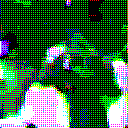

Batch 64 from 64 to 128
Gen loss: 2.4113822
Disc loss: 0.21265869
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


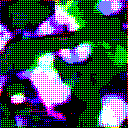

Batch 128 from 128 to 192
Gen loss: 2.2367058
Disc loss: 0.21667972
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


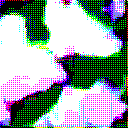

Batch 192 from 192 to 256
Gen loss: 2.4155817
Disc loss: 0.22156325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


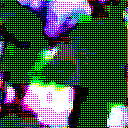

Batch 256 from 256 to 320
Gen loss: 2.426404
Disc loss: 0.19777787
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


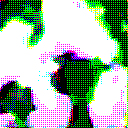

Batch 320 from 320 to 384
Gen loss: 2.5202901
Disc loss: 0.18297008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


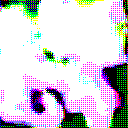

Batch 384 from 384 to 448
Gen loss: 2.5490642
Disc loss: 0.17471099
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


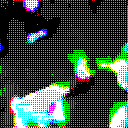

Batch 448 from 448 to 512
Gen loss: 2.4873948
Disc loss: 0.24813275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


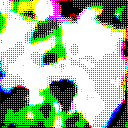

Batch 512 from 512 to 576
Gen loss: 2.533856
Disc loss: 0.18140134
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


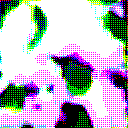

Batch 576 from 576 to 640
Gen loss: 2.5253315
Disc loss: 0.19310218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


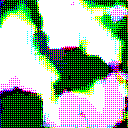


Epoch: 181
Batch 0 from 0 to 64
Gen loss: 2.475956
Disc loss: 0.19775346
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


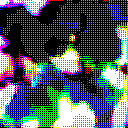

Batch 64 from 64 to 128
Gen loss: 2.7276156
Disc loss: 0.17897037
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


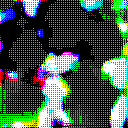

Batch 128 from 128 to 192
Gen loss: 2.5153584
Disc loss: 0.18156658
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


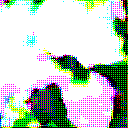

Batch 192 from 192 to 256
Gen loss: 2.5539737
Disc loss: 0.20606643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


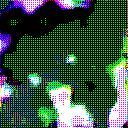

Batch 256 from 256 to 320
Gen loss: 2.5027642
Disc loss: 0.18908535
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


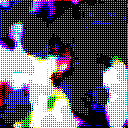

Batch 320 from 320 to 384
Gen loss: 2.4804356
Disc loss: 0.18442382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


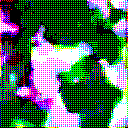

Batch 384 from 384 to 448
Gen loss: 2.5698514
Disc loss: 0.1726678
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


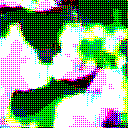

Batch 448 from 448 to 512
Gen loss: 2.4641113
Disc loss: 0.24517986
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


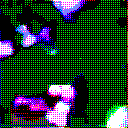

Batch 512 from 512 to 576
Gen loss: 2.5220928
Disc loss: 0.17962962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


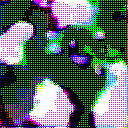

Batch 576 from 576 to 640
Gen loss: 2.57594
Disc loss: 0.18885589
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


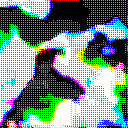


Epoch: 182
Batch 0 from 0 to 64
Gen loss: 2.5781612
Disc loss: 0.18480635
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


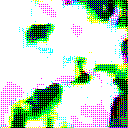

Batch 64 from 64 to 128
Gen loss: 2.3186216
Disc loss: 0.223087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


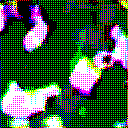

Batch 128 from 128 to 192
Gen loss: 2.724449
Disc loss: 0.15950885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


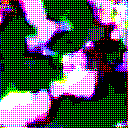

Batch 192 from 192 to 256
Gen loss: 2.4119046
Disc loss: 0.21893762
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


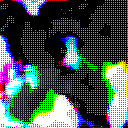

Batch 256 from 256 to 320
Gen loss: 2.5782642
Disc loss: 0.17934486
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


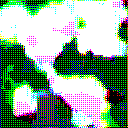

Batch 320 from 320 to 384
Gen loss: 2.541676
Disc loss: 0.1758692
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


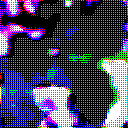

Batch 384 from 384 to 448
Gen loss: 2.6346688
Disc loss: 0.16434082
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


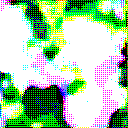

Batch 448 from 448 to 512
Gen loss: 2.6480582
Disc loss: 0.22962064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


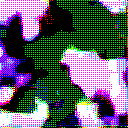

Batch 512 from 512 to 576
Gen loss: 2.5066128
Disc loss: 0.18111748
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


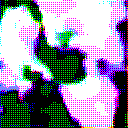

Batch 576 from 576 to 640
Gen loss: 2.415747
Disc loss: 0.2045299
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


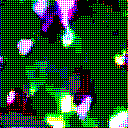


Epoch: 183
Batch 0 from 0 to 64
Gen loss: 2.6582146
Disc loss: 0.17669725
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


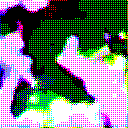

Batch 64 from 64 to 128
Gen loss: 2.4896305
Disc loss: 0.19567707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


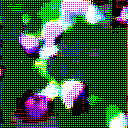

Batch 128 from 128 to 192
Gen loss: 2.5912678
Disc loss: 0.16925153
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


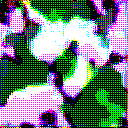

Batch 192 from 192 to 256
Gen loss: 2.610868
Disc loss: 0.19754964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


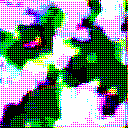

Batch 256 from 256 to 320
Gen loss: 2.5416276
Disc loss: 0.18286768
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


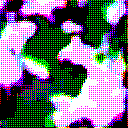

Batch 320 from 320 to 384
Gen loss: 2.5286148
Disc loss: 0.1763815
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


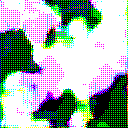

Batch 384 from 384 to 448
Gen loss: 2.5739086
Disc loss: 0.16863675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


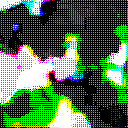

Batch 448 from 448 to 512
Gen loss: 2.412696
Disc loss: 0.24835916
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


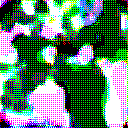

Batch 512 from 512 to 576
Gen loss: 2.5350695
Disc loss: 0.18280621
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


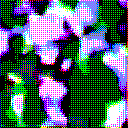

Batch 576 from 576 to 640
Gen loss: 2.7456036
Disc loss: 0.17141193
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


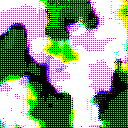


Epoch: 184
Batch 0 from 0 to 64
Gen loss: 2.6262121
Disc loss: 0.17688167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


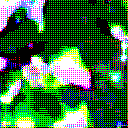

Batch 64 from 64 to 128
Gen loss: 2.685823
Disc loss: 0.18058953
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


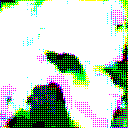

Batch 128 from 128 to 192
Gen loss: 2.5906708
Disc loss: 0.170352
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


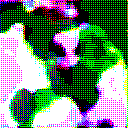

Batch 192 from 192 to 256
Gen loss: 2.7346516
Disc loss: 0.18595129
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


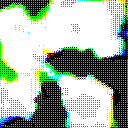

Batch 256 from 256 to 320
Gen loss: 2.4474726
Disc loss: 0.18820715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


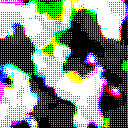

Batch 320 from 320 to 384
Gen loss: 2.5379303
Disc loss: 0.17241922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


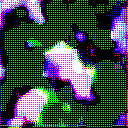

Batch 384 from 384 to 448
Gen loss: 2.573401
Disc loss: 0.1669069
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


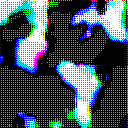

Batch 448 from 448 to 512
Gen loss: 2.3665147
Disc loss: 0.25439358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


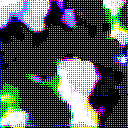

Batch 512 from 512 to 576
Gen loss: 2.4476275
Disc loss: 0.1846528
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


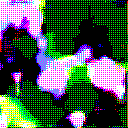

Batch 576 from 576 to 640
Gen loss: 2.374791
Disc loss: 0.20240363
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


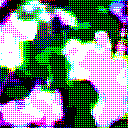


Epoch: 185
Batch 0 from 0 to 64
Gen loss: 2.4466674
Disc loss: 0.19450395
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


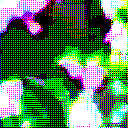

Batch 64 from 64 to 128
Gen loss: 2.4285083
Disc loss: 0.19989955
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


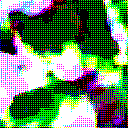

Batch 128 from 128 to 192
Gen loss: 2.3566043
Disc loss: 0.1936349
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


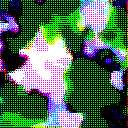

Batch 192 from 192 to 256
Gen loss: 2.2999709
Disc loss: 0.22583811
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


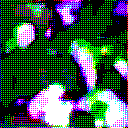

Batch 256 from 256 to 320
Gen loss: 2.4069831
Disc loss: 0.19428387
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


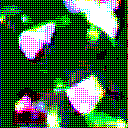

Batch 320 from 320 to 384
Gen loss: 2.2090144
Disc loss: 0.21881236
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


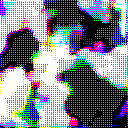

Batch 384 from 384 to 448
Gen loss: 2.461343
Disc loss: 0.17992899
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


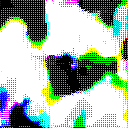

Batch 448 from 448 to 512
Gen loss: 2.2758107
Disc loss: 0.26738676
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


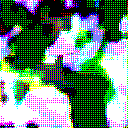

Batch 512 from 512 to 576
Gen loss: 2.448535
Disc loss: 0.18840654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


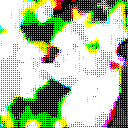

Batch 576 from 576 to 640
Gen loss: 2.275056
Disc loss: 0.21674004
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


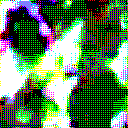


Epoch: 186
Batch 0 from 0 to 64
Gen loss: 2.3601663
Disc loss: 0.2073412
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


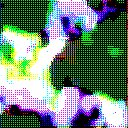

Batch 64 from 64 to 128
Gen loss: 2.4742453
Disc loss: 0.199771
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


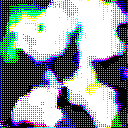

Batch 128 from 128 to 192
Gen loss: 2.389495
Disc loss: 0.19116396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


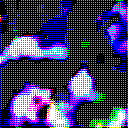

Batch 192 from 192 to 256
Gen loss: 2.2363725
Disc loss: 0.24862196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


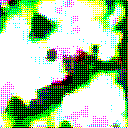

Batch 256 from 256 to 320
Gen loss: 2.403381
Disc loss: 0.19895324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


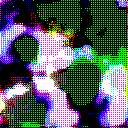

Batch 320 from 320 to 384
Gen loss: 2.3058822
Disc loss: 0.19875194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


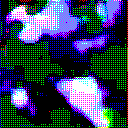

Batch 384 from 384 to 448
Gen loss: 2.4822474
Disc loss: 0.17597443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


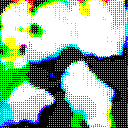

Batch 448 from 448 to 512
Gen loss: 2.4650025
Disc loss: 0.25522143
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


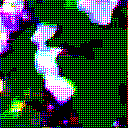

Batch 512 from 512 to 576
Gen loss: 2.3186336
Disc loss: 0.21022119
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


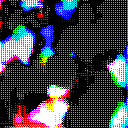

Batch 576 from 576 to 640
Gen loss: 2.3146718
Disc loss: 0.2249871
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


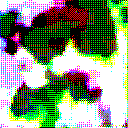


Epoch: 187
Batch 0 from 0 to 64
Gen loss: 2.538083
Disc loss: 0.19168428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


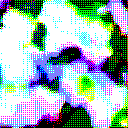

Batch 64 from 64 to 128
Gen loss: 2.311815
Disc loss: 0.22173151
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


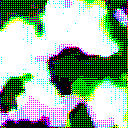

Batch 128 from 128 to 192
Gen loss: 2.5585938
Disc loss: 0.17902213
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


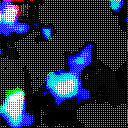

Batch 192 from 192 to 256
Gen loss: 2.515452
Disc loss: 0.21184976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


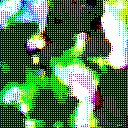

Batch 256 from 256 to 320
Gen loss: 2.3401737
Disc loss: 0.20410341
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


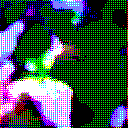

Batch 320 from 320 to 384
Gen loss: 2.6379492
Disc loss: 0.17168893
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


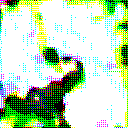

Batch 384 from 384 to 448
Gen loss: 2.3489647
Disc loss: 0.20189577
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


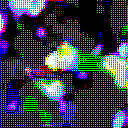

Batch 448 from 448 to 512
Gen loss: 2.7182198
Disc loss: 0.22722977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


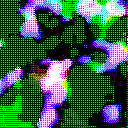

Batch 512 from 512 to 576
Gen loss: 2.3159301
Disc loss: 0.20220074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


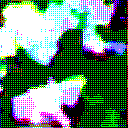

Batch 576 from 576 to 640
Gen loss: 2.6560037
Disc loss: 0.1896733
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


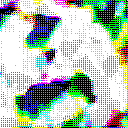


Epoch: 188
Batch 0 from 0 to 64
Gen loss: 2.5967107
Disc loss: 0.19005318
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


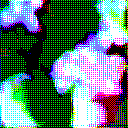

Batch 64 from 64 to 128
Gen loss: 2.5622916
Disc loss: 0.19583999
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


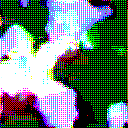

Batch 128 from 128 to 192
Gen loss: 2.7360728
Disc loss: 0.16134888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


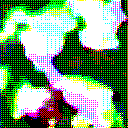

Batch 192 from 192 to 256
Gen loss: 2.4753275
Disc loss: 0.21711583
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


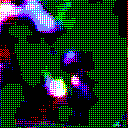

Batch 256 from 256 to 320
Gen loss: 2.3324177
Disc loss: 0.20901817
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


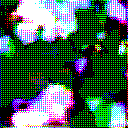

Batch 320 from 320 to 384
Gen loss: 2.5124555
Disc loss: 0.1812745
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


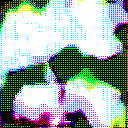

Batch 384 from 384 to 448
Gen loss: 2.5600019
Disc loss: 0.17199984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


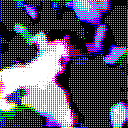

Batch 448 from 448 to 512
Gen loss: 2.277357
Disc loss: 0.2771346
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


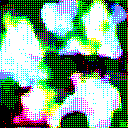

Batch 512 from 512 to 576
Gen loss: 2.5540276
Disc loss: 0.17866325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


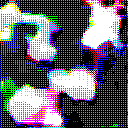

Batch 576 from 576 to 640
Gen loss: 2.6989226
Disc loss: 0.17906874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


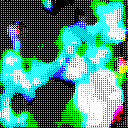


Epoch: 189
Batch 0 from 0 to 64
Gen loss: 2.5421143
Disc loss: 0.19560748
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


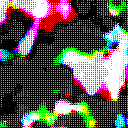

Batch 64 from 64 to 128
Gen loss: 2.3814907
Disc loss: 0.22275415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


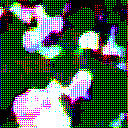

Batch 128 from 128 to 192
Gen loss: 2.2915266
Disc loss: 0.20765907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


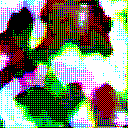

Batch 192 from 192 to 256
Gen loss: 2.2915654
Disc loss: 0.23535651
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


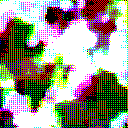

Batch 256 from 256 to 320
Gen loss: 2.4486089
Disc loss: 0.2002643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


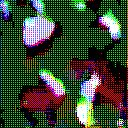

Batch 320 from 320 to 384
Gen loss: 2.5311036
Disc loss: 0.18213746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


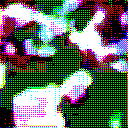

Batch 384 from 384 to 448
Gen loss: 2.5543404
Disc loss: 0.17477264
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


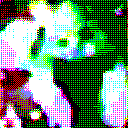

Batch 448 from 448 to 512
Gen loss: 2.5909395
Disc loss: 0.24575105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


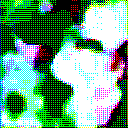

Batch 512 from 512 to 576
Gen loss: 2.6765864
Disc loss: 0.16770124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


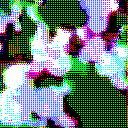

Batch 576 from 576 to 640
Gen loss: 2.3681657
Disc loss: 0.21518221
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


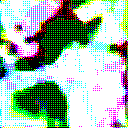


Epoch: 190
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.6547062
Disc loss: 0.18267724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


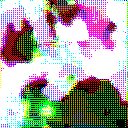

Batch 64 from 64 to 128
Gen loss: 2.57653
Disc loss: 0.19185519
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


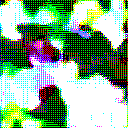

Batch 128 from 128 to 192
Gen loss: 2.7672505
Disc loss: 0.15944949
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


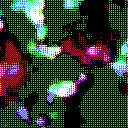

Batch 192 from 192 to 256
Gen loss: 2.6351423
Disc loss: 0.20463091
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


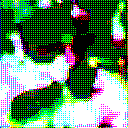

Batch 256 from 256 to 320
Gen loss: 2.6261888
Disc loss: 0.17955425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


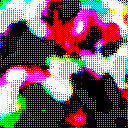

Batch 320 from 320 to 384
Gen loss: 2.4925303
Disc loss: 0.18429863
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


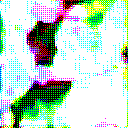

Batch 384 from 384 to 448
Gen loss: 2.6564534
Disc loss: 0.16717081
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


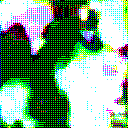

Batch 448 from 448 to 512
Gen loss: 2.6352234
Disc loss: 0.24224624
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


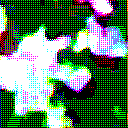

Batch 512 from 512 to 576
Gen loss: 2.5491931
Disc loss: 0.17525473
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


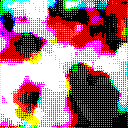

Batch 576 from 576 to 640
Gen loss: 2.426958
Disc loss: 0.21007657
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


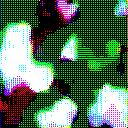


Epoch: 191
Batch 0 from 0 to 64
Gen loss: 2.5401266
Disc loss: 0.1917705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


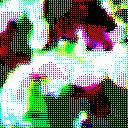

Batch 64 from 64 to 128
Gen loss: 2.6682806
Disc loss: 0.1832088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


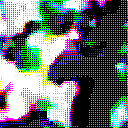

Batch 128 from 128 to 192
Gen loss: 2.4596293
Disc loss: 0.19261298
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


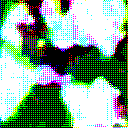

Batch 192 from 192 to 256
Gen loss: 2.3964205
Disc loss: 0.23052937
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


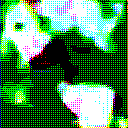

Batch 256 from 256 to 320
Gen loss: 2.2739155
Disc loss: 0.22977182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


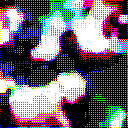

Batch 320 from 320 to 384
Gen loss: 2.6595168
Disc loss: 0.16968226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


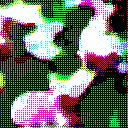

Batch 384 from 384 to 448
Gen loss: 2.4297428
Disc loss: 0.18388885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


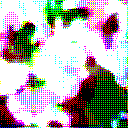

Batch 448 from 448 to 512
Gen loss: 2.423832
Disc loss: 0.2555882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


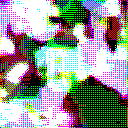

Batch 512 from 512 to 576
Gen loss: 2.419292
Disc loss: 0.18728942
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


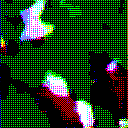

Batch 576 from 576 to 640
Gen loss: 2.3427887
Disc loss: 0.2160751
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


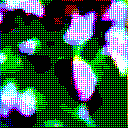


Epoch: 192
Batch 0 from 0 to 64
Gen loss: 2.5822706
Disc loss: 0.18519065
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


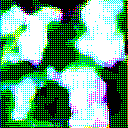

Batch 64 from 64 to 128
Gen loss: 2.4190931
Disc loss: 0.20870584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


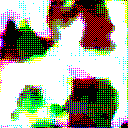

Batch 128 from 128 to 192
Gen loss: 2.4856734
Disc loss: 0.17953986
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


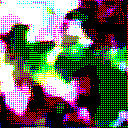

Batch 192 from 192 to 256
Gen loss: 2.4628606
Disc loss: 0.22147325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


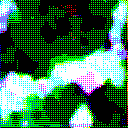

Batch 256 from 256 to 320
Gen loss: 2.2522311
Disc loss: 0.2190791
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


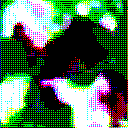

Batch 320 from 320 to 384
Gen loss: 2.4538987
Disc loss: 0.18592301
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


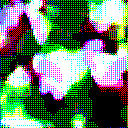

Batch 384 from 384 to 448
Gen loss: 2.8169484
Disc loss: 0.15308248
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


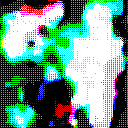

Batch 448 from 448 to 512
Gen loss: 2.6030223
Disc loss: 0.24069493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


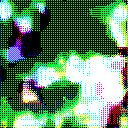

Batch 512 from 512 to 576
Gen loss: 2.72297
Disc loss: 0.16479875
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


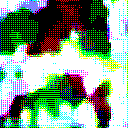

Batch 576 from 576 to 640
Gen loss: 2.5400429
Disc loss: 0.20376192
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


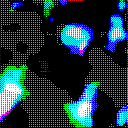


Epoch: 193
Batch 0 from 0 to 64
Gen loss: 2.5460892
Disc loss: 0.19701484
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


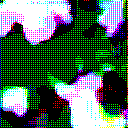

Batch 64 from 64 to 128
Gen loss: 2.414172
Disc loss: 0.21217209
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


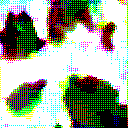

Batch 128 from 128 to 192
Gen loss: 2.5347607
Disc loss: 0.17267594
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


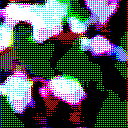

Batch 192 from 192 to 256
Gen loss: 2.42695
Disc loss: 0.21584818
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


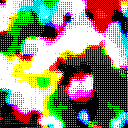

Batch 256 from 256 to 320
Gen loss: 2.3394363
Disc loss: 0.20497642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


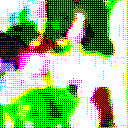

Batch 320 from 320 to 384
Gen loss: 2.685171
Disc loss: 0.16332316
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


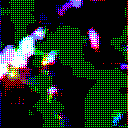

Batch 384 from 384 to 448
Gen loss: 2.5321088
Disc loss: 0.17241275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


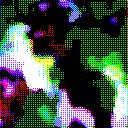

Batch 448 from 448 to 512
Gen loss: 2.470121
Disc loss: 0.24583317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


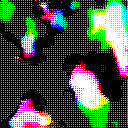

Batch 512 from 512 to 576
Gen loss: 2.547749
Disc loss: 0.17231083
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


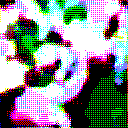

Batch 576 from 576 to 640
Gen loss: 2.6076953
Disc loss: 0.19216992
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


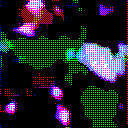


Epoch: 194
Batch 0 from 0 to 64
Gen loss: 2.6963995
Disc loss: 0.1773394
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


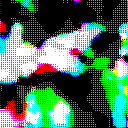

Batch 64 from 64 to 128
Gen loss: 2.511957
Disc loss: 0.19809294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


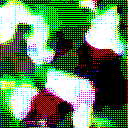

Batch 128 from 128 to 192
Gen loss: 2.447431
Disc loss: 0.19033723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


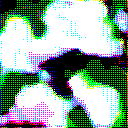

Batch 192 from 192 to 256
Gen loss: 2.7516532
Disc loss: 0.18501455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


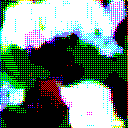

Batch 256 from 256 to 320
Gen loss: 2.4586549
Disc loss: 0.18773814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


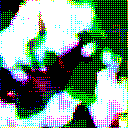

Batch 320 from 320 to 384
Gen loss: 2.4761326
Disc loss: 0.17808333
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


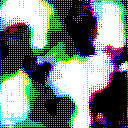

Batch 384 from 384 to 448
Gen loss: 2.470332
Disc loss: 0.17583525
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


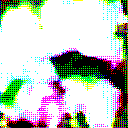

Batch 448 from 448 to 512
Gen loss: 2.7897427
Disc loss: 0.22259945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


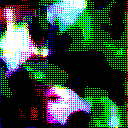

Batch 512 from 512 to 576
Gen loss: 2.8108835
Disc loss: 0.1488011
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


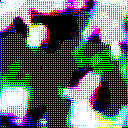

Batch 576 from 576 to 640
Gen loss: 2.2873883
Disc loss: 0.21968311
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


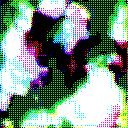


Epoch: 195
Batch 0 from 0 to 64
Gen loss: 2.5966723
Disc loss: 0.18590626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


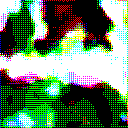

Batch 64 from 64 to 128
Gen loss: 2.7045152
Disc loss: 0.18092765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


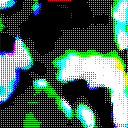

Batch 128 from 128 to 192
Gen loss: 2.6305847
Disc loss: 0.16270751
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


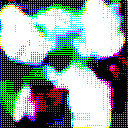

Batch 192 from 192 to 256
Gen loss: 2.728228
Disc loss: 0.18497282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


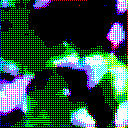

Batch 256 from 256 to 320
Gen loss: 2.4058976
Disc loss: 0.20110062
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


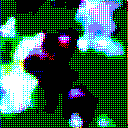

Batch 320 from 320 to 384
Gen loss: 2.4836235
Disc loss: 0.17835163
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


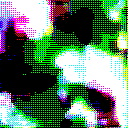

Batch 384 from 384 to 448
Gen loss: 2.5248985
Disc loss: 0.17269163
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


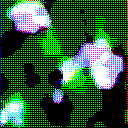

Batch 448 from 448 to 512
Gen loss: 2.697475
Disc loss: 0.22301291
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


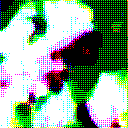

Batch 512 from 512 to 576
Gen loss: 2.702871
Disc loss: 0.16236626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


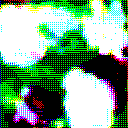

Batch 576 from 576 to 640
Gen loss: 2.3521385
Disc loss: 0.21008286
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


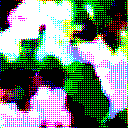


Epoch: 196
Batch 0 from 0 to 64
Gen loss: 2.5013003
Disc loss: 0.18828857
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


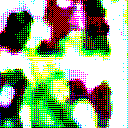

Batch 64 from 64 to 128
Gen loss: 2.515182
Disc loss: 0.19364977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


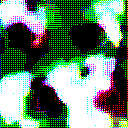

Batch 128 from 128 to 192
Gen loss: 2.4600027
Disc loss: 0.17723092
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


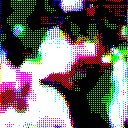

Batch 192 from 192 to 256
Gen loss: 2.3924837
Disc loss: 0.22594847
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


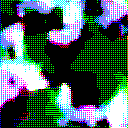

Batch 256 from 256 to 320
Gen loss: 2.6195297
Disc loss: 0.17244306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


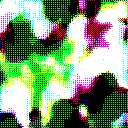

Batch 320 from 320 to 384
Gen loss: 2.5355334
Disc loss: 0.17519873
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


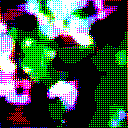

Batch 384 from 384 to 448
Gen loss: 2.5217063
Disc loss: 0.1749149
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


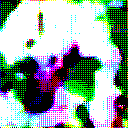

Batch 448 from 448 to 512
Gen loss: 2.4511497
Disc loss: 0.24266182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


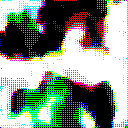

Batch 512 from 512 to 576
Gen loss: 2.4979057
Disc loss: 0.1749121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


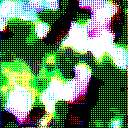

Batch 576 from 576 to 640
Gen loss: 2.4152784
Disc loss: 0.19643173
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


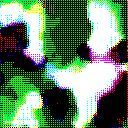


Epoch: 197
Batch 0 from 0 to 64
Gen loss: 2.6389194
Disc loss: 0.17923203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


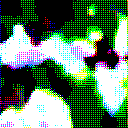

Batch 64 from 64 to 128
Gen loss: 2.5463185
Disc loss: 0.1876688
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


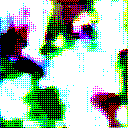

Batch 128 from 128 to 192
Gen loss: 2.5824513
Disc loss: 0.16550505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


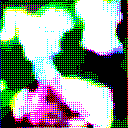

Batch 192 from 192 to 256
Gen loss: 2.6446524
Disc loss: 0.18852574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


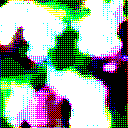

Batch 256 from 256 to 320
Gen loss: 2.7073495
Disc loss: 0.1634539
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


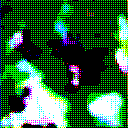

Batch 320 from 320 to 384
Gen loss: 2.4591398
Disc loss: 0.17888205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


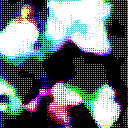

Batch 384 from 384 to 448
Gen loss: 2.6360254
Disc loss: 0.15660453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


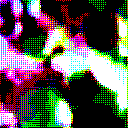

Batch 448 from 448 to 512
Gen loss: 2.6053762
Disc loss: 0.22053806
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


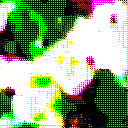

Batch 512 from 512 to 576
Gen loss: 2.8150535
Disc loss: 0.14913711
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


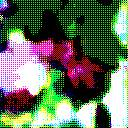

Batch 576 from 576 to 640
Gen loss: 2.693521
Disc loss: 0.18426535
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


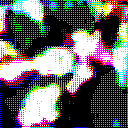


Epoch: 198
Batch 0 from 0 to 64
Gen loss: 2.8291302
Disc loss: 0.15774827
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


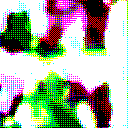

Batch 64 from 64 to 128
Gen loss: 2.8586144
Disc loss: 0.1588073
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


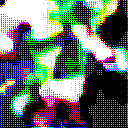

Batch 128 from 128 to 192
Gen loss: 2.7210405
Disc loss: 0.15345941
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


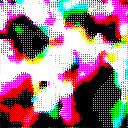

Batch 192 from 192 to 256
Gen loss: 2.6881642
Disc loss: 0.18193106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


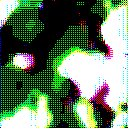

Batch 256 from 256 to 320
Gen loss: 2.7173247
Disc loss: 0.1624887
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


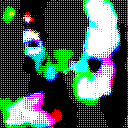

Batch 320 from 320 to 384
Gen loss: 2.5779617
Disc loss: 0.1660296
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


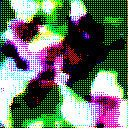

Batch 384 from 384 to 448
Gen loss: 2.7339282
Disc loss: 0.14950508
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


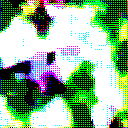

Batch 448 from 448 to 512
Gen loss: 2.4950106
Disc loss: 0.23606879
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


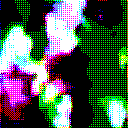

Batch 512 from 512 to 576
Gen loss: 2.697957
Disc loss: 0.15251613
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


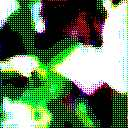

Batch 576 from 576 to 640
Gen loss: 2.4953532
Disc loss: 0.18987992
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


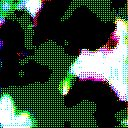


Epoch: 199
Batch 0 from 0 to 64
Gen loss: 2.6678302
Disc loss: 0.1669879
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


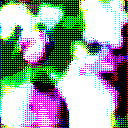

Batch 64 from 64 to 128
Gen loss: 2.7170048
Disc loss: 0.16451976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


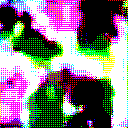

Batch 128 from 128 to 192
Gen loss: 2.6830096
Disc loss: 0.15403685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


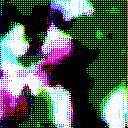

Batch 192 from 192 to 256
Gen loss: 2.802608
Disc loss: 0.17262569
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


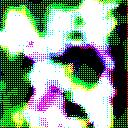

Batch 256 from 256 to 320
Gen loss: 2.6170776
Disc loss: 0.16688427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


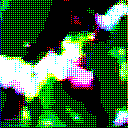

Batch 320 from 320 to 384
Gen loss: 2.5156145
Disc loss: 0.17007619
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.6352222
Disc loss: 0.1555083
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7767053
Disc loss: 0.20657921
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.4821749
Disc loss: 0.17176956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7723808
Disc loss: 0.16154864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 200
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.651787
Disc loss: 0.16542815
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.579444
Disc loss: 0.17400205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.6596036
Disc loss: 0.15304056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8289094
Disc loss: 0.16933021
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.4939215
Disc loss: 0.18076989
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.299009
Disc loss: 0.20280853
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.5858998
Disc loss: 0.16023155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.6431172
Disc loss: 0.2199979
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.705335
Disc loss: 0.15752769
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.6222858
Disc loss: 0.19191805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 201
Batch 0 from 0 to 64
Gen loss: 2.6150727
Disc loss: 0.17431962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.4720495
Disc loss: 0.18905282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.4340968
Disc loss: 0.17577091
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6921394
Disc loss: 0.18084273
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.653667
Disc loss: 0.16577508
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.5596194
Disc loss: 0.17104042
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.580764
Disc loss: 0.16296464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.6692288
Disc loss: 0.21921296
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.5666134
Disc loss: 0.1649918
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.1991577
Disc loss: 0.22357275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 202
Batch 0 from 0 to 64
Gen loss: 2.756988
Disc loss: 0.16192561
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.6296062
Disc loss: 0.17653151
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.408276
Disc loss: 0.18079123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7069516
Disc loss: 0.18020701
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.6248934
Disc loss: 0.16484849
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.6250372
Disc loss: 0.15958536
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.7043905
Disc loss: 0.14991769
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.628049
Disc loss: 0.22204329
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6788135
Disc loss: 0.15438901
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.2728875
Disc loss: 0.2173953
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 203
Batch 0 from 0 to 64
Gen loss: 2.5654287
Disc loss: 0.18029779
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.5125306
Disc loss: 0.18851614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.74798
Disc loss: 0.1482034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6052768
Disc loss: 0.19098888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.718162
Disc loss: 0.15715978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.486311
Disc loss: 0.17077962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.535175
Disc loss: 0.16417372
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.6060858
Disc loss: 0.22517923
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.5815215
Disc loss: 0.16022335
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.5135548
Disc loss: 0.17490968
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 204
Batch 0 from 0 to 64
Gen loss: 2.4505591
Disc loss: 0.1873758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.6728873
Disc loss: 0.17034784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.5516906
Disc loss: 0.15985611
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.4322023
Disc loss: 0.20117852
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.4816113
Disc loss: 0.17640491
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.3311865
Disc loss: 0.18896645
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.6411598
Disc loss: 0.1612038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.5083537
Disc loss: 0.22311291
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6960366
Disc loss: 0.1481768
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.793697
Disc loss: 0.15487066
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 205
Batch 0 from 0 to 64
Gen loss: 2.636231
Disc loss: 0.16773221
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.5618901
Disc loss: 0.1790776
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.633229
Disc loss: 0.15421076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.5166054
Disc loss: 0.19165543
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.6482055
Disc loss: 0.16175616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8087485
Disc loss: 0.14124064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.4977064
Disc loss: 0.16985385
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7108474
Disc loss: 0.20676425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.7123432
Disc loss: 0.14867625
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7249904
Disc loss: 0.15815277
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 206
Batch 0 from 0 to 64
Gen loss: 2.5541363
Disc loss: 0.1700355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.567072
Disc loss: 0.17710066
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.555121
Disc loss: 0.16175371
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6631303
Disc loss: 0.18106912
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.6953316
Disc loss: 0.16020718
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.476427
Disc loss: 0.17472059
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.6217818
Disc loss: 0.15667872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.5726361
Disc loss: 0.22163428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6848748
Disc loss: 0.15194274
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.476303
Disc loss: 0.18189174
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 207
Batch 0 from 0 to 64
Gen loss: 2.7555075
Disc loss: 0.15511642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8168051
Disc loss: 0.15245458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.7442713
Disc loss: 0.14476165
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7300642
Disc loss: 0.17490542
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.3703694
Disc loss: 0.19244811
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.7874393
Disc loss: 0.1438643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8324285
Disc loss: 0.13836218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.6516464
Disc loss: 0.20937614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.5669894
Disc loss: 0.16532114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8218617
Disc loss: 0.14835933
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 208
Batch 0 from 0 to 64
Gen loss: 2.5815542
Disc loss: 0.16615596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8323846
Disc loss: 0.14898677
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.7649188
Disc loss: 0.13992909
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7034473
Disc loss: 0.17303135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.5500832
Disc loss: 0.16956472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0616622
Disc loss: 0.123083256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.780113
Disc loss: 0.13897124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.791575
Disc loss: 0.19713722
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.5840797
Disc loss: 0.15639833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7045393
Disc loss: 0.15432292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 209
Batch 0 from 0 to 64
Gen loss: 2.5707023
Disc loss: 0.16813317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.652325
Disc loss: 0.16395226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.6140685
Disc loss: 0.15414158
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.585144
Disc loss: 0.18365344
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9443393
Disc loss: 0.13695033
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.6148348
Disc loss: 0.15416487
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.681404
Disc loss: 0.1436482
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.6426766
Disc loss: 0.20809132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6527338
Disc loss: 0.15163976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.892288
Disc loss: 0.1419551
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 210
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.850251
Disc loss: 0.14376125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.855144
Disc loss: 0.14508735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.764123
Disc loss: 0.1385616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6514235
Disc loss: 0.17873308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8213828
Disc loss: 0.14283985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.77441
Disc loss: 0.14229211
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.539609
Disc loss: 0.16022912
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.657297
Disc loss: 0.20101634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.746252
Disc loss: 0.14333943
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.4490128
Disc loss: 0.18236245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 211
Batch 0 from 0 to 64
Gen loss: 2.7262495
Disc loss: 0.15318027
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9288573
Disc loss: 0.14458424
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.772987
Disc loss: 0.14178506
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6522222
Disc loss: 0.17603418
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8122706
Disc loss: 0.14859425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8317266
Disc loss: 0.14268509
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.7198455
Disc loss: 0.14133157
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.2660234
Disc loss: 0.25545162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9440892
Disc loss: 0.12900491
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.5429738
Disc loss: 0.17476723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 212
Batch 0 from 0 to 64
Gen loss: 2.9380362
Disc loss: 0.13931698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.904293
Disc loss: 0.14464527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.682125
Disc loss: 0.14779039
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8423018
Disc loss: 0.16095163
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8037558
Disc loss: 0.14721227
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.5898423
Disc loss: 0.15390551
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.773983
Disc loss: 0.1404749
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.8002605
Disc loss: 0.19836058
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8409758
Disc loss: 0.13452925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8163447
Disc loss: 0.15140061
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 213
Batch 0 from 0 to 64
Gen loss: 2.7762785
Disc loss: 0.14739272
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.7966726
Disc loss: 0.15189615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.7740054
Disc loss: 0.1378144
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.822703
Disc loss: 0.16111413
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.6878452
Disc loss: 0.15235198
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8096452
Disc loss: 0.13558294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8688636
Disc loss: 0.12880796
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.6356807
Disc loss: 0.20653109
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8958142
Disc loss: 0.13041282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.5981526
Disc loss: 0.16564873
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 214
Batch 0 from 0 to 64
Gen loss: 2.432732
Disc loss: 0.17761365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.7589555
Disc loss: 0.15541065
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.837726
Disc loss: 0.13613029
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.5391536
Disc loss: 0.1846288
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7662454
Disc loss: 0.14504975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8877683
Disc loss: 0.13265605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8253322
Disc loss: 0.13203597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.679565
Disc loss: 0.20257628
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6664958
Disc loss: 0.14500454
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.606013
Disc loss: 0.16153811
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 215
Batch 0 from 0 to 64
Gen loss: 2.9577923
Disc loss: 0.13388443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.755293
Disc loss: 0.15339713
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.6504698
Disc loss: 0.14723875
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7739139
Disc loss: 0.1626117
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.927979
Disc loss: 0.13660046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8125966
Disc loss: 0.13568084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.566481
Disc loss: 0.1533399
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7095127
Disc loss: 0.20080996
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.810706
Disc loss: 0.13398483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.858369
Disc loss: 0.1452944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 216
Batch 0 from 0 to 64
Gen loss: 2.770657
Disc loss: 0.1484757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8731937
Disc loss: 0.148936
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.900145
Disc loss: 0.12805045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8691995
Disc loss: 0.15834701
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7985733
Disc loss: 0.14129302
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8037915
Disc loss: 0.13279536
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.7990494
Disc loss: 0.131851
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.5888925
Disc loss: 0.21397951
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6660664
Disc loss: 0.14803168
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7513816
Disc loss: 0.14912347
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 217
Batch 0 from 0 to 64
Gen loss: 2.85582
Disc loss: 0.14491254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8776917
Disc loss: 0.14292066
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.6558228
Disc loss: 0.14314777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0670552
Disc loss: 0.14335433
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7752223
Disc loss: 0.14517921
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8893166
Disc loss: 0.13034174
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9350467
Disc loss: 0.12733182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.924768
Disc loss: 0.19388908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6215484
Disc loss: 0.1497187
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.6634185
Disc loss: 0.15826218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 218
Batch 0 from 0 to 64
Gen loss: 3.1025946
Disc loss: 0.13350466
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.843548
Disc loss: 0.15702546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.7006772
Disc loss: 0.15154871
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7196746
Disc loss: 0.17476183
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9254155
Disc loss: 0.1390905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9154565
Disc loss: 0.13086244
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.752196
Disc loss: 0.14424264
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9283729
Disc loss: 0.20408103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.7160153
Disc loss: 0.14633381
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.927971
Disc loss: 0.1473855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 219
Batch 0 from 0 to 64
Gen loss: 2.8706613
Disc loss: 0.1537236
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 64 from 64 to 128
Gen loss: 2.8533196
Disc loss: 0.14872396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8196502
Disc loss: 0.13737002
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8605058
Disc loss: 0.16947673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8192487
Disc loss: 0.1436739
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8734946
Disc loss: 0.13190834
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.595121
Disc loss: 0.15089715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.8492274
Disc loss: 0.18857569
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9188414
Disc loss: 0.124917224
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7283428
Disc loss: 0.15187824
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 220
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.7362337
Disc loss: 0.15765673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.7159133
Disc loss: 0.15394484
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.019949
Disc loss: 0.1228212
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.837338
Disc loss: 0.16254088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7075102
Disc loss: 0.14872044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.7026358
Disc loss: 0.13987705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.700307
Disc loss: 0.14002232
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.734539
Disc loss: 0.1941359
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8411524
Disc loss: 0.12926248
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.726898
Disc loss: 0.15251127
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 221
Batch 0 from 0 to 64
Gen loss: 2.6951032
Disc loss: 0.15758523
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.7295544
Disc loss: 0.1550807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9103715
Disc loss: 0.122398816
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6225805
Disc loss: 0.17485005
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7647943
Disc loss: 0.13956167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.6651711
Disc loss: 0.15399715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.6922078
Disc loss: 0.13787442
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7251837
Disc loss: 0.19467211
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6781268
Disc loss: 0.1439663
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7450056
Disc loss: 0.15651152
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 222
Batch 0 from 0 to 64
Gen loss: 2.8574455
Disc loss: 0.14153132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8536298
Disc loss: 0.14570045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8177285
Disc loss: 0.13091643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9599621
Disc loss: 0.14570391
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.744267
Disc loss: 0.14251779
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.5425963
Disc loss: 0.15745991
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.866547
Disc loss: 0.12477994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.4728203
Disc loss: 0.21773377
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.7188458
Disc loss: 0.13575175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.574737
Disc loss: 0.16543493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 223
Batch 0 from 0 to 64
Gen loss: 2.8500009
Disc loss: 0.14120394
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.6861885
Disc loss: 0.1540578
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9410684
Disc loss: 0.12443967
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7536368
Disc loss: 0.16416764
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7702518
Disc loss: 0.14288786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9503431
Disc loss: 0.121288
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.7705846
Disc loss: 0.13097054
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.8249135
Disc loss: 0.18310592
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.5985875
Disc loss: 0.15042421
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.233381
Disc loss: 0.21698058
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 224
Batch 0 from 0 to 64
Gen loss: 2.751608
Disc loss: 0.14284608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8657656
Disc loss: 0.13567226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.7590132
Disc loss: 0.1367107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8981168
Disc loss: 0.14832869
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7151747
Disc loss: 0.14852521
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.6595974
Disc loss: 0.15108591
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8869097
Disc loss: 0.12454039
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7424536
Disc loss: 0.18726683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8687987
Disc loss: 0.12544802
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.6481311
Disc loss: 0.15755114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 225
Batch 0 from 0 to 64
Gen loss: 2.8942761
Disc loss: 0.13069932
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8419971
Disc loss: 0.13678569
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.74408
Disc loss: 0.13214396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8215342
Disc loss: 0.15301043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7738338
Disc loss: 0.14221461
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.581608
Disc loss: 0.14777307
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8992047
Disc loss: 0.122535564
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.743811
Disc loss: 0.18792333
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.799426
Disc loss: 0.13248396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7430415
Disc loss: 0.14383212
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 226
Batch 0 from 0 to 64
Gen loss: 2.8558698
Disc loss: 0.13737321
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.913879
Disc loss: 0.1318325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8558378
Disc loss: 0.12682246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8096995
Disc loss: 0.15398699
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7345376
Disc loss: 0.13986355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8589337
Disc loss: 0.12488773
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9405928
Disc loss: 0.11788359
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9268754
Disc loss: 0.1707842
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9617252
Disc loss: 0.12034555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7382927
Disc loss: 0.14475906
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 227
Batch 0 from 0 to 64
Gen loss: 2.770617
Disc loss: 0.13672896
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.767734
Disc loss: 0.14044446
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9786978
Disc loss: 0.114401475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6862445
Disc loss: 0.16244188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8120384
Disc loss: 0.13644177
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.908062
Disc loss: 0.12113574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.876832
Disc loss: 0.12384867
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9811475
Disc loss: 0.16816162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.7995095
Disc loss: 0.1313328
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.5652416
Disc loss: 0.15943864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 228
Batch 0 from 0 to 64
Gen loss: 2.8430886
Disc loss: 0.13347696
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8052802
Disc loss: 0.13794702
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.888911
Disc loss: 0.1236784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7321646
Disc loss: 0.15878202
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.870881
Disc loss: 0.12970233
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.6704545
Disc loss: 0.1416351
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.6533086
Disc loss: 0.13662173
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.8182747
Disc loss: 0.17605391
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.7652955
Disc loss: 0.13208762
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7195985
Disc loss: 0.15881719
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 229
Batch 0 from 0 to 64
Gen loss: 2.639926
Disc loss: 0.1465606
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8372004
Disc loss: 0.14144589
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.7274866
Disc loss: 0.1338593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6938376
Disc loss: 0.1607739
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7503808
Disc loss: 0.13556322
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0655372
Disc loss: 0.1111151
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8276846
Disc loss: 0.12279308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7904048
Disc loss: 0.18093084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8919263
Disc loss: 0.1220932
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9366333
Disc loss: 0.13518333
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 230
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.6663837
Disc loss: 0.14835256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9727318
Disc loss: 0.12971717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9618168
Disc loss: 0.12135001
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7189078
Disc loss: 0.15974665
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9575357
Disc loss: 0.12589848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0342188
Disc loss: 0.11414608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.947059
Disc loss: 0.11825022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9568017
Disc loss: 0.17370036
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8526542
Disc loss: 0.12483061
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.6822457
Disc loss: 0.1476228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 231
Batch 0 from 0 to 64
Gen loss: 2.717174
Disc loss: 0.14282092
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.6927526
Disc loss: 0.14989737
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.0632563
Disc loss: 0.113137335
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0622249
Disc loss: 0.13873681
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0284586
Disc loss: 0.12596567
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.993268
Disc loss: 0.11706424
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8070552
Disc loss: 0.12838668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9128022
Disc loss: 0.1773753
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8642077
Disc loss: 0.12910855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.6922321
Disc loss: 0.15170497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 232
Batch 0 from 0 to 64
Gen loss: 2.9624653
Disc loss: 0.12752911
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0041327
Disc loss: 0.12991855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.1519141
Disc loss: 0.106734425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.952852
Disc loss: 0.14521506
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.017793
Disc loss: 0.12688383
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9215117
Disc loss: 0.12097521
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.0487514
Disc loss: 0.110190794
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.0161092
Disc loss: 0.16980895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9241319
Disc loss: 0.121861875
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8850503
Disc loss: 0.13161762
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 233
Batch 0 from 0 to 64
Gen loss: 2.7015333
Disc loss: 0.14301631
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.880491
Disc loss: 0.1346087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.7955954
Disc loss: 0.12998484
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8699381
Disc loss: 0.14596348
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.86965
Disc loss: 0.12956363
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8541958
Disc loss: 0.12460527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9162178
Disc loss: 0.120036826
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9848504
Disc loss: 0.17519552
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.1279373
Disc loss: 0.11072936
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.846992
Disc loss: 0.13880844
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 234
Batch 0 from 0 to 64
Gen loss: 2.6878245
Disc loss: 0.14571685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.7416453
Disc loss: 0.14536613
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8850536
Disc loss: 0.121421486
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7189312
Disc loss: 0.1607203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9697232
Disc loss: 0.124494284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0989265
Disc loss: 0.11112754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.12413
Disc loss: 0.10497765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7817106
Disc loss: 0.18361033
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9817228
Disc loss: 0.11453664
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8360565
Disc loss: 0.13543706
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 235
Batch 0 from 0 to 64
Gen loss: 3.065452
Disc loss: 0.11785017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.003433
Disc loss: 0.1230084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9575095
Disc loss: 0.1146507
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8388114
Disc loss: 0.14954561
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.2344143
Disc loss: 0.10972885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.1154108
Disc loss: 0.10672121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9764104
Disc loss: 0.113044724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9035063
Disc loss: 0.17083403
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.896027
Disc loss: 0.11850348
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.691419
Disc loss: 0.14568979
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 236
Batch 0 from 0 to 64
Gen loss: 3.0148702
Disc loss: 0.11936709
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0588522
Disc loss: 0.124975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.14425
Disc loss: 0.109269336
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0426574
Disc loss: 0.13256744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8912156
Disc loss: 0.13188513
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0658653
Disc loss: 0.111403584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9266257
Disc loss: 0.11330258
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9412792
Disc loss: 0.16698866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.956103
Disc loss: 0.11406355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.131089
Disc loss: 0.11365497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 237
Batch 0 from 0 to 64
Gen loss: 2.8523648
Disc loss: 0.13110954
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9636898
Disc loss: 0.120562226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9426355
Disc loss: 0.11231436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9937027
Disc loss: 0.14043659
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8419085
Disc loss: 0.1285527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0319471
Disc loss: 0.10904005
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.207545
Disc loss: 0.09758965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7599947
Disc loss: 0.17927358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.0594041
Disc loss: 0.10791205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8621776
Disc loss: 0.12795985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 238
Batch 0 from 0 to 64
Gen loss: 3.0229948
Disc loss: 0.11543223
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1150913
Disc loss: 0.1128429
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.898748
Disc loss: 0.11650208
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8553197
Disc loss: 0.1392493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.018406
Disc loss: 0.11355458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.009986
Disc loss: 0.10838744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.070125
Disc loss: 0.10600092
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1346772
Disc loss: 0.14780338
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8473337
Disc loss: 0.11842481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8935258
Disc loss: 0.124032244
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 239
Batch 0 from 0 to 64
Gen loss: 3.228259
Disc loss: 0.10355699
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1525826
Disc loss: 0.11172189
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.06962
Disc loss: 0.103358254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1800137
Disc loss: 0.12499283
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9286952
Disc loss: 0.11823501
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0556107
Disc loss: 0.10458122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1479907
Disc loss: 0.0990112
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.2239773
Disc loss: 0.14300953
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2621808
Disc loss: 0.09684639
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9364254
Disc loss: 0.124427766
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 240
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.8405006
Disc loss: 0.122835286
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1643717
Disc loss: 0.10913451
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.0771835
Disc loss: 0.10111392
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9944925
Disc loss: 0.12863776
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0032287
Disc loss: 0.119566485
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2422729
Disc loss: 0.094606444
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2494717
Disc loss: 0.09394923
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.984856
Disc loss: 0.15379186
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9732413
Disc loss: 0.11081573
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7582324
Disc loss: 0.14128122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 241
Batch 0 from 0 to 64
Gen loss: 3.0793009
Disc loss: 0.11139177
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2300072
Disc loss: 0.106530435
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.034831
Disc loss: 0.106800556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2736783
Disc loss: 0.11725088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1800067
Disc loss: 0.104846805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2374134
Disc loss: 0.09558497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3147745
Disc loss: 0.09144679
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.0781832
Disc loss: 0.14726579
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8330684
Disc loss: 0.12067909
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8204188
Disc loss: 0.13115463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 242
Batch 0 from 0 to 64
Gen loss: 2.8028102
Disc loss: 0.12726572
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3768907
Disc loss: 0.098180465
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.726277
Disc loss: 0.12301647
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0785935
Disc loss: 0.124760725
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.121647
Disc loss: 0.10883021
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.1888752
Disc loss: 0.096059196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9648395
Disc loss: 0.106243074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1716452
Disc loss: 0.14174129
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.0720997
Disc loss: 0.10536125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.5315888
Disc loss: 0.1470965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 243
Batch 0 from 0 to 64
Gen loss: 3.0614924
Disc loss: 0.111543916
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1646438
Disc loss: 0.10869801
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.234425
Disc loss: 0.093539014
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.03199
Disc loss: 0.12440565
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.856522
Disc loss: 0.12365174
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9709525
Disc loss: 0.109004885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8084927
Disc loss: 0.1198497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9376016
Disc loss: 0.16980842
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.0051541
Disc loss: 0.10560713
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.6925817
Disc loss: 0.14357933
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 244
Batch 0 from 0 to 64
Gen loss: 2.8584414
Disc loss: 0.12671226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1671352
Disc loss: 0.11780329
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9459522
Disc loss: 0.113285355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.97468
Disc loss: 0.13247848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1366992
Disc loss: 0.10759443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0923629
Disc loss: 0.10506644
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.0499942
Disc loss: 0.10263491
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9768019
Disc loss: 0.16079873
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.5991392
Disc loss: 0.14793956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2833378
Disc loss: 0.10426844
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 245
Batch 0 from 0 to 64
Gen loss: 3.128051
Disc loss: 0.112313904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0775113
Disc loss: 0.11580325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.956147
Disc loss: 0.11342701
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6906395
Disc loss: 0.160155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.640241
Disc loss: 0.14270721
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0445046
Disc loss: 0.10840505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.885785
Disc loss: 0.11676298
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.7910342
Disc loss: 0.1774222
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8244915
Disc loss: 0.123134255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.455433
Disc loss: 0.16811538
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 246
Batch 0 from 0 to 64
Gen loss: 3.0573196
Disc loss: 0.11271565
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8491287
Disc loss: 0.12914856
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.0601695
Disc loss: 0.10357353
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9975111
Disc loss: 0.13096023
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7870436
Disc loss: 0.13708635
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8392634
Disc loss: 0.1202562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.988605
Disc loss: 0.112668514
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1387777
Disc loss: 0.15565477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.873436
Disc loss: 0.11632685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.939775
Disc loss: 0.12245832
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 247
Batch 0 from 0 to 64
Gen loss: 2.7922084
Disc loss: 0.12794927
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.783659
Disc loss: 0.13047168
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8673332
Disc loss: 0.12117522
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7910337
Disc loss: 0.14495921
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1002986
Disc loss: 0.11078973
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9584508
Disc loss: 0.11596817
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2650306
Disc loss: 0.09652405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1278117
Disc loss: 0.1649398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.816635
Disc loss: 0.12632951
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8081312
Disc loss: 0.13205601
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 248
Batch 0 from 0 to 64
Gen loss: 3.2071676
Disc loss: 0.11083882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1946266
Disc loss: 0.11253509
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9065554
Disc loss: 0.123773724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9476626
Disc loss: 0.1333648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0107853
Disc loss: 0.112090364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2823186
Disc loss: 0.09413497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1966248
Disc loss: 0.09921688
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9741495
Disc loss: 0.17376779
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 512 from 512 to 576
Gen loss: 3.027749
Disc loss: 0.10900401
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9448652
Disc loss: 0.1269704
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 249
Batch 0 from 0 to 64
Gen loss: 2.752925
Disc loss: 0.14638928
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9738655
Disc loss: 0.13597266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2729406
Disc loss: 0.09473941
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0662203
Disc loss: 0.13104242
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8187165
Disc loss: 0.13538776
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9975696
Disc loss: 0.11087934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.098684
Disc loss: 0.10652164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.8029811
Disc loss: 0.18036635
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.6604748
Disc loss: 0.13305768
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8202531
Disc loss: 0.13614537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 250
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.8545291
Disc loss: 0.12699836
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.5886836
Disc loss: 0.1563408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8974428
Disc loss: 0.116969824
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.6382723
Disc loss: 0.16783944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.821865
Disc loss: 0.12716658
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0564747
Disc loss: 0.107821405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9024146
Disc loss: 0.1128896
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9905572
Disc loss: 0.1632142
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8411548
Disc loss: 0.12147438
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9646056
Disc loss: 0.12173068
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 251
Batch 0 from 0 to 64
Gen loss: 3.178749
Disc loss: 0.11302039
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0608218
Disc loss: 0.11839026
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9683945
Disc loss: 0.11110687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9253454
Disc loss: 0.13850217
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0148401
Disc loss: 0.11570986
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8331802
Disc loss: 0.12178789
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9354064
Disc loss: 0.11254276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.811351
Disc loss: 0.1751337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8710654
Disc loss: 0.11847765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7531388
Disc loss: 0.13816735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 252
Batch 0 from 0 to 64
Gen loss: 2.9711797
Disc loss: 0.11860992
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0374808
Disc loss: 0.11281836
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8781996
Disc loss: 0.11771642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9886317
Disc loss: 0.13022037
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8578043
Disc loss: 0.123251945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.080495
Disc loss: 0.10365285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8861709
Disc loss: 0.115435556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.8358893
Disc loss: 0.1680134
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.8966575
Disc loss: 0.11159131
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.6974072
Disc loss: 0.14018929
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 253
Batch 0 from 0 to 64
Gen loss: 2.767002
Disc loss: 0.13287558
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9482875
Disc loss: 0.12151779
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.0333624
Disc loss: 0.106259935
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8888602
Disc loss: 0.13354982
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0979676
Disc loss: 0.10682076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.99115
Disc loss: 0.10712962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.123814
Disc loss: 0.09966661
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9677224
Disc loss: 0.16669649
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9677417
Disc loss: 0.10810657
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9207072
Disc loss: 0.12192798
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 254
Batch 0 from 0 to 64
Gen loss: 3.1440225
Disc loss: 0.10508891
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0382776
Disc loss: 0.11562216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.7229037
Disc loss: 0.12648697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.097138
Disc loss: 0.12618527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0634604
Disc loss: 0.10770463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.1384306
Disc loss: 0.09656864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1072645
Disc loss: 0.098637104
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.0635197
Disc loss: 0.14466074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.266831
Disc loss: 0.09499682
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.156903
Disc loss: 0.106977805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 255
Batch 0 from 0 to 64
Gen loss: 2.9623551
Disc loss: 0.11719161
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1864204
Disc loss: 0.103532374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.0502253
Disc loss: 0.10296587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1901038
Disc loss: 0.11709514
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.2027283
Disc loss: 0.099087134
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.1787212
Disc loss: 0.09578828
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2363167
Disc loss: 0.09266263
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.04596
Disc loss: 0.14483951
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.0332108
Disc loss: 0.10441822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9543457
Disc loss: 0.11682603
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 256
Batch 0 from 0 to 64
Gen loss: 3.0190659
Disc loss: 0.110648125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.97334
Disc loss: 0.115778446
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9371877
Disc loss: 0.11036527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9304574
Disc loss: 0.12598276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9964461
Disc loss: 0.11157943
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0627801
Disc loss: 0.102201
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1292136
Disc loss: 0.09691201
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.844778
Disc loss: 0.15964633
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9628627
Disc loss: 0.11228852
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.0366087
Disc loss: 0.11352101
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 257
Batch 0 from 0 to 64
Gen loss: 2.8113737
Disc loss: 0.12697735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.7911289
Disc loss: 0.13374999
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8605428
Disc loss: 0.11162588
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8719797
Disc loss: 0.13104121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9608927
Disc loss: 0.11373275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9952478
Disc loss: 0.1061798
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.0928073
Disc loss: 0.100569434
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3723369
Disc loss: 0.13276675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9514658
Disc loss: 0.11101721
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.0345957
Disc loss: 0.11402643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 258
Batch 0 from 0 to 64
Gen loss: 2.7814298
Disc loss: 0.13276531
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2771845
Disc loss: 0.100647256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9641259
Disc loss: 0.10656033
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.9146223
Disc loss: 0.13844061
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9045897
Disc loss: 0.12814036
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.939743
Disc loss: 0.11074962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.833268
Disc loss: 0.11106658
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9867473
Disc loss: 0.14847213
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.0350206
Disc loss: 0.10404484
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.7905476
Disc loss: 0.1291667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 259
Batch 0 from 0 to 64
Gen loss: 2.7667978
Disc loss: 0.13300923
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.706077
Disc loss: 0.13747483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.1754954
Disc loss: 0.10398013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.5746183
Disc loss: 0.1661306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9697323
Disc loss: 0.12041623
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8597174
Disc loss: 0.12206053
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.894128
Disc loss: 0.110309094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.8477883
Disc loss: 0.16141158
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.1674929
Disc loss: 0.098571554
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9629588
Disc loss: 0.121214576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 260
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 2.9242396
Disc loss: 0.12170417
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.949088
Disc loss: 0.1194175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.8346255
Disc loss: 0.1262918
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0857675
Disc loss: 0.12199593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.7659392
Disc loss: 0.14061227
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.003791
Disc loss: 0.10694369
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.8775387
Disc loss: 0.121766225
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.891026
Disc loss: 0.17301717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9571338
Disc loss: 0.10938643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.743295
Disc loss: 0.15282741
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 261
Batch 0 from 0 to 64
Gen loss: 3.0345306
Disc loss: 0.11695017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2253063
Disc loss: 0.105643354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.211459
Disc loss: 0.095253706
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0020428
Disc loss: 0.13158426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1199932
Disc loss: 0.11144912
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.1818452
Disc loss: 0.09923643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.168275
Disc loss: 0.10121389
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.192064
Disc loss: 0.15036353
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2719688
Disc loss: 0.10117527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3412263
Disc loss: 0.106577106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 262
Batch 0 from 0 to 64
Gen loss: 3.3413873
Disc loss: 0.099747345
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2938182
Disc loss: 0.107960865
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4474254
Disc loss: 0.08448089
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.415158
Disc loss: 0.105346344
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1516976
Disc loss: 0.10975883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.470533
Disc loss: 0.08711426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.330268
Disc loss: 0.08861904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.474739
Disc loss: 0.12879005
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4254541
Disc loss: 0.086191595
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9855075
Disc loss: 0.12139496
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 263
Batch 0 from 0 to 64
Gen loss: 3.3637433
Disc loss: 0.09685194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1358688
Disc loss: 0.10976608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.331058
Disc loss: 0.090059325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3533375
Disc loss: 0.107656285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.2668138
Disc loss: 0.09993486
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3981278
Disc loss: 0.08645002
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3206031
Disc loss: 0.087344304
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3782916
Disc loss: 0.1330052
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5721345
Disc loss: 0.08076734
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.489328
Disc loss: 0.09264542
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 264
Batch 0 from 0 to 64
Gen loss: 3.2869525
Disc loss: 0.09753732
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4006138
Disc loss: 0.09565436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3954678
Disc loss: 0.08720082
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3302417
Disc loss: 0.10680835
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.44235
Disc loss: 0.08854324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2331982
Disc loss: 0.09076606
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.0249112
Disc loss: 0.10395848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3486104
Disc loss: 0.13006848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.371408
Disc loss: 0.08632289
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2079153
Disc loss: 0.10193495
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 265
Batch 0 from 0 to 64
Gen loss: 3.127049
Disc loss: 0.10632303
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.502439
Disc loss: 0.09146933
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4803295
Disc loss: 0.0788001
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.125968
Disc loss: 0.11503761
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4601321
Disc loss: 0.086007774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2385259
Disc loss: 0.09044427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.513094
Disc loss: 0.075176194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6723187
Disc loss: 0.11233965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2764416
Disc loss: 0.08812026
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.226154
Disc loss: 0.10275134
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 266
Batch 0 from 0 to 64
Gen loss: 3.3777704
Disc loss: 0.0917515
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1638045
Disc loss: 0.09905569
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.421204
Disc loss: 0.07836656
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2071004
Disc loss: 0.10708319
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4473023
Disc loss: 0.08454409
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3070598
Disc loss: 0.08430654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.293221
Disc loss: 0.08407123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3761802
Disc loss: 0.12120746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.387822
Disc loss: 0.0813369
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2019567
Disc loss: 0.09788882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 267
Batch 0 from 0 to 64
Gen loss: 3.4679127
Disc loss: 0.082778715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6072965
Disc loss: 0.08144183
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4449687
Disc loss: 0.07838366
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.306315
Disc loss: 0.101804584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1019053
Disc loss: 0.10086307
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5429788
Disc loss: 0.07423487
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1855211
Disc loss: 0.090195715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.248312
Disc loss: 0.122740135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5714164
Disc loss: 0.074647866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.589992
Disc loss: 0.08101703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 268
Batch 0 from 0 to 64
Gen loss: 3.314165
Disc loss: 0.08940426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.435439
Disc loss: 0.08581763
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4419096
Disc loss: 0.07629642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.419926
Disc loss: 0.09582862
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.371725
Disc loss: 0.08760035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4949198
Disc loss: 0.07613609
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.135637
Disc loss: 0.08855051
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3220038
Disc loss: 0.12307651
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3474789
Disc loss: 0.08029522
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.39634
Disc loss: 0.084924236
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 269
Batch 0 from 0 to 64
Gen loss: 3.5398593
Disc loss: 0.07966815
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4614587
Disc loss: 0.08371997
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3864965
Disc loss: 0.07920605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2526345
Disc loss: 0.100221984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4927049
Disc loss: 0.07987869
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5270045
Disc loss: 0.073093355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3379755
Disc loss: 0.07940374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1974268
Disc loss: 0.1267736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4131188
Disc loss: 0.076026455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3746533
Disc loss: 0.09089443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 270
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.4546266
Disc loss: 0.08144279
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2989597
Disc loss: 0.09077199
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4687424
Disc loss: 0.07424765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.352676
Disc loss: 0.09732373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1043782
Disc loss: 0.095637366
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3577952
Disc loss: 0.07842158
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3536863
Disc loss: 0.07726763
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4965315
Disc loss: 0.11097687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2748215
Disc loss: 0.08249098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.259169
Disc loss: 0.08688831
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 271
Batch 0 from 0 to 64
Gen loss: 3.4687874
Disc loss: 0.079523645
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.514245
Disc loss: 0.07916646
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.316082
Disc loss: 0.07749793
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2404838
Disc loss: 0.0997425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5566702
Disc loss: 0.07665661
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4111538
Disc loss: 0.07585142
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3595278
Disc loss: 0.07895606
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6123815
Disc loss: 0.108167306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2477856
Disc loss: 0.0827659
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.47857
Disc loss: 0.078155294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 272
Batch 0 from 0 to 64
Gen loss: 3.5223756
Disc loss: 0.077919185
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2133996
Disc loss: 0.09164831
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2265928
Disc loss: 0.08358985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4555433
Disc loss: 0.09323795
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4797256
Disc loss: 0.07952129
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2204762
Disc loss: 0.0834066
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5733736
Disc loss: 0.06844472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5780468
Disc loss: 0.106510885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5471199
Disc loss: 0.07135354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.8669014
Disc loss: 0.11997262
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 273
Batch 0 from 0 to 64
Gen loss: 3.213936
Disc loss: 0.09131765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.209143
Disc loss: 0.09489024
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2292256
Disc loss: 0.082740694
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.328507
Disc loss: 0.09508306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3765526
Disc loss: 0.08118506
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3220544
Disc loss: 0.07817376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.26655
Disc loss: 0.07932565
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.2621746
Disc loss: 0.11966856
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3369286
Disc loss: 0.07990743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3288941
Disc loss: 0.083932094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 274
Batch 0 from 0 to 64
Gen loss: 3.471478
Disc loss: 0.07904822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3488312
Disc loss: 0.08490888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4111743
Disc loss: 0.07573718
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5073686
Disc loss: 0.087061055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1863625
Disc loss: 0.09218366
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.1755168
Disc loss: 0.08692564
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2490275
Disc loss: 0.078872375
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.2224991
Disc loss: 0.11613649
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3756618
Disc loss: 0.0760147
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3881586
Disc loss: 0.08242022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 275
Batch 0 from 0 to 64
Gen loss: 3.4826682
Disc loss: 0.07914317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9951057
Disc loss: 0.1144296
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.390818
Disc loss: 0.074561656
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1887562
Disc loss: 0.10221913
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5615888
Disc loss: 0.07543217
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.623463
Disc loss: 0.07029618
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.0363257
Disc loss: 0.103477925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.23703
Disc loss: 0.1200675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2443402
Disc loss: 0.08458915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.054148
Disc loss: 0.10095923
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 276
Batch 0 from 0 to 64
Gen loss: 3.1520584
Disc loss: 0.09143744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.034284
Disc loss: 0.09918213
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9910371
Disc loss: 0.095343396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.772791
Disc loss: 0.123960055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3572445
Disc loss: 0.08537538
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2031603
Disc loss: 0.0840377
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3020759
Disc loss: 0.07719316
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.2061822
Disc loss: 0.12041271
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4889731
Disc loss: 0.0717346
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1353521
Disc loss: 0.09287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 277
Batch 0 from 0 to 64
Gen loss: 3.2642722
Disc loss: 0.085448846
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2832446
Disc loss: 0.08801569
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.202712
Disc loss: 0.083428584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3882647
Disc loss: 0.092158586
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.301912
Disc loss: 0.085382044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2219825
Disc loss: 0.08257844
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3252907
Disc loss: 0.07580521
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4668696
Disc loss: 0.1077575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3729732
Disc loss: 0.07652965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3182662
Disc loss: 0.08531034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 278
Batch 0 from 0 to 64
Gen loss: 3.4002032
Disc loss: 0.08027735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.177141
Disc loss: 0.09039894
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9905634
Disc loss: 0.09259719
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.173562
Disc loss: 0.100023076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.577693
Disc loss: 0.073898636
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4028525
Disc loss: 0.0731678
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.620125
Disc loss: 0.06623775
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3598757
Disc loss: 0.111212015
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5491862
Disc loss: 0.06893344
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5339258
Disc loss: 0.07739146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 279
Batch 0 from 0 to 64
Gen loss: 3.5683057
Disc loss: 0.073829964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.23097
Disc loss: 0.09167676
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.213513
Disc loss: 0.082525946
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4709687
Disc loss: 0.08834055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4639688
Disc loss: 0.07634492
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4141214
Disc loss: 0.07460742
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.419062
Disc loss: 0.07109988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.242032
Disc loss: 0.115806326
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3764682
Disc loss: 0.07433258
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.136457
Disc loss: 0.08960306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 280
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.1526408
Disc loss: 0.08922562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0478797
Disc loss: 0.0999873
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.640621
Disc loss: 0.06498028
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6648822
Disc loss: 0.08215998
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.2706072
Disc loss: 0.08695279
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4626856
Disc loss: 0.07013757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.65715
Disc loss: 0.063780665
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4837344
Disc loss: 0.10776244
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.45661
Disc loss: 0.072587624
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5231836
Disc loss: 0.075598896
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 281
Batch 0 from 0 to 64
Gen loss: 3.5836604
Disc loss: 0.072464086
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2984211
Disc loss: 0.086724915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.196886
Disc loss: 0.08022289
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4816153
Disc loss: 0.08584256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3345509
Disc loss: 0.0791976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5065286
Disc loss: 0.068968035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3295412
Disc loss: 0.086868286
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.440637
Disc loss: 0.10595761
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3351245
Disc loss: 0.07502935
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9345424
Disc loss: 0.104540735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 282
Batch 0 from 0 to 64
Gen loss: 3.4721544
Disc loss: 0.07598792
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1971197
Disc loss: 0.094958596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.368515
Disc loss: 0.07333919
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3690653
Disc loss: 0.09157869
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.369431
Disc loss: 0.0782487
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4275422
Disc loss: 0.07216212
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.316281
Disc loss: 0.07420866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3624194
Disc loss: 0.110090375
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3252304
Disc loss: 0.07567571
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.442004
Disc loss: 0.0745691
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 283
Batch 0 from 0 to 64
Gen loss: 3.3033097
Disc loss: 0.08103196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.349877
Disc loss: 0.08146204
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4045358
Disc loss: 0.070977226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5315926
Disc loss: 0.0837958
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3982172
Disc loss: 0.07895879
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.329525
Disc loss: 0.07486908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5456953
Disc loss: 0.06674403
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3985631
Disc loss: 0.106809855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.513824
Disc loss: 0.067672364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3202913
Disc loss: 0.08029374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 284
Batch 0 from 0 to 64
Gen loss: 3.61219
Disc loss: 0.07199749
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4541798
Disc loss: 0.07839682
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6233249
Disc loss: 0.065559976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5198908
Disc loss: 0.08313276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3399973
Disc loss: 0.07884605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.476994
Disc loss: 0.070561245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6177855
Disc loss: 0.06325288
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5191405
Disc loss: 0.101987235
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.1770625
Disc loss: 0.085593805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4613135
Disc loss: 0.07932067
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 285
Batch 0 from 0 to 64
Gen loss: 3.5622787
Disc loss: 0.07264188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.534617
Disc loss: 0.07538487
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.633706
Disc loss: 0.06307731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.45092
Disc loss: 0.08496663
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.667954
Disc loss: 0.067799754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6633458
Disc loss: 0.06243947
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2981567
Disc loss: 0.07382541
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3053539
Disc loss: 0.10990409
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.404985
Disc loss: 0.07172525
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2932837
Disc loss: 0.08010316
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 286
Batch 0 from 0 to 64
Gen loss: 3.5018725
Disc loss: 0.07298261
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3112593
Disc loss: 0.08311153
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5532436
Disc loss: 0.06464006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6699486
Disc loss: 0.077708766
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.304257
Disc loss: 0.07930018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6398656
Disc loss: 0.06231609
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3657713
Disc loss: 0.07118217
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6474605
Disc loss: 0.09691696
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.474812
Disc loss: 0.06769286
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4388018
Disc loss: 0.075957775
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 287
Batch 0 from 0 to 64
Gen loss: 3.314702
Disc loss: 0.08084386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3383288
Disc loss: 0.08039503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5162497
Disc loss: 0.06554275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6632314
Disc loss: 0.078612976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5725014
Disc loss: 0.06939924
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.788724
Disc loss: 0.058148507
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6237376
Disc loss: 0.06252379
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5491667
Disc loss: 0.099353574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3347888
Disc loss: 0.073190495
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6913092
Disc loss: 0.066044286
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 288
Batch 0 from 0 to 64
Gen loss: 3.5927906
Disc loss: 0.068141654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4008918
Disc loss: 0.07922712
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4692743
Disc loss: 0.06734111
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5776684
Disc loss: 0.078847945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5379493
Disc loss: 0.069598354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7018266
Disc loss: 0.060196426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4377968
Disc loss: 0.06664978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4481993
Disc loss: 0.10434971
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4939656
Disc loss: 0.066129446
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.0937169
Disc loss: 0.08699034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 289
Batch 0 from 0 to 64
Gen loss: 3.452558
Disc loss: 0.07154255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.5448818
Disc loss: 0.071076736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5447142
Disc loss: 0.06355952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4651952
Disc loss: 0.08243599
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5552409
Disc loss: 0.06839384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5465665
Disc loss: 0.06590672
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4357257
Disc loss: 0.06769179
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6256325
Disc loss: 0.09392065
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7824879
Disc loss: 0.058901552
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7359767
Disc loss: 0.06210585
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 290
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.7091503
Disc loss: 0.06367874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6032643
Disc loss: 0.06838681
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2559476
Disc loss: 0.07482979
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.444385
Disc loss: 0.08316387
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.724965
Disc loss: 0.06299189
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4716458
Disc loss: 0.065668285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2271876
Disc loss: 0.07544318
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3946128
Disc loss: 0.101009965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3127751
Disc loss: 0.07274686
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4871423
Disc loss: 0.0698849
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 291
Batch 0 from 0 to 64
Gen loss: 3.2864163
Disc loss: 0.076464444
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2989554
Disc loss: 0.078285165
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3445113
Disc loss: 0.069912806
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3780878
Disc loss: 0.0827872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1780214
Disc loss: 0.0849225
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.33395
Disc loss: 0.07037069
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6112785
Disc loss: 0.062488124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.2643428
Disc loss: 0.10839872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3133965
Disc loss: 0.07401478
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5187001
Disc loss: 0.074227996
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 292
Batch 0 from 0 to 64
Gen loss: 3.38022
Disc loss: 0.07687494
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6186154
Disc loss: 0.069945194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4582868
Disc loss: 0.06642084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.50921
Disc loss: 0.07987951
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4168158
Disc loss: 0.07348139
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6785517
Disc loss: 0.059142634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.105602
Disc loss: 0.08120501
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.478753
Disc loss: 0.09957731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6194808
Disc loss: 0.061590984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2953284
Disc loss: 0.07691733
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 293
Batch 0 from 0 to 64
Gen loss: 3.6802943
Disc loss: 0.06404925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4733682
Disc loss: 0.07814461
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.55084
Disc loss: 0.062769845
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5401592
Disc loss: 0.08115742
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5000942
Disc loss: 0.07140367
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.658821
Disc loss: 0.061632358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.372334
Disc loss: 0.07119567
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3866491
Disc loss: 0.106850624
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4572
Disc loss: 0.06987302
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5606122
Disc loss: 0.06861772
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 294
Batch 0 from 0 to 64
Gen loss: 3.4752684
Disc loss: 0.07406361
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.5164292
Disc loss: 0.07323808
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.390932
Disc loss: 0.0672006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6445756
Disc loss: 0.078825876
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1822743
Disc loss: 0.08548542
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.707151
Disc loss: 0.059394687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4327445
Disc loss: 0.06818998
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6736155
Disc loss: 0.09388674
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.70943
Disc loss: 0.058759376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1768484
Disc loss: 0.08357543
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 295
Batch 0 from 0 to 64
Gen loss: 3.305476
Disc loss: 0.07583122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6723206
Disc loss: 0.06522788
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2826974
Disc loss: 0.07378419
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4864907
Disc loss: 0.082681894
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5690954
Disc loss: 0.06813981
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6572392
Disc loss: 0.059416045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5555267
Disc loss: 0.061725456
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.487191
Disc loss: 0.0993147
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4964087
Disc loss: 0.06861819
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3501477
Disc loss: 0.0806555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 296
Batch 0 from 0 to 64
Gen loss: 3.264371
Disc loss: 0.080515385
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0727205
Disc loss: 0.08889882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4102116
Disc loss: 0.06578378
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.159121
Disc loss: 0.09211831
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.211369
Disc loss: 0.08272879
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3740845
Disc loss: 0.068995394
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4774408
Disc loss: 0.067290865
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4826534
Disc loss: 0.09863889
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5589023
Disc loss: 0.06306955
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1019666
Disc loss: 0.11564588
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 297
Batch 0 from 0 to 64
Gen loss: 3.348708
Disc loss: 0.076683596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.123007
Disc loss: 0.10700342
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3900094
Disc loss: 0.07644234
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8597503
Disc loss: 0.13974695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0438533
Disc loss: 0.095892504
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.1035461
Disc loss: 0.09245765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1646118
Disc loss: 0.0793941
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.8915434
Disc loss: 0.12885918
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.9763813
Disc loss: 0.090279445
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1905205
Disc loss: 0.08982164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 298
Batch 0 from 0 to 64
Gen loss: 3.0407329
Disc loss: 0.104199156
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.140269
Disc loss: 0.09226444
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9777842
Disc loss: 0.098336294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1733043
Disc loss: 0.09719817
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.165083
Disc loss: 0.08724324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9788303
Disc loss: 0.10323666
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9087384
Disc loss: 0.10647639
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.633195
Disc loss: 0.10156126
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2706375
Disc loss: 0.079381555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1379845
Disc loss: 0.09197475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 299
Batch 0 from 0 to 64
Gen loss: 3.4697247
Disc loss: 0.07412428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4043221
Disc loss: 0.07972972
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.1942282
Disc loss: 0.08414301
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4006133
Disc loss: 0.08997784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5006115
Disc loss: 0.07342339
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2195973
Disc loss: 0.0791994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.227915
Disc loss: 0.08085411
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.068204
Disc loss: 0.12925972
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.109325
Disc loss: 0.0834724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.294035
Disc loss: 0.08352198
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 300
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.0969634
Disc loss: 0.0954676
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1837626
Disc loss: 0.08749747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.1348667
Disc loss: 0.081144705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3273344
Disc loss: 0.08853386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5241408
Disc loss: 0.07085008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6418395
Disc loss: 0.063305326
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3385143
Disc loss: 0.0734207
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1649172
Disc loss: 0.12393882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.647204
Disc loss: 0.06664714
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6300042
Disc loss: 0.072549775
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 301
Batch 0 from 0 to 64
Gen loss: 3.6167011
Disc loss: 0.07746795
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3205059
Disc loss: 0.08489018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6264277
Disc loss: 0.06513662
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3560057
Disc loss: 0.09237908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7606397
Disc loss: 0.06783764
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.1860766
Disc loss: 0.08644078
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.565771
Disc loss: 0.07391673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4751716
Disc loss: 0.12731545
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.1808023
Disc loss: 0.086365625
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.385973
Disc loss: 0.08079615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 302
Batch 0 from 0 to 64
Gen loss: 3.6787233
Disc loss: 0.07667071
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2566216
Disc loss: 0.09458408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3852916
Disc loss: 0.07786966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5016274
Disc loss: 0.09516429
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4141436
Disc loss: 0.081798114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.485323
Disc loss: 0.07213399
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4258647
Disc loss: 0.07419483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.478778
Disc loss: 0.14433819
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.553803
Disc loss: 0.06975305
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4221532
Disc loss: 0.07933679
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 303
Batch 0 from 0 to 64
Gen loss: 3.521028
Disc loss: 0.07950047
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.539052
Disc loss: 0.07864468
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3845298
Disc loss: 0.07251105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4087322
Disc loss: 0.08989917
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4734144
Disc loss: 0.07546789
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.459058
Disc loss: 0.070357546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1020756
Disc loss: 0.09205307
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3611882
Disc loss: 0.1177139
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7833555
Disc loss: 0.062056452
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4449077
Disc loss: 0.07816224
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 304
Batch 0 from 0 to 64
Gen loss: 3.2986457
Disc loss: 0.0858188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.303963
Disc loss: 0.084142834
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5755768
Disc loss: 0.0646711
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.836614
Disc loss: 0.074451186
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.391185
Disc loss: 0.077263534
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.488685
Disc loss: 0.06916447
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3269322
Disc loss: 0.07608599
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.506432
Disc loss: 0.106864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.303844
Disc loss: 0.076962516
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5691411
Disc loss: 0.07757726
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 305
Batch 0 from 0 to 64
Gen loss: 3.3541694
Disc loss: 0.080465056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3729067
Disc loss: 0.079136975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.694143
Disc loss: 0.0606777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.497565
Disc loss: 0.08099282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.678427
Disc loss: 0.06707276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5386262
Disc loss: 0.06286598
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4927955
Disc loss: 0.07136905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4893198
Disc loss: 0.10220582
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3519478
Disc loss: 0.07056704
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3755274
Disc loss: 0.08002864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 306
Batch 0 from 0 to 64
Gen loss: 3.40627
Disc loss: 0.076446146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.407127
Disc loss: 0.07646133
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5357683
Disc loss: 0.06444032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.356657
Disc loss: 0.08476627
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.2425914
Disc loss: 0.07879381
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3486738
Disc loss: 0.076187156
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5572338
Disc loss: 0.061996847
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3457205
Disc loss: 0.10821506
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.473525
Disc loss: 0.06790215
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.196343
Disc loss: 0.08431918
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 307
Batch 0 from 0 to 64
Gen loss: 3.4429045
Disc loss: 0.07321106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.464504
Disc loss: 0.07430771
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4152594
Disc loss: 0.070180394
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.176947
Disc loss: 0.093970135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1794357
Disc loss: 0.08097862
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2544494
Disc loss: 0.07288699
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4538841
Disc loss: 0.06625593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3833437
Disc loss: 0.10121253
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3917289
Disc loss: 0.06707516
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.0048084
Disc loss: 0.114340246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 308
Batch 0 from 0 to 64
Gen loss: 3.3561263
Disc loss: 0.083296865
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.138599
Disc loss: 0.098874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.0502439
Disc loss: 0.10123667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0371437
Disc loss: 0.1302457
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.2971091
Disc loss: 0.08989088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0934627
Disc loss: 0.085054934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3936634
Disc loss: 0.07111457
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.2463753
Disc loss: 0.11286545
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.374999
Disc loss: 0.0730579
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.618578
Disc loss: 0.07848473
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 309
Batch 0 from 0 to 64
Gen loss: 3.2238493
Disc loss: 0.09842254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9954338
Disc loss: 0.10360058
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3560495
Disc loss: 0.07190139
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3393164
Disc loss: 0.09024368
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.2450933
Disc loss: 0.08277812
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9565926
Disc loss: 0.10382092
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3161619
Disc loss: 0.07539615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4812841
Disc loss: 0.10684016
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3056602
Disc loss: 0.074017905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.21324
Disc loss: 0.090038866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 310
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.4939241
Disc loss: 0.075590245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1307
Disc loss: 0.09078872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3644958
Disc loss: 0.07214086
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4535596
Disc loss: 0.08175188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3985977
Disc loss: 0.07735865
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3474157
Disc loss: 0.07502485
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1621456
Disc loss: 0.08399428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3912845
Disc loss: 0.108798385
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4565558
Disc loss: 0.06814838
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1241052
Disc loss: 0.092103034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 311
Batch 0 from 0 to 64
Gen loss: 3.2575698
Disc loss: 0.080121875
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1354933
Disc loss: 0.088013574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.19208
Disc loss: 0.08039294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4820938
Disc loss: 0.08362022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.349514
Disc loss: 0.0797085
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6285315
Disc loss: 0.06431423
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3771262
Disc loss: 0.07015567
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4942188
Disc loss: 0.10758765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3429356
Disc loss: 0.0732515
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4001274
Disc loss: 0.08870814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 312
Batch 0 from 0 to 64
Gen loss: 3.653259
Disc loss: 0.06772506
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.26405
Disc loss: 0.085900515
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.603681
Disc loss: 0.061692163
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.439014
Disc loss: 0.08395371
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3344073
Disc loss: 0.08134624
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2732372
Disc loss: 0.075563654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4746013
Disc loss: 0.06636141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4765086
Disc loss: 0.10633056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4861834
Disc loss: 0.071087055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6322773
Disc loss: 0.073326
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 313
Batch 0 from 0 to 64
Gen loss: 2.9974563
Disc loss: 0.098049484
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.431243
Disc loss: 0.076368056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4544322
Disc loss: 0.06759362
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4576013
Disc loss: 0.085859045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.68708
Disc loss: 0.06519587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5409784
Disc loss: 0.06474519
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3962197
Disc loss: 0.06813017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6480665
Disc loss: 0.10207996
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.385995
Disc loss: 0.06967464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3604414
Disc loss: 0.08004309
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 314
Batch 0 from 0 to 64
Gen loss: 3.5016813
Disc loss: 0.07660578
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3586807
Disc loss: 0.08876166
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.412369
Disc loss: 0.06957537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.359674
Disc loss: 0.09190822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4672966
Disc loss: 0.076742575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5281
Disc loss: 0.06713987
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.30101
Disc loss: 0.0757909
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.42273
Disc loss: 0.107039616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.356729
Disc loss: 0.07008159
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.197122
Disc loss: 0.087259665
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 315
Batch 0 from 0 to 64
Gen loss: 3.6024964
Disc loss: 0.06751084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3838143
Disc loss: 0.07870991
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3947775
Disc loss: 0.070278235
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4634418
Disc loss: 0.08385281
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7086744
Disc loss: 0.064691626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5390482
Disc loss: 0.06362267
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3374197
Disc loss: 0.07217903
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5673223
Disc loss: 0.09578328
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.1652963
Disc loss: 0.08258121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1876225
Disc loss: 0.0860401
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 316
Batch 0 from 0 to 64
Gen loss: 3.3939738
Disc loss: 0.075750396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6751301
Disc loss: 0.06968293
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7047956
Disc loss: 0.057627894
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1037679
Disc loss: 0.122698754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4535398
Disc loss: 0.070346855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5380425
Disc loss: 0.06342857
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3731968
Disc loss: 0.076692805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1407752
Disc loss: 0.12460157
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4411454
Disc loss: 0.07353568
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1011598
Disc loss: 0.094077855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 317
Batch 0 from 0 to 64
Gen loss: 3.1435666
Disc loss: 0.09156961
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.271947
Disc loss: 0.08358867
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.428097
Disc loss: 0.073202014
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3555398
Disc loss: 0.08998893
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.034361
Disc loss: 0.1263544
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.541747
Disc loss: 0.06429489
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1070924
Disc loss: 0.08946432
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.977478
Disc loss: 0.13596055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.234654
Disc loss: 0.08703023
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3116252
Disc loss: 0.098277204
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 318
Batch 0 from 0 to 64
Gen loss: 3.2435088
Disc loss: 0.090296164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.227433
Disc loss: 0.09272294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.570713
Disc loss: 0.06316334
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.22602
Disc loss: 0.098177195
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3029246
Disc loss: 0.08205004
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4353495
Disc loss: 0.068243146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.289424
Disc loss: 0.07490192
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3062916
Disc loss: 0.11114725
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.219398
Disc loss: 0.08002628
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.371827
Disc loss: 0.091031365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 319
Batch 0 from 0 to 64
Gen loss: 3.407504
Disc loss: 0.07671947
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4756627
Disc loss: 0.07616614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2756808
Disc loss: 0.076708294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.363019
Disc loss: 0.08701294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0725946
Disc loss: 0.09333547
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6548717
Disc loss: 0.062080786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.328988
Disc loss: 0.07518622
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.169011
Disc loss: 0.12041304
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7759738
Disc loss: 0.059771642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1583817
Disc loss: 0.08808093
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 320
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.6041756
Disc loss: 0.07236326
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7432365
Disc loss: 0.07101782
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7539835
Disc loss: 0.0617868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3878007
Disc loss: 0.09097407
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3654902
Disc loss: 0.077619895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7221274
Disc loss: 0.06249898
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7591438
Disc loss: 0.05874744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.622198
Disc loss: 0.105426595
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6223772
Disc loss: 0.063946754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6765873
Disc loss: 0.07092492
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 321
Batch 0 from 0 to 64
Gen loss: 3.7054644
Disc loss: 0.06841741
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6505609
Disc loss: 0.07242553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9613008
Disc loss: 0.0547113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6383033
Disc loss: 0.083669715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9510007
Disc loss: 0.06058448
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7315648
Disc loss: 0.063152656
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5848978
Disc loss: 0.062674314
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9062834
Disc loss: 0.09546565
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.871961
Disc loss: 0.05635351
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8218408
Disc loss: 0.06667211
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 322
Batch 0 from 0 to 64
Gen loss: 3.5691094
Disc loss: 0.07305096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.5645542
Disc loss: 0.07515111
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7211795
Disc loss: 0.059057668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6298509
Disc loss: 0.07797961
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8895211
Disc loss: 0.06015484
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8603396
Disc loss: 0.05624997
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5289493
Disc loss: 0.06421946
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7079878
Disc loss: 0.09834427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5126648
Disc loss: 0.06627141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4810987
Disc loss: 0.07671472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 323
Batch 0 from 0 to 64
Gen loss: 3.4225516
Disc loss: 0.07592188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.5629115
Disc loss: 0.071088016
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.412015
Disc loss: 0.06749079
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6523623
Disc loss: 0.07702645
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.506926
Disc loss: 0.072187245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7478652
Disc loss: 0.05815393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7638512
Disc loss: 0.05751718
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6723564
Disc loss: 0.098532245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6932058
Disc loss: 0.058997788
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9181666
Disc loss: 0.05982104
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 324
Batch 0 from 0 to 64
Gen loss: 3.603995
Disc loss: 0.07145893
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8379676
Disc loss: 0.063037276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4618073
Disc loss: 0.06696363
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7708893
Disc loss: 0.07245656
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5808706
Disc loss: 0.06677106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6540344
Disc loss: 0.05898626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.567445
Disc loss: 0.061191477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.718139
Disc loss: 0.09272885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7267034
Disc loss: 0.05913675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.576093
Disc loss: 0.069623224
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 325
Batch 0 from 0 to 64
Gen loss: 3.7671328
Disc loss: 0.06088428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.494547
Disc loss: 0.07115273
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.44345
Disc loss: 0.06618369
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4928896
Disc loss: 0.08047224
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4456577
Disc loss: 0.06999849
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4401793
Disc loss: 0.06634571
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.46945
Disc loss: 0.06283382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6984196
Disc loss: 0.089495495
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.352385
Disc loss: 0.07238901
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6585321
Disc loss: 0.0652569
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 326
Batch 0 from 0 to 64
Gen loss: 3.5504496
Disc loss: 0.06985283
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3955176
Disc loss: 0.07726096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5404227
Disc loss: 0.0681523
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8055873
Disc loss: 0.070595324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7455788
Disc loss: 0.062053338
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4224596
Disc loss: 0.073437914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6088612
Disc loss: 0.05972368
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8687906
Disc loss: 0.08840704
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4862106
Disc loss: 0.06875141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8354785
Disc loss: 0.062716246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 327
Batch 0 from 0 to 64
Gen loss: 3.7465687
Disc loss: 0.06275272
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7417707
Disc loss: 0.06489831
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6748517
Disc loss: 0.060083546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8443134
Disc loss: 0.06731423
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5599968
Disc loss: 0.06545959
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3515642
Disc loss: 0.06866472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.8118734
Disc loss: 0.05474779
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6617002
Disc loss: 0.094785586
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7989054
Disc loss: 0.054924116
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2809868
Disc loss: 0.07560699
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 328
Batch 0 from 0 to 64
Gen loss: 3.5806737
Disc loss: 0.068571866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6363611
Disc loss: 0.06566555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.727336
Disc loss: 0.057162747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6758492
Disc loss: 0.07346365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7285771
Disc loss: 0.05985584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7515244
Disc loss: 0.053772017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6705306
Disc loss: 0.05584552
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8691356
Disc loss: 0.083166555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3850636
Disc loss: 0.06667287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4111438
Disc loss: 0.074475214
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 329
Batch 0 from 0 to 64
Gen loss: 3.4708865
Disc loss: 0.068267636
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6101313
Disc loss: 0.06525738
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6802113
Disc loss: 0.055135563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5901933
Disc loss: 0.07509772
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.544609
Disc loss: 0.0644927
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3207078
Disc loss: 0.070107564
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6509635
Disc loss: 0.05485501
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7460847
Disc loss: 0.085945405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4737744
Disc loss: 0.066288784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6384795
Disc loss: 0.064119846
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 330
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.5110955
Disc loss: 0.07189372
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.518175
Disc loss: 0.06816551
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.567021
Disc loss: 0.06738736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9912152
Disc loss: 0.0633283
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8262463
Disc loss: 0.057302486
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6218379
Disc loss: 0.062740535
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1569486
Disc loss: 0.08166921
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.998362
Disc loss: 0.082212195
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.512785
Disc loss: 0.06352909
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4913208
Disc loss: 0.06856245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 331
Batch 0 from 0 to 64
Gen loss: 3.4896092
Disc loss: 0.07076596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.319704
Disc loss: 0.08042844
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.414589
Disc loss: 0.06729692
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3527696
Disc loss: 0.0868389
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5838566
Disc loss: 0.066109106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.457687
Disc loss: 0.06993124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6780815
Disc loss: 0.060433008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4011972
Disc loss: 0.10456203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7354674
Disc loss: 0.055584956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7465236
Disc loss: 0.063686594
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 332
Batch 0 from 0 to 64
Gen loss: 3.261723
Disc loss: 0.08935731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4301634
Disc loss: 0.07573771
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4001908
Disc loss: 0.07167019
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6341064
Disc loss: 0.072601244
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.73675
Disc loss: 0.060072497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8230565
Disc loss: 0.054372672
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7969546
Disc loss: 0.05466412
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.676021
Disc loss: 0.0925509
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7496955
Disc loss: 0.056958433
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5254443
Disc loss: 0.06869626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 333
Batch 0 from 0 to 64
Gen loss: 3.7897048
Disc loss: 0.059152022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6760263
Disc loss: 0.062076353
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7589476
Disc loss: 0.054107323
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.649927
Disc loss: 0.07336459
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6603386
Disc loss: 0.06456925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6391804
Disc loss: 0.058966376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9018636
Disc loss: 0.051187634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.008726
Disc loss: 0.086816475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7060418
Disc loss: 0.055055216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.609054
Disc loss: 0.06763632
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 334
Batch 0 from 0 to 64
Gen loss: 3.54242
Disc loss: 0.06574416
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.939537
Disc loss: 0.05568242
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6557434
Disc loss: 0.05705767
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8267546
Disc loss: 0.068738736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8091137
Disc loss: 0.056815475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.547502
Disc loss: 0.06193142
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7189326
Disc loss: 0.0546924
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9138045
Disc loss: 0.088804945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8317463
Disc loss: 0.052367873
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6964421
Disc loss: 0.064210966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 335
Batch 0 from 0 to 64
Gen loss: 3.9904053
Disc loss: 0.054599546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7893715
Disc loss: 0.059859674
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.0822697
Disc loss: 0.04725635
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.880504
Disc loss: 0.066227525
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.05385
Disc loss: 0.051610257
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4032788
Disc loss: 0.06502339
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.805534
Disc loss: 0.05408773
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7666311
Disc loss: 0.08580872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9673457
Disc loss: 0.04960698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1292138
Disc loss: 0.092355564
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 336
Batch 0 from 0 to 64
Gen loss: 3.9664962
Disc loss: 0.056234702
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7671585
Disc loss: 0.059931397
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7223778
Disc loss: 0.053672098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8114958
Disc loss: 0.06457858
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9185338
Disc loss: 0.054765545
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8928947
Disc loss: 0.05130009
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1320505
Disc loss: 0.046349972
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6704335
Disc loss: 0.090094015
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9144344
Disc loss: 0.051323757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.2517815
Disc loss: 0.049554877
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 337
Batch 0 from 0 to 64
Gen loss: 4.0536423
Disc loss: 0.055333093
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8819304
Disc loss: 0.06172831
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9694605
Disc loss: 0.048207268
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9094615
Disc loss: 0.06512223
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9321256
Disc loss: 0.053500615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6061683
Disc loss: 0.06040542
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7561111
Disc loss: 0.05385865
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5538874
Disc loss: 0.09043338
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.726529
Disc loss: 0.052564617
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.673747
Disc loss: 0.061790537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 338
Batch 0 from 0 to 64
Gen loss: 3.648765
Disc loss: 0.061349697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7834594
Disc loss: 0.060175985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6368618
Disc loss: 0.05555115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8768947
Disc loss: 0.06256891
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8936014
Disc loss: 0.052800402
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6346304
Disc loss: 0.05436181
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6421275
Disc loss: 0.05453194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0383773
Disc loss: 0.076197684
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.120633
Disc loss: 0.04560617
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.876715
Disc loss: 0.05466579
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 339
Batch 0 from 0 to 64
Gen loss: 3.7325978
Disc loss: 0.058881354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.1247416
Disc loss: 0.05142696
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.007044
Disc loss: 0.046472564
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7104006
Disc loss: 0.06693944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9078326
Disc loss: 0.051576868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8673592
Disc loss: 0.04869616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9351532
Disc loss: 0.045718573
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.004469
Disc loss: 0.07463415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6802878
Disc loss: 0.052998193
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5965595
Disc loss: 0.061575793
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 340
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.772418
Disc loss: 0.05525008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.967638
Disc loss: 0.051598758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7397237
Disc loss: 0.051663633
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0315847
Disc loss: 0.056692228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7156982
Disc loss: 0.056724872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8810804
Disc loss: 0.04727306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4048762
Disc loss: 0.062185794
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7139046
Disc loss: 0.08073834
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.884163
Disc loss: 0.048659556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.722246
Disc loss: 0.056401715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 341
Batch 0 from 0 to 64
Gen loss: 3.8581798
Disc loss: 0.052977398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.910604
Disc loss: 0.053730562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9788938
Disc loss: 0.045512445
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9255388
Disc loss: 0.059602026
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8840241
Disc loss: 0.0515403
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6917777
Disc loss: 0.051693507
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9437728
Disc loss: 0.04487393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8237653
Disc loss: 0.07760869
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6795802
Disc loss: 0.053087816
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3895795
Disc loss: 0.06763014
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 342
Batch 0 from 0 to 64
Gen loss: 3.5683837
Disc loss: 0.05897894
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.859487
Disc loss: 0.051978245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.001925
Disc loss: 0.044240415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6778846
Disc loss: 0.06506926
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.921405
Disc loss: 0.050822273
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6789436
Disc loss: 0.051381294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6333272
Disc loss: 0.052223936
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.1818275
Disc loss: 0.07159519
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.666275
Disc loss: 0.054343767
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.554085
Disc loss: 0.064134255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 343
Batch 0 from 0 to 64
Gen loss: 3.7308853
Disc loss: 0.054578505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4743595
Disc loss: 0.06296811
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9371142
Disc loss: 0.047012888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.678807
Disc loss: 0.06557563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6720138
Disc loss: 0.060243014
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4311051
Disc loss: 0.061094657
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.902254
Disc loss: 0.04742596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.687878
Disc loss: 0.08150418
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.477871
Disc loss: 0.066230655
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5719378
Disc loss: 0.07042773
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 344
Batch 0 from 0 to 64
Gen loss: 3.5496693
Disc loss: 0.062033184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3095136
Disc loss: 0.074275464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7294774
Disc loss: 0.056121018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.2117195
Disc loss: 0.057812907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3065686
Disc loss: 0.07693708
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7068272
Disc loss: 0.058866613
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.843308
Disc loss: 0.05224435
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8254895
Disc loss: 0.08938983
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9855366
Disc loss: 0.04928402
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6979363
Disc loss: 0.06463963
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 345
Batch 0 from 0 to 64
Gen loss: 3.7450838
Disc loss: 0.06457494
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7367156
Disc loss: 0.06619035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8101282
Disc loss: 0.053548176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2633781
Disc loss: 0.086389735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9274788
Disc loss: 0.054083183
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3187518
Disc loss: 0.07363299
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5205686
Disc loss: 0.066126175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4204016
Disc loss: 0.10318969
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.096425
Disc loss: 0.049358662
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4952025
Disc loss: 0.077080466
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 346
Batch 0 from 0 to 64
Gen loss: 3.8774004
Disc loss: 0.05704303
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.05497
Disc loss: 0.057929326
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3322287
Disc loss: 0.08678575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4796605
Disc loss: 0.0893566
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4766512
Disc loss: 0.07549806
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7005947
Disc loss: 0.0718748
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2449212
Disc loss: 0.10341363
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6599784
Disc loss: 0.106499195
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4890766
Disc loss: 0.069810614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.162183
Disc loss: 0.10627178
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 347
Batch 0 from 0 to 64
Gen loss: 3.4561014
Disc loss: 0.07991845
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3457513
Disc loss: 0.08834973
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5243862
Disc loss: 0.067953154
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.441659
Disc loss: 0.08287132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5935974
Disc loss: 0.07031906
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5421298
Disc loss: 0.06585722
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5556977
Disc loss: 0.06446696
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5341897
Disc loss: 0.108995415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.454403
Disc loss: 0.06616977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.671966
Disc loss: 0.076299
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 348
Batch 0 from 0 to 64
Gen loss: 3.3202753
Disc loss: 0.08586014
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6209536
Disc loss: 0.067532554
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3576741
Disc loss: 0.06941084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4501932
Disc loss: 0.08613084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5864582
Disc loss: 0.06695928
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3576796
Disc loss: 0.07311137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7480924
Disc loss: 0.05653563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5647278
Disc loss: 0.11018103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6178603
Disc loss: 0.058531076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.0692906
Disc loss: 0.09643444
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 349
Batch 0 from 0 to 64
Gen loss: 3.990112
Disc loss: 0.059205804
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6621926
Disc loss: 0.064307764
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7998116
Disc loss: 0.054179482
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5905476
Disc loss: 0.08200364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8281024
Disc loss: 0.05550653
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5801854
Disc loss: 0.06429729
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3219151
Disc loss: 0.07198228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7161524
Disc loss: 0.09525107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6768365
Disc loss: 0.059547182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.704717
Disc loss: 0.07944247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 350
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.4023988
Disc loss: 0.07524953
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.878666
Disc loss: 0.060134485
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.551486
Disc loss: 0.06268689
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.451465
Disc loss: 0.086409576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.676839
Disc loss: 0.062138017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7001173
Disc loss: 0.056266405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.834301
Disc loss: 0.050974198
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7591562
Disc loss: 0.08527816
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9260242
Disc loss: 0.048045747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5992754
Disc loss: 0.078077376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 351
Batch 0 from 0 to 64
Gen loss: 3.5821114
Disc loss: 0.077221185
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 64 from 64 to 128
Gen loss: 3.8828154
Disc loss: 0.060712196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5215142
Disc loss: 0.060303457
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5213914
Disc loss: 0.07992132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8736799
Disc loss: 0.05527419
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8127995
Disc loss: 0.05247368
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.681694
Disc loss: 0.057255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.732845
Disc loss: 0.08537708
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7203274
Disc loss: 0.05674848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.486577
Disc loss: 0.069585845
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 352
Batch 0 from 0 to 64
Gen loss: 4.1450768
Disc loss: 0.05945502
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7553463
Disc loss: 0.06898363
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6119814
Disc loss: 0.060938288
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7886348
Disc loss: 0.06643453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5520244
Disc loss: 0.062185258
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0342846
Disc loss: 0.049095154
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.01803
Disc loss: 0.043606803
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.97182
Disc loss: 0.072151095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4767733
Disc loss: 0.064729854
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6027641
Disc loss: 0.06974828
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 353
Batch 0 from 0 to 64
Gen loss: 3.7293434
Disc loss: 0.06289637
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.5884328
Disc loss: 0.067879945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9985244
Disc loss: 0.047817186
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8927488
Disc loss: 0.06058141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.714939
Disc loss: 0.056018934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6622717
Disc loss: 0.051870033
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.0632305
Disc loss: 0.044012226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.671596
Disc loss: 0.07802176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.772511
Disc loss: 0.05067028
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8584514
Disc loss: 0.05126439
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 354
Batch 0 from 0 to 64
Gen loss: 3.7559338
Disc loss: 0.058047034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7779086
Disc loss: 0.06001737
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9848466
Disc loss: 0.046631526
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8738463
Disc loss: 0.058757797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8151996
Disc loss: 0.05112005
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.803049
Disc loss: 0.04969158
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.791813
Disc loss: 0.046340756
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.934713
Disc loss: 0.071653426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.911057
Disc loss: 0.04567465
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.2366214
Disc loss: 0.043511536
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 355
Batch 0 from 0 to 64
Gen loss: 4.0035887
Disc loss: 0.047639728
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9234862
Disc loss: 0.05047752
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8947735
Disc loss: 0.044249564
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.890603
Disc loss: 0.056226246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.027603
Disc loss: 0.048380226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.9631915
Disc loss: 0.042234167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.056344
Disc loss: 0.039779365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.1391983
Disc loss: 0.06402779
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7674766
Disc loss: 0.048773035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2575982
Disc loss: 0.073988825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 356
Batch 0 from 0 to 64
Gen loss: 4.1009126
Disc loss: 0.043874037
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9030252
Disc loss: 0.050382882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.005971
Disc loss: 0.04381977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0020933
Disc loss: 0.053678352
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.075711
Disc loss: 0.043935716
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7875764
Disc loss: 0.04613201
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.0569077
Disc loss: 0.042668138
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7284007
Disc loss: 0.07690032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.95276
Disc loss: 0.04359585
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.0703955
Disc loss: 0.046668533
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 357
Batch 0 from 0 to 64
Gen loss: 3.8986917
Disc loss: 0.04800382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.848342
Disc loss: 0.049994264
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.552714
Disc loss: 0.05473503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.902192
Disc loss: 0.054396313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.689712
Disc loss: 0.054160107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.957105
Disc loss: 0.042493105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.8232198
Disc loss: 0.045123093
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7894063
Disc loss: 0.071514495
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.048119
Disc loss: 0.0404254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7792015
Disc loss: 0.05490831
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 358
Batch 0 from 0 to 64
Gen loss: 3.7324274
Disc loss: 0.05139672
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9507627
Disc loss: 0.04829912
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9008112
Disc loss: 0.044644907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0359325
Disc loss: 0.05252729
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9386532
Disc loss: 0.04647736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0946984
Disc loss: 0.03944704
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.716742
Disc loss: 0.047496572
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.2649603
Disc loss: 0.06153381
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.159324
Disc loss: 0.03841358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7586317
Disc loss: 0.056280546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 359
Batch 0 from 0 to 64
Gen loss: 3.9306483
Disc loss: 0.048040695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.303484
Disc loss: 0.04019196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8876965
Disc loss: 0.043882743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6039352
Disc loss: 0.06189923
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8705556
Disc loss: 0.054096736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.9641364
Disc loss: 0.04102193
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.890476
Disc loss: 0.042079978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8261757
Disc loss: 0.070480786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6477635
Disc loss: 0.051058657
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6088922
Disc loss: 0.057329424
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 360
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.0187798
Disc loss: 0.04685609
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6694784
Disc loss: 0.05726842
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.1724286
Disc loss: 0.037775196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6401744
Disc loss: 0.061773524
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8827674
Disc loss: 0.049321614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8319635
Disc loss: 0.045287862
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9135642
Disc loss: 0.041225623
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9057913
Disc loss: 0.068768896
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9103775
Disc loss: 0.043602556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.341235
Disc loss: 0.04603783
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 361
Batch 0 from 0 to 64
Gen loss: 4.2745633
Disc loss: 0.041085914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8538451
Disc loss: 0.049488287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.84044
Disc loss: 0.046043113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7118297
Disc loss: 0.058177475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6401935
Disc loss: 0.05698107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0300465
Disc loss: 0.039941527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.0154376
Disc loss: 0.039346915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.229964
Disc loss: 0.060939297
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9972384
Disc loss: 0.040594183
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8675096
Disc loss: 0.04956711
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 362
Batch 0 from 0 to 64
Gen loss: 4.0117292
Disc loss: 0.044322416
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.2953277
Disc loss: 0.040562734
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7044601
Disc loss: 0.049687974
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9085336
Disc loss: 0.055775806
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9893496
Disc loss: 0.045580857
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8826957
Disc loss: 0.044563007
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9627204
Disc loss: 0.040521137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0037804
Disc loss: 0.06487746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.0282955
Disc loss: 0.042062566
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.063662
Disc loss: 0.04357604
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 363
Batch 0 from 0 to 64
Gen loss: 3.925036
Disc loss: 0.045236398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9558034
Disc loss: 0.047375314
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.210761
Disc loss: 0.036098994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8507385
Disc loss: 0.055834174
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7820024
Disc loss: 0.05023162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6549711
Disc loss: 0.051663574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.835411
Disc loss: 0.04354801
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9035776
Disc loss: 0.07548672
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7763474
Disc loss: 0.05084859
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6177466
Disc loss: 0.05548203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 364
Batch 0 from 0 to 64
Gen loss: 4.126029
Disc loss: 0.043264143
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9041147
Disc loss: 0.048428603
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5353272
Disc loss: 0.056319308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9493842
Disc loss: 0.05651867
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.0223494
Disc loss: 0.047658615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0058174
Disc loss: 0.0416833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9893415
Disc loss: 0.04044219
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8635225
Disc loss: 0.07278556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.506893
Disc loss: 0.057955526
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8201385
Disc loss: 0.052901372
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 365
Batch 0 from 0 to 64
Gen loss: 3.8142672
Disc loss: 0.04910326
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7043023
Disc loss: 0.05317113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.609701
Disc loss: 0.055396013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.029949
Disc loss: 0.05163511
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5110178
Disc loss: 0.060292184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5974638
Disc loss: 0.05332209
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.86131
Disc loss: 0.045414373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.2011914
Disc loss: 0.063747525
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6846669
Disc loss: 0.048751183
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.895611
Disc loss: 0.04720296
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 366
Batch 0 from 0 to 64
Gen loss: 4.0866027
Disc loss: 0.048053402
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.082694
Disc loss: 0.043737125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.023942
Disc loss: 0.03939388
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7481627
Disc loss: 0.05738999
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.643061
Disc loss: 0.053698324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0722265
Disc loss: 0.03950328
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.999503
Disc loss: 0.04166636
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.1135387
Disc loss: 0.063779175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.207816
Disc loss: 0.037021074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9413183
Disc loss: 0.045704708
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 367
Batch 0 from 0 to 64
Gen loss: 4.1490617
Disc loss: 0.040794477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7334619
Disc loss: 0.053894736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9140425
Disc loss: 0.05442584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.566471
Disc loss: 0.06185584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.545866
Disc loss: 0.059281398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.374464
Disc loss: 0.07232121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2710197
Disc loss: 0.07550897
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.590814
Disc loss: 0.07866782
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.514394
Disc loss: 0.05509971
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7440374
Disc loss: 0.05233537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 368
Batch 0 from 0 to 64
Gen loss: 3.655224
Disc loss: 0.05753552
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4729075
Disc loss: 0.065173894
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.715724
Disc loss: 0.04977952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6771307
Disc loss: 0.06031451
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.744083
Disc loss: 0.0519974
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.753422
Disc loss: 0.051162332
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6507626
Disc loss: 0.053640883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.818323
Disc loss: 0.07498458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7878156
Disc loss: 0.049643952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.485761
Disc loss: 0.06662421
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 369
Batch 0 from 0 to 64
Gen loss: 3.7378154
Disc loss: 0.053131558
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6935995
Disc loss: 0.053463727
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8437548
Disc loss: 0.051000774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.449911
Disc loss: 0.080221325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6548955
Disc loss: 0.054345675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.641905
Disc loss: 0.05510133
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3249674
Disc loss: 0.06741393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7553074
Disc loss: 0.08095511
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6472454
Disc loss: 0.057008173
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7837958
Disc loss: 0.0532903
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 370
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.5428746
Disc loss: 0.059353508
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7319
Disc loss: 0.05497937
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6006684
Disc loss: 0.05740825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.627354
Disc loss: 0.068481654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6979883
Disc loss: 0.055562478
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7626238
Disc loss: 0.051986843
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6102931
Disc loss: 0.05524006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5147228
Disc loss: 0.09464369
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7967043
Disc loss: 0.04836351
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5787785
Disc loss: 0.06480913
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 371
Batch 0 from 0 to 64
Gen loss: 3.7390113
Disc loss: 0.051064786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9183745
Disc loss: 0.053692937
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9245894
Disc loss: 0.05306295
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7500274
Disc loss: 0.05949529
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9381273
Disc loss: 0.051855102
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.9522278
Disc loss: 0.045238763
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.3232427
Disc loss: 0.0362643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0260224
Disc loss: 0.07307796
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.162804
Disc loss: 0.04035739
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5873334
Disc loss: 0.06147723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 372
Batch 0 from 0 to 64
Gen loss: 3.9645395
Disc loss: 0.04707641
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9885178
Disc loss: 0.046019394
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7915907
Disc loss: 0.046191275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.774921
Disc loss: 0.058317654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.0442514
Disc loss: 0.044472717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.9761908
Disc loss: 0.042388417
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9554176
Disc loss: 0.04276797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.989273
Disc loss: 0.07134869
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.93553
Disc loss: 0.04252353
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7841096
Disc loss: 0.054098967
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 373
Batch 0 from 0 to 64
Gen loss: 3.6720605
Disc loss: 0.05404634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6687388
Disc loss: 0.057818253
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5843377
Disc loss: 0.0655075
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7664108
Disc loss: 0.060719375
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.1143513
Disc loss: 0.042908654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8854432
Disc loss: 0.04394018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9284139
Disc loss: 0.04480732
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.049492
Disc loss: 0.0723876
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4698143
Disc loss: 0.06419883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.512758
Disc loss: 0.073742904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 374
Batch 0 from 0 to 64
Gen loss: 2.8841968
Disc loss: 0.22595435
Disc fake accuracy: 0.921875
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2175078
Disc loss: 0.17324835
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.0695407
Disc loss: 0.16929159
Disc fake accuracy: 0.953125
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0089686
Disc loss: 0.14202484
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.9499066
Disc loss: 0.105331615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2529051
Disc loss: 0.104727745
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2170396
Disc loss: 0.12757638
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1246338
Disc loss: 0.13625523
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.461624
Disc loss: 0.072146356
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3069026
Disc loss: 0.14951244
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 375
Batch 0 from 0 to 64
Gen loss: 3.5100255
Disc loss: 0.077005655
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.19218
Disc loss: 0.11578797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.1145513
Disc loss: 0.09882945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1969225
Disc loss: 0.1220731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.391851
Disc loss: 0.09899923
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9612474
Disc loss: 0.12397967
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2362585
Disc loss: 0.08544521
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.50987
Disc loss: 0.15344355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4069753
Disc loss: 0.0766415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.152428
Disc loss: 0.123983204
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 376
Batch 0 from 0 to 64
Gen loss: 3.6018434
Disc loss: 0.08168867
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.374479
Disc loss: 0.09063949
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.524929
Disc loss: 0.07128757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2322793
Disc loss: 0.10676947
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4795418
Disc loss: 0.08518562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5085144
Disc loss: 0.077121794
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6723323
Disc loss: 0.07155913
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8287458
Disc loss: 0.11760692
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5294359
Disc loss: 0.06968902
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9960346
Disc loss: 0.080253065
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 377
Batch 0 from 0 to 64
Gen loss: 3.8674922
Disc loss: 0.06612343
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3092833
Disc loss: 0.095082626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7473335
Disc loss: 0.061617788
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3728213
Disc loss: 0.094199
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4961736
Disc loss: 0.07614664
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.145438
Disc loss: 0.055526063
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.8021436
Disc loss: 0.057394125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8812172
Disc loss: 0.12854679
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4213884
Disc loss: 0.07509062
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.977288
Disc loss: 0.13624452
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 378
Batch 0 from 0 to 64
Gen loss: 3.4774108
Disc loss: 0.10159449
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2897916
Disc loss: 0.13669947
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9589994
Disc loss: 0.12258331
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1561592
Disc loss: 0.12990353
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1843724
Disc loss: 0.118370906
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5825849
Disc loss: 0.07069662
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3952577
Disc loss: 0.086706616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7007027
Disc loss: 0.19394009
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 512 from 512 to 576
Gen loss: 3.4108648
Disc loss: 0.09314231
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4211597
Disc loss: 0.08962481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 379
Batch 0 from 0 to 64
Gen loss: 3.6744525
Disc loss: 0.08965964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6889436
Disc loss: 0.079751514
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2749434
Disc loss: 0.09092667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.525402
Disc loss: 0.082547046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3835626
Disc loss: 0.08022266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.839436
Disc loss: 0.06760819
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7239287
Disc loss: 0.06994413
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9854047
Disc loss: 0.10194945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.985581
Disc loss: 0.059048988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5519886
Disc loss: 0.08747709
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 380
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.5346441
Disc loss: 0.079469234
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8295116
Disc loss: 0.072322056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5510538
Disc loss: 0.06609332
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9106698
Disc loss: 0.06924645
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8972301
Disc loss: 0.056960635
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8921986
Disc loss: 0.054188713
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5870643
Disc loss: 0.06113214
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.21239
Disc loss: 0.08210075
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8563895
Disc loss: 0.05300474
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6522005
Disc loss: 0.07462455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 381
Batch 0 from 0 to 64
Gen loss: 4.20356
Disc loss: 0.060544
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8721046
Disc loss: 0.068389475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.3277745
Disc loss: 0.047260366
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8088696
Disc loss: 0.071497835
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.143979
Disc loss: 0.050154008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.097492
Disc loss: 0.047883168
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5580523
Disc loss: 0.06162087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0802736
Disc loss: 0.077115074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.451519
Disc loss: 0.07212548
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.135216
Disc loss: 0.055081308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 382
Batch 0 from 0 to 64
Gen loss: 3.994318
Disc loss: 0.055087667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.956664
Disc loss: 0.057220493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9048748
Disc loss: 0.04991059
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.19526
Disc loss: 0.05727416
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.209495
Disc loss: 0.048232064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.008507
Disc loss: 0.048115727
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.029825
Disc loss: 0.04481808
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.176286
Disc loss: 0.07885874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9191172
Disc loss: 0.047419034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9164355
Disc loss: 0.053535573
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 383
Batch 0 from 0 to 64
Gen loss: 4.144514
Disc loss: 0.048280515
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.925249
Disc loss: 0.053627856
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.01314
Disc loss: 0.04516449
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.017748
Disc loss: 0.057775445
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8530278
Disc loss: 0.05265145
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.012503
Disc loss: 0.047759496
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.2297063
Disc loss: 0.037910953
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4780881
Disc loss: 0.087783605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7048519
Disc loss: 0.057196915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9951298
Disc loss: 0.049202114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 384
Batch 0 from 0 to 64
Gen loss: 3.9701056
Disc loss: 0.054522432
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8858385
Disc loss: 0.055061467
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5827138
Disc loss: 0.058471516
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8458931
Disc loss: 0.05975756
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4441326
Disc loss: 0.06465765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.4616947
Disc loss: 0.06189705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.873931
Disc loss: 0.04399078
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.1413116
Disc loss: 0.070193976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.1566925
Disc loss: 0.041153334
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.464334
Disc loss: 0.07241925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 385
Batch 0 from 0 to 64
Gen loss: 4.132779
Disc loss: 0.047451176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9077353
Disc loss: 0.09102826
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 128 from 128 to 192
Gen loss: 3.365682
Disc loss: 0.07014723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.5403128
Disc loss: 0.25900146
Disc fake accuracy: 0.9375
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9698486
Disc loss: 0.381938
Disc fake accuracy: 1.0
Disc real accuracy: 0.90625


Batch 320 from 320 to 384
Gen loss: 3.1292722
Disc loss: 0.1224658
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1750596
Disc loss: 0.1405806
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.0588431
Disc loss: 0.22350837
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2180586
Disc loss: 0.11251064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1477172
Disc loss: 0.19014207
Disc fake accuracy: 0.974359
Disc real accuracy: 1.0



Epoch: 386
Batch 0 from 0 to 64
Gen loss: 2.853258
Disc loss: 0.24671853
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1836426
Disc loss: 0.12379588
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.1054628
Disc loss: 0.1254191
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.961936
Disc loss: 0.14967659
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.8221016
Disc loss: 0.14454189
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.9341083
Disc loss: 0.1357648
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9626079
Disc loss: 0.1220716
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.9619508
Disc loss: 0.1876236
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.0866969
Disc loss: 0.10960956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9660242
Disc loss: 0.16952673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 387
Batch 0 from 0 to 64
Gen loss: 2.8467255
Disc loss: 0.16059032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4140825
Disc loss: 0.13283342
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


Batch 128 from 128 to 192
Gen loss: 3.1312408
Disc loss: 0.11254509
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.7836056
Disc loss: 0.17190515
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.1276789
Disc loss: 0.11139372
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2162955
Disc loss: 0.101026185
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.9411604
Disc loss: 0.121610776
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.557483
Disc loss: 0.15284468
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3316612
Disc loss: 0.10086612
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3904297
Disc loss: 0.18500736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 388
Batch 0 from 0 to 64
Gen loss: 3.4820204
Disc loss: 0.11556196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3077428
Disc loss: 0.124633804
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5212975
Disc loss: 0.09481604
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.0041616
Disc loss: 0.14623852
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3206835
Disc loss: 0.10973344
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.165071
Disc loss: 0.10815138
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5866227
Disc loss: 0.07836181
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5736074
Disc loss: 0.13979849
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.624343
Disc loss: 0.096013635
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5886207
Disc loss: 0.1631901
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 389
Batch 0 from 0 to 64
Gen loss: 3.490313
Disc loss: 0.12103154
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.081431
Disc loss: 0.15531066
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.1294997
Disc loss: 0.11386025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1409276
Disc loss: 0.15345351
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


Batch 256 from 256 to 320
Gen loss: 3.075745
Disc loss: 0.12106331
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3199124
Disc loss: 0.091331825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.1595335
Disc loss: 0.09501876
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.425642
Disc loss: 0.12248222
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2919915
Disc loss: 0.10177681
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6988134
Disc loss: 0.21863146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 390
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.003202
Disc loss: 0.15632218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9300694
Disc loss: 0.17297149
Disc fake accuracy: 0.96875
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3278465
Disc loss: 0.08691403
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2920575
Disc loss: 0.114002846
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.948681
Disc loss: 0.124865286
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3321218
Disc loss: 0.10819475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2755504
Disc loss: 0.11376809
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3526232
Disc loss: 0.16764095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.0705616
Disc loss: 0.10723858
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3393383
Disc loss: 0.1508379
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 391
Batch 0 from 0 to 64
Gen loss: 3.5049167
Disc loss: 0.11961548
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2855415
Disc loss: 0.103685744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3766227
Disc loss: 0.08909358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.18885
Disc loss: 0.10967137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.3158617
Disc loss: 0.09568474
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0298018
Disc loss: 0.11616255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2024288
Disc loss: 0.08866367
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4334714
Disc loss: 0.11463703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.740757
Disc loss: 0.07271068
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.0880363
Disc loss: 0.14606984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 392
Batch 0 from 0 to 64
Gen loss: 3.1341724
Disc loss: 0.13064522
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 64 from 64 to 128
Gen loss: 3.1821432
Disc loss: 0.11059797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.743733
Disc loss: 0.067970335
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2941434
Disc loss: 0.09668135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.445515
Disc loss: 0.08750045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3122067
Disc loss: 0.09448077
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.0723991
Disc loss: 0.09664942
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4607935
Disc loss: 0.111760095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.090888
Disc loss: 0.09499498
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.9258134
Disc loss: 0.12770921
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 393
Batch 0 from 0 to 64
Gen loss: 3.3517244
Disc loss: 0.09549141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9492006
Disc loss: 0.1197463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4164484
Disc loss: 0.08374497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2028928
Disc loss: 0.10394057
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.0866842
Disc loss: 0.112923525
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0623338
Disc loss: 0.11025481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.0613823
Disc loss: 0.094925426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 2.6787882
Disc loss: 0.17583254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 2.5139365
Disc loss: 0.13925827
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1396496
Disc loss: 0.09491396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 394
Batch 0 from 0 to 64
Gen loss: 2.87285
Disc loss: 0.13907355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.8323436
Disc loss: 0.13013378
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.0040073
Disc loss: 0.109341756
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.64788
Disc loss: 0.15561795
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 2.788299
Disc loss: 0.13105434
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 2.8301516
Disc loss: 0.10730758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2503717
Disc loss: 0.09050152
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.1184912
Disc loss: 0.15364102
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.3592691
Disc loss: 0.091643676
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2821746
Disc loss: 0.097499
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 395
Batch 0 from 0 to 64
Gen loss: 3.2002192
Disc loss: 0.09996013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9481843
Disc loss: 0.11510719
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5171678
Disc loss: 0.07835792
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.1767108
Disc loss: 0.10531454
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.427898
Disc loss: 0.08585361
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2760491
Disc loss: 0.09933694
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.2649887
Disc loss: 0.0856513
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.495955
Disc loss: 0.12152698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4889627
Disc loss: 0.07785966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.154182
Disc loss: 0.11082038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 396
Batch 0 from 0 to 64
Gen loss: 3.9116716
Disc loss: 0.07988405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4916263
Disc loss: 0.086781
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.388232
Disc loss: 0.08655018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.80407
Disc loss: 0.071198724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8262966
Disc loss: 0.06195408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.471572
Disc loss: 0.07147075
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.828401
Disc loss: 0.057900824
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7159784
Disc loss: 0.09395564
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.0982733
Disc loss: 0.047747724
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.025121
Disc loss: 0.06609365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 397
Batch 0 from 0 to 64
Gen loss: 4.2510576
Disc loss: 0.055438228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0670853
Disc loss: 0.05644044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9391737
Disc loss: 0.055821877
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4718497
Disc loss: 0.080767766
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8241014
Disc loss: 0.056044225
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0777006
Disc loss: 0.051097743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1838093
Disc loss: 0.04193354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8077073
Disc loss: 0.08404873
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.0490065
Disc loss: 0.046219893
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9533818
Disc loss: 0.056190386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 398
Batch 0 from 0 to 64
Gen loss: 4.0364666
Disc loss: 0.056181487
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8980582
Disc loss: 0.054490138
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.037783
Disc loss: 0.04901212
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.910124
Disc loss: 0.06079102
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9055376
Disc loss: 0.051199045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.144788
Disc loss: 0.043729242
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6802163
Disc loss: 0.050539494
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9167037
Disc loss: 0.07237228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9165
Disc loss: 0.04619477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6874092
Disc loss: 0.057592377
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 399
Batch 0 from 0 to 64
Gen loss: 3.8351989
Disc loss: 0.054220103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.1297765
Disc loss: 0.0463236
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.088293
Disc loss: 0.044186607
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.2620597
Disc loss: 0.05111731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7833402
Disc loss: 0.05148292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0345993
Disc loss: 0.04352469
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.0925503
Disc loss: 0.04209614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.112463
Disc loss: 0.069335595
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8229175
Disc loss: 0.04934047
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.1117973
Disc loss: 0.043532774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 400
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.0109906
Disc loss: 0.048424188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.063504
Disc loss: 0.047108717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.694612
Disc loss: 0.05068122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7490976
Disc loss: 0.058754757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6358025
Disc loss: 0.057419296
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.018872
Disc loss: 0.04208198
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9421597
Disc loss: 0.041602507
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.964797
Disc loss: 0.06977322
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.1080294
Disc loss: 0.04055528
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.225275
Disc loss: 0.038824115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 401
Batch 0 from 0 to 64
Gen loss: 3.896102
Disc loss: 0.049024772
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.1128235
Disc loss: 0.045379393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9921246
Disc loss: 0.043087255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5469656
Disc loss: 0.065321885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8879952
Disc loss: 0.046668664
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7830863
Disc loss: 0.047771603
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.0875883
Disc loss: 0.039536007
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8482418
Disc loss: 0.07108156
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8169901
Disc loss: 0.049546883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.1259665
Disc loss: 0.0431687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 402
Batch 0 from 0 to 64
Gen loss: 3.972538
Disc loss: 0.048509672
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.1566005
Disc loss: 0.08948848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.046935
Disc loss: 0.043640144
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6778183
Disc loss: 0.06070195
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5176654
Disc loss: 0.058949985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.77704
Disc loss: 0.050939173
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.807431
Disc loss: 0.050858032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8086705
Disc loss: 0.075706154
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8827343
Disc loss: 0.048196338
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7285194
Disc loss: 0.052291855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 403
Batch 0 from 0 to 64
Gen loss: 3.704978
Disc loss: 0.05655534
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.149305
Disc loss: 0.046121936
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7160234
Disc loss: 0.050652627
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8660283
Disc loss: 0.05715614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8807395
Disc loss: 0.04919686
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5809755
Disc loss: 0.056142785
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6819754
Disc loss: 0.0511418
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.2142735
Disc loss: 0.06678246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8503492
Disc loss: 0.047489014
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8043501
Disc loss: 0.05210149
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 404
Batch 0 from 0 to 64
Gen loss: 3.9577107
Disc loss: 0.050401807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7639694
Disc loss: 0.05661826
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.061503
Disc loss: 0.04359194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6926765
Disc loss: 0.06205464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.164462
Disc loss: 0.042254336
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.324567
Disc loss: 0.038467832
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7646613
Disc loss: 0.04813911
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.135336
Disc loss: 0.065551355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4355073
Disc loss: 0.06274028
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5664485
Disc loss: 0.061999097
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 405
Batch 0 from 0 to 64
Gen loss: 3.6906495
Disc loss: 0.055917103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0305405
Disc loss: 0.048286192
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4206038
Disc loss: 0.06423518
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9481301
Disc loss: 0.059637174
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8542988
Disc loss: 0.049583543
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.516769
Disc loss: 0.06308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.252658
Disc loss: 0.072007835
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7615702
Disc loss: 0.077237755
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5524704
Disc loss: 0.06085726
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7878978
Disc loss: 0.061693057
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 406
Batch 0 from 0 to 64
Gen loss: 3.8717785
Disc loss: 0.056657046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.623217
Disc loss: 0.061971463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.876632
Disc loss: 0.04958298
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7715697
Disc loss: 0.05948343
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.467006
Disc loss: 0.06296347
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.099271
Disc loss: 0.04399517
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7920938
Disc loss: 0.04854133
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9058263
Disc loss: 0.07826364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.237422
Disc loss: 0.04113495
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4219868
Disc loss: 0.06852858
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 407
Batch 0 from 0 to 64
Gen loss: 3.765726
Disc loss: 0.060488164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.5611005
Disc loss: 0.07226659
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8932557
Disc loss: 0.051379777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6047735
Disc loss: 0.06926624
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6365063
Disc loss: 0.0589287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7026317
Disc loss: 0.058889017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7413793
Disc loss: 0.05446648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8124514
Disc loss: 0.089377806
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5153701
Disc loss: 0.061064467
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4064276
Disc loss: 0.071918055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 408
Batch 0 from 0 to 64
Gen loss: 3.4837275
Disc loss: 0.072329335
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7659564
Disc loss: 0.05941718
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.01036
Disc loss: 0.046868347
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7471771
Disc loss: 0.06368078
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6497388
Disc loss: 0.0627117
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6114616
Disc loss: 0.062285878
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6809714
Disc loss: 0.05351874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8273165
Disc loss: 0.08875419
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6116502
Disc loss: 0.05802241
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.602215
Disc loss: 0.086735815
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 409
Batch 0 from 0 to 64
Gen loss: 3.4577522
Disc loss: 0.07200976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6153848
Disc loss: 0.07199594
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5863485
Disc loss: 0.0692267
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.488544
Disc loss: 0.07829924
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6262228
Disc loss: 0.070640884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5392594
Disc loss: 0.087791935
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6842928
Disc loss: 0.063533396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5682533
Disc loss: 0.1360879
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4694743
Disc loss: 0.07516905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6706243
Disc loss: 0.07701582
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 410
Gen RAM Free: 10.2 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.302878
Disc loss: 0.11152174
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3162875
Disc loss: 0.11143105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2685068
Disc loss: 0.098530695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.5826452
Disc loss: 0.08206332
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.547524
Disc loss: 0.083962135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6169415
Disc loss: 0.073779464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5567458
Disc loss: 0.08323471
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.753697
Disc loss: 0.21534237
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 512 from 512 to 576
Gen loss: 3.6530108
Disc loss: 0.06954025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.0381784
Disc loss: 0.14316186
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 411
Batch 0 from 0 to 64
Gen loss: 3.6261992
Disc loss: 0.09682667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0769072
Disc loss: 0.11975908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.2071104
Disc loss: 0.10947533
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2279143
Disc loss: 0.10696231
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6250136
Disc loss: 0.085595384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.339779
Disc loss: 0.09386677
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.8840818
Disc loss: 0.06659786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9167075
Disc loss: 0.14939393
Disc fake accuracy: 1.0
Disc real accuracy: 0.921875


Batch 512 from 512 to 576
Gen loss: 4.090054
Disc loss: 0.06717019
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.602397
Disc loss: 0.08657994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 412
Batch 0 from 0 to 64
Gen loss: 3.9067283
Disc loss: 0.1031719
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.581501
Disc loss: 0.10270059
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.68819
Disc loss: 0.089982055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.8976488
Disc loss: 0.07870638
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8712568
Disc loss: 0.06027967
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6868482
Disc loss: 0.06162677
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9601376
Disc loss: 0.05571291
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5379944
Disc loss: 0.1331259
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6369824
Disc loss: 0.070933096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4339404
Disc loss: 0.08738536
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 413
Batch 0 from 0 to 64
Gen loss: 3.8079448
Disc loss: 0.07595561
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6661992
Disc loss: 0.06915911
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7607596
Disc loss: 0.060964137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.97068
Disc loss: 0.062576115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9470224
Disc loss: 0.058525108
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7695198
Disc loss: 0.056290276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.8295264
Disc loss: 0.05317399
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.3243704
Disc loss: 0.07322119
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.006282
Disc loss: 0.049407274
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.925747
Disc loss: 0.05146426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 414
Batch 0 from 0 to 64
Gen loss: 3.9251542
Disc loss: 0.07403653
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.846107
Disc loss: 0.05934483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.0551786
Disc loss: 0.046047483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7754817
Disc loss: 0.061874308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.020375
Disc loss: 0.04632447
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0348577
Disc loss: 0.043052647
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9177103
Disc loss: 0.045968227
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.921039
Disc loss: 0.07894675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.1336884
Disc loss: 0.045000397
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7490685
Disc loss: 0.055836596
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 415
Batch 0 from 0 to 64
Gen loss: 3.9999356
Disc loss: 0.053222716
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.179167
Disc loss: 0.046034116
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9313493
Disc loss: 0.044998232
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9410462
Disc loss: 0.053028047
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.146673
Disc loss: 0.046250522
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.260269
Disc loss: 0.039181784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.8473585
Disc loss: 0.042604018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0559177
Disc loss: 0.06795603
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9316168
Disc loss: 0.04520924
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3009217
Disc loss: 0.07299162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 416
Batch 0 from 0 to 64
Gen loss: 3.9195948
Disc loss: 0.05556585
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8788767
Disc loss: 0.05780402
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8287737
Disc loss: 0.060767382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0542884
Disc loss: 0.05831105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.75431
Disc loss: 0.05701064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7754607
Disc loss: 0.05067373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3340774
Disc loss: 0.061469235
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9047117
Disc loss: 0.068256944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.721708
Disc loss: 0.056166302
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5704956
Disc loss: 0.057303578
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 417
Batch 0 from 0 to 64
Gen loss: 3.9806676
Disc loss: 0.05140356
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8220541
Disc loss: 0.052820034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8060076
Disc loss: 0.053698797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.6823037
Disc loss: 0.06643519
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.227268
Disc loss: 0.04244056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.270168
Disc loss: 0.038609523
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.2900257
Disc loss: 0.03564441
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0347013
Disc loss: 0.06732748
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8783455
Disc loss: 0.050647162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8559735
Disc loss: 0.04834021
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 418
Batch 0 from 0 to 64
Gen loss: 4.283243
Disc loss: 0.04475215
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6878648
Disc loss: 0.063376695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.084117
Disc loss: 0.042289883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0528507
Disc loss: 0.049829047
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7138302
Disc loss: 0.05789684
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.939292
Disc loss: 0.047801238
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.95767
Disc loss: 0.04664786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0089645
Disc loss: 0.07200132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.1106205
Disc loss: 0.045452088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.1080594
Disc loss: 0.044883408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 419
Batch 0 from 0 to 64
Gen loss: 4.0231543
Disc loss: 0.048644885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0156727
Disc loss: 0.047224257
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.0159516
Disc loss: 0.04796946
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0558577
Disc loss: 0.050618693
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.081188
Disc loss: 0.04325203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.244315
Disc loss: 0.037411124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9257553
Disc loss: 0.043848652
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.047077
Disc loss: 0.066918164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9052522
Disc loss: 0.0464804
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.959024
Disc loss: 0.044547193
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 420
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.1482844
Disc loss: 0.048176654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.934811
Disc loss: 0.049015038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6884465
Disc loss: 0.05078944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0762777
Disc loss: 0.048045907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.332133
Disc loss: 0.037644885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.9728127
Disc loss: 0.04175541
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.054346
Disc loss: 0.037249632
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9202256
Disc loss: 0.06207324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.949483
Disc loss: 0.04158012
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7268758
Disc loss: 0.047869965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 421
Batch 0 from 0 to 64
Gen loss: 4.466855
Disc loss: 0.03782358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.2239923
Disc loss: 0.040577754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.455052
Disc loss: 0.032077074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.992309
Disc loss: 0.050530504
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.2501316
Disc loss: 0.037658237
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.202959
Disc loss: 0.036347426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.3570194
Disc loss: 0.031618707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.670902
Disc loss: 0.07413591
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.935168
Disc loss: 0.042412926
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.261992
Disc loss: 0.037209272
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 422
Batch 0 from 0 to 64
Gen loss: 4.203611
Disc loss: 0.041271813
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.231443
Disc loss: 0.03884223
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.203574
Disc loss: 0.03566072
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.1290946
Disc loss: 0.044819463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.0602875
Disc loss: 0.03929358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.151017
Disc loss: 0.036315568
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.188156
Disc loss: 0.034600522
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9531102
Disc loss: 0.06511196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8786712
Disc loss: 0.0431032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8944316
Disc loss: 0.045963086
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 423
Batch 0 from 0 to 64
Gen loss: 4.409392
Disc loss: 0.039155096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9151037
Disc loss: 0.045763403
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.513001
Disc loss: 0.03174533
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.414546
Disc loss: 0.041187808
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.390361
Disc loss: 0.035709783
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.3578906
Disc loss: 0.03302116
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.355468
Disc loss: 0.031747904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.2114563
Disc loss: 0.05316344
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.0770226
Disc loss: 0.037994582
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.1423984
Disc loss: 0.04372652
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 424
Batch 0 from 0 to 64
Gen loss: 4.436357
Disc loss: 0.036362868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.026706
Disc loss: 0.042240992
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.331333
Disc loss: 0.033586107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.178817
Disc loss: 0.04255474
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.524847
Disc loss: 0.032175325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.2380095
Disc loss: 0.03521294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.06596
Disc loss: 0.036464952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.4318714
Disc loss: 0.052306697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9591646
Disc loss: 0.040252157
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9679549
Disc loss: 0.04318718
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 425
Batch 0 from 0 to 64
Gen loss: 4.1518593
Disc loss: 0.040952094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.3116884
Disc loss: 0.036372207
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.350113
Disc loss: 0.0315111
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.3405347
Disc loss: 0.041002225
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.3634467
Disc loss: 0.034738563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.3227673
Disc loss: 0.032311212
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.439918
Disc loss: 0.029013114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.018503
Disc loss: 0.05590631
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.010687
Disc loss: 0.037600912
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7802296
Disc loss: 0.046746083
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 426
Batch 0 from 0 to 64
Gen loss: 4.3330564
Disc loss: 0.036231577
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.374629
Disc loss: 0.03385884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.43145
Disc loss: 0.030509327
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.060177
Disc loss: 0.044234365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.1058006
Disc loss: 0.038971484
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.541867
Disc loss: 0.029160306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.170706
Disc loss: 0.033260357
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.933997
Disc loss: 0.057761762
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.410777
Disc loss: 0.09683217
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7038853
Disc loss: 0.06383439
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 427
Batch 0 from 0 to 64
Gen loss: 3.3214664
Disc loss: 0.09337507
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.4318838
Disc loss: 0.09044236
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5047102
Disc loss: 0.072364286
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4674945
Disc loss: 0.07389415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.641819
Disc loss: 0.05783704
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6771805
Disc loss: 0.06493056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6549773
Disc loss: 0.05303235
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.850737
Disc loss: 0.16114265
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


Batch 512 from 512 to 576
Gen loss: 3.4971318
Disc loss: 0.10436247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.4999363
Disc loss: 0.26912615
Disc fake accuracy: 0.94871795
Disc real accuracy: 1.0



Epoch: 428
Batch 0 from 0 to 64
Gen loss: 3.2061706
Disc loss: 0.13174555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.2397482
Disc loss: 0.13302556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4881847
Disc loss: 0.15789686
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4218802
Disc loss: 0.14625922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.4869819
Disc loss: 0.12905855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0095305
Disc loss: 0.130992
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4992619
Disc loss: 0.09392698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.768207
Disc loss: 0.11103493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.291311
Disc loss: 0.09616093
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4742393
Disc loss: 0.12170167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 429
Batch 0 from 0 to 64
Gen loss: 3.6327167
Disc loss: 0.117535464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.0475664
Disc loss: 0.124065936
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.631688
Disc loss: 0.07861887
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.3388107
Disc loss: 0.10148747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8157654
Disc loss: 0.068123415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8024912
Disc loss: 0.06696895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.522911
Disc loss: 0.11160289
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 448 from 448 to 512
Gen loss: 3.6785855
Disc loss: 0.119437315
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8901834
Disc loss: 0.06302814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.841779
Disc loss: 0.10578722
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 430
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.2177975
Disc loss: 0.12415124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 2.9348183
Disc loss: 0.15761822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.791546
Disc loss: 0.078134164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.707222
Disc loss: 0.08461778
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5611892
Disc loss: 0.10453159
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


Batch 320 from 320 to 384
Gen loss: 2.8224413
Disc loss: 0.12163416
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.3505116
Disc loss: 0.0854398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.702249
Disc loss: 0.1567234
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 512 from 512 to 576
Gen loss: 3.0659366
Disc loss: 0.10753263
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3480318
Disc loss: 0.089916006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 431
Batch 0 from 0 to 64
Gen loss: 3.6370442
Disc loss: 0.1494241
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 64 from 64 to 128
Gen loss: 3.2422867
Disc loss: 0.10576207
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.1440701
Disc loss: 0.09626168
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 2.8201513
Disc loss: 0.1383303
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5085325
Disc loss: 0.082867384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.0719812
Disc loss: 0.10254821
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 2.868474
Disc loss: 0.125725
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.4816318
Disc loss: 0.1124967
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.303846
Disc loss: 0.10468247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.1781883
Disc loss: 0.12768163
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 432
Batch 0 from 0 to 64
Gen loss: 3.3062065
Disc loss: 0.108270586
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3073487
Disc loss: 0.089321956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 2.9766145
Disc loss: 0.110499166
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.2703984
Disc loss: 0.09691191
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.2667823
Disc loss: 0.08243173
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5935311
Disc loss: 0.06820643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.4857914
Disc loss: 0.09095042
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5735102
Disc loss: 0.11009049
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5532491
Disc loss: 0.06579569
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.6825726
Disc loss: 0.083324164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 433
Batch 0 from 0 to 64
Gen loss: 3.3158884
Disc loss: 0.10339247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.3819206
Disc loss: 0.076752424
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.5871687
Disc loss: 0.06886847
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.646751
Disc loss: 0.08424668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.808146
Disc loss: 0.05985102
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5128973
Disc loss: 0.0679441
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.052126
Disc loss: 0.055938262
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.777686
Disc loss: 0.121038675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7019114
Disc loss: 0.07024637
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 2.6721983
Disc loss: 0.18383795
Disc fake accuracy: 0.94871795
Disc real accuracy: 1.0



Epoch: 434
Batch 0 from 0 to 64
Gen loss: 3.0160558
Disc loss: 0.10210451
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.382039
Disc loss: 0.09318319
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.3103971
Disc loss: 0.08983378
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.427686
Disc loss: 0.09543977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.6454954
Disc loss: 0.07186172
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.2855048
Disc loss: 0.105405964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6122882
Disc loss: 0.08418037
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6109529
Disc loss: 0.11762872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.5191565
Disc loss: 0.073254436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7913685
Disc loss: 0.069026306
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 435
Batch 0 from 0 to 64
Gen loss: 3.8684728
Disc loss: 0.078441754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9131744
Disc loss: 0.06782169
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.0132265
Disc loss: 0.051415384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.4357
Disc loss: 0.08464929
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8453898
Disc loss: 0.056338668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5118515
Disc loss: 0.08178091
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.762074
Disc loss: 0.053236
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6367066
Disc loss: 0.08925131
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6448658
Disc loss: 0.060415268
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.2135234
Disc loss: 0.09260909
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 436
Batch 0 from 0 to 64
Gen loss: 3.7735534
Disc loss: 0.0678313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6281657
Disc loss: 0.061614797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7410505
Disc loss: 0.052438304
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.752367
Disc loss: 0.065074384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9021494
Disc loss: 0.050771456
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.9279258
Disc loss: 0.047508508
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.987979
Disc loss: 0.048142023
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.3492522
Disc loss: 0.11389451
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.0313044
Disc loss: 0.041931465
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7216187
Disc loss: 0.06141252
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 437
Batch 0 from 0 to 64
Gen loss: 3.9974742
Disc loss: 0.058464766
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.879072
Disc loss: 0.053812705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.795704
Disc loss: 0.0549951
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9252079
Disc loss: 0.06309062
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5610933
Disc loss: 0.06425391
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.3921032
Disc loss: 0.06364469
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9247427
Disc loss: 0.04556735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8819137
Disc loss: 0.07395253
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9098678
Disc loss: 0.04767425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.0214205
Disc loss: 0.047031477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 438
Batch 0 from 0 to 64
Gen loss: 3.8664467
Disc loss: 0.055182308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.121302
Disc loss: 0.04540789
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.032257
Disc loss: 0.04042781
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.04171
Disc loss: 0.054648034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.0154333
Disc loss: 0.043959554
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6349473
Disc loss: 0.0543453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.816663
Disc loss: 0.04416094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.982674
Disc loss: 0.06430712
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.471471
Disc loss: 0.034123503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.451748
Disc loss: 0.06862231
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 439
Batch 0 from 0 to 64
Gen loss: 3.6914752
Disc loss: 0.058351196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7233787
Disc loss: 0.058783296
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.0594673
Disc loss: 0.042203702
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9189394
Disc loss: 0.058164276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7787287
Disc loss: 0.05280046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.5913062
Disc loss: 0.06199078
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7696207
Disc loss: 0.045181274
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6022742
Disc loss: 0.07568443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.2701006
Disc loss: 0.074213415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.3678803
Disc loss: 0.07831688
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 440
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.76791
Disc loss: 0.056712545
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.749579
Disc loss: 0.05301845
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.799583
Disc loss: 0.047297373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.778828
Disc loss: 0.05938019
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.781971
Disc loss: 0.05056314
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8508806
Disc loss: 0.043901272
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.6471677
Disc loss: 0.050609544
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.6627755
Disc loss: 0.07611337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7964134
Disc loss: 0.048055787
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.396696
Disc loss: 0.044626676
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 441
Batch 0 from 0 to 64
Gen loss: 3.7660742
Disc loss: 0.057035886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.2289467
Disc loss: 0.0418043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8144088
Disc loss: 0.04587911
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7705357
Disc loss: 0.058787867
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7905684
Disc loss: 0.048842322
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.169059
Disc loss: 0.0372321
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.992805
Disc loss: 0.038853712
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.995121
Disc loss: 0.065189734
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.172683
Disc loss: 0.040043622
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8246343
Disc loss: 0.051862568
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 442
Batch 0 from 0 to 64
Gen loss: 3.9549618
Disc loss: 0.047238216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.027444
Disc loss: 0.044422194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.0687175
Disc loss: 0.039263032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.3397408
Disc loss: 0.044464096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.0375953
Disc loss: 0.043169983
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.802297
Disc loss: 0.045862097
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9610896
Disc loss: 0.03965691
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8332844
Disc loss: 0.07018944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.3387403
Disc loss: 0.03622561
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.365664
Disc loss: 0.038569376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 443
Batch 0 from 0 to 64
Gen loss: 3.8102045
Disc loss: 0.050473653
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7479532
Disc loss: 0.046469115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.1351457
Disc loss: 0.035973538
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7951715
Disc loss: 0.05760669
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.853612
Disc loss: 0.048992507
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7623465
Disc loss: 0.04792401
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9459627
Disc loss: 0.039812423
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9811668
Disc loss: 0.060747445
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.1130266
Disc loss: 0.038001414
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.1405296
Disc loss: 0.039771292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 444
Batch 0 from 0 to 64
Gen loss: 3.940659
Disc loss: 0.046979826
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.055728
Disc loss: 0.04426074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9053688
Disc loss: 0.043720387
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.2725573
Disc loss: 0.044738404
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.7066302
Disc loss: 0.05110254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.01631
Disc loss: 0.039565153
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.144677
Disc loss: 0.03500409
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7457
Disc loss: 0.07044884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7135298
Disc loss: 0.050000317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.947738
Disc loss: 0.042046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 445
Batch 0 from 0 to 64
Gen loss: 3.9762473
Disc loss: 0.04398433
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0732784
Disc loss: 0.03888962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8958993
Disc loss: 0.039106105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.1360645
Disc loss: 0.044147275
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.523796
Disc loss: 0.055999555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.20216
Disc loss: 0.039475925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1960163
Disc loss: 0.034307122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.5531788
Disc loss: 0.073697075
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.908367
Disc loss: 0.043520056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7851362
Disc loss: 0.0485624
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 446
Batch 0 from 0 to 64
Gen loss: 3.9141183
Disc loss: 0.044188607
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.531292
Disc loss: 0.05780211
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8094316
Disc loss: 0.042382002
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9319167
Disc loss: 0.05066938
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.079529
Disc loss: 0.039959267
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.217252
Disc loss: 0.03576193
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9226313
Disc loss: 0.042289563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9128437
Disc loss: 0.06268412
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9577591
Disc loss: 0.044973325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5783978
Disc loss: 0.057011336
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 447
Batch 0 from 0 to 64
Gen loss: 3.965179
Disc loss: 0.046654522
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9230862
Disc loss: 0.04375857
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8521605
Disc loss: 0.045572825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.001014
Disc loss: 0.05134625
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.102162
Disc loss: 0.041571837
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.0408096
Disc loss: 0.04234247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.8849607
Disc loss: 0.045174595
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8275204
Disc loss: 0.070759684
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.8800435
Disc loss: 0.04417703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9985962
Disc loss: 0.044056192
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 448
Batch 0 from 0 to 64
Gen loss: 4.014126
Disc loss: 0.047520436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.829012
Disc loss: 0.051891707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.4940596
Disc loss: 0.05933805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.805379
Disc loss: 0.053829886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.003466
Disc loss: 0.043003462
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.290301
Disc loss: 0.034495786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.0405483
Disc loss: 0.039027207
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.275196
Disc loss: 0.05836804
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.270259
Disc loss: 0.037300125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9722834
Disc loss: 0.048719842
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 449
Batch 0 from 0 to 64
Gen loss: 3.628852
Disc loss: 0.06363112
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0365615
Disc loss: 0.044309884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.399625
Disc loss: 0.033743292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.146612
Disc loss: 0.04648771
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.2839093
Disc loss: 0.038264375
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7508726
Disc loss: 0.048718374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.987523
Disc loss: 0.044062886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.203279
Disc loss: 0.061613265
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9973364
Disc loss: 0.061163317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9491925
Disc loss: 0.048926886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 450
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.2372913
Disc loss: 0.043904025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9089794
Disc loss: 0.049731463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8396602
Disc loss: 0.049944546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.096496
Disc loss: 0.06175013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8552992
Disc loss: 0.050105914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8665192
Disc loss: 0.04975927
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.404212
Disc loss: 0.03790562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9834013
Disc loss: 0.0668384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.302591
Disc loss: 0.0365432
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8707411
Disc loss: 0.04986276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 451
Batch 0 from 0 to 64
Gen loss: 3.76783
Disc loss: 0.056781195
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0513716
Disc loss: 0.045613017
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.1041093
Disc loss: 0.040125333
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0440073
Disc loss: 0.05027642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.999754
Disc loss: 0.045423176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.645739
Disc loss: 0.058422707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.8715954
Disc loss: 0.04632717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.935256
Disc loss: 0.06786442
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9970713
Disc loss: 0.043118905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5784583
Disc loss: 0.05546446
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 452
Batch 0 from 0 to 64
Gen loss: 3.542291
Disc loss: 0.06901333
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.125348
Disc loss: 0.044272162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.640274
Disc loss: 0.052081846
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.558848
Disc loss: 0.070976734
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.32759
Disc loss: 0.047706254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.730001
Disc loss: 0.064296305
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.5671802
Disc loss: 0.058562607
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.172082
Disc loss: 0.06474216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9341998
Disc loss: 0.048658483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.585205
Disc loss: 0.06304078
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 453
Batch 0 from 0 to 64
Gen loss: 3.927637
Disc loss: 0.054361448
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.26424
Disc loss: 0.0843114
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7259972
Disc loss: 0.054890182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.7741997
Disc loss: 0.06273727
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9544272
Disc loss: 0.055080112
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.8497958
Disc loss: 0.05256389
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.147396
Disc loss: 0.04026483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.907097
Disc loss: 0.07398892
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.7482333
Disc loss: 0.065787934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.842063
Disc loss: 0.052000795
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 454
Batch 0 from 0 to 64
Gen loss: 3.8234153
Disc loss: 0.06645637
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.437168
Disc loss: 0.12029044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7613885
Disc loss: 0.05571742
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.623336
Disc loss: 0.07790872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.8915553
Disc loss: 0.055402465
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7170837
Disc loss: 0.06738954
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.736271
Disc loss: 0.05695717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8677053
Disc loss: 0.08563936
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9033213
Disc loss: 0.055650644
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.7770104
Disc loss: 0.06597558
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 455
Batch 0 from 0 to 64
Gen loss: 3.6744463
Disc loss: 0.07011696
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.7420363
Disc loss: 0.0604595
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.0295687
Disc loss: 0.047910247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.1754103
Disc loss: 0.053876683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.5011854
Disc loss: 0.07079064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.9947493
Disc loss: 0.048609864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.3108234
Disc loss: 0.042637043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0355453
Disc loss: 0.07878656
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.6438942
Disc loss: 0.058203176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.2339015
Disc loss: 0.053463478
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 456
Batch 0 from 0 to 64
Gen loss: 4.232687
Disc loss: 0.05472608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.196064
Disc loss: 0.048051868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9872355
Disc loss: 0.048093252
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.3411894
Disc loss: 0.05175629
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.380091
Disc loss: 0.043230336
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.3623166
Disc loss: 0.037344027
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.335167
Disc loss: 0.03746635
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8433602
Disc loss: 0.07623634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.206892
Disc loss: 0.04204355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.26788
Disc loss: 0.05355761
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 457
Batch 0 from 0 to 64
Gen loss: 4.387143
Disc loss: 0.04473909
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.285014
Disc loss: 0.039661907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.5547132
Disc loss: 0.03166987
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.063984
Disc loss: 0.05003181
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.1874337
Disc loss: 0.03876762
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.276188
Disc loss: 0.037299354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6755333
Disc loss: 0.028825013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.837878
Disc loss: 0.05422142
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.4109964
Disc loss: 0.033102125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8891802
Disc loss: 0.04783106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 458
Batch 0 from 0 to 64
Gen loss: 4.50101
Disc loss: 0.037184015
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9145746
Disc loss: 0.03089514
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.396636
Disc loss: 0.032288797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.9253044
Disc loss: 0.03677453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.1190057
Disc loss: 0.04018643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.2384577
Disc loss: 0.03443446
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.4316483
Disc loss: 0.030206226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.9505515
Disc loss: 0.06332449
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.3190722
Disc loss: 0.035196453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.8294928
Disc loss: 0.046862125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 459
Batch 0 from 0 to 64
Gen loss: 3.8200731
Disc loss: 0.04817827
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.4286103
Disc loss: 0.03471205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.576124
Disc loss: 0.028505784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.486402
Disc loss: 0.03899136
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.4059467
Disc loss: 0.035039004
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.5808096
Disc loss: 0.029567063
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6044693
Disc loss: 0.02691279
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.1781507
Disc loss: 0.05416558
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6101274
Disc loss: 0.02729613
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.7453957
Disc loss: 0.027289968
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 460
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 3.5428114
Disc loss: 0.0727959
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0524635
Disc loss: 0.040971722
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8215222
Disc loss: 0.044047043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.061998
Disc loss: 0.054820843
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.369188
Disc loss: 0.037527576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.881834
Disc loss: 0.047646917
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.054652
Disc loss: 0.043408193
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.029561
Disc loss: 0.060774546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.079569
Disc loss: 0.041303754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.4575496
Disc loss: 0.07288922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 461
Batch 0 from 0 to 64
Gen loss: 3.8910627
Disc loss: 0.054187544
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8332045
Disc loss: 0.04899541
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.010048
Disc loss: 0.041308984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.149553
Disc loss: 0.049432687
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.720971
Disc loss: 0.05319436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.078471
Disc loss: 0.043124583
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.2151203
Disc loss: 0.03630577
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.078716
Disc loss: 0.06269835
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.101493
Disc loss: 0.03973502
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.004692
Disc loss: 0.04514061
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 462
Batch 0 from 0 to 64
Gen loss: 4.492153
Disc loss: 0.0413141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.1778326
Disc loss: 0.040390126
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.3112288
Disc loss: 0.034819268
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.111522
Disc loss: 0.05035066
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9121056
Disc loss: 0.04746821
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.6612427
Disc loss: 0.05557256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9632852
Disc loss: 0.040402554
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.232041
Disc loss: 0.05648859
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.011507
Disc loss: 0.040375695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.1862416
Disc loss: 0.039740305
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 463
Batch 0 from 0 to 64
Gen loss: 4.165869
Disc loss: 0.04406044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.358161
Disc loss: 0.04019424
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.2518377
Disc loss: 0.03707312
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9574137
Disc loss: 0.050668918
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.048462
Disc loss: 0.04149082
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.152389
Disc loss: 0.039045915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1503854
Disc loss: 0.036107697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.557046
Disc loss: 0.050681062
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6187944
Disc loss: 0.03072334
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.5497746
Disc loss: 0.036097087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 464
Batch 0 from 0 to 64
Gen loss: 4.60182
Disc loss: 0.03794109
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.8680873
Disc loss: 0.04793513
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.009369
Disc loss: 0.042150583
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0523744
Disc loss: 0.04756853
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.45418
Disc loss: 0.0352365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.011281
Disc loss: 0.04355862
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.7316635
Disc loss: 0.06948773
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.8629951
Disc loss: 0.06673111
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.4974356
Disc loss: 0.037243
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.147611
Disc loss: 0.0531179
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 465
Batch 0 from 0 to 64
Gen loss: 3.4659274
Disc loss: 0.07032731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0251336
Disc loss: 0.050067462
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8222764
Disc loss: 0.049995326
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.3355293
Disc loss: 0.05861053
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 3.9983957
Disc loss: 0.054172978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.9539018
Disc loss: 0.107600994
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


Batch 384 from 384 to 448
Gen loss: 3.4074879
Disc loss: 0.07058098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.7210476
Disc loss: 0.07337828
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.59345
Disc loss: 0.057403814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9106715
Disc loss: 0.06902245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 466
Batch 0 from 0 to 64
Gen loss: 4.4608674
Disc loss: 0.05151756
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.562106
Disc loss: 0.043105684
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.467164
Disc loss: 0.040033426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.1704473
Disc loss: 0.05276048
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.427292
Disc loss: 0.040539242
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.2627697
Disc loss: 0.039744124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1296644
Disc loss: 0.044696182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.615995
Disc loss: 0.067498915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.48002
Disc loss: 0.037878036
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.439028
Disc loss: 0.04947049
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 467
Batch 0 from 0 to 64
Gen loss: 4.330741
Disc loss: 0.045348205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.590463
Disc loss: 0.036379587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.2246585
Disc loss: 0.038200386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.118835
Disc loss: 0.051360954
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.389369
Disc loss: 0.036326684
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.3569117
Disc loss: 0.035347514
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.4553328
Disc loss: 0.031218827
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.249588
Disc loss: 0.057426915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.2792196
Disc loss: 0.034437083
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.916521
Disc loss: 0.044783697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 468
Batch 0 from 0 to 64
Gen loss: 4.2871094
Disc loss: 0.03959802
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.558296
Disc loss: 0.034103177
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.382081
Disc loss: 0.030915942
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.461028
Disc loss: 0.038305316
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.685448
Disc loss: 0.031408176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.5605364
Disc loss: 0.029250551
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5575285
Disc loss: 0.027374053
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.3908496
Disc loss: 0.050372377
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.1457186
Disc loss: 0.034893494
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9455643
Disc loss: 0.029317714
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 469
Batch 0 from 0 to 64
Gen loss: 4.4357185
Disc loss: 0.0328952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.699291
Disc loss: 0.029090384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.8607118
Disc loss: 0.04087852
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.426697
Disc loss: 0.04094496
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.5127373
Disc loss: 0.030409584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.3259754
Disc loss: 0.03191108
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.121929
Disc loss: 0.03493336
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.252528
Disc loss: 0.05083282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.2190576
Disc loss: 0.035202816
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.2264113
Disc loss: 0.034974206
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 470
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.09999
Disc loss: 0.040012904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.4836965
Disc loss: 0.02967971
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.4416447
Disc loss: 0.02901096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.368903
Disc loss: 0.03748337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.5307283
Disc loss: 0.02986982
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4115953
Disc loss: 0.029397171
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.3814316
Disc loss: 0.029526094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.4014463
Disc loss: 0.047385957
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.625161
Disc loss: 0.027104829
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.440923
Disc loss: 0.030334858
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 471
Batch 0 from 0 to 64
Gen loss: 4.3362856
Disc loss: 0.032384437
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.3466144
Disc loss: 0.030838205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.2444887
Disc loss: 0.031048248
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.233033
Disc loss: 0.036989033
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6350636
Disc loss: 0.027780807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.2393456
Disc loss: 0.03216104
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1230903
Disc loss: 0.031653397
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.334173
Disc loss: 0.04954043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.378743
Disc loss: 0.028494608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.1626687
Disc loss: 0.035880063
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 472
Batch 0 from 0 to 64
Gen loss: 4.528457
Disc loss: 0.029614784
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.077347
Disc loss: 0.036908552
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.335811
Disc loss: 0.029946472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.3106775
Disc loss: 0.045157276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.685107
Disc loss: 0.027844796
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.2027617
Disc loss: 0.032827616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.24844
Disc loss: 0.031340573
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.193508
Disc loss: 0.051235642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.1602716
Disc loss: 0.03409928
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6764326
Disc loss: 0.02537152
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 473
Batch 0 from 0 to 64
Gen loss: 4.657583
Disc loss: 0.027839253
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.350687
Disc loss: 0.031982325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.1380596
Disc loss: 0.034632705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.2166934
Disc loss: 0.036736988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.236925
Disc loss: 0.034691393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.818304
Disc loss: 0.025385402
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6759973
Disc loss: 0.02546994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8343496
Disc loss: 0.04153145
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.666395
Disc loss: 0.027054219
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.747889
Disc loss: 0.027352842
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 474
Batch 0 from 0 to 64
Gen loss: 4.388732
Disc loss: 0.030240376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.7349453
Disc loss: 0.026271576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.5414343
Disc loss: 0.025241604
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.2732744
Disc loss: 0.035413027
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6661158
Disc loss: 0.026701886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.6215076
Disc loss: 0.025439046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.809707
Disc loss: 0.022292355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.4283524
Disc loss: 0.04506914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.9266925
Disc loss: 0.023171984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.9412231
Disc loss: 0.03751705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 475
Batch 0 from 0 to 64
Gen loss: 4.4529343
Disc loss: 0.028386904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.5891414
Disc loss: 0.026834648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.647762
Disc loss: 0.023463659
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.252833
Disc loss: 0.035912883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6044164
Disc loss: 0.027063219
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.3341894
Disc loss: 0.03284976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.4442263
Disc loss: 0.026711
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8014565
Disc loss: 0.039490685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.3084283
Disc loss: 0.029846944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.786364
Disc loss: 0.024323124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 476
Batch 0 from 0 to 64
Gen loss: 4.5272417
Disc loss: 0.028510382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.2166524
Disc loss: 0.03354723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.5869617
Disc loss: 0.024767995
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.496996
Disc loss: 0.032547962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.2216597
Disc loss: 0.03340121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.922036
Disc loss: 0.023449121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6610374
Disc loss: 0.023444422
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.3259926
Disc loss: 0.04464283
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7286572
Disc loss: 0.02478405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.2607327
Disc loss: 0.03229072
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 477
Batch 0 from 0 to 64
Gen loss: 4.023993
Disc loss: 0.0414276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.459491
Disc loss: 0.029080458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.3724346
Disc loss: 0.029019777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.586837
Disc loss: 0.033023577
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.4567385
Disc loss: 0.031429254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.8078613
Disc loss: 0.02585159
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6727343
Disc loss: 0.025065184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.4454117
Disc loss: 0.046944797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8265815
Disc loss: 0.02520198
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.15224
Disc loss: 0.036034405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 478
Batch 0 from 0 to 64
Gen loss: 4.800935
Disc loss: 0.026874425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.2721806
Disc loss: 0.023137305
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.901678
Disc loss: 0.02292563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.2298546
Disc loss: 0.036560856
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.5281534
Disc loss: 0.029639073
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.532757
Disc loss: 0.030792814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.3680077
Disc loss: 0.030253109
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8412976
Disc loss: 0.04227096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.112812
Disc loss: 0.035854056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6282325
Disc loss: 0.025980718
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 479
Batch 0 from 0 to 64
Gen loss: 4.4226456
Disc loss: 0.028799098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6069365
Disc loss: 0.026759826
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.404868
Disc loss: 0.027341701
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.720124
Disc loss: 0.02941734
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.323694
Disc loss: 0.030700576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.185232
Disc loss: 0.030933376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.4724298
Disc loss: 0.0265968
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.1924334
Disc loss: 0.05161696
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.90141
Disc loss: 0.024164038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0438533
Disc loss: 0.024807643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 480
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.6732283
Disc loss: 0.027514169
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.1637764
Disc loss: 0.036452
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.402554
Disc loss: 0.028258774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.363723
Disc loss: 0.03424086
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.5434594
Disc loss: 0.028289247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.2405286
Disc loss: 0.030750096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1961064
Disc loss: 0.03203808
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.3068213
Disc loss: 0.04733383
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.203258
Disc loss: 0.032103002
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.2403445
Disc loss: 0.03237227
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 481
Batch 0 from 0 to 64
Gen loss: 4.7102456
Disc loss: 0.027886689
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.318338
Disc loss: 0.033750914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.4653654
Disc loss: 0.028260186
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.2982025
Disc loss: 0.038631283
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.4056163
Disc loss: 0.030795947
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.296405
Disc loss: 0.030185113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.3086596
Disc loss: 0.030002987
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.2807946
Disc loss: 0.047683008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.4825392
Disc loss: 0.058424175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.990164
Disc loss: 0.04015129
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 482
Batch 0 from 0 to 64
Gen loss: 3.9623406
Disc loss: 0.04604376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.6938388
Disc loss: 0.06561299
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.6914668
Disc loss: 0.06168254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.977396
Disc loss: 0.050273146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.1695633
Disc loss: 0.040240664
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.490143
Disc loss: 0.030945215
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.9321084
Disc loss: 0.05531793
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.300342
Disc loss: 0.05560642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.999465
Disc loss: 0.058438867
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.543229
Disc loss: 0.0437683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 483
Batch 0 from 0 to 64
Gen loss: 4.178876
Disc loss: 0.04726173
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.3445415
Disc loss: 0.04440184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.379276
Disc loss: 0.03316951
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9696712
Disc loss: 0.055134512
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.388274
Disc loss: 0.043842115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.6803513
Disc loss: 0.031176155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.387234
Disc loss: 0.037576012
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.350107
Disc loss: 0.056168836
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.0039167
Disc loss: 0.049381062
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.3621974
Disc loss: 0.040486194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 484
Batch 0 from 0 to 64
Gen loss: 4.7728252
Disc loss: 0.031128282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.378404
Disc loss: 0.03743378
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.3622828
Disc loss: 0.03382056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.277748
Disc loss: 0.042924765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.672724
Disc loss: 0.031078637
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.645872
Disc loss: 0.030684419
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.689432
Disc loss: 0.026080906
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.4867845
Disc loss: 0.048559427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.469328
Disc loss: 0.030161977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.3029895
Disc loss: 0.041341204
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 485
Batch 0 from 0 to 64
Gen loss: 4.7290225
Disc loss: 0.030118065
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.459137
Disc loss: 0.03433707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.684472
Disc loss: 0.025016882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.582203
Disc loss: 0.03440069
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.232606
Disc loss: 0.034676142
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4616523
Disc loss: 0.02867503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.3180437
Disc loss: 0.02923593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.362074
Disc loss: 0.047743518
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.355833
Disc loss: 0.032460146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6010294
Disc loss: 0.030398864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 486
Batch 0 from 0 to 64
Gen loss: 4.4787674
Disc loss: 0.029409068
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.2332687
Disc loss: 0.034036733
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.7858005
Disc loss: 0.042294398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.100747
Disc loss: 0.04415846
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.0491567
Disc loss: 0.0379979
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7079983
Disc loss: 0.02529369
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6448793
Disc loss: 0.024718326
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.594893
Disc loss: 0.044777654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8199596
Disc loss: 0.024253316
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.798821
Disc loss: 0.026559947
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 487
Batch 0 from 0 to 64
Gen loss: 4.575508
Disc loss: 0.030032355
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.726844
Disc loss: 0.027615128
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.5627174
Disc loss: 0.026710182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.5512376
Disc loss: 0.032440297
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8591084
Disc loss: 0.025726605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4724493
Disc loss: 0.029108465
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.013935
Disc loss: 0.020404555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5800533
Disc loss: 0.041865505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8624697
Disc loss: 0.023238786
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.714675
Disc loss: 0.02683917
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 488
Batch 0 from 0 to 64
Gen loss: 4.2616963
Disc loss: 0.031750582
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.330797
Disc loss: 0.03220597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.479231
Disc loss: 0.026414678
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.587237
Disc loss: 0.03173895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.468666
Disc loss: 0.029535327
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4543686
Disc loss: 0.028069988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.725754
Disc loss: 0.023719706
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.484486
Disc loss: 0.043743223
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.823725
Disc loss: 0.025687361
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.893324
Disc loss: 0.025602285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 489
Batch 0 from 0 to 64
Gen loss: 4.7847824
Disc loss: 0.024589896
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6289043
Disc loss: 0.02551395
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.700901
Disc loss: 0.022643492
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.185177
Disc loss: 0.036293447
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.3917723
Disc loss: 0.032027565
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7739153
Disc loss: 0.022880742
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6738944
Disc loss: 0.022305766
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.416851
Disc loss: 0.042112164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.597595
Disc loss: 0.025052708
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.47247
Disc loss: 0.027020968
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 490
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.6293488
Disc loss: 0.02490771
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6485534
Disc loss: 0.02647984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7572803
Disc loss: 0.022563135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.538331
Disc loss: 0.030087436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.59212
Disc loss: 0.027601423
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.692271
Disc loss: 0.023369966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7969017
Disc loss: 0.022182725
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.901445
Disc loss: 0.037043463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6653137
Disc loss: 0.023334313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.59161
Disc loss: 0.026033266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 491
Batch 0 from 0 to 64
Gen loss: 5.0259733
Disc loss: 0.021354169
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.4501686
Disc loss: 0.029798932
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.832912
Disc loss: 0.020641055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.863859
Disc loss: 0.026480217
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.48999
Disc loss: 0.029174123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.2394695
Disc loss: 0.03092229
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7124405
Disc loss: 0.023399366
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8268137
Disc loss: 0.036885694
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.1598506
Disc loss: 0.03130128
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.3879557
Disc loss: 0.027966015
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 492
Batch 0 from 0 to 64
Gen loss: 4.3875484
Disc loss: 0.029859446
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.4540486
Disc loss: 0.027418556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7396083
Disc loss: 0.021813996
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.45401
Disc loss: 0.030389804
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.3153076
Disc loss: 0.037780453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4810996
Disc loss: 0.02702016
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.699461
Disc loss: 0.02298224
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.373067
Disc loss: 0.04264883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.335574
Disc loss: 0.030723393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.591302
Disc loss: 0.029245563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 493
Batch 0 from 0 to 64
Gen loss: 4.7793827
Disc loss: 0.024156427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.820075
Disc loss: 0.024295997
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.736227
Disc loss: 0.022602368
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.550216
Disc loss: 0.031525247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6760015
Disc loss: 0.029220717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.9145365
Disc loss: 0.022564838
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7850013
Disc loss: 0.023777176
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5961637
Disc loss: 0.039661117
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.750728
Disc loss: 0.024991365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.776512
Disc loss: 0.02452689
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 494
Batch 0 from 0 to 64
Gen loss: 4.862247
Disc loss: 0.022808023
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.5985003
Disc loss: 0.025478698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.6993265
Disc loss: 0.021913651
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.879153
Disc loss: 0.027001327
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.803314
Disc loss: 0.02484266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.789075
Disc loss: 0.02258932
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.8336835
Disc loss: 0.022340214
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.3896923
Disc loss: 0.04319384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.835123
Disc loss: 0.036085535
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6811867
Disc loss: 0.023740757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 495
Batch 0 from 0 to 64
Gen loss: 4.472995
Disc loss: 0.026811317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.300462
Disc loss: 0.03077647
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.4873505
Disc loss: 0.026246607
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 3.9910386
Disc loss: 0.04891163
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.5905023
Disc loss: 0.027648285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4070444
Disc loss: 0.027194778
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.358736
Disc loss: 0.027544675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.3380613
Disc loss: 0.047288615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.112074
Disc loss: 0.036359616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.537043
Disc loss: 0.028036501
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 496
Batch 0 from 0 to 64
Gen loss: 3.9563725
Disc loss: 0.03872814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 3.9638772
Disc loss: 0.04326649
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.112487
Disc loss: 0.031467427
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.6706915
Disc loss: 0.029197505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.5389996
Disc loss: 0.026864845
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.717519
Disc loss: 0.024736848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.113395
Disc loss: 0.032605436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.248881
Disc loss: 0.050744794
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8933086
Disc loss: 0.021957532
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.755862
Disc loss: 0.028634928
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 497
Batch 0 from 0 to 64
Gen loss: 4.528191
Disc loss: 0.029156704
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.4568367
Disc loss: 0.029138537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.3418264
Disc loss: 0.02705891
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.3916035
Disc loss: 0.03473489
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.644148
Disc loss: 0.026749138
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.0957766
Disc loss: 0.020526955
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0355973
Disc loss: 0.019342553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0872455
Disc loss: 0.036587074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.563382
Disc loss: 0.025507912
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.648696
Disc loss: 0.025479991
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 498
Batch 0 from 0 to 64
Gen loss: 4.8810143
Disc loss: 0.024552252
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.234042
Disc loss: 0.033996467
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8709974
Disc loss: 0.021525638
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.89966
Disc loss: 0.025898445
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.960197
Disc loss: 0.023510683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.6923113
Disc loss: 0.023655526
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.2448683
Disc loss: 0.031059902
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2537165
Disc loss: 0.034956373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.691622
Disc loss: 0.02531495
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0406947
Disc loss: 0.021512304
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 499
Batch 0 from 0 to 64
Gen loss: 5.2904577
Disc loss: 0.020741222
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.4668303
Disc loss: 0.02782704
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.2813835
Disc loss: 0.017209854
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.0079994
Disc loss: 0.04339888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.484901
Disc loss: 0.027543943
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.066452
Disc loss: 0.020062119
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.9479847
Disc loss: 0.020173918
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9258704
Disc loss: 0.039085165
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6238832
Disc loss: 0.025168661
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.748758
Disc loss: 0.047175948
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 500
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.5171804
Disc loss: 0.027837556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8831434
Disc loss: 0.024424843
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9314508
Disc loss: 0.039964285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.635266
Disc loss: 0.032521464
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6298456
Disc loss: 0.026900768
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.8315506
Disc loss: 0.023977313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.661725
Disc loss: 0.025195934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8723435
Disc loss: 0.049149536
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7310715
Disc loss: 0.024708621
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.120698
Disc loss: 0.023865402
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 501
Batch 0 from 0 to 64
Gen loss: 4.5263553
Disc loss: 0.028583415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.015819
Disc loss: 0.021841548
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0336895
Disc loss: 0.019566884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.069065
Disc loss: 0.025718736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.510624
Disc loss: 0.027324935
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.8399706
Disc loss: 0.022169374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.793566
Disc loss: 0.021466954
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5895777
Disc loss: 0.042107705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.032062
Disc loss: 0.020316934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.5007477
Disc loss: 0.07402605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 502
Batch 0 from 0 to 64
Gen loss: 4.7751055
Disc loss: 0.023876224
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9075136
Disc loss: 0.02441468
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.2573557
Disc loss: 0.029807556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.006429
Disc loss: 0.028943807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.82794
Disc loss: 0.027377887
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.5048685
Disc loss: 0.03375895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.867724
Disc loss: 0.023709599
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9905367
Disc loss: 0.036363736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.875575
Disc loss: 0.021705166
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.674362
Disc loss: 0.0293481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 503
Batch 0 from 0 to 64
Gen loss: 4.618019
Disc loss: 0.026997533
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.780799
Disc loss: 0.025180036
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.5780816
Disc loss: 0.0254501
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.667657
Disc loss: 0.029018091
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.0087833
Disc loss: 0.021628218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.9360294
Disc loss: 0.020357247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.4939785
Disc loss: 0.024240071
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.6041927
Disc loss: 0.039790716
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.764214
Disc loss: 0.022065988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.574435
Disc loss: 0.02384752
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 504
Batch 0 from 0 to 64
Gen loss: 4.2732067
Disc loss: 0.030985672
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.371425
Disc loss: 0.02709128
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8610144
Disc loss: 0.020187087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.9282713
Disc loss: 0.024769703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.449199
Disc loss: 0.027791407
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.9040785
Disc loss: 0.021991294
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.738491
Disc loss: 0.0202373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.7228484
Disc loss: 0.036096506
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.141169
Disc loss: 0.030476717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.1069126
Disc loss: 0.030593675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 505
Batch 0 from 0 to 64
Gen loss: 4.601703
Disc loss: 0.023754658
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.253644
Disc loss: 0.030463269
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.455918
Disc loss: 0.024481867
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.735537
Disc loss: 0.025839537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8897257
Disc loss: 0.023175422
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7980003
Disc loss: 0.022328902
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5088377
Disc loss: 0.023542184
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.827112
Disc loss: 0.035116386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.714696
Disc loss: 0.022222627
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.3592153
Disc loss: 0.026469592
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 506
Batch 0 from 0 to 64
Gen loss: 4.8007517
Disc loss: 0.021722605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.59459
Disc loss: 0.025430258
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7306657
Disc loss: 0.020070475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8865027
Disc loss: 0.023808232
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.582019
Disc loss: 0.025630035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.2980247
Disc loss: 0.026299031
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1133595
Disc loss: 0.029981354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.792021
Disc loss: 0.035285562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.655575
Disc loss: 0.021594517
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.208279
Disc loss: 0.036140975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 507
Batch 0 from 0 to 64
Gen loss: 4.356598
Disc loss: 0.030310247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.501914
Disc loss: 0.02555319
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.1356225
Disc loss: 0.030260539
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.0977783
Disc loss: 0.022409495
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.7879925
Disc loss: 0.022669446
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.8141756
Disc loss: 0.020969534
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5727916
Disc loss: 0.02215128
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.340308
Disc loss: 0.040521882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.435672
Disc loss: 0.025361918
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.224534
Disc loss: 0.02965257
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 508
Batch 0 from 0 to 64
Gen loss: 4.7433887
Disc loss: 0.022709697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6021843
Disc loss: 0.025426103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.464464
Disc loss: 0.023556987
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.4861536
Disc loss: 0.027629878
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.778451
Disc loss: 0.021943113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.656802
Disc loss: 0.022795497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.444554
Disc loss: 0.023208015
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8748665
Disc loss: 0.033623673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8335314
Disc loss: 0.019862458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9090323
Disc loss: 0.020008408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 509
Batch 0 from 0 to 64
Gen loss: 4.776659
Disc loss: 0.02157243
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.857007
Disc loss: 0.020538673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7700415
Disc loss: 0.023409933
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.433131
Disc loss: 0.029339314
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.196916
Disc loss: 0.018962488
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.5449142
Disc loss: 0.02480836
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.8045106
Disc loss: 0.019277675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.4015884
Disc loss: 0.03841597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.499873
Disc loss: 0.023257922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0418825
Disc loss: 0.01895589
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 510
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.5735345
Disc loss: 0.02384774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.512888
Disc loss: 0.0249434
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.2307825
Disc loss: 0.027058255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.7687397
Disc loss: 0.02590754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.997682
Disc loss: 0.020253364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.9966626
Disc loss: 0.020632664
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.3941054
Disc loss: 0.023945298
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.703854
Disc loss: 0.036471862
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.692654
Disc loss: 0.022790225
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.7405367
Disc loss: 0.02201534
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 511
Batch 0 from 0 to 64
Gen loss: 4.501335
Disc loss: 0.02620774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.7666306
Disc loss: 0.021890154
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.744491
Disc loss: 0.020897089
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.6513004
Disc loss: 0.025420167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8768167
Disc loss: 0.020499218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.750002
Disc loss: 0.020576295
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.374938
Disc loss: 0.026403295
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.4662285
Disc loss: 0.03932226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.4861403
Disc loss: 0.024948698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9316735
Disc loss: 0.02071187
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 512
Batch 0 from 0 to 64
Gen loss: 4.7469883
Disc loss: 0.022481892
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6398025
Disc loss: 0.023971811
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7691364
Disc loss: 0.020051595
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.82181
Disc loss: 0.025102833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.161402
Disc loss: 0.019305954
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4472284
Disc loss: 0.025794193
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.241728
Disc loss: 0.027617006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.927661
Disc loss: 0.03243729
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7475524
Disc loss: 0.020649144
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.667194
Disc loss: 0.02247725
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 513
Batch 0 from 0 to 64
Gen loss: 4.635672
Disc loss: 0.023186538
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6044645
Disc loss: 0.022922754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.576538
Disc loss: 0.023121513
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.276037
Disc loss: 0.03283576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.3290296
Disc loss: 0.026856253
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.632385
Disc loss: 0.021726703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.991045
Disc loss: 0.01817167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.418952
Disc loss: 0.03931717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.654786
Disc loss: 0.02141809
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.1069236
Disc loss: 0.018502023
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 514
Batch 0 from 0 to 64
Gen loss: 4.9045715
Disc loss: 0.020744035
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.751048
Disc loss: 0.02135393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8005357
Disc loss: 0.019313008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.9772115
Disc loss: 0.022535913
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.51594
Disc loss: 0.02470643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.470912
Disc loss: 0.02462032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.1687965
Disc loss: 0.027714811
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5133867
Disc loss: 0.037484795
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7328444
Disc loss: 0.020697499
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.229024
Disc loss: 0.030050945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 515
Batch 0 from 0 to 64
Gen loss: 4.63805
Disc loss: 0.022637706
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.098542
Disc loss: 0.019162618
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.6760845
Disc loss: 0.020502966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.605462
Disc loss: 0.025811404
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.407527
Disc loss: 0.029096203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.040862
Disc loss: 0.018004458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6821904
Disc loss: 0.022237685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5428553
Disc loss: 0.036475208
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6920924
Disc loss: 0.022365157
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6965895
Disc loss: 0.023271877
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 516
Batch 0 from 0 to 64
Gen loss: 4.369404
Disc loss: 0.028499208
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8266406
Disc loss: 0.021277692
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.40518
Disc loss: 0.023875725
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8941936
Disc loss: 0.02289447
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.770487
Disc loss: 0.02130809
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.812406
Disc loss: 0.020783253
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.501131
Disc loss: 0.023519963
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.717734
Disc loss: 0.035748236
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7460294
Disc loss: 0.021595545
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.4089537
Disc loss: 0.030199472
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 517
Batch 0 from 0 to 64
Gen loss: 4.586441
Disc loss: 0.022815181
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6783834
Disc loss: 0.022184588
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.6366076
Disc loss: 0.021036297
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8291955
Disc loss: 0.023806822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.1884427
Disc loss: 0.018528553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.9159536
Disc loss: 0.020675397
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.735
Disc loss: 0.02016709
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.6307955
Disc loss: 0.034557093
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.99689
Disc loss: 0.019171592
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.079303
Disc loss: 0.043298677
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 518
Batch 0 from 0 to 64
Gen loss: 4.837905
Disc loss: 0.022248749
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.1878138
Disc loss: 0.031980254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.305541
Disc loss: 0.02994563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.522741
Disc loss: 0.029056521
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8620806
Disc loss: 0.022854673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.822812
Disc loss: 0.021379238
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7931337
Disc loss: 0.022227917
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.847209
Disc loss: 0.036711458
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.032577
Disc loss: 0.020014886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.91768
Disc loss: 0.025597597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 519
Batch 0 from 0 to 64
Gen loss: 5.138414
Disc loss: 0.022097938
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6710725
Disc loss: 0.024553403
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.898891
Disc loss: 0.019583588
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8855186
Disc loss: 0.025085673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9078436
Disc loss: 0.021821572
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.107634
Disc loss: 0.018007305
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6030912
Disc loss: 0.023032727
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.801054
Disc loss: 0.034978837
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.4805174
Disc loss: 0.024303302
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.1525626
Disc loss: 0.019300144
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 520
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.935855
Disc loss: 0.020659287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.282151
Disc loss: 0.031048223
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8959575
Disc loss: 0.01941432
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.6081066
Disc loss: 0.027424436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.961618
Disc loss: 0.020510077
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.758716
Disc loss: 0.020532785
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5591245
Disc loss: 0.022414586
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.043974
Disc loss: 0.057456046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.938549
Disc loss: 0.01918801
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 3.884541
Disc loss: 0.044772066
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 521
Batch 0 from 0 to 64
Gen loss: 4.716799
Disc loss: 0.023606459
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.2369604
Disc loss: 0.030203816
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.698196
Disc loss: 0.024487115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.807436
Disc loss: 0.029157136
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.377082
Disc loss: 0.029927405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.3894453
Disc loss: 0.030999888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.538935
Disc loss: 0.026065242
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5714417
Disc loss: 0.046684813
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.4572315
Disc loss: 0.026685439
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.3624425
Disc loss: 0.032104142
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 522
Batch 0 from 0 to 64
Gen loss: 4.8536506
Disc loss: 0.024025086
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.2710776
Disc loss: 0.033416666
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.4658985
Disc loss: 0.026306247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.1978493
Disc loss: 0.03353889
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.941831
Disc loss: 0.021686196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.747835
Disc loss: 0.022361156
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.372616
Disc loss: 0.02965704
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.240374
Disc loss: 0.045393817
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6128206
Disc loss: 0.022375531
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.846923
Disc loss: 0.025551345
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 523
Batch 0 from 0 to 64
Gen loss: 4.497754
Disc loss: 0.025822554
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.438301
Disc loss: 0.027079124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.587292
Disc loss: 0.022927158
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.821172
Disc loss: 0.024175994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.541696
Disc loss: 0.02470682
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2312813
Disc loss: 0.016837815
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.689314
Disc loss: 0.020938322
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.6282783
Disc loss: 0.04017199
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6140027
Disc loss: 0.022219881
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.07616
Disc loss: 0.02059837
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 524
Batch 0 from 0 to 64
Gen loss: 5.13626
Disc loss: 0.020192303
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9592695
Disc loss: 0.022041116
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.825857
Disc loss: 0.020207012
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.147398
Disc loss: 0.021529645
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.109986
Disc loss: 0.019965965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.867679
Disc loss: 0.019439196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.2020345
Disc loss: 0.0163201
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8894043
Disc loss: 0.03619372
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.1960425
Disc loss: 0.017273922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.549029
Disc loss: 0.023261037
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 525
Batch 0 from 0 to 64
Gen loss: 5.424471
Disc loss: 0.017200494
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.666834
Disc loss: 0.022218332
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.277609
Disc loss: 0.0155625
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2046537
Disc loss: 0.02022589
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.3157363
Disc loss: 0.030152738
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.770624
Disc loss: 0.020551229
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.634205
Disc loss: 0.021578113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.489191
Disc loss: 0.037837885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.713174
Disc loss: 0.02052538
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9581637
Disc loss: 0.018489845
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 526
Batch 0 from 0 to 64
Gen loss: 4.866826
Disc loss: 0.01999323
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.837432
Disc loss: 0.020083325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9316387
Disc loss: 0.018383676
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.958688
Disc loss: 0.022663752
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6848254
Disc loss: 0.022200312
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.404912
Disc loss: 0.025407387
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7691917
Disc loss: 0.01987329
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.2240605
Disc loss: 0.04116204
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.5963573
Disc loss: 0.022595253
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.4766746
Disc loss: 0.02531793
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 527
Batch 0 from 0 to 64
Gen loss: 4.9471173
Disc loss: 0.021348137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.477994
Disc loss: 0.025645398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9937944
Disc loss: 0.018157441
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.6334696
Disc loss: 0.02574332
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6048455
Disc loss: 0.023986585
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.995264
Disc loss: 0.01794477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.2412605
Disc loss: 0.015694894
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.7982435
Disc loss: 0.035541747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.3468914
Disc loss: 0.027186956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.496068
Disc loss: 0.02364983
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 528
Batch 0 from 0 to 64
Gen loss: 4.7614617
Disc loss: 0.021590076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.7740755
Disc loss: 0.021345744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.5976534
Disc loss: 0.021271301
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.001501
Disc loss: 0.021822914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9257646
Disc loss: 0.020320628
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4677258
Disc loss: 0.025215637
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.681735
Disc loss: 0.019847691
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.924871
Disc loss: 0.033106297
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.2624865
Disc loss: 0.027177276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.3840384
Disc loss: 0.02868905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 529
Batch 0 from 0 to 64
Gen loss: 5.2188106
Disc loss: 0.016941747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9027386
Disc loss: 0.01897494
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8585196
Disc loss: 0.018121969
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.63428
Disc loss: 0.025447443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.448985
Disc loss: 0.026396587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1164236
Disc loss: 0.016491994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.815298
Disc loss: 0.018497813
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.181467
Disc loss: 0.029227883
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0141478
Disc loss: 0.018120397
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0600524
Disc loss: 0.018073477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 530
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.767185
Disc loss: 0.020921115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.5195236
Disc loss: 0.024197252
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.2183485
Disc loss: 0.015537226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8566093
Disc loss: 0.02260014
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.454533
Disc loss: 0.027110027
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.8193517
Disc loss: 0.019537535
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.9865875
Disc loss: 0.016843159
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9423833
Disc loss: 0.031453907
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.322905
Disc loss: 0.027743038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.698977
Disc loss: 0.02165844
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 531
Batch 0 from 0 to 64
Gen loss: 4.626131
Disc loss: 0.02209483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.398634
Disc loss: 0.026226833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.908703
Disc loss: 0.017472077
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.626269
Disc loss: 0.025537832
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.7956963
Disc loss: 0.0219634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4352617
Disc loss: 0.02955011
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.202819
Disc loss: 0.015833542
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.6845794
Disc loss: 0.03331285
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6687202
Disc loss: 0.020281356
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6993337
Disc loss: 0.020083945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 532
Batch 0 from 0 to 64
Gen loss: 4.7163258
Disc loss: 0.021054616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.64108
Disc loss: 0.023417898
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.949093
Disc loss: 0.01721743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.7529874
Disc loss: 0.023378823
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.450411
Disc loss: 0.024745122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.318742
Disc loss: 0.026417352
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.557123
Disc loss: 0.023345463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.3432355
Disc loss: 0.039000396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.436627
Disc loss: 0.023888553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.220221
Disc loss: 0.029152619
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 533
Batch 0 from 0 to 64
Gen loss: 4.3938713
Disc loss: 0.023852287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8593664
Disc loss: 0.020271104
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 3.9949868
Disc loss: 0.03021962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.4526267
Disc loss: 0.028876888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.326851
Disc loss: 0.027312575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.695266
Disc loss: 0.023796877
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5596952
Disc loss: 0.02087855
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.599255
Disc loss: 0.035425723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.6844907
Disc loss: 0.02009873
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.576473
Disc loss: 0.02279004
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 534
Batch 0 from 0 to 64
Gen loss: 4.244978
Disc loss: 0.02952046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.7388725
Disc loss: 0.019914746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.460682
Disc loss: 0.02227328
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.4894104
Disc loss: 0.025906742
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.5976944
Disc loss: 0.022782408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.397314
Disc loss: 0.027709346
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.4571557
Disc loss: 0.021712914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.667556
Disc loss: 0.036985934
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.2649307
Disc loss: 0.028557448
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.69877
Disc loss: 0.023212124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 535
Batch 0 from 0 to 64
Gen loss: 4.700552
Disc loss: 0.024990382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.534201
Disc loss: 0.02638613
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.718269
Disc loss: 0.023749363
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.026557
Disc loss: 0.048432045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.50716
Disc loss: 0.025095642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.181678
Disc loss: 0.036996204
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5982947
Disc loss: 0.022201164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.375891
Disc loss: 0.04527899
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8067784
Disc loss: 0.020105198
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.441173
Disc loss: 0.030748572
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 536
Batch 0 from 0 to 64
Gen loss: 4.9889817
Disc loss: 0.021481793
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9197674
Disc loss: 0.02697187
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.6314116
Disc loss: 0.023022562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8761525
Disc loss: 0.027648423
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9071746
Disc loss: 0.023230124
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.5529213
Disc loss: 0.025621347
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7068977
Disc loss: 0.022356614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.542296
Disc loss: 0.041605562
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.598833
Disc loss: 0.022660788
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.1351795
Disc loss: 0.018442437
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 537
Batch 0 from 0 to 64
Gen loss: 4.824414
Disc loss: 0.022817362
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1750526
Disc loss: 0.018843334
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7280655
Disc loss: 0.021231337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1137905
Disc loss: 0.021321898
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9978776
Disc loss: 0.01962666
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1222515
Disc loss: 0.016842391
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.152758
Disc loss: 0.016124684
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.856286
Disc loss: 0.03429413
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.72643
Disc loss: 0.019994006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.71549
Disc loss: 0.021660231
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 538
Batch 0 from 0 to 64
Gen loss: 4.8137584
Disc loss: 0.02022395
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.84962
Disc loss: 0.020493869
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.833889
Disc loss: 0.020714793
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2812567
Disc loss: 0.022157658
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.759326
Disc loss: 0.025584593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.92078
Disc loss: 0.023734277
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.893426
Disc loss: 0.021351473
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.2044477
Disc loss: 0.05221249
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.16051
Disc loss: 0.018767819
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.661267
Disc loss: 0.023403347
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 539
Batch 0 from 0 to 64
Gen loss: 5.4689126
Disc loss: 0.0173882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9629464
Disc loss: 0.020881757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1545124
Disc loss: 0.018424602
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.277281
Disc loss: 0.021736791
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.550534
Disc loss: 0.031104203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7945395
Disc loss: 0.021688297
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0614614
Disc loss: 0.018902374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2316833
Disc loss: 0.04182924
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.696307
Disc loss: 0.014927261
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.098646
Disc loss: 0.01853313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 540
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.0755568
Disc loss: 0.020024061
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.3373075
Disc loss: 0.017504245
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.198843
Disc loss: 0.017697435
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.044261
Disc loss: 0.02375376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.817801
Disc loss: 0.02277945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.3532276
Disc loss: 0.025408799
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.5457535
Disc loss: 0.013933594
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.034528
Disc loss: 0.035217036
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.112586
Disc loss: 0.018297875
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.1764746
Disc loss: 0.01811026
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 541
Batch 0 from 0 to 64
Gen loss: 4.9989204
Disc loss: 0.019068517
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9906487
Disc loss: 0.019707473
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.5972857
Disc loss: 0.022647358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1784077
Disc loss: 0.021087404
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.113065
Disc loss: 0.019182935
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.139401
Disc loss: 0.017421342
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0008698
Disc loss: 0.016688826
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0416374
Disc loss: 0.035913978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.260952
Disc loss: 0.016189344
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6928062
Disc loss: 0.020515949
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 542
Batch 0 from 0 to 64
Gen loss: 4.600802
Disc loss: 0.021916974
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.2928295
Disc loss: 0.016042016
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.571737
Disc loss: 0.01380929
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.965821
Disc loss: 0.020974038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.251212
Disc loss: 0.01744835
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.8564367
Disc loss: 0.017864067
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.769996
Disc loss: 0.018042363
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3190923
Disc loss: 0.028970122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.116304
Disc loss: 0.015785763
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.2217164
Disc loss: 0.015980437
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 543
Batch 0 from 0 to 64
Gen loss: 5.544693
Disc loss: 0.014625095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.7434473
Disc loss: 0.021585487
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.474813
Disc loss: 0.024031255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2366676
Disc loss: 0.01885288
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.1637306
Disc loss: 0.017457416
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.142228
Disc loss: 0.015891738
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.012994
Disc loss: 0.016267158
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0022798
Disc loss: 0.030315978
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.006785
Disc loss: 0.016988155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.338873
Disc loss: 0.015677411
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 544
Batch 0 from 0 to 64
Gen loss: 4.9753275
Disc loss: 0.017847952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8781166
Disc loss: 0.019829048
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1601677
Disc loss: 0.0153583735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.0445576
Disc loss: 0.019698951
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.369052
Disc loss: 0.01560984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1175547
Disc loss: 0.015601748
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.2290277
Disc loss: 0.014430637
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2638245
Disc loss: 0.027599666
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.305047
Disc loss: 0.014557829
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.3812838
Disc loss: 0.028173162
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 545
Batch 0 from 0 to 64
Gen loss: 5.261306
Disc loss: 0.015523516
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1440353
Disc loss: 0.016924854
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.4954786
Disc loss: 0.013366103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.876873
Disc loss: 0.02356917
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.1353254
Disc loss: 0.019470396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2729053
Disc loss: 0.015278542
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.174068
Disc loss: 0.015418573
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.4080977
Disc loss: 0.027930293
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.4175158
Disc loss: 0.015000822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.952619
Disc loss: 0.017737426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 546
Batch 0 from 0 to 64
Gen loss: 4.92908
Disc loss: 0.018321238
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.02388
Disc loss: 0.017223975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.195448
Disc loss: 0.014324795
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.157014
Disc loss: 0.018202754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.571347
Disc loss: 0.014569897
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2616377
Disc loss: 0.014538199
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.659069
Disc loss: 0.018584196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.814968
Disc loss: 0.030201362
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.338275
Disc loss: 0.013816631
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.040672
Disc loss: 0.016425425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 547
Batch 0 from 0 to 64
Gen loss: 5.3304505
Disc loss: 0.014500018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.284882
Disc loss: 0.015497699
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.4139376
Disc loss: 0.013284668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1180773
Disc loss: 0.018684797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9761276
Disc loss: 0.017371893
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.6917934
Disc loss: 0.01906218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0433607
Disc loss: 0.014936032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.045019
Disc loss: 0.027587205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.549322
Disc loss: 0.013291988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.7976737
Disc loss: 0.017542265
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 548
Batch 0 from 0 to 64
Gen loss: 5.3483377
Disc loss: 0.014468392
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9946594
Disc loss: 0.017030738
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.6610994
Disc loss: 0.018147904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.210162
Disc loss: 0.017434655
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.289134
Disc loss: 0.015448317
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.160219
Disc loss: 0.014882898
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.4043946
Disc loss: 0.013160646
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.087739
Disc loss: 0.026727699
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8416567
Disc loss: 0.017176319
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.24945
Disc loss: 0.01402088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 549
Batch 0 from 0 to 64
Gen loss: 5.2309656
Disc loss: 0.0151162585
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8852205
Disc loss: 0.017262919
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.464629
Disc loss: 0.0122420415
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.5685954
Disc loss: 0.01566723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.3796916
Disc loss: 0.0148328785
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.236772
Disc loss: 0.01412106
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.7015214
Disc loss: 0.011790607
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.4174056
Disc loss: 0.024533331
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.2654696
Disc loss: 0.013998665
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.4462
Disc loss: 0.013285659
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 550
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.371293
Disc loss: 0.014303621
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.27703
Disc loss: 0.015563849
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1865826
Disc loss: 0.014377773
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2523136
Disc loss: 0.016960032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.3270707
Disc loss: 0.015757877
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.6209073
Disc loss: 0.01238898
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0371957
Disc loss: 0.016078945
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.6200485
Disc loss: 0.02324754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.257018
Disc loss: 0.013679806
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.2285666
Disc loss: 0.014687626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 551
Batch 0 from 0 to 64
Gen loss: 5.445937
Disc loss: 0.013529096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.199086
Disc loss: 0.015728084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.2066817
Disc loss: 0.014684238
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.20273
Disc loss: 0.01896055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.1732492
Disc loss: 0.016042013
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.4112577
Disc loss: 0.013278279
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.5035567
Disc loss: 0.0130057745
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3358364
Disc loss: 0.024375984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0720453
Disc loss: 0.01540615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.159361
Disc loss: 0.014405891
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 552
Batch 0 from 0 to 64
Gen loss: 5.025283
Disc loss: 0.016079923
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1695166
Disc loss: 0.015027838
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.3941717
Disc loss: 0.012667032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.553262
Disc loss: 0.014953838
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.1389
Disc loss: 0.016158432
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.178554
Disc loss: 0.014441908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.300147
Disc loss: 0.0128240045
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.6362953
Disc loss: 0.0317576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3409142
Disc loss: 0.013219958
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.8434396
Disc loss: 0.016751893
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 553
Batch 0 from 0 to 64
Gen loss: 5.2955947
Disc loss: 0.014531214
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.130329
Disc loss: 0.015506625
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.114443
Disc loss: 0.015012568
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.273437
Disc loss: 0.016325593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8046694
Disc loss: 0.018349506
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.247449
Disc loss: 0.013998175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.441453
Disc loss: 0.0120861735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3668475
Disc loss: 0.024223838
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.5285006
Disc loss: 0.012074739
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.2597413
Disc loss: 0.0141943805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 554
Batch 0 from 0 to 64
Gen loss: 4.719231
Disc loss: 0.018782707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.3039193
Disc loss: 0.014357443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.370848
Disc loss: 0.012575003
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.616865
Disc loss: 0.015287077
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.649513
Disc loss: 0.020905992
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2171755
Disc loss: 0.013927946
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.500964
Disc loss: 0.011896433
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0771213
Disc loss: 0.025191393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.4451647
Disc loss: 0.01251743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.073343
Disc loss: 0.014723247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 555
Batch 0 from 0 to 64
Gen loss: 4.5260735
Disc loss: 0.02149998
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.0574503
Disc loss: 0.015882075
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.93777
Disc loss: 0.015261175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.873247
Disc loss: 0.019429456
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.454568
Disc loss: 0.01449885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.4438715
Disc loss: 0.012136845
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.383975
Disc loss: 0.012295505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0805807
Disc loss: 0.025686638
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.1174445
Disc loss: 0.014419723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.765325
Disc loss: 0.018035503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 556
Batch 0 from 0 to 64
Gen loss: 5.2179995
Disc loss: 0.015209667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.999922
Disc loss: 0.016237188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.098843
Disc loss: 0.014815068
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.715453
Disc loss: 0.02097977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.369873
Disc loss: 0.01471905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2678304
Disc loss: 0.013390532
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.243482
Disc loss: 0.013237175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.561048
Disc loss: 0.022881076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.261697
Disc loss: 0.013506113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0463223
Disc loss: 0.014830836
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 557
Batch 0 from 0 to 64
Gen loss: 5.2547626
Disc loss: 0.014251293
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.141266
Disc loss: 0.015833337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0403695
Disc loss: 0.0140234325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.839482
Disc loss: 0.018963622
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.457305
Disc loss: 0.0136648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.984226
Disc loss: 0.014944721
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.108916
Disc loss: 0.014051698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.536358
Disc loss: 0.023898127
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3649316
Disc loss: 0.012824022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.438599
Disc loss: 0.0128307
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 558
Batch 0 from 0 to 64
Gen loss: 5.215572
Disc loss: 0.014451547
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.5191574
Disc loss: 0.013135146
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.754719
Disc loss: 0.017223012
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.4947777
Disc loss: 0.015001707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.297344
Disc loss: 0.015153531
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.4111757
Disc loss: 0.012257743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.535842
Disc loss: 0.011658038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2745557
Disc loss: 0.02328284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.349538
Disc loss: 0.013682811
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.364814
Disc loss: 0.012697282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 559
Batch 0 from 0 to 64
Gen loss: 5.531184
Disc loss: 0.012527145
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.14773
Disc loss: 0.014782308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8944173
Disc loss: 0.015897758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.9633102
Disc loss: 0.017566614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.055024
Disc loss: 0.016291343
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.221316
Disc loss: 0.013131151
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0666165
Disc loss: 0.013729908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.173476
Disc loss: 0.023919322
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.226581
Disc loss: 0.012944962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.348928
Disc loss: 0.013083341
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 560
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.784062
Disc loss: 0.017783813
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.2554655
Disc loss: 0.015177675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.955784
Disc loss: 0.015751215
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.178371
Disc loss: 0.016205277
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.056896
Disc loss: 0.016123153
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.765783
Disc loss: 0.01698915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.523656
Disc loss: 0.011007419
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9029016
Disc loss: 0.025995277
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.389329
Disc loss: 0.013109477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.985627
Disc loss: 0.015696777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 561
Batch 0 from 0 to 64
Gen loss: 5.0947175
Disc loss: 0.014630359
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.058877
Disc loss: 0.015706837
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.172464
Disc loss: 0.013600959
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.308463
Disc loss: 0.015452841
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.914258
Disc loss: 0.017180895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.821123
Disc loss: 0.015636746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.1957693
Disc loss: 0.013108568
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.1510525
Disc loss: 0.025036551
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.4274955
Disc loss: 0.012361223
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.4696736
Disc loss: 0.012673751
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 562
Batch 0 from 0 to 64
Gen loss: 5.398
Disc loss: 0.01308238
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.3489637
Disc loss: 0.013817353
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1425085
Disc loss: 0.013208284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3157663
Disc loss: 0.015853796
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.2047787
Disc loss: 0.01438511
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.738281
Disc loss: 0.018034665
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.4080086
Disc loss: 0.0116960555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9388466
Disc loss: 0.025388239
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.209359
Disc loss: 0.012945819
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.267451
Disc loss: 0.013301489
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 563
Batch 0 from 0 to 64
Gen loss: 5.199068
Disc loss: 0.013816517
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.4087505
Disc loss: 0.014218783
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.45494
Disc loss: 0.011573557
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2093143
Disc loss: 0.016914712
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.355915
Disc loss: 0.013780904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.9714193
Disc loss: 0.014631746
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.179739
Disc loss: 0.0128587745
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.432812
Disc loss: 0.022558356
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.1126995
Disc loss: 0.014268498
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.043068
Disc loss: 0.015431986
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 564
Batch 0 from 0 to 64
Gen loss: 5.2532763
Disc loss: 0.013938397
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.416463
Disc loss: 0.013300467
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9440794
Disc loss: 0.0151009
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.107391
Disc loss: 0.016518926
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.0111184
Disc loss: 0.016617373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.00681
Disc loss: 0.01534491
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.9108524
Disc loss: 0.015308425
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.93906
Disc loss: 0.025313256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.802795
Disc loss: 0.016605929
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.8633595
Disc loss: 0.016329817
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 565
Batch 0 from 0 to 64
Gen loss: 5.244136
Disc loss: 0.014710804
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.066142
Disc loss: 0.015385594
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9501667
Disc loss: 0.014754761
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8741784
Disc loss: 0.018803822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.102044
Disc loss: 0.015064169
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2864
Disc loss: 0.012398886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.41121
Disc loss: 0.011588603
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2343616
Disc loss: 0.023040619
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.9205265
Disc loss: 0.015676714
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.860781
Disc loss: 0.016197443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 566
Batch 0 from 0 to 64
Gen loss: 5.215408
Disc loss: 0.014111297
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.95036
Disc loss: 0.016149912
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.4910073
Disc loss: 0.020776376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.0588903
Disc loss: 0.01673147
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8487763
Disc loss: 0.017819751
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.263999
Disc loss: 0.014515603
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.253795
Disc loss: 0.013338301
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.1629925
Disc loss: 0.023494828
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3659554
Disc loss: 0.012288915
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9429984
Disc loss: 0.017234469
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 567
Batch 0 from 0 to 64
Gen loss: 5.3672495
Disc loss: 0.012738586
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.6590652
Disc loss: 0.011980536
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0789995
Disc loss: 0.01419634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.089795
Disc loss: 0.016727423
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.7605376
Disc loss: 0.019225467
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2759037
Disc loss: 0.012433625
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.420022
Disc loss: 0.012100519
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.586843
Disc loss: 0.03476493
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.848872
Disc loss: 0.016599834
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0007334
Disc loss: 0.015864503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 568
Batch 0 from 0 to 64
Gen loss: 4.2701488
Disc loss: 0.035723835
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8870077
Disc loss: 0.01952681
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0096154
Disc loss: 0.015093503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1322036
Disc loss: 0.01747555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9218273
Disc loss: 0.018575571
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.810633
Disc loss: 0.020308517
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.9561357
Disc loss: 0.015951844
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.148412
Disc loss: 0.026844228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.5266285
Disc loss: 0.012214525
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.4100504
Disc loss: 0.013911032
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 569
Batch 0 from 0 to 64
Gen loss: 5.5869675
Disc loss: 0.012615503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.0589705
Disc loss: 0.016980171
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.5183053
Disc loss: 0.011630008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1778216
Disc loss: 0.017495763
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.3220897
Disc loss: 0.014804465
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4605875
Disc loss: 0.023487207
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.3099804
Disc loss: 0.0125248805
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3283634
Disc loss: 0.027251188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.824539
Disc loss: 0.017584767
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.051763
Disc loss: 0.01654246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 570
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.3159313
Disc loss: 0.01508887
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.702734
Disc loss: 0.01269282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.276095
Disc loss: 0.012673216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.996353
Disc loss: 0.018536767
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.931617
Disc loss: 0.01708002
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.6507072
Disc loss: 0.011417998
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.7185726
Disc loss: 0.010633132
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.139666
Disc loss: 0.025585966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.405444
Disc loss: 0.02385233
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.555775
Disc loss: 0.0217533
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 571
Batch 0 from 0 to 64
Gen loss: 5.507292
Disc loss: 0.01236886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.592514
Disc loss: 0.020730227
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0512295
Disc loss: 0.013886488
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2819843
Disc loss: 0.016151167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.075659
Disc loss: 0.016576769
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.9529324
Disc loss: 0.016336292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.960308
Disc loss: 0.015084098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.310832
Disc loss: 0.025363421
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.4701233
Disc loss: 0.011962734
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.780631
Disc loss: 0.010656814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 572
Batch 0 from 0 to 64
Gen loss: 5.1723766
Disc loss: 0.014896601
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.259409
Disc loss: 0.013425952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0997224
Disc loss: 0.013487018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.959225
Disc loss: 0.020082379
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.409003
Disc loss: 0.0137498155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.431181
Disc loss: 0.011509022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.8969164
Disc loss: 0.01593474
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.1204543
Disc loss: 0.02547743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.134658
Disc loss: 0.013893646
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9965115
Disc loss: 0.014480609
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 573
Batch 0 from 0 to 64
Gen loss: 4.967652
Disc loss: 0.015898705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9547925
Disc loss: 0.015924819
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.828724
Disc loss: 0.015794555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1795793
Disc loss: 0.016066864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.1719675
Disc loss: 0.014751895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.101348
Disc loss: 0.014007093
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7422056
Disc loss: 0.016439494
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.8155785
Disc loss: 0.021478157
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.205471
Disc loss: 0.013323553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.3597555
Disc loss: 0.012254466
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 574
Batch 0 from 0 to 64
Gen loss: 5.3154707
Disc loss: 0.01285131
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.587263
Disc loss: 0.011935031
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.330255
Disc loss: 0.011766911
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.4844522
Disc loss: 0.014689643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.6292367
Disc loss: 0.0127713885
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2870445
Disc loss: 0.0124154175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.2004457
Disc loss: 0.012839308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.061251
Disc loss: 0.02515147
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.2461653
Disc loss: 0.012645651
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.958667
Disc loss: 0.015424715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 575
Batch 0 from 0 to 64
Gen loss: 5.3932533
Disc loss: 0.012307362
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.35365
Disc loss: 0.013262643
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.856285
Disc loss: 0.017594218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2495418
Disc loss: 0.016505972
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.5889606
Disc loss: 0.012536976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.81337
Disc loss: 0.016795695
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.277008
Disc loss: 0.01196491
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.001298
Disc loss: 0.028794145
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.821639
Disc loss: 0.016077213
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.3165865
Disc loss: 0.012673466
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 576
Batch 0 from 0 to 64
Gen loss: 4.8731165
Disc loss: 0.015921272
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.996601
Disc loss: 0.01560723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.13595
Disc loss: 0.013205398
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3473315
Disc loss: 0.015814856
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.1956987
Disc loss: 0.015038535
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.162279
Disc loss: 0.013474332
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.051347
Disc loss: 0.013920968
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.536175
Disc loss: 0.02199083
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.872346
Disc loss: 0.015854776
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.1524215
Disc loss: 0.013553228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 577
Batch 0 from 0 to 64
Gen loss: 5.562542
Disc loss: 0.011896122
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.5840707
Disc loss: 0.012020056
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.339331
Disc loss: 0.012366494
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.363346
Disc loss: 0.014734905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.4797955
Disc loss: 0.0126059055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.457505
Disc loss: 0.01176218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.862854
Disc loss: 0.015145064
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.392681
Disc loss: 0.02166777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.1969004
Disc loss: 0.013292822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.193864
Disc loss: 0.013341627
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 578
Batch 0 from 0 to 64
Gen loss: 5.2837048
Disc loss: 0.012825985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.0876207
Disc loss: 0.014322992
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.757988
Disc loss: 0.009583337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.427214
Disc loss: 0.014135555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.3435783
Disc loss: 0.01337649
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1626368
Disc loss: 0.012845396
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.1838946
Disc loss: 0.0128096435
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.6277866
Disc loss: 0.0214143
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3560686
Disc loss: 0.012352668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.921636
Disc loss: 0.010301397
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 579
Batch 0 from 0 to 64
Gen loss: 5.660185
Disc loss: 0.01109922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.8031645
Disc loss: 0.010931949
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.961417
Disc loss: 0.01388961
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3540783
Disc loss: 0.015271218
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.4808726
Disc loss: 0.012982922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.5907497
Disc loss: 0.011065389
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.094721
Disc loss: 0.013498792
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3292055
Disc loss: 0.025676258
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3080854
Disc loss: 0.012374891
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.708507
Disc loss: 0.010982679
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 580
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.5676146
Disc loss: 0.011010743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.5403833
Disc loss: 0.011552857
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.5273194
Disc loss: 0.010446636
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.4396143
Disc loss: 0.013870407
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.198022
Disc loss: 0.014034145
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.934828
Disc loss: 0.014507376
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.569809
Disc loss: 0.010257939
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.547156
Disc loss: 0.021063527
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3044586
Disc loss: 0.011895194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.2563767
Disc loss: 0.012437491
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 581
Batch 0 from 0 to 64
Gen loss: 5.090398
Disc loss: 0.01411439
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.458354
Disc loss: 0.012281646
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.473995
Disc loss: 0.010558282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.9472246
Disc loss: 0.017198995
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.542401
Disc loss: 0.0118538365
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1215153
Disc loss: 0.013165206
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.27757
Disc loss: 0.011599196
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.047954
Disc loss: 0.024809547
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.092437
Disc loss: 0.013051938
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.321157
Disc loss: 0.012207832
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 582
Batch 0 from 0 to 64
Gen loss: 5.589686
Disc loss: 0.011180304
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.427413
Disc loss: 0.012141513
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.552768
Disc loss: 0.010431973
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.4669733
Disc loss: 0.014305348
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.332714
Disc loss: 0.0129231345
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.780014
Disc loss: 0.009643976
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.4320774
Disc loss: 0.010735897
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2973804
Disc loss: 0.021573419
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.220485
Disc loss: 0.0121036135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9239144
Disc loss: 0.018847592
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 583
Batch 0 from 0 to 64
Gen loss: 4.824602
Disc loss: 0.018727884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.808484
Disc loss: 0.018891674
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.137824
Disc loss: 0.012488456
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2822275
Disc loss: 0.0146211255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.97216
Disc loss: 0.015785098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4525547
Disc loss: 0.02074491
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.8897643
Disc loss: 0.01514676
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.016965
Disc loss: 0.024621809
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.346279
Disc loss: 0.012615041
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.492596
Disc loss: 0.01984574
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 584
Batch 0 from 0 to 64
Gen loss: 5.243237
Disc loss: 0.013102727
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9326935
Disc loss: 0.01614717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8932967
Disc loss: 0.01544507
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.9773073
Disc loss: 0.01664195
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.777506
Disc loss: 0.017172422
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2054214
Disc loss: 0.01237021
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.4134984
Disc loss: 0.011126991
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.154387
Disc loss: 0.022339612
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.323199
Disc loss: 0.01182401
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.8080506
Disc loss: 0.019299233
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 585
Batch 0 from 0 to 64
Gen loss: 4.9722867
Disc loss: 0.015034212
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1634502
Disc loss: 0.013852859
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.091675
Disc loss: 0.01353864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3174286
Disc loss: 0.0155302975
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.501915
Disc loss: 0.013407072
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.8924127
Disc loss: 0.015556735
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7210503
Disc loss: 0.016742943
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2508707
Disc loss: 0.024610028
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.114377
Disc loss: 0.012961274
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.927461
Disc loss: 0.015128503
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 586
Batch 0 from 0 to 64
Gen loss: 5.129015
Disc loss: 0.013687728
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8922873
Disc loss: 0.016120316
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7861853
Disc loss: 0.015091556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.319886
Disc loss: 0.014746741
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.0929
Disc loss: 0.01502284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.009004
Disc loss: 0.013654843
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.3588815
Disc loss: 0.011370698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5557833
Disc loss: 0.028049853
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.802721
Disc loss: 0.017323243
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.7346215
Disc loss: 0.018408366
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 587
Batch 0 from 0 to 64
Gen loss: 4.6173854
Disc loss: 0.018255185
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.0911474
Disc loss: 0.014697284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.277915
Disc loss: 0.011667593
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.7923026
Disc loss: 0.019025821
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9831467
Disc loss: 0.015525391
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.6579056
Disc loss: 0.017582681
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.295529
Disc loss: 0.011867455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.819693
Disc loss: 0.026147768
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.9862733
Disc loss: 0.014315074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.646421
Disc loss: 0.018006388
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 588
Batch 0 from 0 to 64
Gen loss: 5.0953345
Disc loss: 0.013579475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.247423
Disc loss: 0.014811148
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.3637304
Disc loss: 0.01170354
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.9124613
Disc loss: 0.017556185
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.4562507
Disc loss: 0.012425811
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1597104
Disc loss: 0.012915732
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5642753
Disc loss: 0.018808804
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.6689625
Disc loss: 0.020920511
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.4825945
Disc loss: 0.011416689
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9935985
Disc loss: 0.014390983
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 589
Batch 0 from 0 to 64
Gen loss: 5.1673403
Disc loss: 0.013381757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.5233493
Disc loss: 0.0125971185
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.706854
Disc loss: 0.009655737
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.094942
Disc loss: 0.016266849
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.5819263
Disc loss: 0.012327654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.08041
Disc loss: 0.0132169295
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.3393965
Disc loss: 0.012289437
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.055687
Disc loss: 0.025718383
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3933115
Disc loss: 0.011607363
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9183846
Disc loss: 0.015848491
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 590
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.5279136
Disc loss: 0.01167489
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.3296514
Disc loss: 0.013938509
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.5783167
Disc loss: 0.010507669
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1631894
Disc loss: 0.015945138
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.341399
Disc loss: 0.0136809
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.5624
Disc loss: 0.010427758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.315084
Disc loss: 0.01303761
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.5998373
Disc loss: 0.028097475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.421916
Disc loss: 0.012522388
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.2032046
Disc loss: 0.013008844
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 591
Batch 0 from 0 to 64
Gen loss: 5.5571623
Disc loss: 0.01249261
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1801567
Disc loss: 0.01493364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.3329487
Disc loss: 0.012461249
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.146846
Disc loss: 0.018279627
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.087595
Disc loss: 0.015263269
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1527414
Disc loss: 0.014263904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.1979766
Disc loss: 0.014986774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9513426
Disc loss: 0.045342352
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.1858783
Disc loss: 0.01466101
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.3386
Disc loss: 0.012488298
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 592
Batch 0 from 0 to 64
Gen loss: 5.3022504
Disc loss: 0.014670158
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.315092
Disc loss: 0.013699047
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.510503
Disc loss: 0.011012276
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.992697
Disc loss: 0.018352125
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.3273354
Disc loss: 0.014580524
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.001817
Disc loss: 0.01468906
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.4641037
Disc loss: 0.0109490985
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8938446
Disc loss: 0.029769279
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.2448616
Disc loss: 0.0130496025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.2723055
Disc loss: 0.013412325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 593
Batch 0 from 0 to 64
Gen loss: 5.201268
Disc loss: 0.014466792
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.491111
Disc loss: 0.01278155
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.4127116
Disc loss: 0.012045496
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.0658765
Disc loss: 0.017237226
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.228303
Disc loss: 0.014349617
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.18262
Disc loss: 0.012436634
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0459943
Disc loss: 0.01462462
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.560744
Disc loss: 0.039156444
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.132257
Disc loss: 0.0143017825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.602305
Disc loss: 0.025625974
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 594
Batch 0 from 0 to 64
Gen loss: 5.0667157
Disc loss: 0.019225944
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8773017
Disc loss: 0.02124453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.832161
Disc loss: 0.018838884
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.311927
Disc loss: 0.021295698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.085021
Disc loss: 0.024348764
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.0668344
Disc loss: 0.017912127
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5704207
Disc loss: 0.024065359
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.684298
Disc loss: 0.04471736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.089077
Disc loss: 0.017674807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.171474
Disc loss: 0.016781367
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 595
Batch 0 from 0 to 64
Gen loss: 5.345104
Disc loss: 0.01453447
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1032357
Disc loss: 0.019388342
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1471205
Disc loss: 0.01432204
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.290659
Disc loss: 0.023069147
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.3907137
Disc loss: 0.023686683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.085275
Disc loss: 0.017951693
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.834999
Disc loss: 0.020704105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.025326
Disc loss: 0.04898946
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7378206
Disc loss: 0.018000908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.7317405
Disc loss: 0.024576334
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 596
Batch 0 from 0 to 64
Gen loss: 4.70377
Disc loss: 0.023180675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.944407
Disc loss: 0.022195892
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.810743
Disc loss: 0.022788672
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.353744
Disc loss: 0.032893438
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6811075
Disc loss: 0.023623321
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.0703287
Disc loss: 0.020269386
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.1406794
Disc loss: 0.021978552
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.992674
Disc loss: 0.05620611
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7532916
Disc loss: 0.01987243
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.210831
Disc loss: 0.017833248
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 597
Batch 0 from 0 to 64
Gen loss: 4.919466
Disc loss: 0.024040647
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.0342984
Disc loss: 0.022499908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.6825967
Disc loss: 0.025306761
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.673418
Disc loss: 0.030587107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8904753
Disc loss: 0.021611407
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.759103
Disc loss: 0.019902954
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.893154
Disc loss: 0.021673206
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5538034
Disc loss: 0.07403343
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.967292
Disc loss: 0.023701973
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.317577
Disc loss: 0.053080227
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 598
Batch 0 from 0 to 64
Gen loss: 4.5618286
Disc loss: 0.029529583
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.465712
Disc loss: 0.071353085
Disc fake accuracy: 1.0
Disc real accuracy: 0.96875


Batch 128 from 128 to 192
Gen loss: 4.2077074
Disc loss: 0.037183426
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.203263
Disc loss: 0.033995908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.265627
Disc loss: 0.037580244
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.553817
Disc loss: 0.07920929
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.2071514
Disc loss: 0.05787977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.042978
Disc loss: 0.122758105
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.0828786
Disc loss: 0.08068997
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.00114
Disc loss: 0.060028538
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 599
Batch 0 from 0 to 64
Gen loss: 4.0648336
Disc loss: 0.06426273
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.224329
Disc loss: 0.059117034
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.646929
Disc loss: 0.04652156
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.247015
Disc loss: 0.05813751
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.2774076
Disc loss: 0.044264857
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.5388994
Disc loss: 0.036037475
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.564044
Disc loss: 0.034978047
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.777667
Disc loss: 0.05995004
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0266404
Disc loss: 0.030342942
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.363581
Disc loss: 0.046567537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 600
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.317266
Disc loss: 0.029509747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.116955
Disc loss: 0.028522603
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0128994
Disc loss: 0.024313014
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.990563
Disc loss: 0.03123288
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.445645
Disc loss: 0.02392814
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.0950084
Disc loss: 0.02498135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.8231506
Disc loss: 0.024762422
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.5154953
Disc loss: 0.040825084
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.951253
Disc loss: 0.021057745
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0233974
Disc loss: 0.03205747
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 601
Batch 0 from 0 to 64
Gen loss: 5.2782755
Disc loss: 0.022119315
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.892702
Disc loss: 0.023143407
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7478266
Disc loss: 0.022834167
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3756866
Disc loss: 0.025169602
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.350798
Disc loss: 0.020736758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.138502
Disc loss: 0.018960282
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.953178
Disc loss: 0.019301392
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9741983
Disc loss: 0.031365428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.442915
Disc loss: 0.02421094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9232116
Disc loss: 0.023036655
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 602
Batch 0 from 0 to 64
Gen loss: 5.3321943
Disc loss: 0.016784595
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8960867
Disc loss: 0.019285204
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.985956
Disc loss: 0.016364433
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.185099
Disc loss: 0.0211207
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9042873
Disc loss: 0.0205092
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7764797
Disc loss: 0.018863112
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.085444
Disc loss: 0.016054882
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3070917
Disc loss: 0.023855519
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.335431
Disc loss: 0.014389004
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.002725
Disc loss: 0.020204375
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 603
Batch 0 from 0 to 64
Gen loss: 4.7441916
Disc loss: 0.020219436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.758441
Disc loss: 0.019481823
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.781155
Disc loss: 0.020110216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.4318786
Disc loss: 0.02732067
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.6829906
Disc loss: 0.019697325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.891696
Disc loss: 0.016705602
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7899666
Disc loss: 0.017508171
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.57405
Disc loss: 0.029415708
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7529316
Disc loss: 0.018400144
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.053416
Disc loss: 0.018034486
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 604
Batch 0 from 0 to 64
Gen loss: 4.6316633
Disc loss: 0.02134823
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.795609
Disc loss: 0.019727627
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9686437
Disc loss: 0.015715856
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.833637
Disc loss: 0.022511255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.1943917
Disc loss: 0.03256636
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.52604
Disc loss: 0.023476489
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7405763
Disc loss: 0.020963453
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 3.984854
Disc loss: 0.048924096
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.187869
Disc loss: 0.034166597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.813566
Disc loss: 0.022161417
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 605
Batch 0 from 0 to 64
Gen loss: 4.389181
Disc loss: 0.029507313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.30822
Disc loss: 0.032058693
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.156973
Disc loss: 0.038520496
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.24199
Disc loss: 0.03378538
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.5403943
Disc loss: 0.02496608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7362375
Disc loss: 0.020248309
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.1699324
Disc loss: 0.015983451
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.197855
Disc loss: 0.031948492
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.041847
Disc loss: 0.019397482
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.5769906
Disc loss: 0.027841203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 606
Batch 0 from 0 to 64
Gen loss: 4.571294
Disc loss: 0.026543733
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.2881613
Disc loss: 0.030135209
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8383455
Disc loss: 0.018486813
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.3174276
Disc loss: 0.03175754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.549159
Disc loss: 0.025498966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.197396
Disc loss: 0.015194308
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.854106
Disc loss: 0.017599497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.870524
Disc loss: 0.030698743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.414062
Disc loss: 0.0138765555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.51086
Disc loss: 0.019378206
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 607
Batch 0 from 0 to 64
Gen loss: 5.351225
Disc loss: 0.01606683
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1182637
Disc loss: 0.017916434
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1435957
Disc loss: 0.01510654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3314543
Disc loss: 0.017929962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.201781
Disc loss: 0.016414087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.217585
Disc loss: 0.014556173
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.2657776
Disc loss: 0.013651128
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8714747
Disc loss: 0.026844703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.28226
Disc loss: 0.013592006
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.364952
Disc loss: 0.015419272
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 608
Batch 0 from 0 to 64
Gen loss: 5.148107
Disc loss: 0.016009964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1369834
Disc loss: 0.016851444
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0795755
Disc loss: 0.0147668375
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.086417
Disc loss: 0.018513525
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.140008
Disc loss: 0.015588653
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.163428
Disc loss: 0.013976935
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6458187
Disc loss: 0.019742694
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.003131
Disc loss: 0.026131824
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.400071
Disc loss: 0.012682088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.236892
Disc loss: 0.030939432
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 609
Batch 0 from 0 to 64
Gen loss: 5.250851
Disc loss: 0.014493654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.902092
Disc loss: 0.01789601
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8756094
Disc loss: 0.015945803
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.5300245
Disc loss: 0.024984507
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.7972307
Disc loss: 0.018263556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.561157
Disc loss: 0.020572845
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0071545
Disc loss: 0.015743904
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.6405506
Disc loss: 0.029321346
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0219984
Disc loss: 0.014396038
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.3907638
Disc loss: 0.023955911
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 610
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.92966
Disc loss: 0.017051758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.784386
Disc loss: 0.01828025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.7145653
Disc loss: 0.017386546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.7789345
Disc loss: 0.01976463
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.435138
Disc loss: 0.013813011
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7156878
Disc loss: 0.019337941
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.82216
Disc loss: 0.015418977
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0641994
Disc loss: 0.023484804
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.914747
Disc loss: 0.015699558
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.610517
Disc loss: 0.02262649
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 611
Batch 0 from 0 to 64
Gen loss: 4.982237
Disc loss: 0.016140154
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.039081
Disc loss: 0.0160931
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.583955
Disc loss: 0.01850523
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3051996
Disc loss: 0.016318731
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.345325
Disc loss: 0.015229879
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.877219
Disc loss: 0.018488266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.8024573
Disc loss: 0.033172417
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.900661
Disc loss: 0.041577853
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8525987
Disc loss: 0.019363705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.419257
Disc loss: 0.032137346
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 612
Batch 0 from 0 to 64
Gen loss: 4.7142735
Disc loss: 0.0238407
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.741111
Disc loss: 0.024002958
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.094795
Disc loss: 0.016012141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.708053
Disc loss: 0.025885798
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.663244
Disc loss: 0.02694121
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.4441376
Disc loss: 0.03388732
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.870385
Disc loss: 0.020331303
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.4978886
Disc loss: 0.054895394
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.9203777
Disc loss: 0.02164088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.942414
Disc loss: 0.020723868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 613
Batch 0 from 0 to 64
Gen loss: 5.2528477
Disc loss: 0.020323383
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.376174
Disc loss: 0.02979068
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.415889
Disc loss: 0.027032362
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.7653637
Disc loss: 0.031630374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.4246855
Disc loss: 0.03260228
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7769175
Disc loss: 0.019865278
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.54428
Disc loss: 0.015737537
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.712401
Disc loss: 0.04080705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.765574
Disc loss: 0.020240512
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.2538304
Disc loss: 0.016419591
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 614
Batch 0 from 0 to 64
Gen loss: 5.005485
Disc loss: 0.017955022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.215068
Disc loss: 0.01618408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.386881
Disc loss: 0.027600998
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1615868
Disc loss: 0.020163419
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.036108
Disc loss: 0.018060705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.0195646
Disc loss: 0.016712088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.024089
Disc loss: 0.016530227
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.888979
Disc loss: 0.03271519
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.148777
Disc loss: 0.018235419
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.2349453
Disc loss: 0.017184999
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 615
Batch 0 from 0 to 64
Gen loss: 4.5210896
Disc loss: 0.030368935
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.2203064
Disc loss: 0.01876698
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1559067
Disc loss: 0.019942988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8402867
Disc loss: 0.02861866
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.936246
Disc loss: 0.023073956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.253728
Disc loss: 0.0153423725
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.100932
Disc loss: 0.016023403
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.5635815
Disc loss: 0.0350473
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0854034
Disc loss: 0.016641188
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.765691
Disc loss: 0.023093842
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 616
Batch 0 from 0 to 64
Gen loss: 5.3193393
Disc loss: 0.017258054
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.119396
Disc loss: 0.01793303
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.2075477
Disc loss: 0.015909515
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2668886
Disc loss: 0.017607966
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.4111342
Disc loss: 0.014321785
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.2165256
Disc loss: 0.014544304
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.867321
Disc loss: 0.018697292
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.492641
Disc loss: 0.03811807
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.110923
Disc loss: 0.016383104
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.7099338
Disc loss: 0.02351046
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 617
Batch 0 from 0 to 64
Gen loss: 5.287984
Disc loss: 0.016655311
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.3539248
Disc loss: 0.017955989
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.874195
Disc loss: 0.029124513
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.5341663
Disc loss: 0.030915763
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8857775
Disc loss: 0.0252868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.5688767
Disc loss: 0.013376243
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.3188834
Disc loss: 0.01790436
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.093637
Disc loss: 0.025466535
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.5534406
Disc loss: 0.012906626
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.6480436
Disc loss: 0.015515705
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 618
Batch 0 from 0 to 64
Gen loss: 5.2827454
Disc loss: 0.0173629
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.512626
Disc loss: 0.01609771
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.093562
Disc loss: 0.017453063
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8673215
Disc loss: 0.024695488
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.505806
Disc loss: 0.015230042
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.289683
Disc loss: 0.015530917
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.3310733
Disc loss: 0.013566091
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2173147
Disc loss: 0.025160545
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.4158144
Disc loss: 0.013671642
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.524704
Disc loss: 0.031755164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 619
Batch 0 from 0 to 64
Gen loss: 5.2014236
Disc loss: 0.016878825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.813614
Disc loss: 0.013785736
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1049366
Disc loss: 0.017304206
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2629094
Disc loss: 0.022524685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9637957
Disc loss: 0.022321131
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.084825
Disc loss: 0.017790841
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.60421
Disc loss: 0.011711437
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.9986486
Disc loss: 0.022268675
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.7283535
Disc loss: 0.012608107
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.906966
Disc loss: 0.019241668
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 620
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.381464
Disc loss: 0.014914606
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.2570243
Disc loss: 0.016423088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.013047
Disc loss: 0.017031407
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.55386
Disc loss: 0.0153501965
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.305318
Disc loss: 0.014641697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.3306518
Disc loss: 0.012795221
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.9230075
Disc loss: 0.016806768
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3566313
Disc loss: 0.022249613
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.497709
Disc loss: 0.024228126
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.290669
Disc loss: 0.013897758
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 621
Batch 0 from 0 to 64
Gen loss: 5.361145
Disc loss: 0.014967511
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.798971
Disc loss: 0.019428797
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.2485714
Disc loss: 0.013706444
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.370192
Disc loss: 0.015420482
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.774643
Disc loss: 0.019113
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7813673
Disc loss: 0.018305669
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.428275
Disc loss: 0.012132411
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.170295
Disc loss: 0.02275187
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0253887
Disc loss: 0.014401048
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.3389916
Disc loss: 0.013747988
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 622
Batch 0 from 0 to 64
Gen loss: 5.2985196
Disc loss: 0.013718182
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.4724903
Disc loss: 0.013250408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.282791
Disc loss: 0.013583085
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.9750257
Disc loss: 0.017841522
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.12255
Disc loss: 0.015163654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1570177
Disc loss: 0.012986481
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.4186444
Disc loss: 0.010725382
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.501092
Disc loss: 0.020061513
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.243845
Disc loss: 0.0121893175
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.8499455
Disc loss: 0.010239088
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 623
Batch 0 from 0 to 64
Gen loss: 5.540198
Disc loss: 0.011822749
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.8791246
Disc loss: 0.010973258
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9430265
Disc loss: 0.014987187
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.5738034
Disc loss: 0.014223771
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.860284
Disc loss: 0.020206232
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.48991
Disc loss: 0.011712255
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.933991
Disc loss: 0.014248338
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3441954
Disc loss: 0.021151926
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.309055
Disc loss: 0.012196743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.603663
Disc loss: 0.011243258
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 624
Batch 0 from 0 to 64
Gen loss: 5.1780415
Disc loss: 0.013860629
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.6623807
Disc loss: 0.011367803
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9231706
Disc loss: 0.014696043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3140388
Disc loss: 0.014967667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.144087
Disc loss: 0.014595159
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.5008545
Disc loss: 0.011662299
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.1877303
Disc loss: 0.012824888
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.38288
Disc loss: 0.02020333
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.7352877
Disc loss: 0.009872761
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.9712067
Disc loss: 0.015354341
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 625
Batch 0 from 0 to 64
Gen loss: 5.038265
Disc loss: 0.014976194
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1416297
Disc loss: 0.014754922
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.2150116
Disc loss: 0.012253709
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1904626
Disc loss: 0.014631707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9425154
Disc loss: 0.016278237
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.515146
Disc loss: 0.0107464325
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.4933896
Disc loss: 0.010469098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0302405
Disc loss: 0.02535018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.581811
Disc loss: 0.011341713
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.256583
Disc loss: 0.01409459
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 626
Batch 0 from 0 to 64
Gen loss: 5.5111284
Disc loss: 0.011960519
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.150669
Disc loss: 0.015493723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.4013405
Disc loss: 0.01105094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.5759153
Disc loss: 0.013613205
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.686883
Disc loss: 0.011258964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.3244467
Disc loss: 0.012178568
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.6679015
Disc loss: 0.009771582
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2219667
Disc loss: 0.020628981
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0905323
Disc loss: 0.013400137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.449697
Disc loss: 0.011856115
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 627
Batch 0 from 0 to 64
Gen loss: 5.6828327
Disc loss: 0.012621868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 6.02248
Disc loss: 0.010845319
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.283455
Disc loss: 0.011710442
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.514323
Disc loss: 0.013742604
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.489727
Disc loss: 0.012498278
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.316948
Disc loss: 0.012040334
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0298405
Disc loss: 0.013458697
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0642185
Disc loss: 0.023010373
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.380994
Disc loss: 0.011271623
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6548166
Disc loss: 0.01905381
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 628
Batch 0 from 0 to 64
Gen loss: 5.013158
Disc loss: 0.014520358
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.608036
Disc loss: 0.02572203
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.5299735
Disc loss: 0.010849042
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2277184
Disc loss: 0.015617478
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.895959
Disc loss: 0.019604381
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.062435
Disc loss: 0.016199142
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.1924195
Disc loss: 0.012822717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.045784
Disc loss: 0.025103409
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.692493
Disc loss: 0.020647826
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.4848895
Disc loss: 0.04522608
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 629
Batch 0 from 0 to 64
Gen loss: 4.8656282
Disc loss: 0.021515962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.076048
Disc loss: 0.038446482
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.344488
Disc loss: 0.08697815
Disc fake accuracy: 0.984375
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.75335
Disc loss: 0.0299335
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.0168257
Disc loss: 0.061045267
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 3.7588902
Disc loss: 0.07864952
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.296537
Disc loss: 0.041056022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.409811
Disc loss: 0.07391511
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 3.9086695
Disc loss: 0.048903216
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.5654254
Disc loss: 0.03189682
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 630
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 4.303547
Disc loss: 0.044050653
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9010043
Disc loss: 0.03697881
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.151125
Disc loss: 0.025581937
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.3279114
Disc loss: 0.049138024
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.0921707
Disc loss: 0.028521428
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.0979652
Disc loss: 0.02398905
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.7415533
Disc loss: 0.027621709
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.199403
Disc loss: 0.05463958
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.4708614
Disc loss: 0.030928895
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.7354035
Disc loss: 0.031086033
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 631
Batch 0 from 0 to 64
Gen loss: 4.938549
Disc loss: 0.07015746
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 64 from 64 to 128
Gen loss: 4.554195
Disc loss: 0.029350832
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.3868313
Disc loss: 0.031233702
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.415209
Disc loss: 0.039209098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.1689262
Disc loss: 0.034987688
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.646323
Disc loss: 0.029270833
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 3.931065
Disc loss: 0.047285654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0043488
Disc loss: 0.0846667
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.3902435
Disc loss: 0.036412302
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.356013
Disc loss: 0.054040864
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 632
Batch 0 from 0 to 64
Gen loss: 4.7334256
Disc loss: 0.037295848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.0683403
Disc loss: 0.08695789
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 128 from 128 to 192
Gen loss: 4.820817
Disc loss: 0.030034266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.65615
Disc loss: 0.03924123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.546791
Disc loss: 0.034274437
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.147623
Disc loss: 0.0547591
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.6967998
Disc loss: 0.050280314
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0393543
Disc loss: 0.17590623
Disc fake accuracy: 1.0
Disc real accuracy: 0.984375


Batch 512 from 512 to 576
Gen loss: 5.1424694
Disc loss: 0.036805715
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.4517717
Disc loss: 0.05686685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 633
Batch 0 from 0 to 64
Gen loss: 4.8416066
Disc loss: 0.04130131
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.848604
Disc loss: 0.038085584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0198116
Disc loss: 0.027975459
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.7346115
Disc loss: 0.20958039
Disc fake accuracy: 1.0
Disc real accuracy: 0.953125


Batch 256 from 256 to 320
Gen loss: 4.916272
Disc loss: 0.039199173
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.696485
Disc loss: 0.03446305
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.098588
Disc loss: 0.03514187
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.0482006
Disc loss: 0.12393718
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.303035
Disc loss: 0.037520237
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.6449475
Disc loss: 0.032078467
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 634
Batch 0 from 0 to 64
Gen loss: 4.2406764
Disc loss: 0.05322455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.0019045
Disc loss: 0.037790164
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9370055
Disc loss: 0.032220684
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.469264
Disc loss: 0.06851404
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.7997427
Disc loss: 0.04465764
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7765737
Disc loss: 0.030033007
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.645377
Disc loss: 0.030954825
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.88969
Disc loss: 0.049899198
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.1089807
Disc loss: 0.02382393
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0093336
Disc loss: 0.024447408
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 635
Batch 0 from 0 to 64
Gen loss: 4.908657
Disc loss: 0.029925741
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.376419
Disc loss: 0.023767743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.749567
Disc loss: 0.024043566
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.5209594
Disc loss: 0.040548157
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.0906205
Disc loss: 0.0218197
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.311963
Disc loss: 0.017101083
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.997755
Disc loss: 0.01804723
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.1481977
Disc loss: 0.029773137
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.10459
Disc loss: 0.017581908
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.165655
Disc loss: 0.017748095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 636
Batch 0 from 0 to 64
Gen loss: 5.0522346
Disc loss: 0.020773858
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.4791403
Disc loss: 0.018289533
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.663995
Disc loss: 0.021321233
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.5043836
Disc loss: 0.021608526
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9008145
Disc loss: 0.01957777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.124296
Disc loss: 0.016412247
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.9698677
Disc loss: 0.016759774
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3778477
Disc loss: 0.026897103
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.933904
Disc loss: 0.017791647
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.868694
Disc loss: 0.018269576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 637
Batch 0 from 0 to 64
Gen loss: 5.5032673
Disc loss: 0.015254624
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1174307
Disc loss: 0.017123567
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8782334
Disc loss: 0.01584138
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.0752172
Disc loss: 0.019745076
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.2512197
Disc loss: 0.014920694
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.1242495
Disc loss: 0.014002666
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.340882
Disc loss: 0.012281822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3590603
Disc loss: 0.023566179
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0862207
Disc loss: 0.013939074
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.238712
Disc loss: 0.012804773
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 638
Batch 0 from 0 to 64
Gen loss: 4.6574135
Disc loss: 0.019673329
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.4096575
Disc loss: 0.01310886
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.972055
Disc loss: 0.015334962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.7040796
Disc loss: 0.021091055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.899193
Disc loss: 0.015938455
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.805456
Disc loss: 0.015717722
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.037863
Disc loss: 0.013171553
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.7623444
Disc loss: 0.025689773
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.0340114
Disc loss: 0.014664617
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.1400123
Disc loss: 0.015296368
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 639
Batch 0 from 0 to 64
Gen loss: 4.71358
Disc loss: 0.018993601
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1895337
Disc loss: 0.014342473
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.8751473
Disc loss: 0.01575248
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1947565
Disc loss: 0.016156752
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.873559
Disc loss: 0.016578497
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.106825
Disc loss: 0.013060254
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.120837
Disc loss: 0.012101868
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.1693497
Disc loss: 0.021555588
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.609815
Disc loss: 0.0111366
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.059495
Disc loss: 0.029741127
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 640
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.7656584
Disc loss: 0.013226565
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6493616
Disc loss: 0.019670874
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.280699
Disc loss: 0.013647631
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.8359475
Disc loss: 0.015164123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.2379885
Disc loss: 0.01696399
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.4335027
Disc loss: 0.012485943
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.6663857
Disc loss: 0.01057443
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3033805
Disc loss: 0.023081822
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.190364
Disc loss: 0.015075183
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.098672
Disc loss: 0.017133037
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 641
Batch 0 from 0 to 64
Gen loss: 5.644098
Disc loss: 0.013001656
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.82071
Disc loss: 0.011867409
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.746188
Disc loss: 0.0114177745
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.08774
Disc loss: 0.016879711
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.7994795
Disc loss: 0.01776575
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.4307585
Disc loss: 0.010980189
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.930064
Disc loss: 0.013971298
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.556079
Disc loss: 0.020227235
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.827431
Disc loss: 0.016841237
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.222992
Disc loss: 0.013189266
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 642
Batch 0 from 0 to 64
Gen loss: 5.922216
Disc loss: 0.012058872
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.4186354
Disc loss: 0.013424257
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.856514
Disc loss: 0.015626092
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.0687943
Disc loss: 0.016632505
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.3095903
Disc loss: 0.0125833405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.189604
Disc loss: 0.012649483
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.067176
Disc loss: 0.012613185
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8557873
Disc loss: 0.02683361
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3485
Disc loss: 0.012573093
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.365436
Disc loss: 0.012399025
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 643
Batch 0 from 0 to 64
Gen loss: 4.601815
Disc loss: 0.020342022
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.1795893
Disc loss: 0.013617871
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1208324
Disc loss: 0.01325087
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.0511513
Disc loss: 0.016117692
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9301167
Disc loss: 0.015303587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.3474035
Disc loss: 0.011808261
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.820606
Disc loss: 0.014321448
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.331043
Disc loss: 0.0198566
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.9521627
Disc loss: 0.014111565
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.857688
Disc loss: 0.016493956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 644
Batch 0 from 0 to 64
Gen loss: 4.9411483
Disc loss: 0.015357848
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.547044
Disc loss: 0.019782044
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.6987658
Disc loss: 0.016972555
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1164985
Disc loss: 0.015056482
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.832362
Disc loss: 0.017087799
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.5845656
Disc loss: 0.01736717
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.5593796
Disc loss: 0.017915837
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9968777
Disc loss: 0.021787595
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.3259635
Disc loss: 0.013817727
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.00858
Disc loss: 0.01572757
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 645
Batch 0 from 0 to 64
Gen loss: 5.283289
Disc loss: 0.01309127
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.5886893
Disc loss: 0.020469937
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.3093557
Disc loss: 0.033261877
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8291273
Disc loss: 0.017728962
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.0731077
Disc loss: 0.014129181
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.073939
Disc loss: 0.013576327
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0799103
Disc loss: 0.014632028
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.406593
Disc loss: 0.022580681
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.2769566
Disc loss: 0.012984578
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.696172
Disc loss: 0.0203041
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 646
Batch 0 from 0 to 64
Gen loss: 4.9855537
Disc loss: 0.017135546
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.4522257
Disc loss: 0.013129324
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.400044
Disc loss: 0.012446141
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.3392935
Disc loss: 0.01573556
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.2672405
Disc loss: 0.013541584
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.4650984
Disc loss: 0.011299043
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.171839
Disc loss: 0.012924949
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.652215
Disc loss: 0.030573636
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.190226
Disc loss: 0.013937024
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.979493
Disc loss: 0.014834578
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 647
Batch 0 from 0 to 64
Gen loss: 4.8667097
Disc loss: 0.017046409
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.2622585
Disc loss: 0.013603946
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.9998283
Disc loss: 0.0146200685
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8559475
Disc loss: 0.017855573
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.111287
Disc loss: 0.014280374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.38944
Disc loss: 0.02337707
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.9676495
Disc loss: 0.014407008
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.3967304
Disc loss: 0.02050526
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.105724
Disc loss: 0.016342914
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.112408
Disc loss: 0.014467654
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 648
Batch 0 from 0 to 64
Gen loss: 5.1092477
Disc loss: 0.015506516
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.934322
Disc loss: 0.015495984
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0866404
Disc loss: 0.01367111
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2748756
Disc loss: 0.014219856
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.016738
Disc loss: 0.014022648
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.7987247
Disc loss: 0.01634159
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.8417706
Disc loss: 0.0142364055
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0191827
Disc loss: 0.024806514
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.955495
Disc loss: 0.014057783
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.896758
Disc loss: 0.014799201
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 649
Batch 0 from 0 to 64
Gen loss: 4.643195
Disc loss: 0.018669095
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.0298023
Disc loss: 0.016103772
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.371745
Disc loss: 0.011528384
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.7285185
Disc loss: 0.018142018
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8825727
Disc loss: 0.01531823
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.90804
Disc loss: 0.014561879
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.986415
Disc loss: 0.013569405
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.412752
Disc loss: 0.019910347
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.8614
Disc loss: 0.015996287
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.149617
Disc loss: 0.015157971
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 650
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.499216
Disc loss: 0.012363039
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.454917
Disc loss: 0.013788744
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.0877333
Disc loss: 0.013956742
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8453217
Disc loss: 0.024261313
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.8323145
Disc loss: 0.010727131
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.91133
Disc loss: 0.013476688
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.8644886
Disc loss: 0.014267689
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.8257227
Disc loss: 0.025781563
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7300005
Disc loss: 0.018576827
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.006763
Disc loss: 0.015120409
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 651
Batch 0 from 0 to 64
Gen loss: 4.895509
Disc loss: 0.01817777
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.842172
Disc loss: 0.017114148
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.740757
Disc loss: 0.016883098
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.2351933
Disc loss: 0.013884708
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.8859415
Disc loss: 0.016886743
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.038186
Disc loss: 0.012930835
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.266997
Disc loss: 0.012072661
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.9866047
Disc loss: 0.023035651
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.167321
Disc loss: 0.012800792
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.938907
Disc loss: 0.014681927
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 652
Batch 0 from 0 to 64
Gen loss: 5.43213
Disc loss: 0.011807432
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.096141
Disc loss: 0.013661925
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.048488
Disc loss: 0.013414841
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.16416
Disc loss: 0.015077576
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.890353
Disc loss: 0.015752964
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.379608
Disc loss: 0.011349271
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.4017916
Disc loss: 0.010210479
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.199213
Disc loss: 0.021284299
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.949135
Disc loss: 0.013661956
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.455127
Disc loss: 0.011152177
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 653
Batch 0 from 0 to 64
Gen loss: 5.5706215
Disc loss: 0.010653135
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.303376
Disc loss: 0.0120668765
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.488464
Disc loss: 0.009941477
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.5480223
Disc loss: 0.012388246
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.3368397
Disc loss: 0.01188183
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.642314
Disc loss: 0.009212645
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.2663097
Disc loss: 0.010642609
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.361758
Disc loss: 0.01887891
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.4360743
Disc loss: 0.010761628
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.4131536
Disc loss: 0.010341143
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 654
Batch 0 from 0 to 64
Gen loss: 5.2241983
Disc loss: 0.012437838
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.9531984
Disc loss: 0.015561916
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.3095846
Disc loss: 0.010528994
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.981138
Disc loss: 0.016441852
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.4330187
Disc loss: 0.010891072
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.5744047
Disc loss: 0.009651785
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.0987844
Disc loss: 0.013322816
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.198352
Disc loss: 0.019497374
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.137355
Disc loss: 0.011895567
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.908216
Disc loss: 0.013468617
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 655
Batch 0 from 0 to 64
Gen loss: 5.0140357
Disc loss: 0.013986256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.8797164
Disc loss: 0.014749616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1303005
Disc loss: 0.012151615
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.054185
Disc loss: 0.014645057
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.9476795
Disc loss: 0.014983457
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.4622855
Disc loss: 0.00960842
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.93158
Disc loss: 0.017485097
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.1169443
Disc loss: 0.019644644
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.514903
Disc loss: 0.018415991
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.0297194
Disc loss: 0.013355252
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 656
Batch 0 from 0 to 64
Gen loss: 4.97701
Disc loss: 0.015607238
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.40946
Disc loss: 0.020979311
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.593757
Disc loss: 0.017864026
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 4.8256483
Disc loss: 0.016815256
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 4.4719315
Disc loss: 0.01991871
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 4.9425325
Disc loss: 0.01581706
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.458289
Disc loss: 0.019716118
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 4.327004
Disc loss: 0.035527214
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.2937555
Disc loss: 0.022648849
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 4.663975
Disc loss: 0.016932597
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 657
Batch 0 from 0 to 64
Gen loss: 4.702878
Disc loss: 0.01869253
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.6911516
Disc loss: 0.018906327
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 4.772564
Disc loss: 0.019655097
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.0415606
Disc loss: 0.017818877
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.297165
Disc loss: 0.01376602
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.250807
Disc loss: 0.011809186
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.216542
Disc loss: 0.011623105
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.0165367
Disc loss: 0.02273605
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 4.7676163
Disc loss: 0.016166678
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.6057253
Disc loss: 0.012707946
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 658
Batch 0 from 0 to 64
Gen loss: 4.825942
Disc loss: 0.020684337
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.06978
Disc loss: 0.019855123
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.4661417
Disc loss: 0.011268754
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.5170727
Disc loss: 0.0126094185
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.0522633
Disc loss: 0.014686447
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.3669343
Disc loss: 0.011376377
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 5.5014296
Disc loss: 0.009930094
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.376107
Disc loss: 0.020253284
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.2707915
Disc loss: 0.012934614
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.1117573
Disc loss: 0.014923388
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 659
Batch 0 from 0 to 64
Gen loss: 5.3816695
Disc loss: 0.013459465
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 4.807885
Disc loss: 0.01858587
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.494012
Disc loss: 0.010344857
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.215164
Disc loss: 0.013927748
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 256 from 256 to 320
Gen loss: 5.279269
Disc loss: 0.012227364
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 320 from 320 to 384
Gen loss: 5.459574
Disc loss: 0.009881616
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 384 from 384 to 448
Gen loss: 4.9273863
Disc loss: 0.014939108
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 448 from 448 to 512
Gen loss: 5.2908716
Disc loss: 0.020388437
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 512 from 512 to 576
Gen loss: 5.1435533
Disc loss: 0.013182378
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 576 from 576 to 640
Gen loss: 5.290262
Disc loss: 0.012955673
Disc fake accuracy: 1.0
Disc real accuracy: 1.0



Epoch: 660
Gen RAM Free: 10.1 GB  | Proc size: 3.6 GB
GPU RAM Free: 502MB | Used: 14577MB | Util  97% | Total 15079MB
Batch 0 from 0 to 64
Gen loss: 5.4681225
Disc loss: 0.011303371
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 64 from 64 to 128
Gen loss: 5.789599
Disc loss: 0.010508214
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 128 from 128 to 192
Gen loss: 5.1815453
Disc loss: 0.013040703
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


Batch 192 from 192 to 256
Gen loss: 5.1244717
Disc loss: 0.015468969
Disc fake accuracy: 1.0
Disc real accuracy: 1.0


KeyboardInterrupt: ignored

In [ ]:
train(X, np.zeros((X.shape[0], 10)), 1000)

In [ ]:
for i in range(25):
  noise = tf.convert_to_tensor(np.random.normal(0, 1, 150).astype(np.float32))
  noise = tf.reshape(noise, [1, 150])
  generated_image = generator(noise, training=False)
  cv2_imshow((generated_image[0, :, :, :] * 255.0**2).numpy())

In [ ]:
# del generator
# del discriminator